# 2 topics

## Import libraries and datasets

In [ ]:
from google.colab import files
files.upload()

!pip install -q kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
!kaggle competitions download -c nlp-getting-started

Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python2.7/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python2.7/dist-packages/kaggle/api/kaggle_api_extended.py", line 146, in authenticate
    self.config_file, self.config_dir))
IOError: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.


In [ ]:
!pip install --upgrade transformers
!pip install simpletransformers

     |████████████████████████████████| 1.3MB 22.6MB/s 
     |████████████████████████████████| 2.9MB 55.1MB/s 
     |████████████████████████████████| 890kB 50.2MB/s 
     |████████████████████████████████| 1.1MB 50.0MB/s 
  Created wheel for sacremoses: filename=sacremoses-0.0.43-cp36-none-any.whl size=893257 sha256=6ad04509a6fd5d7123cf7314f09eba4eba4375d1618fb8a1f253fa64d17a6684
  Stored in directory: /root/.cache/pip/wheels/29/3c/fd/7ce5c3f0666dab31a50123635e6fb5e19ceb42ce38d4e58f45
Successfully built sacremoses
     |████████████████████████████████| 225kB 14.3MB/s 
     |████████████████████████████████| 1.8MB 35.1MB/s 
     |████████████████████████████████| 317kB 34.9MB/s 
     |████████████████████████████████| 51kB 9.3MB/s 
     |████████████████████████████████| 71kB 10.3MB/s 
     |████████████████████████████████| 7.4MB 31.7MB/s 
     |████████████████████████████████| 163kB 58.3MB/s 
     |████████████████████████████████| 133kB 55.6MB/s 
     |███████████████████████████

## Pre-processing

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
from simpletransformers.classification import ClassificationModel, ClassificationArgs

In [ ]:
import re
import pandas as pd 
from sklearn.model_selection import train_test_split
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
import numpy as np 

from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score
from torch.optim.optimizer import Optimizer

from sklearn.preprocessing import StandardScaler
from multiprocessing import  Pool
from functools import partial
import numpy as np
from sklearn.decomposition import PCA
import torch as t
import torch.nn as nn
import torch.nn.functional as F

import matplotlib.pyplot as plt

import random
import copy
import time
import pandas as pd
import numpy as np
import gc
import re
import torch

In [ ]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [ ]:
MultiTopicDocs = pd.read_csv("/content/drive/My Drive/Sravani/Data/data-HealthMiniSportsNew500.csv")
MultiTopicDocs.head()

,Unnamed: 0,Doc,Num_of_topics,Topics,Topic_order
0,0,Jason Whitlock writes about the sports world f...,1,['Sports'],"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,1,BACKGROUND.\nARSENE WENGER thinks Olivier Giro...,2,"['Sports', 'Health_mini']","[1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, ..."
2,2,"The team announced a five-year, $300 million p...",2,"['Sports', 'Health_mini']","[0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, ..."
3,3,BACKGROUND.\nCan you believe there were actual...,2,"['Health_mini', 'Sports']","[0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, ..."
4,4,The world number two and top seed - who beat S...,2,"['Sports', 'Health_mini']","[0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, ..."


In [ ]:
''' 0:Health 1:Sports'''
Sentences = []
labels = []
for index, row in MultiTopicDocs.iterrows():
    Doc= row['Doc'].split("\n")
    Topics_order_string = row['Topic_order']
    Topics_order_string = Topics_order_string.replace("[", "")
    Topics_order_string = Topics_order_string.replace("]", "")
    actual_topic_order = Topics_order_string.split(",")
    actual_topic_order_num = [int(i) for i in actual_topic_order]
    for i in range(0,len(Doc)):
      Sentences.append(Doc[i])
      labels.append(actual_topic_order_num[i])
print(len(Sentences),len(labels))

94808 94808


In [ ]:
Data = pd.DataFrame(list(zip(Sentences,labels)), 
               columns =['text', 'labels']) 
Data.head()

,text,labels
0,Jason Whitlock writes about the sports world f...,0
1,"His columns are humorous, thought-provoking, a...",0
2,E-mail him or follow his Twitter or become a f...,0
3,First Take's Rob Parker apologized for his con...,0
4,Put on your thinking caps and open your minds ...,0


In [ ]:
train, test = train_test_split(Data, test_size=0.2, stratify=Data['labels'], random_state=42)
print(train.shape,test.shape)

(75846, 2) (18962, 2)


In [ ]:
# train = pd.read_csv('/content/train.csv')
# test  = pd.read_csv('/content/test.csv')
# sample_sub  = pd.read_csv('/content/sample_submission.csv')

In [ ]:
train.head()

,text,labels
259,"this can be expected, because the bootstrappin...",1
130,"for our analysis, we use the microarray data s...",1
151,each network module is generated using a modul...,1
860,<dig> for the estimated nose and tail position...,1
541,"moreover, all manual interaction that is requi...",1


In [ ]:
# sample_sub.head()

,id,target
0,0,0
1,2,0
2,3,0
3,9,0
4,11,0


In [ ]:
# print('Shape of train set {}'.format(train.shape))
# print('Shape of test  set {}'.format(test.shape))

Shape of train set (7613, 5)
Shape of test  set (3263, 4)


In [ ]:
# train.drop(['id', 'keyword', 'location'], axis=1, inplace=True)
# test.drop(['id', 'keyword', 'location'], axis=1, inplace=True)

In [ ]:
train.isnull().sum().sum()
test.isnull().sum().sum()

0

In [ ]:
# train['target'].value_counts()

0    4342
1    3271
Name: target, dtype: int64

In [ ]:
train['labels'].value_counts()

0    49706
1    26140
Name: labels, dtype: int64

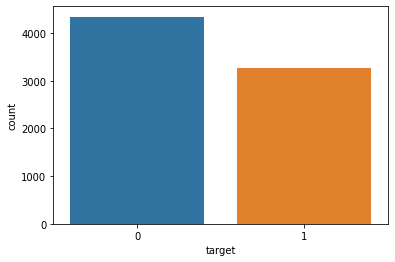

In [ ]:
# sns.countplot(train['target']);

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


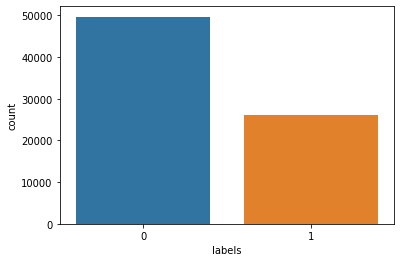

In [ ]:
sns.countplot(train['labels']);

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


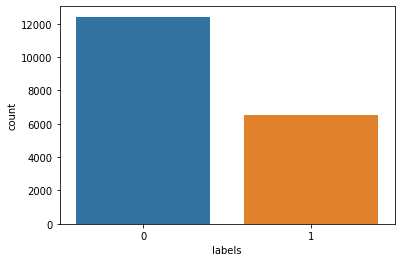

In [ ]:
sns.countplot(test['labels']);

In [ ]:
train_df, valid_df = train_test_split(train, test_size=0.2, stratify=train['labels'], random_state=42)

## Initialize a ClassificationModel

In [ ]:
model_args = ClassificationArgs(num_train_epochs=3,evaluate_during_training=True,no_save=True,evaluate_during_training_steps= 10000, use_cached_eval_features=True,output_dir = "outputs-large/", best_model_dir = "outputs-large/best_model/",save_optimizer_and_scheduler = True, overwrite_output_dir=True, manual_seed=42, silent=False, evaluate_during_training_verbose=True)

model = ClassificationModel(model_type='roberta', model_name='roberta-base', use_cuda=True, num_labels=2, 
                            args=model_args)

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaForSequenceClassification: ['lm_head.bias', 'lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out

## Train the model

In [ ]:
model.train_model(train,eval_df = test)

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:900: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


## Evaluate the model

In [ ]:
# result, model_outputs, wrong_predictions = model.eval_model(valid_df)

In [ ]:
# result

{'eval_loss': 0.41687825866316625,
 'fn': 120,
 'fp': 125,
 'mcc': 0.6720497332586948,
 'tn': 744,
 'tp': 534}

In [ ]:
result, model_outputs, wrong_predictions = model.eval_model(valid_df)

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:900: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


In [ ]:
result

{'eval_loss': 0.6445808941320306,
 'fn': 4909,
 'fp': 0,
 'mcc': 0.0,
 'tn': 9313,
 'tp': 0}

In [ ]:
result

{'eval_loss': 0.644693530953507,
 'fn': 4909,
 'fp': 0,
 'mcc': 0.0,
 'tn': 9313,
 'tp': 0}

In [ ]:
result

In [ ]:
# predictions = []
# for x in model_outputs:
#     predictions.append(np.argmax(x))

# print('f1 score:', f1_score(valid_df['labels'], predictions))

f1 score: 0.8134044173648134


In [ ]:
predictions = []
for x in model_outputs:
    predictions.append(np.argmax(x))

print('f1 score:', f1_score(valid_df['labels'], predictions))

## Prediction on test set

In [ ]:
test_predictions, raw_outputs = model.predict([i for i in test['text']])

In [ ]:
test_predictions

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
[i for i in test['text'][0:10]]

['these were typically hypodiploid, hypotetraploid, or hypopolyploid with loss of only few chromosomes, indicating that they were most probably due to artifactual loss of chromosomes during preparation.',
 'the m. roreri genome size is larger than the genome of m. perniciosa, but the number of genes located in each genome is similar.. .',
 'datg <dig> is required for complete tissue regeneration in response to apoptosis.',
 'in addition, the slope of the plot with ssbba is different from that of ssbec.',
 'gene-expression levels can be monitored with cdna or oligonucleotide chips over a time-course for a temporal process.',
 "<cit>  reported that mn-excess did not affect fv/fm and psii quantum efficiency in mn-tolerant maize  'kneja 434', but the two parameters significantly decreased in mn-sensitive maize 'kneja 605' at the highest mn concentration.",
 'Roller noted that in 2010, the NFL earned $9 billion in revenue -- a figure he believes could be used to assist former players in nee

In [ ]:
raw_outputs

array([[ 0.31079102, -0.37890625],
       [ 0.31054688, -0.37890625],
       [ 0.31079102, -0.37890625],
       ...,
       [ 0.31079102, -0.37890625],
       [ 0.31079102, -0.37890625],
       [ 0.31079102, -0.37890625]])

In [ ]:
sample_sub['target'] = test_predictions

In [ ]:
sample_sub.to_csv('submission.csv', index=False)

In [ ]:
files.download('submission.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
model = ClassificationModel(
    "roberta", "outputs"
)

In [ ]:
test_predictions, _ = model.predict([i for i in test['text']])

In [ ]:
# print('accuracy:',accuracy_score(test['labels'], test_predictions))
print('f1 score:', f1_score(test['labels'], test_predictions))

f1 score: 0.0


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# 4 topics

## Import libraries and datasets

In [1]:
!pip install --upgrade transformers
!pip install simpletransformers

     |████████████████████████████████| 1.3MB 22.9MB/s 
     |████████████████████████████████| 2.9MB 48.3MB/s 
     |████████████████████████████████| 890kB 47.2MB/s 
     |████████████████████████████████| 1.1MB 48.3MB/s 
  Created wheel for sacremoses: filename=sacremoses-0.0.43-cp36-none-any.whl size=893257 sha256=01f839267a6079b921faf320e5d7a0c0871087c4d6a917dc5c9cc17ace2b3c47
  Stored in directory: /root/.cache/pip/wheels/29/3c/fd/7ce5c3f0666dab31a50123635e6fb5e19ceb42ce38d4e58f45
Successfully built sacremoses
     |████████████████████████████████| 225kB 23.4MB/s 
     |████████████████████████████████| 1.8MB 43.3MB/s 
     |████████████████████████████████| 51kB 8.5MB/s 
     |████████████████████████████████| 71kB 11.0MB/s 
     |████████████████████████████████| 7.4MB 50.6MB/s 
     |████████████████████████████████| 317kB 54.1MB/s 
     |████████████████████████████████| 163kB 51.2MB/s 
     |████████████████████████████████| 102kB 12.0MB/s 
     |███████████████████████████

## Pre-processing

In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from simpletransformers.classification import ClassificationModel, ClassificationArgs

In [2]:
import re
import pandas as pd 
from sklearn.model_selection import train_test_split
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
import numpy as np 

from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score
from torch.optim.optimizer import Optimizer

from sklearn.preprocessing import StandardScaler
from multiprocessing import  Pool
from functools import partial
import numpy as np
from sklearn.decomposition import PCA
import torch as t
import torch.nn as nn
import torch.nn.functional as F

import matplotlib.pyplot as plt

import random
import copy
import time
import pandas as pd
import numpy as np
import gc
import re
import torch

In [4]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [ ]:
# MultiTopicDocs = pd.read_csv("/content/drive/MyDrive/Anushree/four_topics.csv")
# MultiTopicDocs.head()

In [ ]:
# Data = MultiTopicDocs

In [ ]:
# train, test = train_test_split(Data, test_size=0.25, stratify=Data['labels'], random_state=42)
# print(train.shape,test.shape)

In [ ]:
train = pd.read_csv("/content/drive/MyDrive/Anushree/train.csv")
test = pd.read_csv("/content/drive/MyDrive/Anushree/validation.csv")
print(train.shape,test.shape)

(97566, 3) (32522, 3)


In [ ]:
# import pandas as pd
# Data = pd.DataFrame(test, 
#                columns =['text', 'labels']) 
# Data = Data.sample(frac = 1)
# Data.head(5)
# Data.to_csv('/content/drive/MyDrive/Anushree/validation.csv')

In [ ]:
train.head()

,Unnamed: 0,text,labels
0,47436,18 and made their second appearance of the sea...,1
1,65348,This piece was updated to clarify that that ma...,2
2,82315,Here's where he stands on the issues..Louisian...,2
3,117773,"thus, epb <dig> l5/more function is required t...",0
4,625,These include all 21 essential amino acids and...,3


In [ ]:
print(train.isnull().sum().sum())
print(test.isnull().sum().sum())

0
0


In [ ]:

train['labels'].value_counts()

2    27486
0    27094
3    23876
1    19110
Name: labels, dtype: int64

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


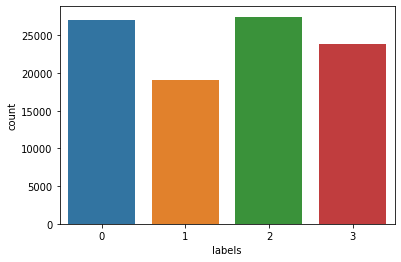

In [ ]:
sns.countplot(train['labels']);

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


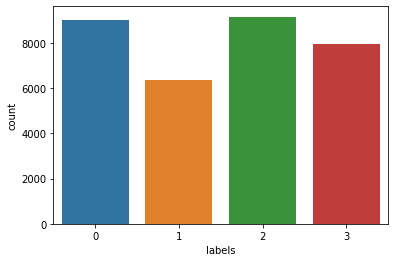

In [ ]:
sns.countplot(test['labels']);

In [ ]:
# train_df, valid_df = train_test_split(train, test_size=0.2, stratify=train['labels'], random_state=42)

## Initialize a ClassificationModel

In [ ]:
model_args = ClassificationArgs(num_train_epochs=3,evaluate_during_training=True, use_cached_eval_features=True,output_dir = "output_4_topics/", best_model_dir = "output_4_topics/best_model/",save_optimizer_and_scheduler = True, overwrite_output_dir=True, manual_seed=42, silent=False, evaluate_during_training_verbose=True)

model = ClassificationModel(model_type='bert', model_name='bert-base-uncased', use_cuda=True, num_labels=4, 
                            args=model_args)
# model_args.use_early_stopping = True
# model_args.early_stopping_delta = 0.01
# model_args.early_stopping_metric = "mcc"
# model_args.early_stopping_metric_minimize = False
# model_args.early_stopping_patience = 5

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at

## Train the model

In [ ]:
model.train_model(train,eval_df = test)

/usr/local/lib/python3.6/dist-packages/torch/optim/lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
/usr/local/lib/python3.6/dist-packages/torch/optim/lr_scheduler.py:216: UserWarning: Please also save or load the state of the optimizer when saving or loading the scheduler.
  warnings.warn(SAVE_STATE_WARNING, UserWarning)


Buffered data was truncated after reaching the output size limit.

## Evaluate the model

In [ ]:
result, model_outputs, wrong_predictions = model.eval_model(test)

In [ ]:
result

{'eval_loss': 0.38250417309609475, 'mcc': 0.8710628548833355}

In [ ]:
# predictions = []
# for x in model_outputs:
#     predictions.append(np.argmax(x))

# print('f1 score:', f1_score(valid_df['labels'], predictions))

## Prediction on test set

In [ ]:
model = ClassificationModel(
    "bert", '/content/output_4_topics/checkpoint-28000'
)

In [ ]:
test_predictions, raw_outputs = model.predict([i for i in test['text']])

In [ ]:
test_predictions

[2,
 1,
 3,
 0,
 3,
 0,
 1,
 2,
 0,
 0,
 2,
 2,
 2,
 0,
 0,
 0,
 2,
 2,
 3,
 1,
 2,
 2,
 0,
 0,
 0,
 1,
 2,
 0,
 0,
 0,
 3,
 1,
 2,
 2,
 0,
 1,
 1,
 3,
 2,
 2,
 2,
 3,
 3,
 0,
 3,
 3,
 2,
 0,
 2,
 3,
 3,
 0,
 2,
 1,
 2,
 2,
 0,
 0,
 3,
 3,
 0,
 3,
 1,
 3,
 0,
 2,
 0,
 2,
 0,
 3,
 0,
 2,
 3,
 2,
 0,
 2,
 1,
 0,
 0,
 3,
 0,
 3,
 2,
 2,
 0,
 3,
 0,
 2,
 3,
 3,
 1,
 2,
 0,
 0,
 0,
 2,
 0,
 1,
 1,
 2,
 2,
 0,
 0,
 3,
 3,
 3,
 1,
 0,
 3,
 3,
 2,
 0,
 2,
 3,
 3,
 1,
 2,
 3,
 0,
 0,
 2,
 2,
 3,
 0,
 2,
 3,
 1,
 0,
 0,
 2,
 2,
 3,
 2,
 2,
 0,
 1,
 2,
 1,
 2,
 2,
 2,
 1,
 3,
 0,
 2,
 1,
 0,
 2,
 3,
 2,
 3,
 0,
 1,
 2,
 3,
 3,
 3,
 0,
 0,
 2,
 2,
 2,
 3,
 3,
 0,
 2,
 0,
 3,
 2,
 2,
 3,
 0,
 3,
 2,
 0,
 2,
 1,
 0,
 2,
 1,
 1,
 3,
 0,
 3,
 2,
 2,
 2,
 0,
 0,
 1,
 0,
 0,
 2,
 2,
 0,
 2,
 3,
 3,
 1,
 3,
 2,
 1,
 1,
 2,
 3,
 3,
 2,
 0,
 3,
 0,
 3,
 2,
 2,
 2,
 3,
 2,
 0,
 1,
 2,
 0,
 3,
 1,
 0,
 0,
 0,
 3,
 0,
 2,
 1,
 2,
 3,
 1,
 0,
 0,
 0,
 3,
 3,
 3,
 1,
 0,
 2,
 3,
 3,
 1,
 0,
 3,
 0,
 0,
 0,
 2,


In [ ]:
from sklearn.metrics import matthews_corrcoef
print('mcc:',matthews_corrcoef(test['labels'], test_predictions))

mcc: 0.9234430518877723


In [ ]:
print('accuracy:',accuracy_score(test['labels'], test_predictions))
print('f1 score - macro:', f1_score(test['labels'], test_predictions, average='macro'))
print('f1 score - micro:', f1_score(test['labels'], test_predictions, average='micro'))
print('f1 score - weighted:', f1_score(test['labels'], test_predictions, average='weighted'))

accuracy: 0.940501814156571
f1 score - macro: 0.9368270054396081
f1 score - micro: 0.940501814156571
f1 score - weighted: 0.9405932228584726


In [ ]:
!cp "/content/output_4_topics/checkpoint-26000" -r "/content/drive/MyDrive/Anushree"

#generatating required csv file

In [4]:
MultiTopicDocs = pd.read_csv("/content/drive/My Drive/Sravani/data-4topics500.csv")
MultiTopicDocs.head()

,Unnamed: 0,Doc,Num_of_topics,Topics,Topic_order
0,0,Black students were hurt most when Wellesley t...,3,"['PoliticsPolicy', 'Health', 'Food']","[2, 2, 0, 2, 3, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, ..."
1,1,BACKGROUND.\nant colony algorithm belongs to ...,3,"['Food', 'Health', 'Sports']","[0, 0, 3, 1, 3, 3, 3, 3, 1, 1, 0, 1, 3, 3, 3, ..."
2,2,BACKGROUND.\n9 myths about sexual assault.\nlo...,4,"['PoliticsPolicy', 'Health', 'Food', 'Sports']","[0, 2, 0, 0, 2, 2, 1, 0, 2, 0, 2, 3, 0, 3, 3, ..."
3,3,Jockey Ramon Dominguez has made enough progres...,2,"['Sports', 'Food']","[1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, ..."
4,4,Love it!I really like the flavor of this one!\...,2,"['Food', 'PoliticsPolicy']","[3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, ..."


In [5]:
model = ClassificationModel(
    "bert", "/content/drive/MyDrive/Anushree/checkpoint-26000"
)

In [ ]:
j=1
ind_accuracy=[]
true_label = []
pred_label = []
col1 = []
col2_0 = []
col2_1 = []
col2_2 = []
col2_3 = []
for index, row in MultiTopicDocs.iterrows():
    col1.append(row['Doc'])
    topic_separated_doc = [[] for _ in np.arange(4)]
    Document= row['Doc'].split("\n")
    Topics_order_string = row['Topic_order']
    Topics_order_string = Topics_order_string.replace("[", "")
    Topics_order_string = Topics_order_string.replace("]", "")
    actual_topic_order = Topics_order_string.split(",")
    # print(len(Document),len(actual_topic_order))

    actual_topic_order_num = [int(i) for i in actual_topic_order] 

    predicted_topic_order,_ = model.predict(Document)

    for i in np.arange(len(predicted_topic_order)):
      topic_separated_doc[predicted_topic_order[i]].append(Document[i])

    for i in np.arange(4):
      topic_separated_doc[i] = '\n'.join(topic_separated_doc[i])
    # col2.append(topic_separated_doc)
    
    col2_0.append(topic_separated_doc[0])
    col2_1.append(topic_separated_doc[1])
    col2_2.append(topic_separated_doc[2])
    col2_3.append(topic_separated_doc[3])

    print(len(predicted_topic_order))
    print(predicted_topic_order)
    print(actual_topic_order_num)
    print(len(actual_topic_order_num))
    match = 0
    for i in range(0,len(actual_topic_order_num)):
      if actual_topic_order_num[i]==predicted_topic_order[i]:
        match = match+1
    ind_accuracy.append(match/len(actual_topic_order_num))
    # break

    #f1 score
    true_label += actual_topic_order_num
    pred_label += predicted_topic_order

# print(len(ind_accuracy))
# print(sum(ind_accuracy) / len(ind_accuracy))


247
[2, 2, 3, 2, 3, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 2, 3, 0, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 3, 1, 0, 0, 3, 0, 3, 2, 2, 0, 0, 2, 3, 2, 3, 2, 2, 3, 3, 2, 0, 3, 3, 3, 2, 3, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 3, 3, 2, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 2, 3, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 2, 3, 0, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 3, 2, 0, 0, 3, 0, 3, 2, 2, 0, 0, 2, 3, 2, 3, 2, 2, 3, 3, 2, 0, 3, 3, 3, 2, 3, 2, 0, 0, 3, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 3, 3, 


132
[3, 0, 3, 1, 3, 3, 3, 3, 1, 1, 0, 1, 3, 3, 3, 0, 0, 1, 3, 3, 3, 3, 0, 3, 0, 0, 1, 0, 3, 3, 1, 0, 0, 1, 3, 0, 0, 3, 1, 3, 0, 1, 3, 1, 2, 3, 3, 0, 0, 0, 1, 3, 1, 0, 1, 1, 1, 1, 1, 0, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 1, 3, 0, 3, 3, 3, 0, 1, 0, 0, 0, 0, 1, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 1, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 1, 3, 3, 3, 3, 1, 1, 0, 1, 3, 3, 3, 0, 0, 1, 3, 3, 3, 3, 0, 3, 0, 0, 1, 0, 3, 3, 1, 0, 0, 1, 3, 0, 0, 3, 1, 3, 0, 1, 3, 1, 3, 3, 3, 0, 0, 0, 1, 3, 1, 0, 1, 1, 1, 1, 1, 0, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 1, 3, 0, 3, 3, 3, 0, 1, 0, 0, 0, 0, 1, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
132



229
[3, 2, 0, 0, 2, 2, 1, 0, 2, 0, 2, 3, 0, 3, 3, 3, 2, 1, 1, 0, 3, 3, 3, 1, 2, 1, 3, 2, 3, 0, 1, 0, 1, 3, 0, 3, 1, 0, 0, 3, 1, 1, 2, 3, 2, 2, 3, 0, 0, 3, 2, 2, 3, 0, 2, 3, 0, 0, 0, 3, 0, 2, 0, 0, 0, 3, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 0, 2, 3, 0, 0, 3, 3, 3, 0, 3, 3, 2, 0, 2, 3, 0, 1, 0, 1, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 1, 2, 2, 0, 1, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 3, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[0, 2, 0, 0, 2, 2, 1, 0, 2, 0, 2, 3, 0, 3, 3, 3, 2, 1, 1, 0, 3, 3, 3, 1, 2, 1, 3, 2, 3, 0, 1, 0, 1, 3, 0, 3, 1, 0, 0, 3, 1, 1, 2, 0, 2, 2, 3, 0, 0, 3, 2, 2, 3, 0, 2, 3, 0, 0, 0, 3, 0, 2, 0, 0, 0, 3, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 2, 2, 0, 2, 3, 3, 3, 3, 2, 3, 3, 0, 3, 0, 2, 3, 


39
[1, 1, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
39



98
[3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 2, 2, 1, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
98



91
[2, 2, 2, 3, 2, 2, 1, 2, 3, 3, 1, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 1, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
91



131
[2, 3, 0, 0, 0, 1, 2, 2, 2, 0, 0, 0, 0, 1, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 3, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
131



208
[1, 2, 3, 0, 0, 2, 3, 0, 3, 0, 0, 3, 0, 0, 3, 2, 0, 0, 0, 0, 2, 3, 1, 1, 2, 3, 1, 2, 2, 3, 3, 0, 3, 1, 3, 1, 1, 3, 1, 0, 0, 0, 2, 1, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 2, 1, 2, 2, 3, 2, 2, 2, 0, 0, 1, 0, 2, 0, 0, 2, 0, 3, 3, 3, 3, 0, 1, 1, 3, 1, 0, 0, 1, 2, 0, 1, 1, 3, 0, 1, 3, 0, 3, 1, 0, 2, 2, 2, 0, 0, 3, 3, 1, 0, 1, 2, 0, 0, 0, 1, 3, 2, 3, 3, 0, 3, 1, 1, 3, 1, 3, 1, 0, 1, 1, 1, 1, 0, 1, 0, 2, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[1, 2, 0, 0, 0, 2, 3, 0, 3, 0, 0, 3, 0, 0, 3, 2, 0, 0, 0, 0, 3, 3, 2, 1, 2, 3, 1, 2, 2, 3, 3, 0, 3, 1, 3, 2, 2, 3, 2, 0, 0, 0, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 2, 1, 2, 2, 3, 2, 2, 1, 0, 0, 1, 0, 2, 0, 0, 2, 0, 3, 3, 3, 3, 0, 1, 1, 3, 1, 0, 0, 1, 2, 0, 1, 1, 3, 0, 1, 0, 0, 3, 1, 0, 2, 2, 2, 0, 0, 3, 3, 1, 0, 1, 2, 0, 0, 0, 1, 3, 2, 3, 3, 0, 3, 1, 1, 3, 1, 3, 1, 0, 


328
[3, 1, 1, 2, 2, 2, 0, 3, 0, 0, 3, 2, 2, 3, 2, 1, 0, 2, 2, 1, 3, 3, 3, 0, 1, 3, 2, 3, 1, 0, 3, 2, 1, 1, 1, 3, 1, 2, 2, 0, 3, 0, 1, 2, 1, 0, 2, 0, 1, 3, 0, 0, 1, 2, 1, 0, 2, 0, 0, 3, 2, 3, 0, 2, 2, 1, 3, 3, 3, 0, 3, 3, 1, 3, 2, 0, 2, 2, 2, 0, 2, 0, 0, 3, 0, 1, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 1, 2, 1, 2, 0, 0, 2, 3, 2, 0, 0, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 0, 3, 0, 0, 1, 2, 2, 0, 2, 0, 0, 1, 3, 1, 0, 1, 3, 3, 0, 2, 0, 0, 3, 2, 3, 0, 1, 0, 0, 0, 0, 2, 3, 3, 1, 2, 1, 0, 3, 2, 2, 1, 2, 2, 2, 3, 3, 0, 2, 0, 0, 2, 0, 3, 0, 3, 0, 3, 1, 2, 3, 1, 0, 1, 1, 3, 2, 0, 0, 1, 1, 2, 3, 1, 3, 0, 0, 2, 0, 3, 0, 0, 2, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 1, 1, 


226
[3, 3, 3, 0, 1, 1, 0, 1, 1, 3, 1, 1, 1, 0, 3, 0, 3, 1, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 3, 3, 0, 1, 1, 0, 1, 1, 3, 1, 1, 1, 0, 3, 0, 3, 1, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


156
[1, 1, 1, 3, 0, 0, 0, 0, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
156



334
[2, 3, 1, 1, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 1, 0, 2, 1, 2, 0, 2, 1, 0, 1, 0, 0, 2, 0, 1, 0, 1, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 1, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 0, 1, 0, 2, 2, 2, 2, 2, 1, 1, 1, 0, 1, 2, 1, 1, 0, 0, 2, 0, 2, 0, 2, 2, 1, 2, 2, 1, 1, 1, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 1, 1, 0, 1, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 0, 2, 0, 1, 1, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0


249
[1, 3, 3, 2, 2, 3, 3, 3, 0, 1, 0, 0, 3, 3, 3, 0, 2, 1, 1, 1, 1, 3, 1, 3, 3, 0, 1, 2, 0, 3, 0, 2, 2, 2, 0, 2, 3, 0, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 2, 2, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 2, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 3, 3, 2, 2, 3, 0, 3, 0, 1, 0, 0, 3, 3, 3, 0, 2, 1, 1, 1, 1, 3, 1, 3, 3, 0, 1, 2, 0, 3, 0, 2, 2, 2, 0, 2, 3, 0, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 


231
[1, 3, 1, 1, 1, 0, 0, 1, 1, 0, 3, 2, 1, 0, 2, 2, 1, 0, 0, 0, 2, 2, 1, 0, 2, 0, 0, 2, 2, 0, 1, 3, 2, 1, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 3, 1, 2, 0, 0, 2, 1, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 3, 0, 2, 2, 3, 2, 2, 2, 0, 2, 1, 0, 0, 2, 0, 0, 0, 2, 0, 0, 1, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 0, 1, 1, 1, 0, 0, 1, 2, 0, 1, 2, 1, 0, 2, 2, 2, 0, 0, 0, 2, 2, 1, 0, 2, 0, 0, 2, 2, 0, 1, 1, 2, 1, 2, 0, 2, 0, 0, 0, 1, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 1, 2, 0, 0, 2, 2, 1, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 


445
[3, 1, 3, 1, 3, 0, 1, 1, 3, 2, 2, 1, 2, 2, 0, 1, 0, 0, 0, 2, 3, 2, 3, 0, 2, 3, 2, 0, 1, 3, 0, 1, 2, 3, 2, 2, 3, 3, 0, 0, 3, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 3, 2, 2, 3, 1, 0, 0, 2, 2, 2, 3, 0, 0, 0, 2, 0, 2, 3, 2, 2, 0, 0, 3, 0, 3, 0, 2, 2, 2, 2, 2, 0, 3, 0, 0, 2, 2, 0, 2, 2, 3, 0, 2, 0, 2, 2, 2, 3, 2, 2, 2, 2, 2, 0, 2, 0, 0, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 3, 2, 1, 3, 2, 0, 3, 0, 3, 2, 3, 3, 0, 3, 2, 2, 2, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


66
[3, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 1, 2, 1, 3, 3, 1, 3, 3, 2, 1, 1, 2, 3, 1, 3, 2, 3, 3, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 1, 1, 1, 3, 3, 1, 3, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 3, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
66



356
[1, 1, 0, 3, 0, 1, 0, 1, 2, 1, 2, 1, 0, 2, 2, 1, 0, 3, 2, 2, 2, 1, 0, 0, 0, 1, 2, 3, 2, 1, 1, 0, 0, 2, 0, 3, 1, 1, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 0, 2, 2, 3, 0, 3, 0, 2, 1, 0, 0, 0, 2, 3, 0, 3, 2, 3, 2, 0, 0, 0, 1, 3, 2, 3, 1, 0, 3, 1, 1, 0, 2, 0, 3, 1, 1, 1, 2, 2, 2, 3, 3, 3, 0, 1, 1, 1, 2, 1, 3, 3, 1, 0, 1, 3, 2, 3, 1, 3, 3, 1, 2, 0, 2, 0, 0, 3, 2, 2, 2, 3, 2, 1, 2, 1, 1, 1, 2, 3, 2, 1, 0, 2, 3, 2, 3, 1, 2, 1, 2, 2, 1, 0, 2, 1, 0, 3, 0, 1, 1, 1, 0, 0, 0, 0, 1, 2, 0, 1, 2, 2, 1, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 2, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 2, 1, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


185
[3, 3, 2, 3, 2, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 0, 0, 2, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 2, 3, 0, 0, 0, 2, 2, 3, 0, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 2, 2, 2, 3, 0, 2, 0, 3, 1, 0, 0, 2, 3, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 2, 0, 2, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 0, 0, 2, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 2, 3, 0, 0, 0, 2, 2, 3, 0, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 2, 2, 2, 3, 0, 2, 0, 3, 3, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


180
[3, 3, 3, 3, 3, 0, 2, 0, 3, 0, 3, 3, 2, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 2, 1, 0, 3, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 1, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2]
[3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


458
[1, 3, 2, 1, 0, 2, 1, 1, 1, 1, 3, 1, 1, 2, 1, 3, 2, 0, 2, 3, 3, 1, 0, 0, 1, 3, 3, 1, 3, 2, 1, 3, 1, 2, 0, 0, 0, 0, 3, 3, 0, 2, 3, 0, 0, 2, 0, 1, 1, 0, 2, 2, 2, 1, 0, 3, 2, 2, 2, 1, 1, 0, 3, 2, 3, 0, 3, 2, 2, 1, 0, 3, 3, 1, 0, 2, 1, 2, 0, 3, 3, 3, 3, 3, 2, 1, 1, 1, 3, 3, 1, 0, 0, 1, 1, 0, 1, 2, 2, 2, 3, 0, 1, 1, 2, 3, 2, 2, 2, 3, 1, 1, 2, 2, 0, 0, 0, 1, 2, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 0, 1, 2, 2, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 3, 2, 2, 2, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 2, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


589
[1, 3, 0, 1, 2, 0, 0, 2, 0, 1, 1, 3, 1, 0, 3, 2, 1, 0, 0, 1, 2, 2, 2, 2, 0, 1, 0, 2, 2, 0, 3, 2, 0, 2, 2, 2, 2, 3, 0, 0, 0, 3, 2, 2, 3, 2, 0, 3, 0, 2, 0, 0, 3, 0, 3, 0, 0, 3, 2, 2, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 1, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


244
[3, 0, 0, 2, 0, 1, 0, 0, 2, 1, 0, 2, 0, 1, 1, 1, 1, 1, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 2, 1, 2, 3, 1, 0, 0, 2, 2, 0, 1, 2, 2, 2, 2, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 1, 0, 1, 2, 2, 0, 0, 2, 2, 1, 1, 1, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 1, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 3, 2, 3, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 3, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 0, 2, 0, 1, 0, 0, 2, 1, 0, 2, 0, 1, 1, 1, 1, 1, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 2, 1, 2, 2, 1, 0, 0, 2, 2, 0, 1, 2, 2, 1, 2, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 1, 0, 1, 2, 2, 0, 0, 2, 2, 1, 1, 1, 0, 0, 1, 0, 2, 0, 0, 2, 2, 2, 


69
[1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
69



43
[2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
43



226
[3, 1, 2, 3, 0, 2, 1, 1, 0, 3, 0, 2, 0, 3, 1, 2, 3, 1, 2, 0, 3, 0, 0, 0, 2, 2, 3, 3, 3, 2, 0, 0, 1, 1, 1, 0, 0, 0, 1, 2, 3, 1, 1, 3, 3, 0, 0, 0, 2, 1, 3, 3, 3, 2, 0, 3, 1, 3, 3, 0, 1, 0, 0, 1, 3, 1, 3, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 1, 1, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 0, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 0, 0, 1, 2, 0, 2, 2, 2, 2, 1, 1, 1, 0, 2, 2, 2, 2, 1, 3, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 2, 3, 0, 2, 1, 1, 0, 3, 0, 2, 0, 3, 2, 2, 3, 1, 2, 0, 3, 0, 0, 0, 2, 2, 3, 3, 3, 2, 0, 0, 1, 1, 1, 0, 0, 0, 1, 2, 3, 1, 1, 3, 3, 0, 0, 0, 2, 1, 1, 3, 3, 2, 0, 3, 1, 3, 3, 0, 1, 0, 0, 1, 3, 1, 3, 0, 2, 0, 1, 1, 0, 2, 2, 2, 1, 1, 1, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 2, 1, 2, 0, 0, 


28
[3, 1, 1, 3, 1, 1, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
28



74
[1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 3, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
74



223
[2, 3, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 2, 2, 0, 2, 2, 0, 0, 3, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


199
[1, 3, 2, 2, 2, 1, 3, 2, 0, 0, 1, 3, 2, 0, 0, 3, 2, 1, 1, 2, 0, 3, 2, 3, 3, 0, 3, 3, 1, 2, 2, 1, 0, 2, 0, 3, 0, 2, 0, 0, 3, 0, 3, 0, 2, 0, 0, 2, 3, 2, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 2, 2, 3, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 3, 2, 0, 2, 0, 2, 3, 2, 0, 0, 0, 2, 3, 2, 0, 3, 3, 3, 3, 3, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 0, 2, 2, 2, 1, 3, 2, 0, 0, 1, 3, 2, 0, 0, 3, 2, 1, 1, 2, 0, 3, 2, 3, 3, 0, 3, 3, 1, 2, 2, 1, 0, 2, 0, 3, 0, 2, 0, 0, 2, 0, 3, 0, 2, 0, 0, 2, 3, 2, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 2, 2, 3, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 3, 2, 0, 2, 0, 2, 3, 2, 0, 0, 0, 2, 3, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


346
[2, 3, 2, 0, 0, 0, 1, 2, 2, 1, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 3, 2, 2, 1, 0, 0, 3, 0, 2, 2, 0, 2, 3, 2, 2, 2, 0, 1, 2, 3, 1, 0, 0, 2, 0, 1, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 1, 2, 2, 3, 0, 2, 2, 1, 0, 0, 2, 2, 0, 1, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 1, 2, 0, 0, 2, 1, 0, 1, 0, 2, 2, 2, 2, 2, 2, 0, 2, 1, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0


273
[3, 2, 3, 3, 3, 0, 2, 0, 3, 2, 3, 3, 2, 2, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 0, 2, 3, 3, 2, 3, 3, 0, 0, 3, 3, 0, 0, 3, 2, 3, 3, 3, 2, 0, 2, 3, 3, 0, 3, 2, 2, 0, 0, 3, 0, 3, 0, 0, 0, 2, 0, 2, 3, 3, 2, 2, 0, 2, 0, 0, 0, 0, 3, 2, 2, 3, 2, 0, 3, 2, 0, 3, 0, 1, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 3, 0, 0, 2, 0, 3, 2, 3, 3, 2, 2, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 0, 2, 3, 3, 2, 3, 3, 0, 0, 3, 3, 0, 0, 3, 2, 3, 3, 3, 2, 0, 2, 3, 3, 0, 3, 2, 2, 0, 0, 3, 0, 3, 0, 0, 


63
[3, 3, 2, 1, 3, 3, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
[3, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
63



365
[3, 3, 1, 1, 1, 1, 3, 1, 3, 3, 0, 1, 1, 2, 1, 2, 1, 2, 0, 0, 0, 2, 2, 0, 2, 1, 3, 0, 0, 2, 3, 0, 3, 3, 3, 2, 2, 1, 2, 0, 3, 2, 0, 2, 3, 0, 2, 0, 2, 3, 0, 1, 1, 0, 1, 3, 2, 0, 0, 1, 0, 3, 1, 2, 1, 1, 3, 2, 1, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 2, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 2, 1, 0, 3, 3, 2, 3, 3, 0, 0, 3, 2, 2, 3, 0, 3, 2, 0, 0, 3, 2, 3, 0, 3, 3, 2, 0, 3, 0, 3, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 3, 2, 0, 2, 2, 2, 2, 2, 3, 2, 0, 0, 2, 3, 2, 3, 2, 3, 0, 0, 0, 3, 3, 3, 0, 2, 2, 3, 3, 2, 3, 3, 1, 0, 2, 2, 0, 2, 2, 0, 3, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


315
[3, 1, 1, 2, 1, 3, 1, 2, 3, 3, 3, 1, 0, 3, 1, 3, 3, 1, 1, 0, 3, 1, 0, 3, 3, 0, 1, 1, 3, 3, 2, 0, 2, 3, 3, 3, 1, 0, 3, 3, 1, 3, 0, 2, 3, 0, 1, 1, 2, 0, 1, 0, 0, 0, 0, 0, 3, 3, 2, 1, 2, 2, 0, 3, 1, 2, 0, 2, 0, 1, 0, 2, 0, 0, 0, 2, 1, 1, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 2, 3, 0, 3, 3, 0, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 0, 2, 2, 0, 0, 2, 2, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0]
[3, 1, 1, 2, 1, 3, 1, 2, 0, 3, 3, 1, 0, 3, 1, 3, 


242
[2, 3, 3, 1, 2, 3, 1, 1, 0, 3, 3, 0, 3, 2, 1, 2, 0, 1, 3, 0, 3, 0, 0, 3, 3, 1, 1, 2, 1, 1, 0, 1, 3, 1, 2, 2, 2, 1, 0, 2, 1, 3, 0, 2, 0, 0, 1, 1, 2, 2, 3, 1, 1, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 2, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 1, 3, 2, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 1, 0, 0, 3, 3, 0, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 3, 0, 1, 2, 3, 1, 1, 0, 3, 3, 0, 3, 2, 1, 2, 0, 1, 3, 0, 3, 0, 0, 3, 3, 1, 1, 2, 2, 1, 0, 1, 3, 1, 2, 2, 2, 1, 0, 2, 1, 3, 0, 2, 0, 0, 1, 1, 2, 2, 3, 1, 1, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 


288
[3, 3, 2, 1, 3, 0, 2, 2, 3, 0, 2, 1, 1, 3, 0, 1, 0, 0, 2, 0, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 0, 2, 2, 3, 3, 2, 2, 0, 3, 2, 2, 2, 2, 3, 0, 2, 3, 0, 2, 0, 3, 2, 0, 2, 2, 0, 2, 3, 2, 0, 3, 0, 0, 2, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 2, 3, 3, 3, 2, 2, 0, 2, 0, 0, 2, 0, 0, 3, 0, 3, 3, 0, 2, 0, 0, 2, 0, 2, 3, 3, 2, 2, 3, 1, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 1, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 1, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 3, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[3, 0, 1, 1, 3, 0, 2, 2, 3, 0, 2, 1, 1, 3, 0, 1, 0, 0, 2, 0, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 0, 2, 3, 3, 3, 2, 2, 0, 3, 2, 2, 


281
[2, 2, 3, 0, 2, 3, 3, 2, 3, 2, 1, 3, 0, 1, 1, 3, 0, 3, 1, 3, 3, 3, 2, 0, 1, 2, 0, 1, 2, 1, 3, 0, 2, 1, 3, 3, 0, 0, 2, 1, 1, 3, 2, 3, 1, 2, 3, 1, 1, 2, 1, 0, 1, 2, 0, 3, 1, 2, 3, 1, 0, 1, 0, 3, 0, 2, 1, 2, 2, 2, 0, 1, 0, 2, 2, 2, 3, 2, 2, 2, 1, 2, 3, 1, 3, 1, 2, 0, 0, 1, 1, 1, 2, 0, 3, 0, 2, 2, 3, 1, 0, 3, 2, 2, 0, 0, 1, 3, 2, 0, 2, 1, 1, 1, 1, 3, 2, 3, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 1, 3, 1, 3, 3, 0, 3, 1, 0, 0, 3, 2, 1, 1, 2, 3, 2, 3, 0, 2, 3, 1, 0, 3, 2, 0, 3, 2, 2, 1, 3, 3, 2, 0, 2, 2, 1, 1, 1, 2, 0, 0, 2, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 0, 0, 1, 3, 3, 2, 3, 2, 1, 3, 0, 1, 1, 3, 0, 3, 1, 3, 1, 3, 2, 0, 1, 2, 0, 1, 2, 1, 3, 0, 2, 1, 3, 3, 0, 0, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 1, 1, 


97
[2, 1, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 1, 2, 3, 1, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
[2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
97



328
[3, 3, 1, 1, 3, 3, 1, 3, 0, 1, 0, 2, 1, 3, 0, 2, 0, 0, 1, 0, 3, 3, 0, 3, 1, 2, 3, 1, 2, 1, 2, 3, 3, 0, 0, 3, 0, 0, 1, 2, 0, 0, 3, 1, 3, 2, 3, 3, 3, 0, 0, 0, 1, 1, 3, 3, 0, 2, 0, 3, 0, 1, 3, 1, 3, 0, 3, 2, 3, 0, 3, 0, 3, 1, 0, 3, 0, 0, 1, 3, 3, 0, 3, 3, 1, 0, 3, 0, 2, 1, 3, 0, 3, 3, 3, 2, 3, 1, 1, 1, 3, 1, 3, 1, 0, 2, 1, 1, 3, 1, 3, 3, 3, 3, 0, 2, 1, 3, 0, 1, 0, 0, 3, 3, 0, 2, 3, 1, 1, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 1, 


159
[1, 1, 1, 3, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
159



42
[1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
42



262
[2, 3, 1, 1, 3, 3, 2, 1, 3, 0, 3, 0, 2, 2, 2, 3, 1, 0, 1, 2, 3, 2, 1, 3, 3, 0, 0, 2, 1, 1, 0, 0, 3, 2, 3, 2, 2, 1, 3, 1, 2, 3, 3, 3, 3, 3, 3, 3, 1, 1, 0, 0, 1, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 1, 2, 0, 0, 2, 0, 3, 2, 2, 3, 2, 3, 0, 1, 1, 0, 2, 3, 2, 2, 1, 2, 3, 3, 2, 0, 3, 3, 2, 2, 2, 3, 2, 1, 2, 3, 0, 2, 2, 3, 0, 3, 2, 2, 2, 2, 2, 3, 3, 3, 0, 0, 3, 3, 1, 3, 3, 3, 3, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 3, 1, 1, 3, 0, 2, 1, 3, 0, 1, 0, 2, 2, 2, 3, 1, 0, 1, 2, 3, 2, 1, 3, 3, 0, 0, 2, 1, 1, 0, 0, 3, 2, 3, 2, 1, 1, 3, 1, 2, 3, 3, 3, 3, 3, 3, 3, 1, 1, 0, 0, 1, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 1, 2, 0, 0, 2, 0, 


174
[3, 3, 0, 2, 3, 2, 0, 0, 0, 0, 2, 0, 2, 3, 2, 0, 3, 3, 3, 3, 2, 0, 0, 3, 2, 0, 2, 1, 0, 2, 2, 3, 2, 0, 0, 3, 0, 0, 2, 3, 2, 0, 3, 3, 0, 3, 2, 2, 2, 0, 2, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 0, 2, 3, 0, 2, 0, 0, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 3, 0, 3, 2, 0, 3, 3, 2, 3, 1, 0, 2, 1, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 1, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 0, 0, 2, 3, 2, 0, 0, 0, 0, 2, 0, 2, 3, 2, 0, 3, 3, 3, 3, 2, 0, 0, 3, 2, 0, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 0, 0, 2, 3, 2, 0, 3, 0, 0, 3, 2, 2, 2, 0, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 2, 3, 0, 2, 0, 0, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 3, 0, 3, 2, 0, 3, 3, 2, 3, 3, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 


254
[3, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 2, 1, 1, 0, 1, 0, 2, 2, 1, 0, 0, 2, 1, 1, 0, 2, 1, 2, 0, 0, 0, 1, 3, 2, 0, 0, 1, 1, 1, 2, 1, 0, 1, 0, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


199
[2, 3, 3, 0, 3, 3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 2, 3, 2, 0, 0, 0, 2, 2, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 3, 0, 3, 3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 2, 3, 2, 0, 0, 0, 2, 2, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


102
[2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 3, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
102



589
[3, 2, 0, 0, 2, 0, 0, 3, 0, 2, 1, 3, 2, 0, 0, 1, 0, 3, 2, 2, 1, 2, 2, 0, 1, 2, 2, 3, 2, 1, 2, 1, 2, 3, 1, 3, 3, 2, 0, 1, 2, 3, 0, 2, 2, 3, 2, 0, 1, 1, 3, 1, 1, 2, 2, 0, 2, 0, 2, 2, 3, 0, 2, 1, 2, 3, 1, 3, 2, 3, 2, 1, 1, 2, 1, 1, 3, 2, 3, 2, 3, 0, 0, 0, 0, 0, 3, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 3, 2, 3, 2, 2, 3, 2, 2, 1, 3, 2, 3, 0, 2, 3, 2, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 3, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


71
[3, 3, 1, 3, 1, 1, 3, 2, 1, 1, 3, 3, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 3, 2, 1, 3, 3, 1, 1, 1, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 3, 1, 1, 1, 1, 2, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1]
[3, 3, 1, 3, 1, 1, 3, 1, 1, 1, 3, 3, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1]
71



258
[1, 1, 2, 3, 0, 0, 2, 0, 2, 2, 2, 2, 2, 1, 1, 1, 0, 2, 2, 1, 0, 1, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 1]
[1, 2, 1, 0, 0, 0, 2, 0, 2, 1, 2, 2, 2, 1, 1, 1, 0, 2, 2, 1, 0, 1, 2, 2, 0, 1, 0, 2, 1, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


231
[3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


212
[2, 3, 3, 3, 0, 2, 3, 0, 0, 3, 2, 2, 1, 2, 2, 1, 1, 3, 2, 2, 1, 2, 1, 0, 0, 0, 2, 0, 3, 0, 2, 3, 2, 1, 3, 1, 1, 3, 2, 3, 2, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 3, 0, 3, 1, 3, 1, 3, 1, 3, 1, 0, 1, 1, 1, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 1, 0, 0, 0, 1, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 3, 0, 3, 0, 2, 3, 0, 0, 3, 1, 2, 1, 2, 2, 1, 1, 3, 2, 2, 1, 2, 1, 0, 0, 0, 2, 0, 3, 0, 2, 3, 2, 1, 3, 1, 1, 3, 2, 3, 2, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 3, 0, 3, 1, 3, 1, 3, 1, 3, 1, 0, 1, 1, 1, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 1, 0, 0, 0, 1, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


105
[1, 1, 2, 2, 2, 2, 2, 3, 3, 1, 3, 2, 3, 2, 3, 3, 2, 1, 3, 2, 1, 2, 1, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 1, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 1, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 1, 2, 2, 2, 3, 3, 1, 3, 2, 3, 2, 3, 3, 2, 1, 3, 2, 1, 1, 1, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
105



253
[3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 2, 0, 3, 3, 0, 0, 2, 0, 0, 0, 0, 3, 0, 3, 3, 0, 2, 3, 1, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 


279
[1, 3, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0]
[1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


272
[3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 2, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 2, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 


474
[2, 3, 1, 1, 2, 1, 2, 2, 3, 3, 1, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 1, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 1, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 1, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 3, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2


67
[2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
67



254
[3, 1, 1, 1, 3, 0, 1, 3, 1, 2, 1, 2, 0, 1, 0, 0, 0, 2, 2, 0, 1, 3, 1, 0, 1, 1, 2, 3, 3, 3, 3, 2, 0, 3, 0, 2, 0, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 2, 0, 0, 0, 0, 3, 2, 3, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 0, 3, 3, 0, 2, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 3, 0, 0, 2, 3, 3, 3, 2, 2, 0, 3, 3, 3, 2, 0, 0, 2, 1, 2, 3, 0, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 2, 0, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 0, 2, 3, 2, 2, 3, 2, 3, 0, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 0, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 2, 3, 2, 2, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0]
[3, 1, 1, 1, 0, 0, 1, 3, 1, 2, 1, 2, 0, 2, 0, 0, 0, 2, 2, 0, 1, 3, 1, 0, 1, 1, 1, 3, 3, 3, 2, 2, 0, 3, 0, 2, 0, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 2, 0, 0, 0, 0, 3, 2, 3, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 0, 3, 3, 0, 2, 0, 3, 2, 0, 3, 2, 0, 


257
[3, 1, 2, 1, 0, 2, 1, 2, 2, 2, 0, 3, 0, 0, 0, 0, 2, 3, 3, 0, 0, 3, 2, 0, 0, 3, 2, 0, 0, 2, 3, 0, 2, 0, 0, 0, 3, 2, 3, 2, 3, 3, 0, 3, 2, 2, 0, 3, 2, 2, 3, 2, 2, 2, 2, 0, 3, 2, 3, 3, 0, 2, 2, 2, 3, 0, 3, 0, 0, 0, 2, 0, 2, 3, 0, 0, 3, 3, 3, 0, 1, 2, 3, 0, 0, 2, 2, 3, 1, 3, 3, 2, 3, 0, 2, 0, 2, 2, 2, 2, 0, 2, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 1, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 1, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0]
[0, 1, 2, 1, 0, 2, 1, 2, 2, 2, 0, 3, 0, 0, 0, 0, 2, 3, 3, 0, 0, 3, 2, 0, 0, 3, 2, 0, 0, 2, 3, 0, 2, 0, 0, 0, 3, 2, 3, 2, 3, 2, 0, 3, 2, 2, 0, 3, 2, 2, 3, 2, 2, 2, 2, 0, 3, 2, 3, 3, 0, 2, 2, 2, 3, 0, 3, 0, 0, 0, 2, 0, 2, 3, 


75
[1, 1, 1, 1, 1, 3, 3, 3, 3, 1, 2, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 2, 1, 2, 3, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
[1, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
75



318
[2, 3, 3, 0, 2, 0, 1, 2, 0, 3, 1, 3, 2, 2, 1, 2, 1, 0, 0, 3, 1, 2, 1, 2, 2, 1, 3, 1, 2, 2, 0, 3, 2, 0, 1, 1, 2, 3, 0, 1, 3, 3, 0, 3, 1, 3, 3, 1, 3, 1, 0, 1, 3, 0, 1, 0, 3, 0, 3, 1, 1, 3, 0, 1, 0, 1, 1, 3, 3, 0, 3, 0, 1, 2, 0, 0, 1, 1, 1, 0, 3, 1, 0, 3, 0, 3, 1, 1, 0, 1, 3, 3, 3, 0, 0, 3, 0, 1, 3, 0, 1, 2, 1, 0, 1, 3, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 3, 0, 2, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 2, 0, 0, 0, 2, 2, 2, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 2, 2, 2, 0, 1, 2, 2, 1, 2, 1, 0, 1, 2, 0, 1, 1, 2, 1, 1, 2, 2, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[2, 0, 3, 0, 2, 0, 1, 2, 0, 3, 1, 3, 1, 


389
[2, 1, 2, 3, 2, 1, 1, 3, 3, 2, 1, 3, 1, 3, 3, 3, 2, 1, 2, 2, 0, 3, 3, 3, 2, 2, 3, 0, 3, 1, 3, 2, 2, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 2, 0, 2, 2, 1, 3, 3, 3, 2, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 0, 3, 0, 1, 0, 0, 3, 3, 1, 1, 2, 0, 0, 0, 1, 2, 0, 0, 1, 0, 0, 1, 1, 2, 2, 2, 0, 3, 0, 0, 2, 0, 1, 0, 0, 1, 2, 1, 0, 2, 0, 1, 2, 2, 0, 2, 2, 2, 1, 2, 2, 1, 0, 1, 1, 1, 0, 1, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 1, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


120
[1, 1, 2, 1, 1, 2, 2, 3, 1, 1, 3, 3, 2, 2, 2, 3, 2, 1, 3, 1, 1, 3, 2, 3, 1, 1, 2, 2, 2, 3, 2, 2, 3, 1, 2, 2, 2, 2, 1, 1, 2, 3, 2, 2, 3, 3, 2, 2, 2, 1, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 1, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 2, 1, 1, 2, 2, 3, 1, 1, 3, 3, 1, 2, 2, 3, 2, 2, 3, 1, 1, 3, 2, 3, 1, 1, 2, 2, 2, 3, 2, 1, 3, 1, 2, 2, 2, 2, 1, 2, 1, 3, 2, 1, 3, 3, 2, 2, 2, 1, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
120



444
[1, 1, 2, 3, 3, 1, 3, 3, 3, 0, 2, 3, 0, 2, 1, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 1, 1, 2, 3, 1, 1, 2, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 1, 0, 2, 0, 3, 2, 0, 3, 3, 1, 1, 0, 2, 0, 1, 2, 2, 1, 3, 1, 3, 3, 1, 1, 3, 0, 2, 2, 2, 0, 2, 3, 1, 1, 1, 3, 1, 1, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 2, 3, 3, 0, 0, 3, 0, 0, 3, 1, 2, 0, 0, 2, 3, 2, 3, 2, 3, 3, 2, 2, 0, 0, 0, 3, 2, 3, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 3, 3, 0, 3, 3, 3, 2, 0, 2, 3, 3, 0, 0, 2, 0, 3, 3, 0, 0, 2, 0, 3, 0, 2, 0, 1, 0, 2, 0, 2, 2, 0, 2, 3, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 3, 2, 2, 2, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0


310
[2, 1, 2, 2, 2, 3, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 3, 3, 2, 2, 2, 0, 3, 0, 0, 1, 2, 3, 3, 2, 0, 1, 0, 0, 3, 0, 2, 2, 2, 0, 0, 2, 0, 0, 3, 0, 3, 0, 0, 2, 0, 2, 2, 2, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 2, 2, 3, 2, 0, 0, 2, 3, 0, 3, 2, 1, 2, 0, 0, 2, 3, 3, 0, 3, 0, 0, 0, 3, 2, 3, 2, 3, 3, 3, 3, 2, 0, 0, 2, 3, 2, 3, 3, 2, 0, 3, 3, 2, 0, 0, 2, 3, 2, 2, 2, 3, 3, 3, 3, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0]
[2, 2, 2, 2, 2, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 3, 


240
[3, 2, 3, 2, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 3, 1, 2, 2, 2, 0, 3, 2, 0, 3, 3, 2, 3, 0, 2, 2, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 2, 3, 2, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 2, 3, 2, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 3, 2, 2, 2, 2, 0, 3, 2, 0, 3, 3, 2, 3, 0, 2, 2, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 2, 3, 2, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 


253
[3, 2, 3, 3, 2, 0, 0, 1, 3, 0, 0, 3, 3, 1, 2, 1, 1, 2, 3, 0, 2, 2, 3, 2, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 3, 0, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 2, 3, 2, 2, 0, 3, 0, 3, 3, 0, 2, 2, 3, 3, 0, 0, 0, 2, 2, 0, 3, 2, 2, 0, 3, 3, 2, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 1, 0, 0, 2, 0, 3, 2, 3, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 0, 3, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 1, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 0, 2, 0, 0, 1, 3, 0, 0, 3, 3, 1, 2, 1, 1, 2, 3, 0, 2, 2, 3, 2, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 3, 0, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 2, 3, 2, 2, 0, 3, 0, 3, 3, 0, 2, 2, 3, 3, 0, 0, 0, 2, 2, 0, 3, 2, 2, 0, 3, 2, 


338
[1, 1, 1, 1, 1, 3, 2, 1, 3, 2, 3, 3, 0, 0, 0, 3, 1, 2, 0, 3, 3, 3, 1, 1, 0, 1, 3, 2, 2, 2, 0, 1, 1, 0, 1, 2, 2, 0, 0, 3, 2, 3, 0, 0, 0, 2, 0, 3, 3, 2, 0, 2, 1, 0, 3, 2, 0, 0, 0, 2, 2, 0, 0, 3, 3, 3, 0, 3, 3, 0, 3, 2, 2, 2, 2, 3, 2, 2, 0, 2, 0, 2, 0, 3, 3, 3, 2, 3, 3, 2, 0, 2, 0, 3, 3, 0, 0, 2, 0, 1, 2, 1, 0, 3, 0, 2, 1, 0, 3, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 3, 2, 0, 3, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 1, 2, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


223
[3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 


358
[1, 3, 0, 1, 1, 1, 1, 0, 1, 1, 1, 2, 0, 1, 0, 1, 2, 1, 1, 3, 1, 0, 2, 0, 2, 0, 0, 2, 3, 0, 2, 2, 1, 0, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 3, 1, 2, 2, 0, 2, 0, 2, 2, 2, 2, 1, 0, 0, 1, 2, 2, 2, 1, 2, 2, 1, 2, 1, 0, 2, 2, 0, 1, 1, 0, 3, 1, 1, 1, 0, 2, 1, 0, 1, 0, 0, 0, 1, 2, 0, 2, 0, 2, 2, 2, 1, 0, 1, 1, 0, 2, 1, 1, 0, 2, 1, 1, 2, 2, 0, 0, 2, 1, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 1, 1, 1, 0, 0, 2, 2, 0, 0, 2, 1, 2, 0, 0, 2, 2, 0, 0, 3, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 3, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


451
[3, 0, 3, 1, 3, 2, 2, 1, 3, 3, 1, 1, 3, 3, 3, 2, 2, 3, 1, 0, 3, 1, 3, 3, 2, 2, 0, 3, 0, 2, 2, 2, 0, 3, 2, 2, 2, 3, 0, 3, 3, 3, 0, 2, 0, 3, 3, 1, 3, 3, 0, 3, 0, 0, 2, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 2, 0, 0, 3, 0, 3, 3, 2, 3, 2, 3, 0, 2, 3, 2, 0, 2, 2, 2, 0, 3, 2, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 3, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0


170
[1, 1, 1, 3, 1, 1, 0, 1, 1, 2, 1, 0, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 0, 0, 2, 1, 1, 0, 0, 2, 2, 0, 2, 2, 0, 2, 3, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 1, 0, 2, 1, 0, 2, 0, 2, 0, 2, 2, 2, 3, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[1, 2, 1, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


64
[3, 3, 3, 1, 2, 3, 1, 3, 3, 1, 3, 3, 3, 2, 2, 3, 3, 1, 2, 2, 2, 3, 2, 3, 2, 1, 2, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 2, 1, 1, 1, 2, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 2, 1]
[3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 1, 1]
64



233
[3, 2, 2, 3, 3, 3, 3, 2, 1, 2, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 3, 0, 0, 3, 3, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 3, 2, 3, 0, 0, 2, 0, 3, 2, 3, 3, 0, 2, 3, 2, 0, 0, 3, 3, 2, 0, 3, 3, 0, 0, 2, 2, 0, 3, 0, 0, 3, 2, 2, 2, 2, 0, 0, 2, 0, 0, 3, 0, 3, 2, 2, 3, 2, 0, 2, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 1, 3, 0, 2, 3, 0, 3, 2, 3, 0, 0, 3, 2, 2, 2, 0, 0, 0, 2, 2, 3, 2, 2, 3, 2, 0, 3, 3, 3, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 3, 0, 3, 3, 2, 2, 2, 3, 0, 2, 0, 2, 3, 2, 2, 3, 3, 3, 0, 0, 3, 3, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 3, 2, 3, 0, 0, 2, 0, 3, 2, 3, 3, 0, 2, 3, 2, 0, 0, 3, 3, 2, 0, 3, 3, 0, 0, 2, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 3, 0, 3, 2, 2, 3, 2, 0, 2, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 0, 3, 3, 


89
[2, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
89



86
[1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
86



390
[1, 3, 0, 3, 3, 0, 2, 0, 3, 3, 0, 1, 3, 3, 0, 3, 1, 2, 2, 3, 1, 2, 1, 3, 0, 2, 2, 1, 0, 1, 0, 3, 2, 1, 0, 2, 3, 0, 1, 0, 0, 3, 2, 0, 2, 1, 2, 3, 2, 1, 1, 2, 1, 1, 2, 0, 2, 1, 0, 0, 1, 0, 1, 0, 1, 1, 2, 0, 0, 2, 3, 1, 2, 1, 0, 2, 2, 1, 2, 3, 2, 2, 2, 0, 1, 3, 1, 2, 3, 0, 0, 3, 1, 3, 0, 3, 2, 2, 0, 3, 1, 1, 3, 2, 2, 2, 2, 1, 2, 2, 0, 0, 3, 3, 3, 2, 0, 1, 0, 0, 0, 1, 2, 0, 3, 0, 3, 2, 0, 0, 2, 1, 0, 3, 1, 1, 0, 0, 1, 1, 2, 1, 3, 2, 0, 0, 3, 0, 2, 0, 3, 3, 1, 2, 2, 0, 3, 2, 0, 2, 2, 0, 0, 2, 0, 3, 3, 3, 2, 3, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


367
[2, 3, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 1, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 3, 2, 2, 0, 2, 0, 2, 2, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 3, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0


564
[3, 3, 1, 0, 0, 3, 1, 0, 3, 2, 0, 1, 0, 2, 3, 0, 3, 3, 3, 0, 0, 3, 3, 2, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 2, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2


331
[1, 1, 2, 3, 2, 0, 3, 2, 3, 0, 2, 3, 0, 1, 3, 1, 0, 3, 3, 2, 3, 2, 1, 0, 0, 1, 0, 3, 0, 2, 0, 0, 2, 3, 3, 2, 3, 0, 3, 0, 0, 0, 2, 2, 0, 3, 2, 0, 1, 2, 0, 3, 2, 3, 0, 3, 0, 2, 0, 0, 2, 0, 2, 3, 2, 0, 0, 0, 2, 1, 3, 0, 2, 0, 0, 0, 2, 2, 3, 3, 0, 3, 2, 0, 3, 3, 3, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 0, 3, 3, 3, 0, 3, 3, 2, 0, 3, 3, 0, 0, 3, 3, 2, 3, 2, 2, 3, 0, 3, 0, 3, 3, 3, 0, 3, 2, 2, 0, 0, 2, 3, 0, 3, 0, 2, 2, 1, 0, 0, 1, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 3, 0, 2, 2, 1, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 1, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 1, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[


167
[3, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 2, 0, 2, 0, 1, 3, 1, 2, 3, 1, 0, 1, 0, 0, 3, 1, 0, 2, 1, 1, 1, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 2, 1, 2, 0, 1, 1, 0, 2, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


212
[2, 2, 3, 0, 0, 2, 2, 0, 2, 1, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


186
[3, 3, 1, 3, 1, 0, 0, 1, 3, 1, 2, 3, 0, 3, 3, 0, 1, 3, 3, 1, 3, 1, 2, 0, 0, 0, 0, 1, 3, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0]
[0, 3, 1, 3, 1, 0, 0, 1, 3, 1, 1, 3, 0, 3, 3, 0, 1, 3, 3, 1, 3, 1, 1, 0, 0, 0, 0, 1, 3, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


124
[3, 1, 1, 1, 1, 1, 1, 2, 3, 2, 3, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 2, 1, 2, 2, 3, 1, 1, 2, 3, 3, 3, 2, 1, 3, 2, 3, 2, 2, 3, 3, 2, 2, 1, 1, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 1, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 3, 1, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3]
[3, 1, 1, 1, 1, 1, 1, 2, 3, 2, 3, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 2, 1, 2, 2, 3, 1, 1, 2, 3, 3, 3, 2, 1, 3, 2, 3, 2, 2, 3, 3, 2, 2, 1, 1, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3]
124



43
[2, 2, 2, 2, 1, 2, 2, 3, 1, 2, 1, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 2, 1, 1]
[2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
43



47
[1, 1, 1, 3, 1, 1, 3, 3, 1, 3, 2, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 1, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
47



523
[3, 3, 2, 2, 3, 0, 1, 0, 0, 2, 3, 2, 0, 0, 3, 1, 1, 1, 2, 1, 3, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 2, 0, 3, 2, 0, 2, 2, 3, 2, 0, 3, 0, 3, 2, 3, 2, 3, 0, 2, 3, 0, 3, 0, 3, 0, 3, 0, 2, 0, 0, 0, 2, 3, 0, 3, 3, 0, 3, 3, 3, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 3, 2, 2, 0, 0, 3, 3, 3, 3, 2, 0, 3, 0, 3, 3, 0, 2, 2, 0, 0, 1, 2, 3, 0, 3, 2, 0, 3, 0, 3, 3, 3, 2, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 3, 3, 3, 0, 0, 0, 0, 2, 2, 2, 2, 3, 3, 2, 0, 2, 3, 3, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 3, 2, 2, 2, 2, 1, 2, 0, 2, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 3, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2


387
[2, 3, 2, 0, 1, 1, 0, 1, 1, 1, 2, 1, 1, 2, 1, 0, 1, 1, 2, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 2, 1, 2, 1, 1, 2, 2, 0, 1, 1, 0, 1, 1, 0, 2, 1, 0, 1, 2, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 2, 0, 0, 1, 2, 0, 2, 2, 2, 2, 0, 1, 3, 1, 1, 1, 1, 0, 0, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 0, 2, 2, 1, 2, 1, 2, 1, 2, 0, 2, 1, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 1, 0, 1, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 1, 2, 2, 2, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 3, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 1, 2, 2, 0, 0, 3, 2, 0, 2, 1, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 1, 2, 0, 2, 2, 1, 2, 0, 0, 0, 2, 2, 1, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 1, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0


235
[3, 2, 1, 2, 3, 0, 3, 2, 0, 1, 3, 0, 1, 1, 3, 2, 2, 3, 0, 2, 0, 0, 0, 0, 0, 3, 0, 3, 2, 3, 1, 2, 2, 0, 2, 2, 3, 2, 1, 1, 2, 3, 0, 2, 0, 2, 3, 1, 0, 1, 2, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 1, 2, 1, 3, 1, 2, 0, 2, 3, 3, 1, 3, 3, 0, 1, 0, 2, 2, 3, 0, 1, 0, 1, 3, 2, 1, 2, 3, 2, 2, 0, 2, 1, 1, 3, 3, 0, 1, 0, 2, 1, 3, 3, 3, 1, 3, 3, 0, 2, 1, 0, 3, 0, 3, 0, 1, 1, 0, 3, 3, 1, 0, 1, 0, 3, 3, 3, 1, 0, 1, 3, 1, 1, 0, 1, 1, 1, 1, 2, 3, 1, 1, 3, 2, 1, 3, 1, 1, 0, 0, 3, 3, 1, 0, 0, 1, 1, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 2, 1, 2, 3, 0, 3, 2, 0, 1, 3, 0, 1, 1, 3, 2, 2, 3, 0, 2, 0, 0, 0, 0, 0, 3, 0, 3, 2, 3, 1, 2, 2, 0, 2, 2, 3, 2, 1, 1, 2, 3, 0, 2, 0, 2, 3, 1, 0, 1, 2, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 1, 2, 1, 3, 1, 2, 0, 2, 3, 3, 1, 3, 3, 0, 1, 0, 2, 2, 3, 0, 1, 0, 1, 3, 2, 1, 2, 0, 2, 2, 0, 2, 1, 1, 3, 


56
[2, 1, 2, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
56



370
[1, 2, 3, 1, 3, 0, 3, 2, 0, 2, 3, 2, 2, 0, 2, 3, 3, 3, 3, 1, 0, 2, 3, 0, 1, 0, 2, 2, 2, 3, 1, 0, 0, 2, 2, 2, 3, 0, 0, 1, 0, 2, 2, 1, 2, 3, 1, 0, 2, 2, 0, 3, 3, 2, 2, 2, 3, 2, 0, 3, 2, 1, 0, 1, 1, 3, 2, 0, 2, 0, 2, 3, 2, 2, 3, 1, 2, 2, 1, 3, 0, 1, 3, 2, 3, 2, 1, 0, 0, 0, 2, 1, 0, 3, 3, 2, 0, 0, 2, 0, 1, 2, 3, 2, 3, 2, 0, 2, 2, 2, 2, 3, 3, 0, 0, 0, 0, 1, 0, 0, 3, 1, 0, 1, 2, 3, 0, 0, 2, 0, 2, 1, 3, 3, 2, 3, 2, 2, 0, 3, 1, 1, 0, 0, 0, 0, 1, 2, 1, 2, 0, 1, 3, 2, 3, 0, 2, 1, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 1, 1, 1, 2, 2, 3, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


66
[1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
66



56
[1, 3, 1, 1, 3, 3, 3, 3, 2, 3, 3, 3, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 2, 3, 1, 1, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 2, 3, 1, 3, 3, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3]
[1, 1, 1, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3]
56



75
[1, 1, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 3, 2, 1, 1, 2, 2, 2, 1, 2, 1, 1, 1, 3, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 3, 1, 1, 1, 1, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2]
[1, 1, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2]
75



241
[2, 3, 0, 1, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 3, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 3, 2, 2, 0, 2, 2, 2, 2, 2, 3, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 1, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0]
[2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 


233
[1, 3, 1, 3, 3, 0, 3, 3, 1, 2, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 1, 3, 0, 0, 3, 3, 1, 1, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


421
[1, 1, 1, 3, 3, 1, 2, 1, 0, 3, 2, 1, 1, 0, 3, 3, 3, 3, 1, 3, 3, 2, 2, 3, 0, 3, 2, 2, 2, 0, 1, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 0, 0, 0, 0, 2, 1, 1, 0, 1, 3, 1, 2, 2, 2, 2, 2, 3, 0, 0, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 0, 1, 2, 0, 0, 3, 3, 1, 3, 2, 3, 3, 2, 2, 2, 2, 0, 2, 3, 0, 0, 2, 3, 3, 0, 2, 2, 0, 2, 0, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 0, 0, 1, 2, 3, 0, 1, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 3, 0, 0, 2, 3, 0, 2, 0, 3, 3, 3, 0, 3, 1, 3, 2, 0, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 1, 0, 0, 0, 2, 3, 1, 1, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


235
[1, 2, 2, 1, 2, 3, 2, 0, 2, 2, 2, 0, 2, 1, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 1, 2, 2, 2, 2, 3, 0, 2, 2, 0, 3, 2, 0, 0, 2, 0, 1, 0, 2, 2, 0, 3, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 3, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 


317
[3, 3, 3, 3, 3, 0, 3, 2, 3, 3, 3, 2, 2, 2, 3, 0, 2, 0, 2, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 2, 3, 3, 0, 0, 3, 3, 3, 0, 3, 2, 2, 3, 2, 2, 2, 3, 0, 2, 1, 0, 3, 2, 3, 0, 0, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 3, 3, 3, 0, 3, 2, 3, 3, 3, 3, 2, 2, 


296
[3, 1, 2, 1, 3, 2, 1, 0, 3, 3, 2, 1, 0, 1, 1, 0, 0, 0, 0, 1, 2, 3, 3, 3, 0, 0, 2, 3, 2, 1, 1, 0, 3, 3, 1, 1, 2, 2, 3, 1, 1, 2, 3, 2, 2, 1, 0, 0, 2, 0, 2, 3, 3, 2, 0, 2, 0, 3, 2, 2, 1, 2, 0, 0, 3, 2, 0, 3, 0, 1, 2, 0, 1, 1, 2, 1, 1, 2, 2, 2, 0, 0, 0, 3, 3, 0, 1, 1, 3, 2, 1, 3, 3, 0, 0, 1, 0, 1, 2, 2, 3, 1, 1, 1, 2, 1, 1, 0, 2, 0, 1, 0, 1, 2, 2, 0, 2, 0, 1, 3, 2, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 2, 3, 2, 3, 0, 2, 3, 0, 0, 2, 3, 3, 0, 2, 3, 2, 0, 0, 2, 3, 3, 2, 3, 0, 0, 0, 0, 3, 3, 0, 2, 3, 0, 3, 2, 2, 3, 0, 2, 2, 0, 0, 0, 0, 2, 3, 3, 0, 0, 2, 3, 0, 3, 2, 2, 3, 2, 2, 2, 3, 3, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 2, 2, 2, 1, 0, 2, 2, 1, 2, 0, 2, 2, 3, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 0, 0, 3, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 1, 2, 1, 3, 2, 1, 0, 3, 3, 2, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 3, 3, 3, 0, 0, 2, 3, 1, 1, 3, 0, 3, 3, 1, 


85
[1, 1, 2, 1, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 1, 1, 3, 3, 3, 2, 3, 3, 1, 1, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 2, 2, 2, 2, 3, 2, 3, 2, 2, 1, 2, 2, 2, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
85



206
[2, 2, 1, 2, 1, 1, 2, 3, 2, 1, 1, 0, 2, 1, 1, 2, 1, 1, 0, 1, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 0, 1, 2, 1, 0, 0, 0, 1, 1, 2, 2, 2, 0, 0, 1, 2, 2, 1, 3, 2, 1, 2, 0, 1, 0, 1, 1, 2, 2, 0, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[2, 2, 1, 2, 1, 1, 2, 0, 1, 1, 1, 0, 2, 1, 1, 2, 1, 1, 0, 1, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 0, 1, 2, 1, 0, 0, 0, 1, 1, 2, 2, 2, 0, 0, 1, 2, 2, 1, 0, 2, 1, 2, 0, 1, 0, 1, 1, 2, 2, 0, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


343
[2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 0, 1, 2, 3, 0, 3, 3, 2, 0, 0, 2, 1, 0, 2, 1, 0, 0, 1, 0, 2, 2, 3, 3, 2, 2, 0, 2, 0, 0, 3, 3, 2, 0, 2, 3, 0, 0, 2, 2, 2, 3, 0, 3, 2, 0, 2, 2, 3, 2, 3, 0, 3, 3, 2, 0, 2, 0, 2, 2, 3, 2, 2, 3, 3, 0, 3, 2, 2, 2, 0, 2, 2, 2, 3, 2, 0, 3, 2, 0, 3, 0, 3, 3, 0, 3, 3, 2, 3, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 2, 2, 2, 3, 2, 2, 0, 3, 2, 3, 0, 3, 2, 0, 0, 2, 3, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 1, 3, 2, 3, 2, 2, 3, 3, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 3, 0, 0, 2, 2, 0, 1, 0, 2, 2, 2, 2, 2, 3, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3


388
[3, 3, 1, 0, 0, 0, 0, 3, 0, 0, 2, 2, 3, 2, 0, 3, 0, 0, 3, 0, 3, 2, 0, 0, 2, 2, 3, 0, 1, 0, 0, 2, 3, 3, 2, 0, 2, 2, 2, 0, 0, 3, 2, 0, 0, 3, 3, 2, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 2, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2


380
[3, 2, 2, 3, 2, 1, 3, 3, 2, 3, 2, 0, 2, 1, 0, 2, 3, 1, 0, 2, 1, 0, 0, 0, 2, 0, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 0, 3, 0, 0, 2, 0, 0, 3, 2, 0, 2, 2, 0, 2, 2, 0, 3, 2, 3, 2, 0, 3, 0, 0, 2, 3, 3, 0, 2, 2, 0, 0, 0, 3, 3, 0, 3, 2, 2, 1, 2, 0, 3, 2, 0, 2, 0, 2, 2, 2, 3, 0, 0, 3, 1, 2, 0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 3, 3, 0, 2, 3, 3, 3, 3, 0, 0, 2, 0, 2, 3, 3, 3, 2, 3, 0, 0, 1, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 3, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 3, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0


77
[2, 2, 2, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 1, 3, 1, 1, 1, 3, 2, 1, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[2, 1, 2, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 1, 3, 1, 1, 1, 3, 2, 1, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
77



298
[3, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 2, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 3, 1, 0, 0, 2, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 2, 0, 0, 1, 1, 0, 1, 3, 1, 1, 0, 0, 0, 1, 3, 2, 1, 0, 1, 2, 2, 0, 0, 0, 0, 0, 0, 2, 1, 3, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 0, 1, 0, 0, 2, 0, 3, 1, 3, 0, 2, 0, 1, 2, 0, 1, 3, 1, 0, 0, 0, 0, 1, 0, 2, 1, 1, 0, 0, 1, 0, 1, 2, 1, 2, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 2, 1, 2, 0, 1, 0, 3, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 3, 1, 2, 2, 0, 2, 0, 0, 0, 2, 2, 3, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 1, 0, 0, 0, 1, 0, 0, 3, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 3, 3, 0, 2, 1, 0, 2, 1, 2, 1, 0, 1, 0, 0, 2, 1, 0, 0, 0, 1, 1, 0, 2, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 


182
[1, 3, 3, 1, 0, 3, 2, 2, 2, 2, 0, 3, 3, 2, 1, 2, 3, 2, 3, 0, 3, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 0, 3, 2, 2, 1, 1, 0, 2, 2, 2, 1, 3, 2, 0, 3, 0, 3, 1, 0, 0, 3, 1, 0, 2, 3, 3, 3, 2, 3, 3, 1, 0, 1, 3, 3, 0, 0, 1, 2, 0, 2, 3, 1, 2, 2, 2, 0, 1, 2, 2, 3, 2, 3, 2, 3, 2, 0, 0, 1, 0, 3, 0, 0, 0, 0, 2, 1, 0, 2, 2, 2, 0, 3, 3, 2, 0, 0, 3, 2, 2, 3, 2, 3, 0, 0, 3, 0, 2, 2, 3, 1, 3, 0, 0, 3, 0, 1, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[1, 0, 3, 1, 0, 3, 2, 2, 1, 2, 0, 3, 3, 2, 1, 2, 3, 1, 3, 0, 3, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 0, 3, 2, 2, 2, 1, 0, 2, 1, 1, 1, 3, 2, 0, 3, 0, 3, 1, 0, 0, 3, 1, 0, 2, 3, 3, 3, 2, 3, 3, 1, 0, 1, 3, 3, 0, 0, 1, 2, 0, 2, 3, 1, 2, 2, 1, 0, 1, 3, 3, 3, 1, 0, 2, 3, 2, 0, 0, 1, 0, 3, 0, 0, 0, 0, 2, 1, 0, 2, 3, 2, 0, 3, 3, 2, 0, 0, 3, 2, 2, 3, 2, 3, 0, 0, 3, 0, 2, 2, 3, 2, 3, 0, 0, 3, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 


145
[1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 3, 2, 2, 1, 2, 0, 2, 0, 0, 2, 1, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 0, 2, 2, 1, 2, 0, 2, 0, 0, 2, 1, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
145



43
[1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 1]
[1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
43



63
[3, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
63



58
[1, 1, 3, 3, 3, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3]
[1, 1, 3, 3, 3, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
58



479
[1, 1, 1, 2, 1, 3, 3, 3, 2, 0, 2, 3, 1, 2, 0, 3, 1, 3, 3, 3, 1, 2, 3, 0, 0, 0, 3, 2, 0, 0, 1, 1, 0, 0, 1, 3, 0, 0, 1, 2, 1, 2, 2, 0, 0, 2, 0, 0, 0, 2, 1, 1, 1, 3, 2, 2, 3, 2, 0, 1, 2, 0, 1, 2, 0, 1, 0, 3, 3, 2, 3, 0, 3, 3, 3, 0, 2, 2, 3, 1, 3, 0, 3, 3, 3, 0, 3, 2, 3, 0, 2, 2, 0, 0, 2, 2, 3, 0, 3, 0, 3, 0, 2, 2, 2, 0, 3, 0, 3, 0, 0, 2, 3, 2, 0, 3, 3, 0, 2, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


221
[1, 1, 3, 0, 2, 0, 0, 2, 0, 0, 0, 1, 1, 1, 1, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 2, 0, 0, 2, 0, 1, 0, 0, 2, 0, 1, 0, 1, 2, 2, 1, 0, 1, 1, 1, 0, 0, 0, 2, 2, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 2, 0, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0]
[1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


215
[2, 1, 1, 3, 3, 0, 2, 1, 1, 2, 1, 0, 0, 2, 0, 3, 3, 2, 2, 2, 3, 2, 2, 2, 0, 1, 2, 1, 1, 0, 3, 1, 3, 0, 2, 0, 2, 0, 1, 2, 2, 0, 1, 0, 2, 2, 0, 3, 0, 2, 2, 3, 0, 1, 3, 2, 0, 0, 3, 0, 2, 3, 3, 2, 3, 3, 3, 0, 3, 3, 2, 3, 0, 0, 2, 2, 2, 3, 2, 0, 2, 0, 3, 2, 3, 2, 0, 2, 3, 2, 2, 0, 3, 3, 0, 0, 2, 3, 2, 0, 0, 3, 2, 2, 3, 3, 2, 0, 0, 3, 3, 0, 2, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 1, 0, 3, 0, 2, 1, 1, 2, 2, 0, 0, 2, 0, 3, 3, 2, 3, 2, 3, 1, 2, 2, 0, 1, 2, 1, 1, 0, 3, 1, 3, 0, 2, 0, 1, 0, 1, 2, 2, 0, 1, 0, 2, 1, 0, 3, 0, 2, 1, 3, 0, 1, 3, 2, 0, 0, 3, 0, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 2, 3, 0, 0, 2, 2, 2, 3, 2, 0, 2, 0, 3, 2, 3, 2, 0, 2, 3, 2, 2, 0, 3, 3, 0, 0, 2, 3, 2, 0, 0, 3, 2, 2, 3, 3, 2, 0, 0, 3, 3, 0, 2, 0, 3, 0, 


236
[2, 1, 2, 3, 0, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 0, 0, 1, 2, 2, 2, 0, 0, 2, 0, 1, 0, 0, 0, 2, 2, 2, 0, 0, 1, 2, 0, 0, 0, 0, 3, 0, 2, 2, 0, 0, 2, 1, 0, 3, 0, 1, 0, 1, 2, 1, 0, 1, 0, 1, 2, 2, 0, 0, 0, 0, 0, 1, 0, 2, 2, 1, 1, 0, 2, 2, 2, 2, 1, 2, 0, 1, 1, 1, 0, 1, 0, 2, 1, 1, 2, 0, 2, 0, 2, 1, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 2, 0, 1, 1, 2, 0, 3, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 


191
[3, 2, 1, 2, 2, 1, 3, 2, 1, 3, 0, 0, 3, 2, 3, 3, 3, 0, 3, 0, 1, 2, 1, 0, 2, 3, 0, 1, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 3, 0, 3, 1, 3, 3, 0, 0, 0, 1, 1, 3, 3, 0, 0, 3, 3, 1, 3, 3, 0, 3, 0, 3, 1, 3, 1, 3, 1, 1, 1, 3, 0, 0, 1, 1, 3, 1, 1, 3, 1, 1, 3, 2, 3, 1, 0, 0, 0, 0, 0, 1, 3, 1, 1, 1, 1, 3, 1, 0, 1, 3, 0, 1, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 0, 1, 2, 0, 0, 0, 1, 1, 0, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 2, 1, 2, 2, 1, 3, 2, 1, 0, 0, 0, 3, 2, 3, 3, 3, 0, 3, 0, 1, 2, 1, 0, 2, 3, 0, 1, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 3, 0, 3, 1, 1, 3, 0, 0, 0, 1, 1, 3, 3, 0, 0, 3, 3, 1, 3, 3, 0, 3, 0, 3, 1, 3, 1, 0, 1, 1, 1, 3, 0, 0, 1, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 1, 0, 0, 0, 0, 0, 1, 3, 1, 1, 1, 1, 3, 1, 0, 1, 3, 0, 1, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


76
[2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 3, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
76



65
[3, 2, 2, 1, 2, 3, 3, 1, 2, 3, 3, 3, 1, 1, 1, 2, 2, 3, 3, 2, 1, 3, 2, 3, 1, 1, 1, 3, 2, 3, 1, 1, 3, 1, 2, 2, 1, 3, 2, 1, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 2, 1, 1, 2, 3, 3, 1, 2, 3, 3, 3, 1, 1, 1, 2, 2, 3, 3, 2, 1, 3, 2, 1, 1, 1, 1, 3, 2, 3, 1, 1, 3, 1, 2, 2, 1, 3, 2, 1, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
65



234
[3, 3, 2, 0, 2, 2, 2, 0, 0, 3, 3, 3, 2, 3, 0, 2, 3, 0, 3, 3, 2, 0, 3, 2, 2, 2, 0, 0, 3, 3, 0, 0, 1, 0, 3, 0, 3, 3, 2, 2, 3, 3, 0, 2, 0, 2, 0, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 3, 2, 0, 3, 0, 2, 2, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 3, 2, 0, 2, 3, 2, 0, 0, 3, 3, 3, 2, 3, 0, 2, 3, 0, 3, 3, 2, 0, 3, 2, 2, 2, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 2, 2, 3, 3, 0, 3, 0, 3, 0, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 3, 2, 0, 3, 0, 2, 2, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 


138
[3, 1, 0, 1, 2, 0, 3, 2, 0, 3, 0, 3, 3, 0, 1, 0, 0, 0, 0, 3, 3, 0, 1, 1, 0, 3, 1, 0, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 1, 0, 0, 3, 2, 3, 0, 0, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 1, 0, 3, 1, 0, 3, 0, 3, 3, 0, 1, 0, 0, 0, 0, 3, 3, 0, 1, 1, 0, 3, 1, 0, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 1, 0, 0, 3, 1, 3, 0, 0, 0, 3, 1, 3, 3, 1, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
138



104
[1, 3, 3, 1, 1, 1, 1, 2, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 3, 3, 1, 3, 3, 2, 1, 1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3]
[1, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 1, 1, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
104



440
[2, 2, 2, 1, 1, 1, 3, 0, 2, 0, 1, 0, 2, 0, 2, 2, 2, 0, 1, 1, 0, 2, 0, 2, 0, 1, 0, 1, 2, 0, 2, 0, 1, 1, 2, 2, 0, 0, 2, 1, 1, 2, 2, 2, 0, 2, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 2, 1, 0, 2, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 2, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 2, 0, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


327
[3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 2, 0, 0, 1, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 2, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 3, 2, 3, 2, 0, 2]
[3, 0, 0, 3, 


288
[3, 1, 3, 2, 2, 1, 0, 2, 1, 0, 1, 2, 2, 2, 2, 2, 3, 3, 1, 3, 0, 1, 2, 3, 2, 0, 0, 2, 3, 1, 1, 0, 3, 2, 2, 1, 3, 3, 1, 2, 2, 1, 0, 1, 0, 1, 0, 0, 1, 3, 3, 3, 1, 2, 0, 2, 2, 0, 1, 1, 2, 3, 0, 0, 1, 0, 2, 3, 2, 2, 2, 3, 1, 1, 3, 0, 2, 2, 1, 2, 2, 3, 3, 0, 0, 3, 2, 0, 3, 0, 3, 1, 2, 3, 0, 0, 3, 0, 3, 0, 0, 3, 2, 2, 0, 0, 2, 3, 3, 2, 2, 2, 0, 0, 3, 2, 3, 3, 3, 3, 3, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 2, 0, 2, 2, 2, 3, 2, 3, 2, 0, 2, 3, 2, 2, 2, 2, 2, 3, 2, 0, 3, 0, 3, 2, 0, 2, 2, 2, 3, 3, 0, 3, 2, 2, 2, 0, 2, 3, 2, 0, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 2, 2, 0, 2, 0, 3, 3, 2, 0, 0, 2, 3, 3, 3, 0, 3, 3, 3, 2, 2, 3, 1, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 1, 0, 2, 1, 1, 0, 2, 1, 0, 1, 2, 2, 2, 2, 2, 3, 3, 1, 3, 0, 1, 2, 3, 2, 0, 0, 2, 3, 1, 1, 0, 3, 2, 2, 1, 3, 3, 1, 2, 2, 1, 0, 


331
[2, 3, 1, 0, 3, 3, 0, 0, 0, 1, 1, 1, 3, 3, 0, 0, 1, 1, 3, 0, 0, 1, 3, 0, 1, 1, 0, 3, 0, 1, 1, 3, 1, 2, 3, 2, 1, 1, 2, 2, 3, 3, 3, 0, 3, 3, 2, 1, 2, 2, 0, 1, 3, 0, 3, 0, 2, 3, 2, 2, 2, 3, 2, 2, 3, 0, 1, 1, 1, 0, 3, 1, 0, 1, 2, 2, 3, 0, 0, 3, 1, 2, 2, 0, 2, 1, 3, 2, 3, 3, 0, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 3, 3, 3, 0, 0, 2, 0, 2, 0, 0, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 0, 0, 0, 2, 2, 0, 2, 3, 3, 3, 3, 2, 3, 2, 0, 3, 0, 3, 0, 0, 0, 2, 0, 2, 3, 2, 0, 0, 0, 3, 0, 0, 3, 0, 3, 2, 2, 3, 0, 2, 0, 0, 0, 3, 2, 0, 2, 0, 0, 0, 2, 0, 3, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 1, 0, 3, 2, 3, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 3, 2, 3, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[


52
[1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 2, 1, 3, 2, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 1, 1, 2, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 3, 3, 3, 1, 3, 3, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
52



175
[1, 3, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 2, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


452
[3, 3, 3, 2, 0, 3, 2, 0, 3, 0, 3, 3, 0, 3, 2, 2, 3, 3, 3, 0, 3, 0, 2, 3, 2, 0, 0, 2, 3, 2, 0, 2, 2, 1, 2, 3, 3, 2, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 2, 3, 3, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


431
[1, 1, 2, 3, 1, 3, 1, 3, 1, 2, 3, 2, 2, 2, 3, 3, 2, 0, 0, 2, 0, 2, 0, 3, 2, 1, 2, 3, 1, 0, 1, 3, 2, 3, 2, 2, 0, 3, 2, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 2, 0, 2, 2, 3, 0, 2, 3, 0, 0, 3, 0, 0, 3, 3, 3, 2, 3, 2, 3, 3, 0, 0, 3, 2, 2, 0, 2, 3, 0, 3, 2, 3, 3, 2, 2, 0, 0, 0, 3, 0, 2, 0, 0, 3, 0, 2, 2, 0, 2, 3, 3, 0, 3, 2, 3, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 3, 2, 0, 0, 0, 0, 2, 3, 0, 3, 0, 0, 3, 3, 0, 3, 2, 0, 1, 0, 1, 3, 0, 3, 2, 2, 0, 0, 3, 2, 2, 2, 0, 0, 3, 0, 0, 2, 0, 3, 0, 3, 2, 2, 0, 0, 2, 1, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0


212
[3, 3, 3, 1, 3, 1, 3, 1, 0, 3, 3, 1, 0, 0, 1, 1, 1, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 0, 2, 0, 1, 0, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 0, 3, 1, 0, 0, 3, 1, 1, 3, 0, 0, 1, 0, 3, 3, 0, 2, 0, 1, 3, 0, 1, 1, 1, 1, 3, 0, 2, 0, 1, 3, 0, 1, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 3, 1, 3, 1, 3, 1, 0, 3, 3, 1, 0, 0, 1, 1, 1, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 0, 1, 0, 1, 0, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 0, 3, 1, 0, 0, 3, 1, 1, 3, 0, 0, 1, 0, 3, 3, 0, 3, 0, 1, 3, 0, 1, 1, 1, 1, 3, 0, 3, 0, 1, 3, 0, 1, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 


336
[3, 3, 1, 1, 1, 2, 0, 1, 1, 2, 1, 3, 0, 0, 3, 2, 1, 1, 1, 3, 3, 0, 2, 2, 3, 0, 3, 3, 3, 3, 0, 2, 3, 2, 2, 2, 2, 0, 2, 3, 3, 3, 0, 2, 3, 3, 2, 2, 3, 3, 2, 3, 0, 2, 3, 0, 2, 3, 3, 3, 0, 0, 2, 2, 0, 3, 0, 0, 2, 3, 0, 0, 0, 0, 3, 3, 2, 3, 0, 2, 0, 2, 0, 0, 2, 3, 2, 0, 0, 3, 2, 0, 3, 3, 0, 3, 0, 2, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 3, 3, 0, 0, 2, 0, 2, 3, 0, 1, 0, 0, 2, 2, 0, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0


352
[2, 1, 3, 3, 2, 0, 1, 0, 1, 1, 0, 2, 0, 0, 2, 3, 2, 3, 1, 1, 3, 1, 3, 0, 2, 1, 0, 2, 1, 2, 2, 2, 3, 2, 2, 2, 0, 1, 1, 3, 0, 0, 0, 3, 1, 3, 0, 3, 3, 1, 3, 3, 3, 0, 3, 3, 3, 0, 1, 0, 1, 2, 3, 3, 3, 3, 1, 0, 3, 0, 1, 1, 0, 0, 2, 0, 1, 3, 0, 3, 0, 3, 3, 0, 3, 1, 0, 3, 0, 3, 1, 1, 0, 0, 3, 1, 0, 1, 3, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0


77
[1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 3, 1, 3, 3, 2, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 3, 2, 1, 3, 2, 1, 1]
[1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 3, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1, 1]
77



148
[3, 2, 1, 3, 2, 2, 3, 3, 2, 3, 1, 2, 3, 1, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 1, 3, 2, 2, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 1, 3, 3, 2, 3, 3, 3, 3, 1, 2, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 1, 3, 3, 3, 2, 3, 2, 1, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 1, 3, 1, 2, 3, 3, 2, 3, 1, 1, 3, 1, 3, 2, 3, 2, 1, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
148



257
[3, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 3, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 3, 0, 2, 2, 2, 0, 2, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 1, 0, 0, 2, 0, 2, 3, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 


244
[1, 1, 1, 1, 3, 2, 2, 2, 2, 0, 2, 1, 0, 2, 0, 3, 0, 3, 3, 0, 0, 1, 0, 2, 0, 1, 3, 0, 0, 0, 3, 0, 1, 0, 0, 0, 1, 1, 0, 3, 1, 3, 2, 0, 1, 2, 1, 1, 1, 3, 3, 3, 2, 3, 2, 1, 2, 3, 0, 3, 3, 0, 3, 1, 3, 1, 2, 1, 2, 1, 2, 1, 3, 3, 1, 2, 3, 2, 0, 0, 1, 3, 3, 0, 3, 0, 0, 1, 0, 0, 0, 2, 0, 3, 1, 0, 1, 2, 3, 3, 3, 1, 0, 0, 0, 1, 2, 3, 0, 0, 1, 3, 1, 2, 3, 1, 1, 0, 2, 1, 0, 3, 2, 0, 2, 3, 3, 2, 3, 3, 2, 2, 3, 1, 0, 2, 0, 0, 3, 0, 0, 2, 2, 1, 2, 2, 1, 1, 2, 2, 0, 2, 1, 2, 1, 2, 0, 1, 0, 2, 0, 0, 2, 0, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 0, 0, 0, 2, 1, 1, 2, 0, 0, 2, 0, 1, 3, 2, 0, 0, 1, 1, 2, 2, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2]
[1, 1, 1, 1, 0, 2, 2, 2, 2, 0, 2, 1, 0, 2, 0, 3, 0, 3, 3, 0, 0, 1, 0, 2, 0, 1, 3, 0, 0, 0, 3, 0, 1, 0, 0, 0, 1, 1, 0, 3, 1, 2, 2, 0, 1, 1, 1, 1, 1, 3, 3, 3, 2, 3, 2, 1, 2, 3, 0, 3, 3, 0, 3, 1, 3, 1, 2, 1, 2, 1, 2, 1, 3, 3, 1, 2, 3, 2, 0, 0, 1, 3, 2, 0, 3, 0, 0, 


336
[3, 1, 1, 3, 3, 0, 1, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 1, 3, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


774
[3, 1, 3, 2, 0, 2, 2, 2, 3, 3, 1, 2, 3, 2, 1, 2, 0, 3, 2, 3, 2, 3, 2, 0, 1, 3, 1, 2, 3, 2, 3, 0, 1, 2, 1, 2, 1, 1, 2, 3, 0, 2, 3, 1, 3, 1, 3, 2, 2, 0, 3, 3, 1, 1, 1, 0, 1, 1, 0, 0, 3, 1, 0, 1, 0, 1, 3, 3, 1, 3, 3, 3, 2, 0, 2, 0, 3, 3, 0, 0, 3, 3, 1, 0, 1, 0, 1, 0, 1, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 2, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0


322
[1, 2, 2, 3, 0, 2, 2, 2, 2, 0, 2, 2, 1, 0, 0, 2, 1, 2, 0, 3, 0, 0, 0, 0, 3, 0, 0, 2, 3, 3, 1, 0, 0, 3, 3, 0, 0, 3, 2, 0, 2, 2, 2, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 0, 0, 0, 0, 3, 0, 2, 0, 0, 0, 1, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 2, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 2, 1, 0, 0, 2, 2, 1, 2, 


51
[2, 1, 1, 1, 2, 3, 2, 3, 3, 1, 1, 2, 2, 1, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 1, 1, 1, 2, 3, 2, 3, 3, 1, 1, 2, 2, 1, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
51



234
[1, 3, 2, 3, 1, 0, 2, 0, 2, 2, 3, 0, 1, 2, 3, 0, 3, 0, 0, 2, 3, 2, 3, 3, 2, 0, 2, 1, 2, 3, 3, 0, 0, 1, 1, 3, 2, 2, 1, 1, 2, 1, 1, 2, 1, 0, 3, 0, 2, 0, 3, 2, 2, 0, 0, 2, 3, 3, 3, 2, 3, 0, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 2, 3, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 3, 0, 0, 2, 2, 0, 2, 2, 1, 0, 3, 2, 2, 0, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0]
[1, 3, 2, 0, 1, 0, 2, 0, 2, 2, 0, 0, 1, 2, 3, 0, 3, 0, 0, 2, 3, 2, 3, 0, 2, 0, 2, 1, 2, 3, 3, 0, 0, 1, 1, 0, 2, 2, 1, 1, 2, 1, 1, 2, 1, 0, 3, 0, 2, 0, 3, 2, 2, 0, 0, 2, 3, 3, 3, 2, 3, 0, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 2, 3, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 3, 0, 0, 2, 2, 0, 2, 2, 3, 0, 3, 2, 


273
[2, 3, 0, 0, 2, 0, 3, 2, 1, 3, 3, 0, 3, 3, 1, 0, 1, 3, 0, 0, 3, 3, 3, 2, 0, 2, 3, 0, 0, 0, 0, 3, 3, 3, 2, 3, 0, 2, 3, 3, 2, 1, 3, 2, 2, 0, 3, 1, 3, 2, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 0, 0, 0, 2, 0, 3, 2, 1, 3, 3, 0, 3, 3, 1, 0, 1, 3, 0, 0, 3, 3, 3, 2, 0, 2, 3, 0, 0, 0, 0, 3, 3, 3, 1, 3, 0, 2, 3, 3, 2, 1, 3, 2, 2, 0, 3, 1, 3, 1, 3, 0, 3, 3, 0, 3, 0, 3, 


187
[3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 1, 3, 3, 3, 1, 1, 3, 3, 0, 1, 0, 3, 3, 1, 0, 0, 3, 0, 3, 0, 3, 3, 3, 2, 0, 1, 3, 1, 2, 0, 3, 1, 3, 0, 1, 0, 1, 3, 1, 0, 2, 0, 0, 0, 3, 1, 3, 0, 3, 1, 3, 0, 3, 1, 0, 3, 3, 1, 3, 2, 3, 3, 3, 2, 3, 0, 3, 3, 0, 0, 1, 3, 0, 1, 1, 0, 0, 0, 0, 3, 3, 3, 3, 3, 2, 2, 1, 2, 0, 1, 2, 3, 0, 0, 3, 3, 3, 3, 1, 0, 1, 0, 1, 0, 2, 3, 0, 2, 3, 0, 3, 0, 0, 0, 0, 2, 3, 3, 3, 1, 3, 3, 0, 1, 0, 3, 2, 3, 2, 1, 0, 2, 0, 0, 1, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 1, 3, 3, 3, 1, 1, 3, 3, 0, 1, 0, 3, 3, 1, 0, 0, 3, 0, 3, 0, 3, 3, 3, 1, 0, 1, 1, 1, 1, 0, 3, 1, 3, 0, 1, 0, 1, 3, 1, 0, 1, 0, 0, 0, 3, 1, 3, 0, 3, 1, 3, 0, 3, 1, 0, 3, 3, 1, 3, 1, 3, 3, 3, 1, 3, 0, 0, 3, 0, 0, 1, 3, 0, 1, 1, 0, 0, 0, 0, 3, 3, 3, 3, 3, 1, 1, 1, 1, 0, 1, 1, 3, 0, 0, 3, 3, 3, 3, 1, 0, 1, 0, 1, 0, 1, 3, 0, 1, 3, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 1, 3, 3, 0, 1, 0, 3, 3, 3, 1, 3, 0, 1, 0, 


318
[3, 3, 0, 0, 0, 0, 0, 0, 3, 2, 1, 2, 2, 0, 2, 2, 3, 3, 2, 0, 2, 3, 2, 0, 3, 0, 0, 2, 3, 2, 0, 0, 2, 2, 2, 0, 2, 3, 2, 0, 3, 0, 2, 3, 3, 2, 0, 3, 1, 3, 0, 2, 3, 0, 3, 3, 3, 2, 3, 2, 3, 2, 0, 2, 0, 3, 3, 2, 3, 2, 2, 3, 0, 2, 2, 2, 3, 2, 0, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 0, 2, 3, 2, 3, 3, 0, 0, 3, 0, 2, 3, 2, 2, 2, 2, 3, 2, 0, 3, 3, 2, 2, 0, 3, 0, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 3, 0, 0, 0, 0, 0, 0, 3, 2, 2, 2, 2, 


357
[3, 2, 0, 0, 2, 2, 2, 3, 2, 0, 3, 0, 2, 2, 0, 3, 3, 3, 2, 1, 2, 3, 2, 0, 3, 3, 0, 0, 2, 2, 3, 0, 1, 0, 2, 3, 3, 3, 3, 0, 3, 0, 2, 2, 3, 3, 3, 3, 2, 0, 3, 0, 0, 0, 2, 2, 1, 2, 1, 0, 2, 3, 0, 2, 3, 0, 0, 0, 2, 3, 0, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 0, 3, 2, 2, 0, 3, 3, 3, 2, 0, 0, 3, 3, 0, 0, 2, 3, 0, 2, 1, 2, 2, 0, 0, 2, 0, 3, 3, 2, 3, 2, 2, 3, 2, 1, 0, 0, 2, 3, 2, 0, 2, 2, 2, 2, 2, 1, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 1, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 1, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 1, 2, 0, 0, 0, 2, 1, 2, 3, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


382
[3, 2, 3, 3, 0, 0, 0, 2, 2, 3, 3, 1, 3, 0, 3, 0, 3, 2, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 2, 3, 3, 0, 0, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 2, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0


257
[1, 2, 3, 2, 3, 2, 2, 2, 3, 0, 3, 2, 2, 3, 1, 2, 0, 1, 2, 1, 1, 0, 1, 1, 2, 0, 1, 2, 3, 0, 1, 0, 3, 0, 1, 0, 0, 2, 3, 2, 0, 0, 3, 3, 0, 0, 3, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 2, 1, 2, 0, 0, 3, 2, 3, 2, 3, 2, 2, 0, 2, 0, 3, 0, 0, 2, 0, 2, 0, 2, 3, 3, 2, 0, 2, 3, 2, 0, 3, 3, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 3, 2, 0, 3, 2, 2, 3, 2, 3, 2, 3, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 1]
[1, 2, 3, 2, 3, 2, 2, 2, 0, 0, 3, 2, 1, 3, 1, 2, 0, 1, 2, 1, 1, 0, 1, 1, 2, 0, 1, 2, 3, 0, 1, 0, 3, 0, 1, 0, 0, 2, 3, 2, 0, 0, 3, 3, 0, 0, 3, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 2, 3, 2, 0, 0, 3, 2, 3, 2, 3, 2, 2, 0, 2, 0, 3, 


536
[3, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 1, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 3, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0


303
[3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 1, 0, 1, 0, 3, 3, 3, 2, 0, 3, 0, 0, 0, 0, 1, 0, 0, 0, 3, 0, 3, 0, 0, 0, 1, 0, 0, 3, 3, 3, 0, 0, 2, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 


213
[3, 3, 3, 3, 0, 0, 3, 0, 0, 1, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 1, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


412
[3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 3, 3, 2, 3, 2, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 2, 0, 2, 3, 2, 0, 3, 3, 3, 3, 0, 3, 1, 3, 3, 2, 3, 3, 2, 2, 2, 2, 0, 3, 0, 3, 3, 3, 2, 0, 2, 3, 0, 2, 2, 2, 2, 2, 2, 3, 2, 2, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


68
[3, 2, 1, 1, 2, 3, 1, 1, 2, 1, 1, 3, 2, 1, 2, 2, 1, 2, 2, 2, 2, 3, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 3, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1]
[1, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
68



157
[3, 0, 3, 2, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
157



403
[2, 3, 1, 0, 2, 2, 1, 2, 0, 3, 2, 2, 2, 0, 0, 0, 1, 2, 1, 1, 0, 2, 0, 0, 1, 2, 1, 0, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 0, 2, 1, 1, 1, 2, 1, 2, 0, 1, 0, 1, 0, 0, 2, 0, 1, 2, 0, 1, 1, 0, 2, 2, 2, 0, 1, 2, 1, 0, 2, 0, 0, 0, 2, 1, 2, 2, 1, 2, 2, 1, 0, 1, 2, 0, 1, 1, 3, 1, 2, 1, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 1, 0, 0, 1, 0, 1, 2, 2, 0, 2, 0, 1, 1, 1, 2, 0, 0, 2, 0, 1, 0, 2, 1, 2, 1, 1, 0, 2, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 3, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2


69
[2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 0, 1, 2, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
69



546
[3, 3, 1, 3, 2, 1, 3, 2, 2, 3, 2, 3, 0, 0, 3, 1, 2, 0, 3, 2, 2, 3, 1, 0, 2, 1, 3, 0, 3, 1, 1, 3, 3, 1, 2, 2, 2, 1, 2, 2, 1, 0, 2, 1, 1, 3, 0, 0, 0, 1, 2, 1, 0, 3, 0, 0, 3, 1, 0, 0, 0, 2, 1, 3, 2, 1, 1, 0, 0, 3, 1, 3, 3, 2, 3, 1, 3, 3, 2, 2, 2, 0, 2, 0, 2, 3, 2, 1, 2, 0, 2, 1, 1, 0, 3, 0, 0, 1, 2, 3, 0, 0, 0, 0, 0, 3, 2, 1, 0, 3, 2, 0, 2, 0, 2, 3, 2, 0, 2, 1, 2, 1, 3, 2, 1, 2, 0, 1, 2, 0, 1, 1, 2, 2, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 2, 2, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2


234
[2, 3, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


188
[3, 3, 2, 0, 2, 2, 2, 3, 3, 2, 0, 3, 2, 0, 0, 2, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 2, 2, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 3, 3, 0, 3, 0, 2, 3, 0, 2, 2, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 3, 2, 0, 3, 0, 2, 3, 3, 3, 0, 2, 3, 1, 3, 0, 2, 2, 2, 0, 3, 0, 3, 0, 0, 0, 0, 2, 2, 0, 0, 3, 0, 3, 2, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 2, 3, 0, 3, 3, 0, 3, 3, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 0, 2, 0, 2, 2, 2, 3, 3, 2, 0, 3, 2, 0, 0, 2, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 2, 2, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 3, 3, 0, 3, 0, 2, 3, 0, 2, 2, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 3, 2, 0, 3, 0, 3, 3, 3, 3, 0, 2, 3, 3, 3, 0, 2, 2, 2, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


63
[2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
[2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
63



315
[1, 3, 0, 1, 1, 0, 2, 2, 2, 2, 2, 0, 2, 0, 1, 1, 2, 0, 2, 2, 0, 0, 1, 0, 1, 2, 1, 1, 2, 1, 2, 0, 2, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 3, 0, 0, 3, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1, 0, 2, 2, 2, 0, 0, 1, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 0, 0, 1, 1, 0, 2, 1, 2, 2, 2, 0, 2, 0, 1, 1, 


256
[3, 2, 2, 3, 2, 3, 3, 0, 2, 3, 0, 3, 3, 0, 2, 2, 3, 1, 2, 0, 3, 2, 3, 0, 2, 2, 1, 3, 3, 3, 2, 0, 0, 0, 3, 0, 2, 2, 0, 2, 2, 2, 2, 3, 0, 2, 0, 3, 3, 2, 0, 2, 0, 2, 1, 0, 2, 3, 1, 3, 0, 2, 2, 3, 2, 3, 3, 0, 0, 3, 3, 2, 0, 2, 3, 3, 3, 3, 0, 0, 0, 0, 2, 3, 2, 3, 3, 2, 1, 2, 3, 2, 0, 2, 0, 2, 0, 3, 1, 2, 2, 2, 2, 2, 2, 0, 2, 3, 1, 2, 2, 2, 2, 3, 3, 0, 3, 0, 0, 3, 2, 2, 2, 0, 3, 2, 3, 0, 0, 1, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 3, 2, 1, 3, 2, 3, 0, 2, 0, 0, 0, 0, 0, 3, 1, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0]
[0, 2, 2, 3, 2, 3, 3, 0, 2, 3, 0, 3, 3, 0, 2, 2, 3, 3, 2, 0, 3, 2, 3, 0, 2, 2, 3, 2, 3, 3, 2, 0, 0, 0, 3, 0, 2, 2, 0, 2, 2, 2, 2, 3, 0, 2, 0, 3, 3, 2, 0, 2, 0, 2, 3, 0, 2, 3, 3, 3, 0, 2, 2, 3, 2, 3, 3, 0, 0, 3, 3, 2, 0, 2, 3, 


82
[2, 0, 3, 2, 2, 3, 1, 2, 3, 1, 1, 2, 3, 1, 1, 2, 3, 2, 3, 2, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 3, 2, 2, 2, 1, 2, 3, 1, 1, 2, 2, 1, 1, 2, 3, 2, 3, 2, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
82



343
[3, 2, 3, 3, 1, 1, 1, 3, 2, 0, 3, 1, 1, 0, 3, 0, 1, 0, 0, 2, 1, 2, 1, 2, 2, 2, 0, 0, 1, 0, 2, 2, 1, 1, 0, 1, 2, 0, 0, 3, 0, 3, 1, 3, 3, 2, 3, 2, 0, 3, 2, 2, 0, 0, 2, 2, 3, 3, 0, 0, 3, 1, 3, 0, 3, 0, 0, 3, 2, 2, 0, 3, 2, 2, 1, 0, 3, 3, 0, 2, 3, 0, 3, 3, 3, 0, 2, 3, 3, 2, 0, 0, 2, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


332
[2, 3, 3, 1, 2, 2, 3, 1, 1, 3, 0, 3, 0, 3, 2, 3, 3, 1, 0, 0, 1, 2, 1, 3, 1, 2, 2, 0, 0, 3, 0, 0, 1, 0, 2, 1, 0, 0, 3, 2, 0, 2, 1, 3, 3, 0, 2, 3, 0, 1, 2, 0, 2, 3, 2, 3, 1, 3, 3, 3, 0, 1, 2, 3, 3, 0, 1, 2, 0, 3, 2, 3, 1, 0, 3, 2, 0, 1, 2, 1, 2, 1, 2, 2, 2, 1, 0, 2, 1, 2, 0, 2, 2, 3, 3, 0, 2, 2, 1, 2, 3, 2, 3, 1, 3, 1, 2, 1, 0, 3, 3, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 2, 0, 3, 2, 1, 2, 2, 3, 0, 0, 1, 0, 1, 3, 0, 1, 2, 1, 3, 0, 1, 2, 1, 1, 1, 0, 1, 0, 2, 1, 1, 3, 0, 0, 3, 0, 1, 3, 3, 2, 2, 0, 0, 3, 3, 3, 0, 1, 2, 0, 0, 3, 0, 2, 0, 2, 0, 2, 3, 3, 3, 3, 2, 0, 3, 2, 3, 3, 3, 0, 2, 3, 3, 2, 2, 0, 3, 2, 2, 0, 0, 2, 0, 2, 3, 0, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 1, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0


131
[3, 1, 1, 2, 1, 1, 1, 2, 3, 1, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 1, 3, 3, 3, 2, 1, 3, 3, 3, 1, 3, 1, 3, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 1, 3, 3, 1, 3, 2, 1, 2, 2, 1, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 1, 1, 2, 1, 2, 2, 2, 3, 1, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 1, 1, 2, 1, 1, 3, 3, 2, 1, 1, 3, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 3, 1, 3, 2, 1, 3, 2, 3, 1, 1, 3, 3, 3, 1, 3, 2, 2, 1, 2, 2, 2, 3]
[3, 2, 1, 1, 1, 3, 1, 1, 3, 1, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 1, 1, 2, 1, 2, 1, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 2, 2, 2, 2, 2, 3, 3, 2, 1, 3, 3, 1, 3, 2, 1, 2, 2, 1, 3, 1, 3, 3, 2, 2, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 3, 1, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 3, 3, 2, 1, 1, 1, 1, 1, 3, 2, 1, 2, 2, 1, 2, 2, 2, 1, 3, 3, 2, 3, 1, 3, 2, 1, 3, 2, 3, 1, 1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1]
131



404
[3, 0, 2, 2, 0, 2, 3, 2, 3, 0, 2, 2, 2, 2, 2, 3, 3, 2, 2, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 2, 3, 2, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 1, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


271
[3, 0, 0, 1, 2, 1, 1, 1, 2, 0, 1, 0, 1, 0, 0, 2, 2, 1, 2, 0, 2, 2, 1, 2, 2, 2, 1, 1, 2, 1, 0, 0, 1, 3, 2, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 1, 1, 1, 0, 0, 2, 1, 2, 1, 0, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 3, 0, 0, 0, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 1, 0, 0, 2, 2, 0, 0, 2, 2, 2, 1, 2, 2, 0, 0, 1, 0, 2, 3, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 3, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 2, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 2, 2, 1, 2, 0, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 0, 0, 1, 2, 2, 0, 2, 2, 1, 2, 0, 2, 2, 1, 0, 0, 2, 2, 2, 1, 1, 2, 0, 0, 2, 1, 2, 1, 0, 1, 


326
[1, 1, 3, 1, 0, 2, 0, 2, 0, 3, 0, 3, 0, 0, 3, 1, 2, 2, 2, 3, 2, 1, 2, 3, 2, 2, 0, 2, 2, 2, 0, 0, 2, 3, 2, 0, 0, 2, 2, 2, 3, 3, 1, 2, 3, 0, 3, 0, 1, 1, 0, 0, 2, 2, 0, 3, 2, 0, 3, 1, 2, 0, 0, 2, 0, 1, 1, 2, 2, 0, 3, 1, 2, 0, 0, 3, 1, 2, 3, 0, 3, 3, 0, 2, 0, 3, 0, 1, 1, 2, 0, 0, 3, 1, 0, 0, 2, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 2, 2, 3, 0, 2, 3, 3, 3, 2, 2, 0, 2, 0, 0, 2, 2, 0, 3, 2, 3, 0, 3, 2, 2, 0, 2, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0]
[1, 1, 0, 1, 0, 


315
[2, 1, 3, 1, 0, 0, 2, 0, 1, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 1, 0, 0, 1, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 1, 0, 2, 0, 0, 2, 2, 0, 3, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 1, 2, 0, 3, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 0, 1, 0, 0, 2, 0, 1, 2, 0, 0, 2, 2, 2, 0, 


60
[1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
60



550
[1, 3, 1, 0, 3, 3, 2, 0, 2, 0, 2, 0, 2, 0, 2, 3, 0, 2, 2, 0, 3, 2, 3, 2, 0, 0, 3, 2, 2, 3, 1, 1, 0, 2, 3, 3, 2, 3, 2, 1, 3, 3, 0, 0, 3, 3, 1, 2, 2, 3, 2, 2, 0, 2, 2, 2, 3, 2, 0, 0, 0, 3, 2, 0, 3, 0, 0, 3, 0, 0, 0, 2, 1, 2, 2, 2, 0, 0, 3, 0, 3, 0, 2, 1, 1, 0, 0, 0, 0, 2, 0, 3, 2, 1, 3, 0, 2, 0, 3, 0, 2, 2, 2, 2, 0, 2, 2, 2, 3, 0, 2, 3, 3, 0, 0, 2, 2, 0, 2, 2, 2, 3, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


278
[3, 3, 0, 3, 2, 2, 3, 2, 3, 0, 2, 3, 2, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 2, 2, 2, 2, 3, 0, 0, 3, 0, 2, 0, 0, 0, 3, 3, 2, 3, 0, 1, 2, 0, 0, 0, 2, 0, 3, 2, 0, 3, 3, 3, 0, 3, 2, 2, 3, 2, 1, 0, 0, 2, 1, 0, 1, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 1, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 1, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 1, 0, 3, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 3, 0, 3, 2, 2, 3, 2, 3, 0, 2, 3, 2, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 2, 2, 2, 2, 3, 0, 0, 3, 0, 2, 0, 0, 0, 3, 3, 2, 3, 0, 2, 3, 0, 0, 0, 3, 


221
[2, 3, 1, 2, 3, 1, 3, 1, 2, 1, 2, 3, 2, 2, 3, 2, 0, 2, 1, 3, 1, 0, 3, 3, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 0, 3, 2, 2, 0, 0, 0, 3, 1, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 2, 2, 0, 0, 0, 0, 3, 0, 2, 3, 2, 0, 3, 3, 2, 3, 2, 0, 0, 0, 2, 3, 3, 0, 3, 3, 0, 3, 3, 2, 0, 3, 3, 3, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 1, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 0, 3, 2, 3, 1, 3, 1, 2, 1, 2, 3, 2, 2, 3, 2, 0, 2, 1, 3, 1, 0, 3, 3, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 3, 2, 2, 0, 0, 0, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 2, 2, 0, 0, 0, 0, 3, 0, 2, 3, 2, 0, 3, 3, 2, 3, 2, 0, 0, 0, 2, 0, 3, 0, 3, 3, 0, 3, 3, 2, 0, 3, 3, 3, 3, 0, 2, 2, 2, 0, 


185
[3, 3, 3, 2, 1, 2, 2, 1, 1, 0, 0, 2, 0, 2, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 3, 2, 0, 2, 3, 0, 3, 3, 3, 3, 3, 0, 3, 2, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 2, 3, 3, 3, 3, 0, 2, 1, 3, 3, 0, 2, 0, 3, 3, 2, 2, 2, 3, 3, 2, 3, 2, 0, 3, 3, 2, 2, 2, 0, 0, 3, 0, 3, 3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 0, 2, 1, 2, 2, 3, 1, 0, 0, 2, 0, 2, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 3, 2, 0, 2, 3, 0, 3, 3, 3, 3, 3, 0, 3, 2, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 2, 3, 3, 3, 3, 0, 2, 3, 3, 3, 0, 2, 0, 3, 3, 2, 2, 2, 0, 3, 2, 3, 2, 0, 3, 3, 2, 2, 2, 0, 0, 3, 0, 3, 3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


92
[2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 1, 3, 2, 3, 3, 3, 3, 1, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
92



205
[3, 3, 3, 0, 3, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 0, 3, 2, 2, 2, 3, 0, 2, 2, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 2, 0, 2, 3, 0, 0, 2, 3, 0, 0, 3, 0, 2, 0, 3, 0, 3, 2, 2, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 2, 2, 0, 3, 0, 0, 3, 3, 2, 2, 3, 0, 2, 0, 0, 0, 2, 0, 0, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 0, 3, 0, 3, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 0, 3, 2, 2, 2, 3, 0, 2, 2, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 2, 0, 2, 3, 0, 0, 2, 3, 0, 0, 3, 0, 2, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 2, 2, 0, 3, 0, 0, 3, 3, 2, 2, 3, 0, 2, 0, 0, 0, 2, 0, 0, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


472
[2, 3, 0, 3, 3, 2, 0, 3, 0, 2, 1, 2, 1, 0, 2, 1, 1, 1, 3, 0, 2, 1, 0, 2, 0, 1, 1, 0, 2, 2, 2, 1, 0, 1, 0, 0, 2, 0, 2, 0, 0, 3, 3, 0, 2, 2, 2, 3, 2, 3, 3, 0, 0, 3, 0, 3, 0, 0, 2, 0, 1, 0, 3, 3, 3, 2, 2, 0, 2, 0, 3, 3, 0, 2, 3, 2, 3, 3, 3, 3, 0, 3, 2, 2, 3, 0, 3, 3, 3, 0, 0, 3, 0, 2, 2, 0, 2, 0, 3, 3, 0, 0, 1, 0, 0, 0, 2, 0, 2, 3, 3, 3, 2, 1, 2, 2, 3, 1, 3, 1, 2, 2, 2, 2, 3, 2, 1, 0, 2, 0, 2, 2, 2, 0, 0, 1, 0, 1, 0, 2, 3, 0, 2, 0, 3, 2, 0, 2, 2, 3, 2, 2, 1, 0, 3, 0, 0, 0, 3, 1, 0, 1, 1, 2, 2, 2, 3, 1, 0, 0, 2, 0, 2, 0, 0, 0, 1, 0, 0, 1, 2, 2, 0, 1, 2, 2, 1, 3, 2, 2, 3, 2, 3, 3, 2, 0, 3, 3, 3, 0, 0, 0, 2, 2, 0, 0, 1, 0, 0, 0, 2, 1, 0, 3, 0, 2, 0, 0, 0, 0, 0, 0, 3, 2, 2, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0


359
[1, 1, 3, 2, 3, 3, 1, 3, 2, 0, 0, 2, 3, 1, 0, 1, 2, 2, 1, 3, 0, 1, 2, 1, 2, 3, 3, 3, 0, 2, 3, 1, 3, 3, 3, 3, 2, 0, 3, 2, 0, 3, 3, 1, 2, 2, 0, 1, 2, 3, 1, 1, 2, 3, 1, 1, 1, 0, 1, 1, 3, 2, 1, 2, 1, 1, 0, 1, 1, 1, 2, 0, 2, 0, 2, 0, 1, 1, 3, 0, 0, 1, 1, 0, 3, 2, 1, 1, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 2, 3, 0, 3, 2, 3, 3, 0, 2, 2, 0, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 2, 2, 0, 0, 2, 2, 3, 3, 2, 3, 3, 0, 3, 2, 0, 1, 2, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


147
[3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 2, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 2, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
147



306
[2, 2, 1, 3, 2, 3, 0, 2, 0, 2, 0, 0, 2, 3, 0, 3, 0, 2, 0, 0, 3, 2, 0, 1, 1, 2, 3, 3, 0, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 3, 1, 1, 2, 1, 1, 3, 3, 2, 3, 0, 3, 1, 1, 1, 3, 1, 3, 0, 1, 2, 2, 0, 0, 3, 3, 0, 3, 2, 2, 0, 0, 2, 2, 3, 2, 3, 2, 0, 2, 3, 3, 3, 3, 2, 2, 0, 3, 3, 0, 3, 2, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 2, 3, 0, 0, 3, 0, 3, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 1, 0, 2, 3, 0, 2, 0, 2, 0, 0, 2, 3, 0, 3, 0, 2, 0, 0, 3, 1, 0, 1, 2, 


196
[3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 2, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


189
[3, 3, 0, 0, 2, 1, 0, 0, 2, 3, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 3, 0, 2, 3, 3, 2, 2, 0, 3, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 1, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 1, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 0]
[0, 3, 0, 0, 2, 2, 0, 0, 2, 3, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 3, 0, 2, 3, 3, 2, 2, 0, 0, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


200
[2, 3, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


275
[1, 2, 3, 3, 3, 3, 3, 2, 0, 2, 0, 3, 2, 0, 3, 3, 0, 3, 2, 2, 2, 2, 0, 3, 0, 2, 0, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 0, 3, 3, 3, 2, 2, 0, 1, 3, 3, 3, 3, 0, 3, 3, 0, 2, 3, 2, 0, 2, 3, 0, 0, 0, 3, 2, 3, 0, 2, 2, 2, 0, 1, 0, 2, 0, 2, 2, 2, 2, 0, 3, 2, 0, 3, 0, 2, 0, 0, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 2, 2, 2, 0, 0, 0, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 0, 0, 0, 0, 3, 2, 0, 0, 0, 3, 3, 0, 0, 3, 2, 3, 2, 0, 1, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 3, 3, 3, 0, 2, 0, 2, 0, 3, 2, 0, 3, 2, 0, 3, 2, 2, 2, 2, 0, 3, 0, 2, 0, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 0, 3, 3, 3, 2, 2, 0, 2, 3, 3, 3, 3, 0, 3, 3, 0, 2, 3, 2, 


64
[3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2]
[3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2]
64



99
[3, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3]
[3, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3]
99



265
[3, 1, 1, 3, 1, 2, 3, 3, 1, 1, 1, 1, 0, 2, 3, 0, 1, 3, 2, 0, 1, 3, 1, 2, 3, 2, 1, 0, 0, 1, 2, 2, 0, 2, 2, 3, 0, 2, 3, 0, 3, 0, 2, 3, 1, 2, 2, 3, 3, 0, 2, 1, 3, 0, 3, 0, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 0, 3, 3, 3, 0, 1, 3, 0, 3, 1, 3, 3, 1, 2, 0, 0, 0, 2, 1, 0, 2, 0, 0, 0, 0, 1, 0, 1, 0, 2, 1, 2, 2, 1, 1, 0, 2, 3, 2, 0, 2, 1, 2, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 1, 1, 3, 1, 3, 3, 0, 1, 1, 1, 1, 0, 2, 3, 0, 3, 3, 2, 0, 1, 3, 1, 2, 3, 2, 1, 0, 0, 1, 1, 2, 0, 1, 2, 3, 0, 2, 0, 0, 3, 0, 1, 2, 1, 2, 3, 3, 2, 0, 1, 2, 3, 0, 3, 0, 3, 3, 3, 3, 2, 2, 3, 1, 3, 2, 


334
[1, 2, 3, 2, 3, 2, 0, 2, 3, 1, 1, 1, 3, 2, 3, 1, 0, 2, 3, 1, 0, 2, 0, 0, 0, 1, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 0, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 0, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


199
[3, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


337
[1, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 1, 1, 1, 2, 2, 0, 3, 2, 3, 0, 0, 3, 1, 0, 2, 0, 2, 1, 1, 3, 2, 3, 0, 0, 0, 1, 1, 3, 3, 0, 3, 0, 3, 2, 1, 1, 1, 0, 1, 3, 3, 1, 3, 3, 1, 3, 2, 0, 2, 0, 2, 0, 0, 1, 3, 2, 1, 1, 0, 0, 3, 2, 0, 0, 0, 3, 1, 3, 1, 1, 3, 3, 1, 2, 0, 3, 1, 1, 0, 3, 1, 3, 3, 0, 3, 2, 0, 3, 1, 3, 1, 0, 3, 3, 3, 0, 3, 1, 0, 2, 0, 3, 2, 1, 3, 3, 1, 3, 0, 3, 1, 3, 3, 0, 3, 1, 3, 2, 3, 0, 1, 0, 1, 1, 3, 0, 1, 0, 0, 1, 3, 0, 1, 0, 3, 0, 2, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0


372
[3, 1, 0, 3, 2, 0, 0, 1, 2, 1, 0, 3, 0, 2, 1, 0, 0, 0, 0, 3, 2, 3, 2, 0, 2, 3, 2, 1, 2, 1, 3, 2, 3, 2, 0, 3, 3, 2, 1, 3, 2, 2, 0, 3, 3, 3, 1, 2, 1, 2, 3, 2, 1, 0, 3, 1, 1, 1, 3, 3, 3, 2, 2, 3, 2, 3, 2, 1, 2, 0, 0, 0, 1, 2, 1, 3, 0, 2, 2, 3, 2, 0, 2, 3, 3, 0, 2, 2, 2, 2, 3, 1, 2, 2, 0, 1, 0, 2, 2, 0, 1, 2, 2, 0, 2, 3, 0, 2, 0, 2, 0, 2, 2, 2, 3, 2, 2, 3, 2, 0, 0, 3, 0, 0, 0, 2, 0, 2, 2, 3, 3, 0, 0, 2, 2, 3, 2, 2, 3, 0, 3, 1, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 0, 3, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 2, 0, 3, 3, 2, 0, 0, 3, 3, 2, 2, 2, 0, 0, 3, 3, 3, 3, 3, 2, 0, 0, 0, 3, 2, 2, 2, 3, 0, 0, 2, 0, 3, 0, 2, 2, 3, 3, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3, 2, 3, 0, 3, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 1, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 3, 0, 2, 2, 0, 3, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0


54
[2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 3, 1]
[2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3]
54



92
[3, 1, 3, 3, 3, 3, 2, 2, 1, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 1, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 1, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 1, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
92



225
[3, 3, 1, 1, 1, 1, 3, 3, 0, 3, 0, 3, 1, 3, 0, 0, 3, 0, 3, 3, 1, 0, 3, 1, 3, 1, 1, 0, 3, 3, 1, 1, 3, 0, 0, 3, 3, 1, 1, 0, 0, 3, 1, 0, 3, 3, 0, 3, 3, 3, 0, 3, 2, 3, 3, 2, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 1, 1, 1, 1, 0, 3, 0, 3, 0, 3, 1, 3, 0, 0, 3, 0, 3, 3, 1, 0, 1, 1, 3, 1, 1, 0, 3, 3, 1, 1, 3, 0, 0, 3, 3, 1, 1, 0, 0, 3, 1, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 


203
[2, 3, 3, 3, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 0, 3, 2, 0, 2, 0, 2, 0, 0, 3, 3, 2, 3, 2, 3, 3, 0, 0, 0, 2, 0, 2, 0, 3, 3, 3, 2, 0, 0, 1, 0, 3, 2, 3, 3, 0, 2, 0, 0, 0, 2, 2, 3, 0, 3, 0, 0, 2, 2, 3, 0, 0, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 3, 0, 3, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 3, 2, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 0, 3, 3, 0, 2, 0, 2, 0, 0, 3, 3, 2, 3, 2, 3, 3, 0, 0, 0, 2, 0, 2, 0, 3, 3, 3, 2, 0, 0, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 0, 2, 2, 0, 0, 3, 0, 0, 2, 2, 3, 0, 0, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


165
[3, 1, 1, 2, 1, 0, 0, 2, 0, 0, 1, 1, 0, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 3, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 3, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 1, 1, 2, 1, 0, 0, 2, 0, 0, 1, 1, 0, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
165


293
[3, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 2, 1, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 2, 0, 0, 0, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 


329
[1, 1, 1, 1, 2, 3, 1, 2, 3, 3, 1, 1, 1, 3, 2, 3, 0, 0, 1, 1, 0, 0, 0, 1, 1, 2, 0, 3, 2, 3, 2, 0, 3, 0, 2, 2, 3, 0, 3, 2, 2, 3, 2, 0, 3, 0, 3, 0, 0, 3, 3, 0, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 3, 2, 2, 3, 2, 0, 2, 2, 3, 2, 2, 2, 0, 3, 0, 0, 3, 3, 3, 2, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 2, 0, 0, 3, 2, 3, 2, 3, 0, 3, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0]
[1, 1, 


344
[1, 3, 3, 2, 0, 3, 3, 0, 2, 1, 0, 2, 2, 3, 3, 2, 1, 2, 3, 1, 2, 3, 0, 3, 2, 3, 2, 0, 3, 3, 0, 1, 1, 2, 1, 0, 2, 0, 2, 3, 2, 0, 3, 2, 1, 3, 3, 3, 2, 3, 2, 0, 2, 0, 3, 0, 3, 2, 2, 3, 0, 3, 0, 1, 0, 2, 3, 3, 0, 2, 2, 2, 3, 1, 2, 2, 2, 0, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 0, 0, 3, 3, 2, 3, 2, 3, 2, 0, 3, 2, 2, 0, 3, 3, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 0, 1, 2, 2, 1, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 1, 2, 2, 0, 0, 0, 2, 1, 1, 2, 0, 0, 0, 2, 1, 2, 1, 1, 2, 0, 1, 1, 0, 0, 2, 0, 0, 2, 3, 2, 0, 2, 1, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 1, 2, 2, 2, 2, 2, 1, 2, 0, 2, 2, 2, 2, 0, 1, 1, 2, 2, 2, 0, 1, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 1, 2, 0, 2, 2, 0, 2, 2, 2, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


146
[3, 1, 0, 2, 0, 2, 0, 0, 2, 1, 0, 1, 0, 2, 2, 0, 0, 1, 1, 1, 1, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 2, 1, 2, 2, 0, 1, 1, 0, 2, 2, 1, 0, 0, 1, 0, 0, 2, 1, 0, 2, 0, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0]
[0, 1, 0, 2, 0, 1, 0, 0, 1, 1, 0, 1, 0, 2, 2, 0, 0, 2, 1, 1, 1, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 2, 1, 2, 2, 0, 1, 1, 0, 2, 2, 1, 0, 0, 1, 0, 0, 2, 1, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
146



239
[3, 3, 0, 3, 2, 0, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 0, 3, 2, 3, 3, 3, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 2, 0, 0, 2, 3, 2, 3, 3, 0, 3, 2, 0, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 0, 3, 0, 2, 3, 0, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 0, 0, 3, 2, 0, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 0, 3, 2, 3, 3, 3, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 2, 0, 0, 2, 3, 2, 3, 3, 0, 3, 2, 0, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 0, 3, 0, 2, 3, 0, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 


393
[2, 2, 3, 3, 3, 1, 3, 3, 1, 0, 0, 2, 2, 3, 1, 0, 2, 2, 2, 2, 2, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 2, 0, 2, 2, 3, 2, 2, 3, 2, 0, 2, 0, 3, 2, 3, 3, 3, 3, 3, 0, 2, 0, 3, 2, 0, 3, 0, 3, 3, 3, 3, 2, 3, 0, 3, 2, 0, 3, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 2, 1, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0


97
[1, 3, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 3, 2, 2, 3, 2, 1, 1, 1, 3, 2, 1, 2, 2, 1, 1, 3, 3, 2, 2, 2, 3, 1, 3, 1, 2, 2, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 2, 2, 3, 3, 1, 3, 1, 3, 1, 3, 3, 2, 3, 3, 2, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1, 3, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 3, 2, 2, 3, 2, 1, 1, 1, 3, 2, 1, 2, 2, 1, 1, 3, 3, 2, 2, 2, 3, 1, 3, 1, 2, 2, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 3, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
97



217
[3, 0, 0, 0, 1, 0, 3, 0, 1, 3, 2, 3, 3, 1, 2, 1, 0, 1, 1, 3, 2, 3, 0, 0, 2, 1, 2, 1, 2, 1, 2, 3, 1, 1, 0, 2, 2, 1, 3, 1, 1, 1, 1, 3, 3, 0, 3, 2, 3, 2, 2, 3, 3, 0, 3, 3, 0, 2, 2, 1, 2, 2, 3, 2, 3, 3, 2, 3, 2, 0, 0, 2, 0, 3, 0, 2, 2, 3, 0, 0, 0, 3, 0, 3, 2, 0, 3, 2, 2, 0, 3, 2, 2, 2, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 2, 0, 0, 3, 2, 0, 0, 2, 0, 3, 2, 0, 3, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 3, 2, 2, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 1, 0, 3, 0, 1, 3, 1, 3, 3, 1, 2, 1, 0, 1, 1, 3, 2, 3, 0, 0, 2, 2, 2, 1, 2, 1, 2, 3, 1, 1, 0, 2, 2, 1, 3, 1, 3, 1, 1, 3, 3, 0, 3, 2, 3, 2, 2, 3, 3, 0, 3, 3, 0, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 0, 0, 2, 0, 3, 0, 2, 2, 3, 0, 0, 0, 3, 0, 3, 2, 0, 3, 2, 2, 0, 3, 2, 2, 2, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 2, 0, 0, 3, 2, 0, 0, 2, 0, 


82
[1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 3, 2, 2, 2, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
82



424
[3, 1, 3, 2, 3, 0, 2, 2, 1, 0, 3, 2, 1, 2, 0, 1, 3, 0, 3, 2, 3, 0, 2, 2, 0, 3, 0, 3, 1, 3, 1, 1, 0, 2, 0, 2, 2, 0, 1, 0, 1, 2, 2, 1, 1, 1, 0, 2, 3, 3, 1, 3, 1, 2, 2, 2, 2, 3, 0, 0, 0, 3, 2, 2, 1, 0, 0, 0, 2, 2, 0, 1, 1, 3, 0, 2, 3, 3, 3, 1, 3, 3, 0, 2, 1, 2, 0, 0, 1, 1, 3, 2, 1, 2, 0, 2, 0, 2, 3, 2, 0, 3, 1, 0, 0, 2, 3, 1, 1, 0, 1, 1, 2, 0, 1, 0, 1, 3, 0, 3, 1, 2, 1, 2, 0, 0, 2, 1, 1, 2, 2, 1, 0, 0, 1, 1, 0, 1, 2, 1, 2, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


56
[2, 1, 2, 2, 2, 3, 2, 2, 3, 3, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 3, 1, 1, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 1, 2, 1, 2, 3, 2, 2, 3, 3, 1, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 3, 1, 1, 1, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



407
[3, 3, 2, 1, 1, 3, 0, 0, 0, 0, 2, 3, 3, 0, 3, 0, 3, 1, 3, 2, 3, 0, 3, 2, 3, 2, 3, 2, 0, 0, 3, 1, 3, 1, 3, 0, 0, 2, 2, 0, 3, 1, 2, 3, 2, 2, 0, 2, 1, 3, 0, 0, 2, 2, 2, 1, 3, 3, 2, 0, 2, 0, 1, 0, 2, 3, 1, 3, 2, 1, 3, 0, 0, 0, 3, 1, 3, 1, 3, 3, 3, 2, 0, 3, 0, 3, 0, 3, 3, 0, 0, 2, 1, 2, 0, 3, 0, 1, 3, 3, 0, 3, 3, 3, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 3, 1, 2, 3, 1, 0, 3, 1, 3, 1, 1, 1, 3, 3, 0, 2, 0, 1, 3, 1, 0, 0, 1, 3, 2, 0, 3, 3, 3, 1, 1, 0, 0, 2, 0, 0, 0, 2, 0, 2, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 2, 0, 1, 3, 3, 3, 1, 0, 1, 1, 3, 0, 2, 0, 0, 0, 1, 1, 0, 1, 1, 0, 2, 0, 0, 1, 0, 1, 0, 0, 0, 0, 3, 1, 0, 0, 0, 1, 2, 0, 0, 1, 1, 0, 1, 0, 0, 0, 2, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


363
[1, 1, 3, 3, 3, 3, 2, 2, 3, 0, 2, 0, 3, 3, 2, 2, 1, 2, 3, 0, 2, 3, 2, 2, 2, 3, 2, 0, 3, 3, 3, 0, 3, 0, 3, 0, 2, 0, 0, 0, 0, 3, 3, 3, 0, 2, 3, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 3, 3, 2, 3, 2, 3, 3, 0, 3, 3, 2, 3, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 3, 3, 3, 3, 2, 3, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 3, 3, 0, 2, 0, 2, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


157
[2, 2, 2, 1, 2, 2, 3, 0, 0, 1, 2, 2, 1, 0, 2, 1, 2, 1, 0, 2, 1, 2, 0, 0, 0, 2, 2, 0, 3, 1, 2, 2, 1, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0]
[2, 2, 2, 1, 2, 2, 0, 0, 0, 1, 2, 2, 1, 0, 2, 1, 2, 1, 0, 2, 1, 2, 0, 0, 0, 2, 2, 0, 0, 1, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
157



161
[1, 3, 3, 0, 1, 3, 0, 3, 1, 0, 1, 1, 3, 2, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 1, 1, 3, 1, 2, 0, 0, 0, 0, 3, 3, 3, 3, 1, 0, 1, 3, 1, 0, 3, 3, 0, 1, 1, 0, 1, 3, 3, 1, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 0, 0, 1, 3, 0, 3, 1, 0, 3, 1, 3, 1, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 1, 1, 3, 1, 1, 0, 0, 0, 0, 3, 3, 3, 3, 1, 0, 1, 3, 1, 0, 3, 3, 0, 1, 1, 0, 1, 3, 3, 1, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
161



252
[2, 3, 0, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 3, 2, 0, 3, 2, 3, 0, 2, 0, 2, 2, 2, 2, 3, 2, 3, 2, 2, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 1, 3, 2, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 2, 0, 3, 0, 3, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 2, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1]
[2, 0, 0, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 3, 2, 0, 3, 2, 3, 0, 3, 0, 2, 3, 2, 2, 3, 2, 3, 2, 2, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 


224
[3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


368
[1, 2, 2, 3, 3, 0, 1, 0, 1, 3, 3, 2, 0, 3, 0, 3, 0, 0, 3, 2, 2, 0, 3, 3, 0, 3, 3, 3, 3, 3, 2, 0, 0, 3, 0, 3, 2, 2, 2, 0, 0, 3, 2, 2, 2, 3, 3, 3, 0, 2, 2, 3, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


126
[2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 1, 3, 2, 3, 2, 3, 1, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 1, 3, 3, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
126



273
[3, 0, 1, 0, 2, 3, 0, 2, 3, 3, 3, 0, 1, 3, 3, 3, 2, 2, 0, 3, 3, 0, 2, 2, 3, 2, 2, 3, 0, 0, 0, 3, 0, 1, 3, 2, 3, 3, 0, 2, 0, 2, 1, 0, 3, 0, 3, 2, 0, 3, 2, 0, 3, 2, 3, 2, 2, 2, 0, 2, 2, 3, 3, 0, 0, 0, 0, 2, 1, 2, 2, 0, 2, 0, 2, 3, 2, 2, 2, 2, 0, 0, 3, 3, 0, 0, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 2, 2, 3, 0, 0, 2, 0, 3, 3, 0, 2, 1, 0, 0, 2, 1, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 2, 1, 1, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 1, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 1, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 2, 0, 2, 3, 0, 2, 3, 3, 3, 0, 2, 3, 3, 3, 2, 2, 0, 2, 3, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 3, 0, 2, 3, 2, 0, 3, 0, 2, 0, 2, 3, 0, 3, 0, 3, 2, 0, 3, 2, 0, 3, 2, 3, 2, 2, 2, 


204
[1, 3, 2, 1, 0, 1, 0, 0, 2, 2, 1, 2, 2, 2, 1, 3, 3, 0, 2, 0, 2, 2, 2, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 0, 2, 2, 2, 3, 2, 3, 0, 2, 0, 0, 2, 3, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 0, 3, 1, 0, 1, 0, 0, 2, 2, 1, 2, 2, 2, 1, 3, 3, 0, 2, 0, 2, 2, 2, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 0, 2, 2, 2, 3, 2, 3, 0, 2, 0, 0, 2, 3, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


113
[1, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 2, 1, 0, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
113



102
[2, 3, 2, 2, 3, 2, 2, 2, 2, 1, 1, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 1, 1, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 0, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
102



517
[1, 2, 2, 3, 0, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 0, 2, 2, 3, 1, 0, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 0, 1, 0, 1, 1, 2, 3, 1, 1, 1, 0, 2, 3, 2, 0, 0, 1, 2, 3, 3, 2, 2, 2, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 2, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 1, 0, 0, 0, 2, 3, 3, 0, 1, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0


293
[1, 2, 1, 2, 3, 3, 3, 2, 2, 2, 2, 3, 0, 2, 2, 2, 1, 3, 0, 0, 0, 3, 3, 1, 0, 2, 0, 3, 1, 0, 3, 2, 1, 2, 0, 0, 0, 0, 1, 2, 1, 3, 3, 0, 2, 1, 1, 0, 3, 0, 1, 2, 0, 1, 0, 3, 3, 0, 1, 3, 1, 0, 3, 0, 0, 1, 0, 3, 0, 0, 3, 2, 0, 0, 3, 2, 1, 1, 0, 1, 3, 3, 3, 3, 0, 1, 3, 1, 1, 3, 3, 3, 0, 0, 1, 3, 3, 0, 0, 0, 0, 1, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 2, 0, 1, 0, 3, 0, 0, 3, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 3, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0]
[1, 2, 1, 2, 3, 3, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 1, 3, 0, 0, 0, 3, 3, 1, 0, 2, 0, 3, 1, 0, 3, 2, 1, 2, 0, 0, 0, 0, 


167
[3, 3, 3, 0, 0, 3, 1, 1, 1, 0, 2, 0, 1, 1, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


366
[2, 1, 1, 2, 3, 3, 1, 2, 2, 1, 3, 3, 1, 3, 3, 3, 0, 0, 1, 0, 2, 0, 1, 2, 2, 1, 0, 3, 2, 2, 0, 0, 3, 0, 3, 3, 3, 2, 3, 0, 2, 3, 3, 3, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 3, 2, 0, 0, 3, 3, 3, 2, 3, 3, 0, 3, 3, 2, 3, 0, 2, 0, 3, 3, 3, 3, 3, 2, 0, 3, 2, 0, 3, 2, 3, 0, 2, 2, 2, 2, 3, 3, 0, 3, 3, 0, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 2, 2, 3, 0, 0, 3, 0, 3, 2, 3, 0, 3, 3, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 3, 2, 0, 1, 3, 0, 0, 0, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 3, 0, 0, 0, 0, 0, 1, 0, 2, 3, 0, 2, 0, 2, 0, 3, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


75
[2, 1, 2, 3, 1, 2, 2, 3, 3, 2, 3, 2, 3, 1, 1, 1, 2, 1, 2, 3, 2, 2, 2, 1, 1, 1, 1, 3, 2, 1, 2, 3, 2, 3, 1, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 1, 1, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 1, 2, 2, 1, 2, 2, 3, 3, 2, 3, 2, 3, 1, 1, 1, 2, 1, 2, 3, 2, 2, 2, 1, 1, 2, 1, 3, 2, 1, 2, 3, 2, 3, 1, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 1, 1, 3, 3, 3, 2, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
75



228
[3, 1, 0, 1, 2, 0, 0, 3, 0, 0, 1, 0, 1, 1, 1, 3, 3, 2, 2, 3, 2, 3, 2, 0, 0, 0, 3, 2, 3, 0, 0, 2, 3, 0, 3, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 2, 2, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 0, 3, 0, 0, 2, 2, 3, 3, 3, 0, 3, 0, 3, 3, 2, 2, 2, 2, 0, 2, 1, 0, 3, 2, 2, 0, 0, 2, 2, 3, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 3, 0, 2, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0]
[0, 1, 0, 1, 2, 0, 0, 3, 0, 0, 1, 0, 1, 1, 1, 3, 3, 2, 2, 3, 2, 3, 2, 0, 0, 0, 3, 2, 3, 0, 0, 2, 2, 0, 3, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 2, 2, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 0, 3, 0, 0, 2, 2, 3, 3, 3, 0, 3, 0, 3, 3, 2, 2, 2, 2, 


195
[2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 3, 0, 2, 3, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


204
[1, 1, 3, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


148
[3, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 1, 0, 2, 2, 2, 2, 0, 0, 0, 1, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 1, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
148



547
[1, 3, 1, 0, 2, 1, 2, 2, 0, 2, 0, 1, 1, 2, 2, 0, 1, 1, 0, 0, 1, 0, 2, 1, 0, 1, 2, 0, 1, 2, 1, 0, 1, 0, 2, 2, 2, 0, 0, 1, 1, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 1, 2, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 1, 2, 1, 1, 2, 2, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


175
[2, 2, 2, 1, 2, 1, 1, 2, 3, 2, 2, 2, 0, 1, 1, 0, 2, 1, 2, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 2, 2, 2, 0, 1, 0, 1, 0, 1, 0, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 1, 0, 0, 1, 0, 1, 2, 3, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[2, 2, 2, 1, 2, 1, 1, 2, 0, 2, 2, 2, 0, 1, 1, 0, 2, 1, 2, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 2, 2, 2, 0, 1, 0, 1, 0, 1, 0, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 1, 0, 0, 1, 0, 1, 2, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


686
[3, 1, 2, 3, 0, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 3, 0, 0, 1, 2, 1, 2, 3, 3, 2, 3, 0, 2, 1, 2, 1, 2, 0, 2, 1, 2, 3, 3, 0, 3, 3, 3, 3, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 3, 1, 0, 2, 0, 2, 0, 3, 2, 3, 2, 2, 2, 2, 0, 3, 2, 0, 0, 2, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 3, 2, 0, 0, 3, 0, 0, 0, 3, 0, 2, 0, 0, 2, 3, 0, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0


240
[2, 3, 2, 2, 1, 2, 2, 1, 1, 2, 0, 0, 0, 1, 0, 1, 1, 0, 1, 2, 1, 1, 0, 1, 0, 0, 1, 0, 1, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 3, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 3, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 1, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[2, 0, 2, 2, 1, 1, 2, 1, 1, 2, 0, 0, 0, 1, 0, 2, 1, 0, 1, 2, 1, 2, 0, 1, 0, 0, 1, 0, 1, 2, 0, 2, 1, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 


51
[1, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
51



661
[3, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 2, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


70
[3, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 1, 1, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 1, 1, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
70



67
[3, 2, 3, 3, 1, 3, 1, 3, 3, 2, 1, 3, 3, 3, 3, 3, 1, 2, 2, 1, 1, 3, 3, 3, 1, 2, 1, 1, 1, 2, 3, 3, 1, 2, 1, 2, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 3, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
67



276
[2, 2, 3, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 0, 2, 0, 0, 0, 0, 0, 2, 3, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 2, 0, 0, 3, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 1, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 3, 3, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 3, 0, 0]
[2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 


92
[3, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 1, 2, 2, 3, 3, 3, 3, 1, 3, 3, 3, 3, 2, 1, 1, 1, 3, 3, 1, 1, 3, 3, 1, 2, 1, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3]
[3, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 1, 1, 1, 3, 3, 1, 1, 3, 3, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3]
92



51
[3, 3, 3, 2, 1, 3, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 2, 3, 1, 1, 1, 3, 3, 1, 2, 3, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 3, 1, 3, 3, 1, 3, 2, 1, 1, 3, 1]
[3, 3, 3, 1, 1, 3, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 1, 3, 3, 3, 3, 1, 1, 1, 3, 3]
51



541
[2, 2, 3, 0, 2, 0, 2, 1, 1, 0, 2, 2, 1, 0, 1, 2, 1, 2, 2, 1, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 3, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2


179
[3, 3, 0, 3, 3, 0, 3, 3, 3, 2, 1, 2, 3, 3, 3, 0, 0, 1, 2, 1, 2, 2, 2, 0, 0, 0, 2, 3, 0, 2, 2, 3, 2, 2, 0, 0, 3, 1, 2, 1, 1, 2, 3, 0, 1, 3, 3, 2, 0, 0, 2, 3, 0, 1, 1, 2, 0, 3, 2, 1, 2, 3, 3, 1, 2, 2, 0, 0, 0, 0, 1, 0, 2, 3, 0, 1, 1, 0, 1, 0, 1, 0, 3, 0, 3, 2, 3, 3, 1, 3, 0, 1, 3, 0, 1, 0, 2, 2, 2, 2, 1, 0, 2, 1, 3, 0, 3, 2, 3, 2, 1, 0, 0, 1, 1, 0, 2, 0, 2, 0, 0, 2, 0, 1, 0, 0, 1, 1, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 3, 0, 3, 1, 0, 3, 3, 3, 2, 1, 2, 3, 3, 3, 0, 0, 2, 2, 1, 2, 2, 2, 0, 0, 0, 2, 3, 0, 2, 2, 3, 2, 2, 0, 0, 3, 1, 2, 1, 1, 2, 3, 0, 1, 0, 3, 2, 0, 0, 2, 3, 0, 1, 1, 2, 0, 3, 2, 1, 2, 3, 3, 1, 2, 1, 0, 0, 0, 0, 1, 0, 2, 3, 0, 1, 1, 0, 1, 0, 1, 0, 3, 0, 3, 2, 3, 3, 1, 3, 0, 1, 3, 0, 1, 0, 2, 2, 2, 2, 1, 0, 2, 1, 3, 0, 3, 2, 3, 2, 1, 0, 0, 1, 1, 0, 2, 0, 2, 0, 0, 2, 0, 1, 0, 0, 1, 1, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 


169
[3, 2, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 3, 1, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


93
[2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
93



331
[1, 1, 3, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 3, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0]
[


123
[1, 3, 1, 3, 3, 1, 3, 3, 1, 1, 3, 3, 3, 2, 3, 1, 2, 3, 1, 1, 1, 2, 2, 2, 2, 3, 2, 2, 2, 1, 1, 3, 1, 2, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 1, 3, 2, 1, 1, 2, 1, 3, 1, 1, 3, 3, 1, 1, 1, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 1, 3, 1, 1, 1, 3, 1, 1, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 1, 3, 3, 1, 3, 3, 1, 1, 3, 3, 3, 2, 3, 1, 2, 3, 1, 1, 1, 2, 2, 2, 2, 3, 2, 2, 2, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 1, 1, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3]
123



341
[1, 3, 2, 3, 1, 0, 2, 1, 2, 0, 2, 2, 0, 1, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 3, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 3, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0


571
[2, 1, 1, 2, 2, 3, 1, 1, 3, 2, 0, 2, 1, 0, 2, 1, 3, 2, 0, 0, 0, 2, 3, 3, 3, 1, 2, 3, 0, 0, 3, 1, 0, 0, 0, 3, 3, 2, 3, 2, 2, 2, 2, 0, 3, 0, 3, 2, 1, 1, 1, 1, 2, 3, 3, 1, 1, 1, 0, 2, 3, 3, 1, 1, 0, 0, 1, 0, 2, 2, 3, 2, 0, 3, 3, 1, 0, 2, 2, 0, 3, 2, 2, 2, 3, 3, 3, 2, 2, 3, 0, 2, 0, 2, 0, 3, 3, 2, 1, 0, 2, 3, 2, 1, 3, 1, 3, 2, 1, 2, 3, 3, 2, 3, 0, 0, 1, 2, 2, 2, 2, 2, 3, 0, 2, 3, 1, 3, 1, 3, 0, 0, 0, 1, 3, 3, 2, 2, 1, 3, 2, 1, 0, 0, 0, 1, 2, 0, 0, 3, 2, 1, 2, 2, 2, 1, 3, 3, 0, 1, 2, 2, 1, 0, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 1, 2, 0, 3, 2, 3, 1, 3, 1, 3, 3, 0, 3, 3, 3, 3, 3, 3, 1, 3, 1, 2, 2, 3, 2, 3, 3, 3, 3, 0, 3, 2, 2, 2, 0, 2, 2, 2, 1, 0, 3, 2, 0, 3, 0, 0, 2, 2, 2, 2, 1, 2, 0, 2, 2, 3, 2, 2, 1, 2, 1, 2, 2, 2, 1, 3, 2, 1, 3, 2, 0, 1, 2, 0, 1, 2, 2, 0, 3, 2, 3, 2, 3, 0, 0, 2, 0, 3, 0, 2, 1, 0, 0, 0, 3, 3, 1, 3, 3, 2, 2, 0, 0, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 0, 2, 2, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 1, 0, 0, 0, 0


287
[1, 2, 3, 1, 2, 1, 1, 1, 0, 3, 3, 2, 0, 1, 1, 0, 3, 3, 1, 0, 1, 2, 0, 2, 1, 1, 2, 0, 0, 2, 0, 3, 2, 3, 0, 0, 2, 0, 0, 2, 3, 0, 1, 2, 1, 1, 1, 2, 2, 1, 3, 3, 1, 0, 3, 0, 3, 3, 1, 3, 0, 2, 0, 2, 1, 0, 3, 2, 3, 0, 3, 1, 3, 3, 3, 0, 1, 0, 3, 3, 3, 3, 3, 0, 1, 1, 0, 3, 2, 3, 2, 3, 2, 1, 0, 2, 3, 0, 1, 0, 0, 2, 3, 3, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 3, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 2, 0, 1, 2, 1, 1, 1, 0, 3, 3, 2, 0, 1, 1, 0, 3, 3, 1, 0, 1, 2, 0, 2, 1, 1, 2, 0, 0, 2, 0, 3, 2, 3, 0, 0, 2, 0, 0, 2, 3, 0, 1, 2, 


312
[3, 0, 1, 0, 1, 0, 1, 2, 3, 0, 0, 1, 0, 1, 2, 1, 3, 1, 0, 0, 0, 2, 1, 3, 3, 3, 1, 3, 1, 1, 0, 0, 0, 2, 2, 0, 1, 3, 1, 3, 0, 0, 2, 0, 0, 3, 3, 1, 2, 3, 2, 2, 3, 1, 0, 3, 0, 2, 1, 3, 0, 0, 3, 1, 3, 0, 0, 1, 2, 3, 2, 3, 0, 1, 3, 0, 3, 2, 2, 0, 0, 2, 0, 2, 3, 0, 2, 3, 3, 3, 0, 0, 3, 3, 2, 3, 1, 1, 2, 2, 3, 1, 0, 1, 0, 1, 2, 3, 3, 2, 3, 3, 1, 0, 0, 3, 3, 2, 2, 2, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 2, 0, 3, 0, 2, 3, 2, 3, 3, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 1, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 2, 0, 1, 0, 1, 2, 3, 0, 0, 1, 0, 1, 2, 1, 3, 1, 0, 


373
[3, 2, 3, 3, 0, 2, 3, 3, 2, 3, 1, 2, 0, 3, 1, 3, 2, 0, 1, 1, 2, 2, 2, 3, 0, 0, 3, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 3, 2, 3, 1, 2, 3, 3, 3, 0, 3, 0, 2, 3, 3, 2, 2, 2, 0, 3, 2, 2, 2, 3, 0, 2, 0, 0, 3, 0, 3, 3, 2, 2, 0, 3, 0, 3, 3, 0, 3, 0, 2, 3, 3, 3, 0, 3, 3, 2, 2, 0, 0, 3, 2, 0, 0, 0, 1, 0, 2, 3, 2, 0, 3, 2, 3, 3, 0, 2, 0, 3, 2, 3, 3, 3, 0, 0, 2, 0, 1, 2, 3, 0, 3, 2, 0, 2, 0, 2, 0, 2, 3, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


239
[3, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 2, 3, 2, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 0, 2, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 3, 0, 0, 3, 3, 2, 3, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 3, 3, 2, 0, 3, 2, 2, 2, 3, 2, 2, 0, 0, 3, 2, 0, 0, 3, 3, 2, 0, 2, 2, 2, 2, 3, 3, 2, 2, 0, 3, 2, 2, 2, 0, 3, 2, 1, 2, 2, 2, 2, 0, 3, 0, 3, 3, 3, 3, 2, 3, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 0, 2, 0, 2, 0, 0, 0, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 2, 3, 2, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 0, 2, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 3, 0, 0, 3, 3, 2, 3, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 3, 0, 2, 0, 3, 2, 2, 2, 3, 2, 2, 0, 0, 3, 2, 0, 0, 3, 3, 2, 0, 2, 2, 


547
[3, 0, 0, 3, 2, 3, 0, 2, 0, 0, 0, 0, 0, 2, 0, 3, 3, 0, 3, 3, 2, 3, 2, 3, 0, 3, 0, 2, 3, 0, 0, 3, 0, 2, 2, 2, 0, 0, 2, 2, 3, 0, 3, 2, 2, 0, 0, 3, 2, 3, 0, 0, 2, 3, 3, 3, 2, 0, 3, 0, 2, 0, 3, 3, 2, 0, 2, 2, 2, 3, 0, 0, 3, 0, 0, 2, 2, 2, 3, 3, 3, 0, 0, 2, 3, 2, 3, 2, 2, 0, 0, 0, 3, 3, 2, 3, 3, 2, 0, 3, 0, 2, 2, 3, 0, 0, 2, 3, 3, 0, 0, 2, 0, 2, 2, 0, 2, 3, 0, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 1, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2


84
[3, 0, 3, 1, 2, 0, 2, 1, 0, 2, 2, 1, 1, 2, 3, 2, 2, 2, 1, 0, 0, 0, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 3, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 0, 1, 1, 2, 0, 2, 2, 0, 2, 2, 1, 1, 2, 2, 2, 2, 2, 1, 0, 0, 0, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 2, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
84



386
[3, 0, 1, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 1, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


270
[1, 3, 2, 3, 3, 0, 1, 1, 1, 1, 1, 0, 3, 1, 2, 2, 3, 3, 0, 1, 3, 3, 1, 2, 2, 0, 0, 1, 1, 1, 1, 3, 3, 3, 0, 2, 0, 3, 0, 1, 0, 3, 1, 3, 0, 0, 1, 0, 3, 2, 0, 2, 0, 1, 2, 0, 0, 0, 2, 0, 1, 2, 2, 3, 0, 3, 1, 0, 2, 1, 2, 2, 0, 3, 3, 3, 1, 2, 2, 0, 3, 1, 0, 1, 0, 2, 3, 3, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[1, 3, 2, 3, 0, 0, 1, 1, 2, 2, 1, 0, 3, 1, 2, 2, 3, 3, 0, 1, 3, 3, 1, 2, 2, 0, 0, 1, 1, 2, 1, 3, 3, 3, 0, 2, 0, 3, 0, 1, 0, 3, 1, 3, 0, 0, 1, 0, 3, 2, 0, 2, 0, 1, 2, 0, 0, 0, 2, 0, 1, 


229
[3, 1, 1, 2, 3, 3, 1, 2, 3, 0, 1, 2, 1, 3, 1, 1, 0, 0, 0, 1, 3, 3, 0, 3, 2, 2, 3, 0, 2, 2, 0, 3, 2, 2, 3, 2, 3, 2, 0, 1, 2, 0, 0, 0, 1, 2, 2, 1, 1, 3, 2, 0, 1, 1, 1, 2, 3, 3, 1, 1, 0, 3, 1, 1, 1, 1, 0, 0, 0, 3, 0, 3, 0, 2, 1, 3, 1, 0, 2, 2, 3, 2, 2, 1, 1, 0, 3, 3, 1, 3, 0, 1, 0, 0, 0, 1, 3, 3, 3, 0, 0, 0, 1, 0, 1, 1, 1, 3, 1, 0, 0, 3, 0, 3, 3, 1, 0, 1, 1, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 1, 1, 2, 2, 3, 1, 3, 3, 0, 1, 2, 1, 3, 1, 1, 0, 0, 0, 1, 3, 3, 0, 3, 2, 2, 3, 0, 2, 2, 0, 1, 2, 2, 3, 2, 3, 2, 0, 1, 2, 0, 0, 0, 1, 2, 2, 1, 1, 3, 2, 0, 1, 1, 1, 2, 3, 3, 1, 1, 0, 3, 1, 1, 1, 1, 0, 0, 0, 3, 0, 3, 0, 2, 1, 3, 1, 0, 2, 2, 3, 2, 2, 1, 1, 0, 3, 3, 1, 3, 0, 1, 0, 0, 0, 1, 3, 3, 3, 0, 0, 0, 


80
[2, 1, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 3, 2, 1, 3, 1, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
80



494
[3, 2, 3, 0, 0, 3, 3, 2, 2, 3, 3, 2, 3, 0, 3, 2, 3, 2, 0, 0, 0, 3, 0, 3, 3, 3, 3, 2, 3, 2, 3, 2, 0, 3, 2, 3, 3, 0, 0, 3, 3, 3, 0, 2, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 2, 0, 3, 3, 0, 0, 3, 3, 2, 3, 0, 3, 2, 0, 3, 0, 1, 3, 0, 0, 3, 2, 3, 1, 0, 2, 2, 3, 0, 2, 2, 3, 0, 3, 0, 0, 0, 3, 2, 3, 2, 0, 0, 0, 2, 2, 3, 3, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


108
[2, 2, 2, 2, 2, 3, 2, 3, 1, 3, 2, 2, 3, 1, 2, 3, 1, 2, 1, 1, 3, 2, 2, 1, 2, 1, 3, 3, 3, 2, 2, 2, 2, 2, 1, 3, 1, 2, 3, 2, 2, 1, 2, 1, 1, 1, 3, 3, 2, 2, 2, 3, 2, 2, 1, 2, 3, 1, 3, 1, 2, 3, 1, 1, 3, 1, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3]
[2, 2, 2, 2, 2, 3, 2, 3, 1, 3, 2, 3, 3, 1, 2, 3, 1, 2, 1, 1, 3, 2, 2, 1, 2, 1, 3, 1, 3, 2, 2, 2, 2, 1, 1, 3, 1, 2, 3, 2, 1, 1, 2, 1, 1, 1, 3, 3, 2, 2, 2, 3, 2, 2, 1, 2, 3, 1, 3, 1, 2, 3, 1, 1, 3, 1, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3]
108



228
[3, 3, 1, 2, 3, 2, 2, 1, 1, 2, 3, 3, 3, 3, 1, 2, 0, 3, 1, 2, 0, 1, 2, 1, 1, 0, 0, 1, 0, 3, 3, 2, 3, 0, 1, 0, 3, 0, 0, 3, 3, 0, 3, 0, 2, 0, 2, 2, 1, 3, 1, 0, 3, 1, 0, 1, 3, 2, 1, 2, 3, 1, 3, 1, 2, 1, 2, 0, 0, 2, 1, 0, 3, 0, 3, 0, 3, 2, 1, 3, 0, 2, 3, 3, 1, 1, 2, 3, 1, 2, 2, 1, 2, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 2, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 2, 2, 3, 2, 0, 0, 1, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 2, 2, 3, 2, 2, 1, 2, 2, 3, 3, 3, 0, 1, 2, 0, 3, 1, 2, 0, 1, 1, 1, 1, 0, 0, 1, 0, 3, 3, 2, 3, 0, 1, 0, 2, 0, 0, 3, 3, 0, 3, 0, 2, 0, 2, 2, 1, 3, 1, 0, 3, 1, 0, 1, 3, 2, 1, 2, 3, 1, 3, 1, 2, 1, 2, 0, 0, 2, 1, 0, 3, 0, 3, 0, 3, 2, 1, 3, 0, 2, 3, 3, 1, 1, 2, 3, 1, 1, 2, 1, 2, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 


134
[3, 2, 1, 1, 1, 1, 0, 2, 2, 2, 1, 2, 2, 2, 1, 0, 2, 0, 2, 1, 2, 1, 0, 0, 1, 1, 0, 2, 3, 2, 2, 1, 1, 1, 1, 0, 2, 2, 2, 0, 2, 0, 0, 1, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 3, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 1, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0]
[0, 2, 1, 1, 1, 1, 0, 2, 2, 2, 1, 2, 2, 1, 1, 0, 1, 0, 2, 1, 2, 1, 0, 0, 1, 1, 0, 1, 1, 2, 1, 1, 1, 1, 1, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
134



215
[3, 2, 3, 0, 3, 2, 0, 0, 3, 3, 1, 3, 2, 3, 2, 1, 3, 2, 0, 3, 3, 0, 0, 3, 0, 0, 0, 2, 1, 1, 1, 3, 0, 2, 1, 2, 3, 1, 3, 0, 3, 3, 0, 1, 3, 3, 3, 3, 1, 0, 3, 2, 0, 0, 3, 3, 3, 3, 2, 2, 3, 0, 2, 0, 0, 3, 0, 0, 3, 2, 2, 0, 2, 2, 2, 3, 3, 0, 2, 2, 2, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 2, 2, 0, 2, 2, 0, 3, 0, 3, 3, 2, 2, 3, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 3, 0, 1, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[3, 2, 0, 0, 3, 2, 0, 0, 3, 3, 1, 3, 2, 3, 2, 1, 3, 2, 0, 3, 3, 0, 0, 3, 0, 0, 0, 2, 1, 1, 1, 3, 0, 2, 1, 2, 3, 1, 3, 0, 3, 3, 0, 1, 3, 3, 3, 3, 1, 0, 3, 2, 0, 0, 3, 3, 3, 3, 2, 2, 3, 0, 2, 0, 0, 2, 0, 0, 3, 2, 2, 0, 2, 2, 2, 3, 3, 0, 2, 2, 2, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 2, 2, 0, 2, 2, 0, 3, 0, 3, 3, 2, 2, 3, 0, 3, 2, 3, 0, 3, 0, 0, 0, 2, 3, 3, 


211
[3, 2, 0, 0, 0, 2, 2, 2, 0, 2, 1, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


253
[3, 0, 0, 1, 0, 1, 1, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 


238
[3, 2, 2, 3, 2, 1, 0, 2, 2, 2, 1, 0, 3, 1, 3, 1, 3, 2, 3, 0, 3, 1, 2, 2, 2, 3, 0, 2, 0, 3, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 0, 2, 0, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 2, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 2, 2, 3, 2, 2, 0, 2, 2, 2, 2, 0, 3, 2, 3, 2, 3, 2, 3, 0, 3, 2, 2, 2, 2, 3, 0, 2, 0, 3, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 0, 2, 0, 2, 2, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


224
[3, 2, 1, 2, 0, 1, 0, 2, 0, 0, 2, 0, 2, 2, 1, 3, 0, 1, 1, 0, 3, 2, 0, 2, 2, 0, 1, 2, 2, 1, 0, 3, 0, 1, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 1, 3, 3, 3, 1, 1, 1, 3, 0, 3, 0, 0, 0, 3, 0, 1, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 1, 1, 3, 0, 0, 1, 0, 0, 0, 3, 0, 3, 0, 2, 1, 0, 1, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 2, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 2, 1, 2, 0, 1, 0, 2, 0, 0, 2, 0, 2, 2, 1, 3, 0, 1, 1, 0, 1, 2, 0, 2, 1, 0, 1, 1, 2, 1, 0, 3, 0, 1, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 1, 3, 3, 3, 1, 1, 1, 3, 0, 3, 0, 0, 0, 3, 0, 1, 3, 0, 3, 1, 0, 1, 0, 0, 0, 0, 0, 3, 1, 1, 3, 0, 0, 1, 0, 0, 0, 3, 0, 3, 0, 1, 1, 0, 1, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 


531
[1, 3, 2, 0, 0, 3, 3, 2, 0, 2, 0, 3, 2, 3, 0, 0, 3, 0, 0, 1, 1, 3, 1, 2, 2, 1, 1, 3, 3, 3, 0, 0, 1, 0, 2, 1, 3, 2, 2, 1, 1, 0, 1, 2, 3, 2, 3, 2, 3, 0, 3, 0, 2, 2, 2, 2, 3, 2, 3, 3, 2, 1, 3, 2, 3, 2, 3, 0, 2, 0, 1, 0, 0, 2, 3, 0, 3, 3, 2, 1, 2, 3, 3, 2, 3, 1, 0, 2, 2, 0, 0, 3, 0, 0, 2, 2, 3, 2, 1, 1, 3, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 3, 2, 0, 0, 3, 2, 0, 3, 1, 3, 1, 3, 1, 3, 1, 0, 3, 3, 0, 3, 0, 3, 3, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 3, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0


260
[3, 2, 1, 0, 1, 2, 2, 2, 2, 2, 1, 0, 0, 0, 1, 0, 0, 0, 2, 2, 2, 2, 0, 3, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0]
[0, 2, 2, 0, 1, 2, 2, 2, 2, 2, 1, 0, 0, 0, 1, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 


270
[2, 1, 1, 3, 3, 2, 3, 0, 3, 0, 2, 0, 2, 2, 2, 0, 0, 0, 3, 2, 1, 1, 3, 3, 2, 3, 3, 0, 2, 0, 0, 2, 1, 0, 1, 0, 0, 2, 2, 1, 0, 2, 0, 3, 0, 0, 0, 3, 3, 1, 1, 3, 2, 0, 1, 0, 0, 2, 2, 0, 2, 3, 0, 0, 2, 0, 3, 0, 1, 3, 0, 1, 0, 2, 1, 2, 3, 0, 2, 3, 0, 1, 3, 0, 3, 1, 0, 0, 0, 1, 3, 3, 0, 3, 0, 1, 3, 1, 1, 0, 2, 2, 2, 3, 2, 3, 1, 1, 2, 0, 0, 3, 2, 0, 1, 0, 0, 3, 2, 2, 3, 3, 2, 3, 2, 1, 3, 3, 0, 1, 0, 0, 0, 2, 2, 0, 1, 1, 2, 2, 0, 2, 1, 3, 3, 3, 2, 3, 0, 3, 1, 0, 2, 1, 3, 2, 0, 2, 2, 2, 0, 3, 2, 1, 0, 0, 3, 2, 0, 0, 3, 1, 2, 3, 1, 1, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[2, 1, 1, 0, 3, 2, 3, 0, 3, 0, 2, 0, 2, 2, 2, 0, 0, 0, 3, 2, 1, 1, 3, 2, 2, 3, 3, 0, 2, 0, 0, 2, 1, 0, 1, 0, 0, 2, 2, 1, 0, 2, 0, 3, 0, 0, 0, 3, 3, 1, 1, 3, 2, 0, 1, 0, 0, 2, 2, 0, 2, 


164
[2, 3, 1, 1, 2, 3, 2, 2, 2, 3, 2, 1, 3, 1, 1, 2, 1, 1, 1, 2, 3, 3, 1, 1, 3, 2, 1, 3, 2, 3, 2, 3, 3, 3, 1, 3, 3, 2, 2, 2, 3, 3, 2, 2, 1, 2, 3, 3, 2, 2, 3, 3, 1, 2, 3, 2, 1, 3, 2, 2, 1, 2, 3, 3, 3, 1, 3, 1, 1, 3, 3, 3, 1, 3, 3, 3, 2, 2, 3, 2, 3, 2, 1, 1, 2, 2, 3, 2, 1, 2, 2, 2, 1, 3, 2, 2, 3, 1, 3, 2, 1, 1, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 1, 3, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 3, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2]
[2, 3, 1, 1, 2, 3, 2, 2, 1, 3, 1, 1, 3, 1, 1, 2, 1, 1, 1, 2, 3, 3, 1, 1, 3, 2, 1, 3, 2, 3, 2, 3, 2, 3, 1, 2, 3, 2, 2, 2, 3, 3, 2, 2, 1, 2, 3, 1, 2, 2, 3, 3, 1, 2, 3, 2, 1, 3, 2, 2, 1, 2, 3, 3, 3, 1, 3, 1, 1, 2, 3, 3, 1, 3, 3, 3, 2, 1, 3, 1, 2, 1, 2, 1, 2, 3, 3, 1, 1, 2, 2, 2, 1, 3, 1, 2, 3, 1, 3, 2, 1, 1, 3, 3, 1, 2, 1, 3, 3, 2, 2, 3, 1, 3, 2, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2]
164



262
[2, 2, 1, 1, 1, 2, 1, 2, 2, 3, 2, 0, 1, 2, 2, 0, 1, 0, 1, 2, 2, 0, 2, 0, 2, 1, 2, 2, 3, 0, 2, 2, 1, 1, 2, 1, 0, 0, 2, 0, 2, 1, 0, 0, 0, 2, 0, 1, 2, 2, 0, 0, 0, 2, 1, 2, 1, 2, 0, 0, 1, 1, 0, 3, 0, 2, 2, 0, 0, 2, 0, 1, 0, 3, 1, 2, 2, 1, 0, 1, 2, 1, 0, 2, 0, 1, 2, 2, 1, 1, 1, 2, 0, 2, 2, 2, 2, 1, 2, 1, 2, 1, 1, 0, 2, 2, 0, 2, 2, 2, 1, 1, 0, 0, 1, 0, 0, 1, 2, 0, 2, 1, 0, 0, 1, 0, 0, 3, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0]
[2, 2, 1, 1, 1, 2, 1, 1, 2, 0, 2, 0, 1, 1, 2, 0, 1, 0, 1, 2, 2, 0, 2, 0, 2, 1, 2, 2, 1, 0, 2, 2, 1, 1, 2, 1, 0, 0, 2, 0, 2, 1, 0, 0, 0, 2, 0, 1, 2, 2, 0, 0, 0, 2, 1, 2, 1, 2, 0, 0, 1, 1, 0, 1, 0, 2, 2, 0, 0, 


396
[1, 2, 3, 2, 1, 3, 2, 3, 3, 0, 0, 3, 3, 3, 1, 0, 0, 0, 3, 0, 2, 3, 2, 0, 2, 1, 2, 3, 2, 0, 0, 0, 2, 3, 0, 3, 2, 2, 0, 3, 3, 3, 2, 0, 2, 2, 3, 0, 0, 3, 0, 0, 1, 3, 2, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 2, 3, 0, 2, 3, 2, 0, 3, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 0, 0, 3, 3, 2, 0, 2, 2, 0, 2, 2, 0, 2, 3, 3, 0, 2, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 2, 3, 3, 3, 3, 2, 1, 0, 3, 0, 2, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


238
[3, 1, 2, 2, 2, 0, 3, 1, 1, 1, 0, 0, 2, 1, 3, 1, 0, 3, 1, 2, 2, 0, 0, 2, 2, 1, 2, 2, 1, 2, 1, 1, 0, 3, 2, 2, 3, 1, 3, 3, 0, 1, 2, 0, 2, 2, 1, 2, 3, 0, 3, 0, 0, 0, 3, 0, 2, 1, 2, 3, 1, 0, 1, 0, 3, 1, 0, 0, 2, 0, 1, 2, 3, 1, 0, 0, 2, 2, 0, 2, 3, 3, 1, 3, 3, 2, 2, 0, 1, 3, 3, 2, 3, 0, 2, 3, 0, 3, 3, 3, 3, 2, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 2, 3, 3, 3, 0, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 2, 2, 2, 2, 0, 3, 1, 1, 1, 0, 0, 2, 1, 3, 1, 0, 3, 1, 2, 2, 0, 0, 2, 2, 1, 2, 2, 1, 2, 1, 1, 0, 3, 2, 2, 3, 2, 3, 3, 0, 1, 2, 0, 2, 2, 1, 2, 3, 0, 3, 0, 0, 0, 3, 0, 2, 1, 2, 3, 1, 0, 1, 0, 3, 1, 0, 0, 2, 0, 1, 2, 3, 1, 0, 0, 2, 1, 0, 1, 3, 3, 1, 3, 3, 2, 2, 0, 1, 3, 3, 2, 3, 


216
[3, 3, 3, 2, 2, 3, 0, 0, 2, 2, 2, 3, 2, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 2, 3, 2, 0, 3, 2, 2, 0, 2, 3, 0, 2, 0, 3, 2, 3, 2, 2, 3, 3, 3, 2, 0, 3, 0, 0, 2, 2, 2, 2, 0, 2, 0, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 0, 3, 2, 2, 3, 0, 0, 2, 2, 2, 2, 2, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 2, 3, 2, 0, 3, 2, 2, 0, 2, 3, 0, 2, 0, 3, 2, 3, 2, 2, 3, 3, 3, 2, 0, 3, 0, 0, 2, 2, 2, 2, 0, 2, 0, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


266
[1, 1, 3, 1, 1, 1, 0, 0, 0, 1, 2, 0, 0, 0, 3, 2, 3, 0, 2, 2, 0, 3, 2, 0, 0, 1, 3, 2, 1, 2, 3, 1, 1, 2, 3, 3, 1, 0, 2, 2, 2, 0, 1, 0, 2, 0, 3, 3, 0, 3, 0, 3, 1, 0, 0, 1, 1, 2, 3, 1, 3, 1, 0, 0, 1, 2, 0, 0, 1, 2, 1, 2, 1, 0, 2, 1, 1, 3, 2, 1, 1, 2, 3, 2, 2, 2, 0, 3, 2, 0, 0, 3, 3, 0, 2, 0, 3, 3, 3, 1, 0, 3, 0, 1, 1, 2, 2, 0, 3, 2, 2, 0, 0, 2, 0, 3, 0, 0, 0, 1, 0, 0, 1, 3, 2, 0, 2, 3, 1, 0, 0, 3, 1, 1, 2, 0, 2, 2, 0, 0, 2, 3, 0, 0, 2, 2, 1, 2, 1, 1, 1, 3, 1, 1, 3, 2, 2, 0, 1, 2, 0, 1, 3, 1, 1, 2, 2, 2, 3, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 2, 0, 3, 2, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 2, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 0, 1, 1, 2, 0, 0, 0, 1, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 0, 3, 2, 0, 0, 1, 3, 2, 1, 2, 1, 1, 1, 2, 2, 3, 1, 0, 2, 2, 2, 0, 1, 0, 2, 0, 3, 3, 0, 3, 0, 3, 1, 0, 0, 1, 1, 2, 3, 1, 2, 1, 0, 0, 1, 


83
[2, 1, 1, 1, 3, 2, 1, 2, 3, 2, 2, 3, 2, 1, 2, 2, 2, 3, 1, 3, 1, 2, 1, 1, 3, 2, 3, 3, 2, 2, 3, 1, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 1]
[2, 1, 1, 1, 3, 1, 1, 2, 3, 2, 2, 3, 2, 1, 1, 2, 2, 3, 1, 3, 1, 1, 1, 1, 3, 2, 3, 3, 2, 2, 3, 1, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3]
83



285
[3, 3, 3, 2, 2, 2, 3, 2, 0, 2, 1, 2, 2, 1, 3, 3, 2, 1, 2, 2, 1, 2, 3, 3, 1, 1, 0, 0, 0, 3, 0, 0, 0, 3, 2, 0, 3, 3, 3, 2, 2, 2, 2, 0, 0, 3, 0, 2, 2, 0, 3, 0, 2, 3, 0, 3, 2, 2, 3, 3, 2, 0, 2, 0, 0, 3, 3, 2, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 2, 0, 0, 2, 2, 0, 3, 2, 0, 0, 3, 2, 3, 0, 3, 2, 3, 2, 2, 3, 0, 2, 3, 3, 3, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 2, 2, 2, 0, 2, 0, 2, 1, 2, 2, 1, 3, 3, 2, 1, 2, 2, 1, 2, 3, 3, 1, 1, 0, 0, 0, 3, 0, 0, 0, 3, 2, 0, 3, 3, 3, 2, 2, 2, 2, 0, 0, 3, 


404
[3, 1, 3, 3, 1, 1, 3, 3, 3, 1, 0, 0, 0, 1, 0, 0, 0, 1, 3, 1, 3, 1, 0, 1, 3, 3, 0, 3, 1, 0, 3, 3, 1, 3, 0, 0, 3, 1, 1, 3, 0, 0, 1, 1, 0, 0, 0, 3, 3, 3, 0, 2, 0, 3, 3, 3, 1, 1, 1, 0, 3, 0, 1, 0, 1, 1, 3, 1, 0, 3, 0, 0, 1, 3, 3, 3, 1, 1, 1, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 1, 1, 3, 0, 0, 0, 3, 0, 0, 1, 3, 1, 3, 3, 3, 0, 0, 1, 0, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 0, 3, 0, 0, 2, 1, 1, 1, 3, 0, 3, 2, 3, 3, 0, 0, 1, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


298
[3, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 3, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 


65
[2, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 3, 2, 3, 2, 1, 3, 2, 3, 3, 1, 1, 1, 3, 1, 3, 3, 2, 2, 1, 3, 1, 3, 2, 2, 1, 2, 1, 2, 3, 3, 3, 1, 1, 3, 1, 2, 2, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
65



76
[3, 1, 3, 3, 3, 3, 3, 3, 1, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 1, 1, 3, 2, 3, 2, 2, 3, 3, 1, 3, 1, 2, 3, 3, 3, 2, 3, 2, 1, 3, 1, 1, 2, 2, 3, 1, 3, 2, 1, 1, 2, 2, 3, 3, 2, 1, 1, 3, 1, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 3, 3, 3, 3, 3, 3, 1, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 1, 2, 3, 1, 3, 2, 2, 3, 3, 1, 3, 1, 2, 3, 2, 3, 2, 3, 2, 1, 3, 1, 1, 2, 2, 3, 1, 3, 2, 1, 1, 2, 2, 3, 3, 2, 1, 1, 3, 1, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
76



110
[3, 2, 2, 1, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
110



153
[3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 1, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
153



307
[2, 2, 3, 2, 0, 2, 2, 2, 2, 1, 0, 0, 2, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 1, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 1, 0, 3, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 1, 0, 0, 2, 2, 0, 0, 0, 1, 0, 2, 3, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 3, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 


182
[2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 1, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 1, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 1, 2, 3, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0]
[2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


114
[2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 3, 2, 3, 2, 1, 1, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 3, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
114



282
[2, 2, 3, 2, 2, 2, 2, 1, 1, 3, 0, 2, 1, 1, 2, 3, 1, 3, 3, 3, 3, 0, 1, 3, 0, 3, 0, 0, 2, 3, 0, 2, 1, 2, 1, 2, 0, 3, 0, 3, 0, 2, 0, 3, 3, 3, 2, 3, 0, 2, 3, 0, 0, 2, 3, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 1, 0, 0, 3, 0, 2, 0, 0, 3, 0, 3, 3, 0, 2, 3, 3, 3, 3, 2, 0, 3, 2, 3, 3, 2, 0, 3, 3, 2, 0, 0, 3, 2, 2, 2, 0, 3, 3, 2, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 1, 2, 2, 2, 1, 1, 3, 0, 2, 1, 1, 2, 3, 1, 3, 3, 3, 3, 0, 1, 3, 0, 3, 0, 0, 3, 3, 0, 2, 1, 2, 1, 2, 0, 3, 0, 3, 0, 2, 0, 3, 3, 3, 2, 3, 0, 


228
[2, 1, 3, 3, 0, 1, 0, 3, 3, 1, 3, 0, 0, 1, 0, 0, 0, 3, 1, 0, 0, 1, 1, 0, 1, 3, 0, 3, 1, 1, 3, 0, 2, 3, 0, 3, 0, 0, 0, 3, 0, 0, 2, 2, 2, 1, 2, 3, 2, 3, 1, 0, 2, 2, 0, 3, 3, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 2, 3, 3, 3, 2, 2, 2, 3, 0, 3, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 3, 0, 0, 1, 0, 3, 3, 1, 3, 0, 0, 1, 0, 0, 0, 3, 1, 0, 0, 1, 1, 0, 1, 3, 0, 3, 2, 2, 3, 0, 2, 3, 0, 3, 0, 0, 0, 3, 0, 0, 2, 2, 2, 2, 2, 3, 2, 3, 3, 0, 2, 2, 0, 3, 3, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 2, 3, 3, 3, 2, 2, 2, 3, 0, 3, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 


387
[3, 2, 1, 3, 1, 0, 0, 3, 3, 1, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 1, 1, 3, 1, 3, 3, 0, 3, 1, 0, 0, 1, 2, 0, 3, 3, 0, 1, 1, 3, 3, 0, 0, 1, 3, 0, 0, 0, 1, 1, 1, 3, 0, 1, 3, 0, 0, 3, 1, 1, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0


245
[3, 2, 3, 3, 3, 3, 2, 2, 2, 2, 0, 3, 2, 2, 3, 0, 2, 1, 0, 1, 3, 0, 3, 2, 2, 3, 2, 1, 1, 2, 3, 2, 1, 1, 2, 3, 0, 2, 0, 0, 2, 1, 3, 1, 1, 0, 0, 3, 1, 2, 3, 3, 3, 3, 0, 2, 2, 3, 1, 3, 1, 1, 3, 1, 3, 2, 2, 2, 2, 0, 2, 2, 3, 2, 0, 2, 3, 0, 2, 1, 2, 2, 2, 2, 2, 3, 2, 0, 0, 3, 0, 0, 0, 3, 2, 1, 0, 0, 3, 3, 2, 0, 3, 0, 2, 1, 1, 3, 3, 0, 0, 0, 2, 2, 2, 0, 1, 0, 1, 1, 0, 2, 0, 0, 1, 0, 2, 3, 2, 0, 2, 3, 0, 1, 2, 0, 0, 0, 3, 3, 1, 0, 1, 0, 0, 0, 1, 2, 0, 2, 2, 0, 3, 0, 0, 2, 2, 2, 3, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 0, 3, 3, 3, 1, 2, 2, 2, 0, 3, 2, 2, 3, 0, 1, 1, 0, 1, 3, 0, 1, 2, 2, 3, 2, 1, 1, 2, 3, 2, 1, 1, 1, 3, 0, 2, 0, 2, 1, 1, 3, 1, 1, 0, 0, 3, 1, 2, 3, 3, 3, 3, 2, 2, 2, 3, 1, 3, 1, 1, 3, 1, 3, 2, 2, 1, 2, 0, 1, 1, 1, 2, 0, 2, 3, 0, 1, 1, 1, 1, 2, 2, 1, 3, 


182
[2, 3, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 3, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 1, 0, 2, 2, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 3, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 


148
[3, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 2, 1, 1, 2, 3, 2, 2, 2, 1, 1, 1, 1, 2, 2, 3, 3, 2, 3, 1, 3, 3, 1, 3, 1, 2, 1, 3, 1, 1, 1, 2, 3, 1, 2, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 3, 1, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 1, 2, 3, 2, 2, 3, 2, 1, 2, 2, 2, 3, 3, 3, 2, 2, 3, 1, 3, 1, 1, 1, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 3, 3, 3, 2, 2, 1, 3, 3, 1, 2, 3, 2, 3, 1, 2, 3, 2, 2, 2, 2, 2, 1, 2, 3, 2, 3, 2, 2, 2]
[3, 1, 2, 1, 2, 3, 3, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 1, 1, 1, 2, 3, 3, 1, 3, 1, 3, 3, 1, 3, 1, 2, 1, 3, 1, 1, 1, 2, 3, 1, 1, 1, 3, 3, 3, 2, 1, 1, 2, 3, 3, 1, 2, 3, 3, 1, 1, 3, 1, 3, 1, 3, 2, 3, 2, 2, 2, 2, 3, 3, 1, 2, 3, 3, 2, 3, 3, 1, 2, 3, 1, 2, 3, 2, 1, 2, 2, 2, 3, 1, 3, 1, 2, 3, 1, 3, 1, 1, 1, 2, 3, 3, 3, 2, 1, 2, 1, 2, 1, 3, 3, 1, 2, 2, 1, 1, 3, 1, 2, 3, 2, 3, 1, 2, 3, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2]
148



209
[3, 0, 3, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 3, 2, 2, 2, 3, 3, 2, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 2, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 2, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 3, 2, 2, 2, 3, 3, 2, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 2, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 


283
[3, 2, 0, 0, 2, 2, 1, 0, 0, 2, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 2, 2, 2, 0, 0, 1, 0, 2, 2, 2, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 2, 1, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 1, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0]
[0, 2, 0, 0, 1, 2, 1, 0, 0, 2, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 2, 2, 2, 0, 0, 1, 0, 2, 2, 2, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 2, 1, 2, 


475
[3, 1, 2, 1, 2, 3, 2, 2, 2, 2, 3, 1, 1, 1, 0, 2, 0, 0, 3, 1, 3, 2, 3, 0, 2, 0, 2, 3, 0, 2, 1, 0, 3, 2, 3, 2, 0, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 0, 3, 2, 2, 0, 2, 2, 2, 0, 0, 0, 3, 2, 3, 2, 2, 2, 3, 0, 2, 2, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


163
[1, 3, 0, 2, 0, 0, 0, 2, 2, 1, 2, 2, 1, 2, 0, 1, 0, 0, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 1]
[1, 0, 0, 1, 0, 0, 0, 2, 2, 1, 2, 2, 1, 2, 0, 1, 0, 0, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
163



56
[2, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



451
[3, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 3, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


329
[1, 2, 2, 3, 1, 3, 1, 3, 0, 3, 1, 1, 3, 2, 0, 2, 3, 1, 0, 1, 0, 3, 2, 3, 0, 0, 3, 1, 1, 0, 3, 0, 0, 3, 2, 2, 0, 3, 3, 3, 0, 0, 2, 3, 2, 0, 3, 2, 0, 2, 0, 3, 0, 0, 2, 2, 2, 2, 0, 3, 2, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 2, 0, 0, 3, 2, 3, 0, 0, 0, 1, 3, 0, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 2, 


33
[2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2]
[2, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 2]
33



262
[3, 3, 2, 2, 0, 1, 1, 1, 1, 3, 0, 2, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 1, 3, 0, 3, 3, 2, 2, 0, 3, 3, 3, 3, 3, 2, 0, 2, 3, 2, 2, 2, 3, 0, 0, 0, 0, 2, 3, 0, 2, 0, 0, 2, 2, 3, 3, 0, 3, 3, 0, 0, 2, 3, 3, 0, 0, 3, 3, 2, 2, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 2, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 2, 2, 0, 3, 1, 1, 2, 3, 0, 2, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 1, 3, 0, 3, 3, 2, 2, 0, 3, 3, 3, 3, 3, 2, 0, 2, 3, 2, 2, 2, 3, 0, 0, 0, 0, 2, 3, 0, 2, 0, 0, 3, 2, 3, 3, 0, 3, 3, 0, 0, 2, 3, 3, 0, 0, 3, 3, 


150
[3, 1, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
150



66
[3, 2, 2, 2, 2, 2, 3, 2, 2, 1, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 1, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
66



236
[1, 1, 2, 3, 3, 3, 3, 0, 1, 3, 0, 0, 0, 1, 2, 1, 0, 1, 1, 0, 2, 3, 3, 2, 0, 3, 2, 3, 0, 0, 2, 0, 3, 3, 2, 3, 1, 2, 2, 3, 0, 3, 0, 3, 2, 3, 2, 3, 2, 2, 0, 0, 2, 1, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 2, 3, 3, 3, 0, 2, 3, 3, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 2, 0, 3, 3, 3, 0, 1, 3, 0, 0, 0, 1, 2, 1, 0, 1, 1, 0, 2, 3, 3, 2, 0, 3, 2, 3, 0, 0, 2, 0, 3, 3, 2, 3, 2, 2, 2, 3, 0, 3, 0, 3, 2, 3, 2, 3, 2, 2, 0, 0, 2, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 


65
[1, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 1, 2, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
65



105
[3, 1, 2, 2, 1, 3, 2, 3, 1, 2, 1, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3]
[3, 1, 2, 2, 1, 3, 2, 3, 1, 1, 1, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
105



383
[3, 2, 1, 1, 1, 0, 3, 3, 3, 3, 3, 0, 3, 0, 3, 1, 3, 0, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 0, 2, 1, 3, 2, 0, 1, 3, 0, 1, 0, 1, 3, 0, 0, 0, 0, 0, 0, 3, 0, 1, 3, 3, 1, 0, 1, 1, 3, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 2, 0, 3, 0, 3, 3, 0, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


96
[3, 3, 1, 2, 2, 2, 1, 1, 1, 2, 2, 3, 2, 2, 3, 1, 3, 1, 1, 2, 3, 1, 3, 1, 3, 2, 1, 3, 3, 3, 3, 1, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 1, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 3, 1, 1, 2, 2, 1, 1, 1, 2, 2, 3, 2, 2, 3, 1, 3, 1, 1, 2, 3, 1, 3, 1, 3, 2, 2, 3, 3, 3, 3, 1, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
96



339
[1, 3, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2


391
[1, 3, 3, 1, 0, 0, 0, 2, 0, 3, 1, 2, 1, 2, 3, 0, 3, 0, 0, 0, 0, 1, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 2, 0, 3, 1, 0, 3, 3, 2, 3, 1, 2, 0, 0, 3, 1, 1, 0, 0, 3, 0, 3, 1, 0, 3, 1, 3, 0, 0, 2, 3, 0, 2, 1, 3, 3, 3, 1, 2, 0, 1, 2, 3, 3, 1, 3, 2, 3, 3, 1, 3, 2, 1, 1, 1, 2, 3, 0, 3, 1, 3, 2, 1, 3, 1, 3, 0, 0, 3, 3, 3, 3, 2, 0, 0, 1, 0, 1, 3, 1, 2, 1, 2, 0, 0, 1, 3, 2, 1, 2, 3, 3, 1, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 1, 1, 0, 1, 0, 3, 0, 0, 3, 1, 1, 1, 3, 3, 1, 0, 0, 0, 3, 1, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


316
[3, 2, 2, 1, 2, 1, 1, 1, 0, 0, 2, 0, 2, 1, 0, 0, 1, 2, 0, 0, 0, 1, 0, 2, 0, 0, 1, 0, 0, 2, 2, 2, 1, 0, 0, 0, 1, 2, 0, 2, 1, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 3, 0, 1, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 1, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 0, 1, 0, 0, 0, 1, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 3, 2, 0, 2, 2, 2, 2, 2, 0, 1, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 3, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 1, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 1, 0, 2, 0, 0, 2, 2, 2, 2, 1, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 1, 0, 0, 2, 2, 0, 2, 0, 0, 1, 2, 2, 2, 0, 0, 1, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 3, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 1, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 1]
[0, 2, 2, 1, 2, 1, 1, 1, 0, 0, 2, 0, 2, 1, 0, 


254
[3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


77
[2, 2, 3, 2, 2, 2, 2, 3, 2, 1, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
77



231
[3, 0, 0, 2, 2, 2, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 1, 2, 2, 0, 2, 1, 0, 2, 0, 2, 0, 1, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 2, 2, 2, 0, 1, 2, 0, 2, 2, 2, 1, 2, 0, 1, 2, 2, 0, 2, 1, 0, 2, 0, 2, 0, 1, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


257
[3, 1, 3, 3, 3, 2, 2, 3, 3, 2, 3, 1, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 0, 2, 3, 1, 2, 2, 2, 0, 3, 0, 3, 3, 0, 3, 0, 3, 1, 2, 1, 2, 2, 3, 2, 2, 0, 2, 3, 0, 2, 3, 1, 2, 3, 0, 1, 3, 2, 0, 3, 2, 0, 1, 2, 0, 3, 3, 0, 0, 3, 1, 1, 1, 0, 2, 3, 3, 1, 0, 2, 1, 2, 0, 2, 0, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 2, 2, 1, 3, 1, 1, 0, 2, 0, 2, 1, 0, 1, 1, 1, 2, 0, 1, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 1, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 1, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 3, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 1, 3, 3, 3, 2, 2, 3, 3, 1, 3, 1, 3, 0, 2, 3, 2, 3, 3, 3, 3, 3, 0, 2, 3, 1, 2, 2, 2, 0, 3, 0, 3, 3, 0, 3, 0, 3, 1, 2, 1, 1, 1, 3, 2, 2, 0, 2, 3, 0, 1, 3, 1, 1, 3, 0, 1, 3, 2, 0, 3, 2, 0, 1, 2, 0, 1, 3, 0, 0, 3, 1, 1, 1, 


325
[3, 1, 0, 3, 0, 1, 1, 1, 3, 1, 3, 0, 0, 0, 1, 0, 0, 3, 0, 0, 1, 0, 1, 2, 2, 3, 2, 2, 3, 1, 2, 3, 2, 0, 1, 2, 0, 3, 1, 2, 2, 1, 2, 2, 1, 1, 2, 1, 2, 2, 0, 1, 2, 0, 1, 1, 3, 2, 3, 0, 2, 2, 1, 3, 0, 0, 2, 2, 3, 3, 3, 1, 1, 2, 0, 2, 3, 0, 3, 0, 0, 0, 2, 3, 3, 1, 0, 1, 3, 0, 3, 0, 0, 0, 3, 2, 3, 2, 2, 2, 2, 3, 0, 0, 0, 3, 2, 2, 2, 2, 3, 2, 0, 3, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 0, 3, 0, 0, 3, 2, 0, 1, 0, 2, 3, 0, 2, 3, 2, 3, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 1, 0, 3, 0, 1, 


265
[1, 3, 3, 1, 1, 0, 3, 0, 1, 2, 0, 1, 3, 3, 0, 3, 3, 3, 1, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 1, 3, 3, 0, 3, 0, 3, 1, 3, 3, 0, 0, 1, 1, 0, 0, 1, 3, 1, 3, 3, 0, 1, 1, 1, 3, 0, 1, 0, 3, 0, 3, 2, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0]
[1, 3, 0, 1, 1, 0, 3, 0, 1, 1, 0, 1, 3, 3, 0, 3, 3, 3, 1, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 1, 3, 3, 0, 3, 0, 3, 1, 3, 3, 0, 0, 1, 1, 0, 0, 1, 


315
[1, 1, 3, 1, 1, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 0, 3, 0, 2, 0, 2, 3, 0, 0, 0, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 0, 0, 3, 2, 3, 0, 3, 3, 0, 0, 0, 2, 0, 0, 3, 2, 3, 0, 2, 3, 0, 2, 3, 3, 2, 3, 0, 3, 0, 3, 3, 3, 0, 2, 2, 3, 3, 2, 0, 2, 2, 2, 3, 0, 2, 3, 0, 3, 2, 2, 0, 3, 2, 2, 0, 2, 3, 0, 2, 0, 3, 3, 0, 2, 2, 2, 0, 3, 2, 0, 2, 3, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 0, 2, 3, 2, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0]
[1, 1, 3, 1, 2, 0, 3, 3, 3, 2, 2, 3, 2, 2, 3, 0, 


213
[2, 3, 2, 0, 1, 1, 0, 1, 1, 3, 1, 1, 3, 3, 2, 0, 2, 3, 0, 3, 3, 0, 3, 3, 0, 0, 2, 0, 0, 3, 2, 3, 2, 2, 0, 3, 0, 0, 2, 3, 3, 1, 2, 2, 3, 3, 0, 0, 2, 2, 0, 3, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 3, 3, 3, 2, 3, 3, 3, 0, 0, 2, 3, 0, 2, 2, 3, 3, 0, 3, 0, 0, 3, 2, 1, 3, 3, 2, 2, 3, 2, 3, 2, 0, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 2, 3, 3, 3, 2, 0, 0, 3, 2, 0, 3, 2, 0, 3, 0, 2, 0, 2, 0, 0, 3, 2, 3, 2, 3, 3, 0, 2, 2, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 2, 3, 3, 0, 2, 2, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 0, 2, 0, 1, 1, 0, 1, 1, 3, 1, 2, 3, 3, 2, 0, 2, 3, 0, 3, 3, 0, 3, 3, 0, 0, 2, 0, 0, 3, 2, 3, 2, 2, 0, 3, 0, 0, 2, 3, 3, 3, 2, 2, 3, 3, 0, 0, 2, 2, 0, 3, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 3, 3, 3, 2, 3, 0, 3, 0, 0, 2, 3, 0, 2, 2, 3, 3, 0, 3, 0, 0, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 2, 0, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 2, 3, 3, 3, 2, 0, 0, 3, 2, 0, 3, 2, 


75
[2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
75



221
[3, 3, 3, 3, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 1, 1, 3, 3, 3, 0, 2, 0, 1, 2, 3, 2, 2, 0, 1, 3, 0, 3, 2, 2, 1, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 2, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 1, 3, 0, 0, 2, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 1, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[3, 0, 3, 3, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 1, 1, 3, 3, 3, 0, 2, 0, 1, 2, 3, 2, 2, 0, 1, 3, 0, 3, 2, 2, 1, 0, 0, 3, 1, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 


335
[3, 2, 0, 1, 3, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 3, 2, 0, 2, 3, 3, 2, 0, 3, 0, 0, 2, 0, 2, 0, 2, 0, 3, 2, 3, 0, 2, 2, 3, 3, 0, 3, 2, 0, 2, 1, 0, 3, 3, 0, 0, 0, 3, 3, 2, 2, 3, 3, 0, 0, 3, 0, 2, 3, 0, 0, 3, 0, 3, 2, 0, 3, 0, 3, 2, 2, 0, 3, 2, 2, 0, 0, 0, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 0, 0, 0, 2, 2, 0, 0, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 0, 0, 0, 0, 0, 2, 3, 0, 3, 2, 0, 0, 2, 3, 3, 2, 3, 2, 3, 0, 2, 2, 2, 2, 2, 0, 3, 2, 3, 3, 3, 0, 0, 3, 2, 2, 1, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 3, 0, 2, 0, 3, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0


587
[1, 2, 2, 1, 3, 3, 3, 1, 2, 0, 2, 3, 2, 3, 1, 0, 0, 2, 3, 3, 0, 2, 0, 2, 2, 1, 2, 1, 3, 0, 2, 2, 3, 3, 3, 2, 1, 3, 2, 2, 3, 2, 1, 0, 0, 1, 1, 3, 1, 1, 0, 0, 1, 3, 3, 3, 2, 3, 0, 1, 3, 0, 1, 1, 3, 1, 3, 3, 1, 1, 1, 1, 1, 0, 3, 3, 3, 3, 3, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


56
[3, 1, 3, 3, 2, 1, 2, 3, 1, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 1, 3, 3, 2, 1, 2, 3, 1, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



333
[3, 0, 1, 3, 2, 3, 0, 1, 2, 3, 0, 1, 3, 0, 2, 3, 0, 2, 3, 2, 0, 3, 0, 3, 3, 1, 1, 3, 2, 3, 2, 1, 1, 2, 0, 2, 0, 2, 1, 3, 0, 2, 1, 1, 0, 0, 3, 1, 2, 3, 3, 3, 0, 0, 3, 0, 1, 0, 3, 3, 0, 3, 2, 3, 0, 1, 3, 1, 2, 0, 3, 0, 1, 0, 3, 1, 3, 3, 1, 1, 2, 0, 3, 1, 2, 3, 3, 0, 3, 3, 3, 1, 3, 0, 3, 3, 1, 3, 0, 3, 3, 1, 3, 3, 3, 3, 0, 0, 2, 0, 3, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 3, 0, 2, 2, 2, 3, 3, 3, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 3, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0


308
[2, 2, 2, 2, 2, 3, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 3, 1, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 1, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 1, 1, 0, 0, 2, 3, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 3, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 1, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 0, 2, 2, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 1, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 1]
[2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 


689
[3, 2, 2, 0, 2, 2, 2, 3, 3, 3, 0, 0, 2, 0, 0, 3, 0, 2, 3, 0, 2, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 1, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 3, 0, 2, 0, 3, 2, 3, 2, 0, 2, 2, 2, 0, 2, 3, 0, 3, 2, 3, 2, 0, 0, 3, 3, 3, 2, 0, 3, 2, 0, 3, 2, 0, 2, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2


218
[1, 1, 1, 1, 3, 1, 1, 3, 1, 1, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 2, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0]
[1, 1, 1, 1, 0, 1, 1, 3, 1, 1, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


330
[3, 3, 2, 2, 0, 0, 3, 2, 0, 2, 0, 0, 2, 2, 2, 2, 3, 2, 3, 0, 3, 3, 3, 0, 0, 2, 3, 3, 2, 2, 2, 0, 3, 3, 2, 0, 0, 1, 0, 2, 2, 2, 2, 3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 2, 2, 0, 3, 0, 3, 2, 0, 3, 3, 2, 2, 3, 3, 3, 2, 3, 0, 1, 3, 2, 2, 0, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 0, 2, 0, 3, 3, 0, 3, 3, 3, 2, 0, 2, 3, 3, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 2, 0, 2, 2, 0, 0, 3, 0, 0, 3, 2, 2, 2, 3, 0, 2, 0, 3, 2, 0, 0, 3, 0, 0, 2, 0, 3, 3, 0, 3, 0, 2, 3, 3, 3, 3, 3, 0, 2, 0, 3, 2, 3, 2, 2, 3, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 


317
[1, 1, 1, 3, 3, 2, 0, 0, 3, 2, 1, 2, 3, 1, 0, 1, 3, 1, 1, 0, 3, 2, 3, 2, 1, 2, 3, 0, 2, 3, 0, 3, 2, 2, 1, 0, 0, 2, 2, 0, 3, 1, 3, 2, 3, 3, 0, 3, 0, 3, 2, 0, 3, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 3, 0, 2, 0, 3, 2, 0, 3, 2, 3, 0, 0, 2, 3, 2, 0, 0, 2, 3, 3, 1, 2, 3, 2, 3, 2, 3, 0, 3, 3, 0, 2, 2, 2, 0, 3, 2, 3, 2, 3, 0, 3, 0, 2, 2, 0, 2, 2, 0, 3, 3, 1, 2, 2, 2, 3, 0, 2, 3, 3, 3, 3, 0, 2, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 3, 0, 2, 0, 2, 0, 3, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[2, 2, 1, 3, 0, 2, 0, 0, 3, 2, 1, 2, 3, 1, 


155
[3, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0]
[0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
155



294
[3, 0, 1, 0, 1, 1, 0, 1, 0, 2, 0, 1, 1, 1, 2, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 


599
[3, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 1, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 0, 2, 0, 1, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 1, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 1, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 3, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 1, 0, 0, 3, 2, 0, 0, 2, 0, 0, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2


276
[3, 1, 1, 3, 0, 1, 3, 0, 1, 1, 3, 0, 1, 0, 1, 3, 0, 0, 1, 3, 3, 1, 3, 3, 0, 1, 3, 3, 0, 1, 0, 1, 3, 1, 0, 1, 1, 3, 0, 3, 0, 0, 3, 0, 0, 1, 3, 0, 3, 0, 3, 0, 3, 1, 3, 0, 1, 3, 3, 0, 0, 1, 1, 2, 1, 3, 3, 0, 1, 3, 0, 3, 0, 0, 0, 2, 0, 3, 1, 2, 2, 2, 2, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 1, 3, 0, 1, 1, 3, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 1, 1, 2, 2, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 2, 1, 2, 1, 2, 1, 0, 0, 0, 1, 1, 1, 1, 1, 2, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 1, 0, 0, 1, 3, 0, 1, 1, 3, 0, 1, 0, 1, 1, 0, 0, 1, 3, 3, 1, 3, 3, 0, 1, 3, 3, 0, 1, 0, 1, 3, 1, 0, 1, 1, 0, 0, 3, 0, 0, 3, 0, 0, 1, 3, 0, 3, 0, 3, 0, 3, 1, 3, 


249
[3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 2, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 


20
[1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
20



382
[2, 3, 0, 1, 0, 2, 3, 2, 3, 3, 3, 3, 2, 1, 3, 2, 2, 0, 1, 0, 2, 1, 2, 3, 3, 0, 2, 1, 3, 2, 0, 2, 0, 0, 2, 2, 0, 1, 2, 0, 2, 3, 3, 2, 3, 2, 3, 1, 1, 0, 2, 0, 0, 0, 3, 1, 2, 0, 1, 3, 0, 2, 3, 3, 2, 1, 0, 2, 0, 2, 3, 3, 0, 3, 3, 0, 3, 2, 3, 3, 3, 3, 3, 0, 2, 1, 2, 2, 2, 1, 3, 0, 2, 0, 3, 1, 3, 3, 2, 3, 1, 0, 0, 3, 0, 3, 2, 3, 2, 3, 3, 3, 3, 1, 1, 0, 0, 1, 3, 2, 3, 0, 1, 2, 3, 0, 0, 0, 0, 1, 1, 3, 0, 2, 0, 0, 1, 0, 0, 1, 1, 0, 2, 0, 1, 2, 1, 2, 1, 0, 0, 2, 0, 1, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 1, 1, 0, 0, 1, 3, 0, 0, 0, 0, 3, 1, 1, 1, 3, 3, 0, 0, 0, 1, 3, 1, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


227
[3, 1, 2, 3, 3, 1, 1, 3, 0, 1, 1, 0, 0, 3, 2, 3, 2, 1, 1, 2, 2, 3, 3, 3, 1, 3, 1, 3, 0, 2, 1, 2, 1, 1, 0, 2, 0, 1, 0, 2, 0, 1, 3, 1, 2, 0, 0, 0, 3, 3, 1, 1, 2, 3, 3, 0, 1, 0, 0, 3, 3, 0, 2, 2, 1, 1, 0, 1, 1, 1, 0, 3, 2, 0, 0, 3, 2, 3, 0, 2, 3, 2, 1, 2, 1, 1, 0, 0, 2, 2, 1, 0, 0, 3, 1, 2, 0, 1, 3, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 3, 3, 3, 3, 3, 1, 0, 3, 0, 0, 0, 1, 0, 0, 1, 1, 3, 0, 1, 0, 2, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 2, 0, 3, 1, 1, 3, 0, 1, 1, 0, 0, 3, 2, 3, 2, 1, 1, 2, 2, 3, 3, 3, 1, 3, 1, 3, 0, 2, 1, 2, 1, 1, 0, 2, 0, 1, 0, 2, 0, 1, 3, 1, 2, 0, 0, 0, 3, 3, 2, 1, 2, 3, 3, 0, 1, 0, 0, 3, 3, 0, 2, 2, 2, 1, 0, 1, 1, 1, 0, 3, 2, 0, 0, 3, 1, 3, 0, 2, 3, 2, 1, 1, 1, 1, 0, 0, 2, 2, 1, 0, 0, 3, 3, 2, 0, 1, 3, 2, 2, 1, 0, 0, 


172
[3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 3, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 0, 2, 0, 2, 0, 2, 2, 0, 3, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


226
[3, 0, 0, 0, 2, 1, 2, 1, 0, 2, 3, 0, 1, 2, 3, 1, 1, 2, 0, 2, 0, 0, 0, 0, 2, 2, 1, 2, 1, 0, 2, 0, 1, 1, 2, 1, 2, 1, 2, 0, 0, 2, 1, 2, 2, 2, 2, 0, 0, 1, 1, 2, 1, 2, 2, 0, 0, 2, 2, 2, 1, 0, 0, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 3, 1, 0, 2, 0, 3, 0, 2, 2, 2, 3, 2, 2, 0, 1, 0, 1, 2, 0, 1, 0, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 3, 2, 2, 2, 0, 1, 0, 2, 1, 1, 0, 0, 2, 0, 1, 2, 0, 3, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 1, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 2, 1, 1, 1, 0, 1, 1, 0, 2, 2, 1, 1, 1, 1, 0, 2, 0, 0, 0, 0, 2, 2, 1, 2, 1, 0, 2, 0, 1, 1, 1, 1, 2, 1, 2, 0, 0, 2, 1, 2, 2, 2, 1, 0, 0, 1, 1, 2, 1, 2, 2, 0, 0, 2, 1, 2, 1, 0, 0, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 1, 1, 0, 2, 0, 0, 0, 1, 2, 2, 2, 2, 2, 0, 1, 0, 1, 2, 0, 1, 0, 1, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 


453
[3, 0, 3, 3, 0, 2, 2, 3, 3, 0, 3, 0, 3, 3, 2, 3, 2, 0, 0, 3, 0, 3, 3, 2, 1, 2, 3, 3, 2, 3, 2, 0, 2, 3, 3, 0, 3, 2, 3, 2, 0, 3, 3, 0, 0, 0, 2, 2, 3, 2, 0, 3, 2, 2, 2, 3, 3, 3, 2, 2, 2, 3, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 3, 2, 0, 2, 2, 2, 3, 2, 0, 2, 0, 3, 3, 0, 3, 2, 3, 2, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 2, 0, 0, 2, 3, 0, 2, 3, 3, 0, 2, 2, 2, 2, 0, 2, 0, 0, 1, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0


289
[2, 3, 1, 2, 1, 0, 2, 0, 0, 1, 2, 2, 2, 2, 0, 1, 1, 0, 0, 1, 1, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 1, 2, 0, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0]
[2, 0, 2, 1, 1, 0, 2, 0, 0, 1, 2, 2, 2, 2, 0, 1, 1, 0, 0, 1, 1, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 


305
[2, 2, 1, 3, 1, 3, 3, 2, 3, 3, 1, 3, 2, 2, 0, 2, 1, 1, 2, 3, 2, 2, 3, 1, 2, 1, 2, 0, 0, 3, 3, 2, 1, 0, 3, 3, 2, 2, 2, 2, 0, 1, 3, 3, 2, 3, 0, 2, 3, 0, 3, 1, 2, 0, 2, 3, 2, 1, 2, 0, 1, 2, 1, 1, 0, 2, 0, 3, 2, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 3, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 2, 3, 2, 2, 0, 0, 2, 3, 1, 3, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 1, 2, 2, 3, 0, 0, 3, 0, 2, 0, 3, 3, 0, 0, 3, 3, 2, 2, 3, 3, 0, 3, 1, 0, 3, 2, 3, 0, 0, 0, 0, 0, 2, 0, 3, 3, 0, 3, 2, 0, 0, 3, 3, 3, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 3, 0, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 0, 3, 3, 2, 0, 3, 0, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 1, 1, 3, 2, 3, 3, 2, 0, 3, 1, 3, 2, 2, 0, 2, 1, 1, 1, 3, 2, 1, 3, 3, 2, 1, 


386
[3, 2, 2, 2, 1, 3, 3, 3, 2, 1, 2, 3, 3, 0, 1, 1, 2, 3, 2, 3, 1, 2, 2, 3, 2, 0, 3, 2, 2, 1, 1, 2, 3, 1, 0, 0, 0, 0, 1, 3, 3, 1, 3, 2, 3, 2, 0, 2, 2, 0, 0, 1, 2, 1, 1, 2, 0, 1, 2, 3, 3, 2, 0, 3, 2, 2, 0, 1, 2, 3, 1, 2, 3, 2, 2, 2, 2, 3, 1, 1, 2, 3, 1, 1, 3, 1, 2, 1, 2, 1, 3, 3, 1, 3, 0, 2, 3, 3, 2, 0, 1, 3, 0, 1, 0, 1, 1, 1, 0, 2, 3, 3, 3, 1, 2, 0, 1, 0, 1, 3, 0, 1, 3, 0, 0, 0, 2, 0, 3, 2, 3, 1, 2, 2, 2, 0, 2, 0, 1, 3, 3, 0, 3, 0, 1, 0, 0, 3, 0, 1, 3, 1, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0


174
[3, 3, 1, 3, 1, 3, 1, 0, 0, 0, 3, 3, 0, 1, 1, 1, 1, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 0, 3, 3, 1, 0, 1, 0, 0, 1, 0, 0, 1, 3, 1, 1, 3, 1, 0, 1, 3, 0, 1, 1, 3, 3, 2, 1, 3, 3, 2, 3, 3, 0, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 2, 2, 2, 3, 1, 0, 1, 3, 1, 0, 1, 3, 1, 2, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 1, 0, 1, 3, 1, 0, 0, 0, 3, 3, 0, 1, 1, 1, 1, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 0, 3, 3, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 3, 1, 0, 1, 3, 0, 1, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 0, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 1, 1, 1, 3, 1, 0, 1, 3, 1, 0, 1, 3, 1, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


388
[2, 3, 1, 1, 2, 2, 3, 2, 3, 3, 0, 3, 3, 0, 1, 3, 0, 0, 2, 1, 2, 3, 2, 0, 3, 2, 2, 0, 1, 3, 2, 3, 0, 2, 2, 3, 3, 0, 2, 2, 0, 3, 3, 0, 3, 0, 3, 2, 2, 3, 0, 2, 0, 0, 2, 2, 2, 2, 3, 3, 3, 2, 2, 0, 0, 0, 3, 1, 0, 0, 3, 2, 3, 0, 3, 3, 3, 1, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 3, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 3, 2, 2, 2, 2, 0, 0, 1, 0, 2, 0, 2, 0, 0, 0, 2, 0, 1, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0


145
[3, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 3, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 3, 0, 2, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
145



297
[2, 2, 3, 2, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 3, 0, 1, 3, 1, 1, 3, 1, 2, 2, 2, 3, 2, 2, 0, 2, 1, 2, 1, 2, 1, 0, 2, 3, 3, 3, 1, 3, 1, 0, 3, 1, 3, 2, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 3, 3, 1, 3, 3, 3, 3, 1, 0, 3, 3, 1, 0, 0, 3, 1, 3, 0, 1, 3, 3, 3, 3, 3, 3, 0, 1, 1, 1, 3, 1, 3, 0, 3, 1, 0, 0, 1, 1, 1, 0, 1, 3, 1, 0, 3, 1, 0, 0, 2, 0, 0, 1, 1, 3, 1, 0, 1, 3, 3, 1, 1, 1, 0, 0, 1, 1, 1, 0, 3, 0, 0, 3, 1, 0, 0, 1, 0, 3, 3, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 3, 2, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 0, 0, 1, 3, 1, 1, 3, 1, 2, 2, 2, 3, 1, 2, 0, 2, 1, 2, 1, 2, 


234
[1, 3, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 2, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0]
[1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


437
[1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2


491
[3, 3, 3, 0, 2, 3, 3, 3, 2, 2, 0, 3, 0, 2, 2, 2, 0, 3, 0, 0, 2, 3, 3, 0, 0, 2, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0


352
[3, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 1, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 3, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2


677
[2, 1, 1, 1, 1, 3, 1, 0, 2, 2, 2, 2, 1, 2, 1, 0, 2, 0, 1, 2, 1, 0, 0, 0, 1, 1, 0, 2, 1, 2, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


204
[3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 1, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


221
[2, 1, 2, 3, 2, 0, 2, 0, 1, 3, 1, 1, 3, 2, 0, 0, 3, 2, 2, 1, 3, 1, 1, 2, 1, 2, 0, 3, 3, 2, 2, 3, 3, 3, 2, 0, 2, 2, 3, 1, 3, 1, 2, 3, 3, 1, 3, 1, 2, 0, 3, 2, 0, 0, 3, 0, 2, 2, 1, 2, 0, 0, 0, 2, 0, 1, 0, 3, 2, 3, 2, 1, 0, 3, 2, 1, 0, 2, 1, 2, 0, 1, 1, 1, 2, 2, 2, 3, 0, 1, 0, 0, 0, 3, 2, 0, 2, 1, 0, 1, 2, 3, 0, 3, 2, 0, 1, 0, 1, 3, 0, 3, 3, 3, 1, 2, 2, 2, 0, 3, 3, 1, 3, 2, 3, 2, 3, 2, 2, 1, 1, 1, 0, 0, 0, 1, 2, 2, 2, 2, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 2, 0, 2, 0, 2, 0, 1, 3, 1, 1, 3, 2, 0, 0, 3, 1, 1, 1, 3, 1, 1, 2, 1, 2, 0, 3, 3, 2, 2, 3, 3, 3, 1, 0, 2, 2, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 2, 0, 3, 2, 0, 0, 3, 0, 2, 2, 1, 2, 0, 0, 0, 2, 0, 1, 0, 3, 2, 3, 2, 1, 0, 3, 2, 1, 0, 2, 1, 2, 0, 1, 1, 1, 2, 1, 2, 3, 0, 1, 0, 0, 0, 3, 1, 0, 2, 1, 0, 1, 2, 3, 0, 3, 2, 0, 1, 0, 1, 3, 


480
[2, 2, 3, 0, 0, 2, 0, 0, 0, 1, 2, 0, 0, 2, 1, 2, 0, 2, 1, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 2, 2, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 1, 0, 2, 3, 0, 0, 1, 0, 0, 2, 1, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 3, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 1, 2, 3, 2, 0, 1, 3, 0, 2, 1, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 1, 1, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 1, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 1, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 3, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0


237
[3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1]
[3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


478
[3, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 3, 0, 2, 0, 3, 3, 3, 3, 2, 3, 3, 2, 0, 2, 3, 0, 0, 0, 1, 2, 2, 3, 2, 2, 3, 1, 2, 3, 3, 3, 3, 3, 0, 0, 3, 2, 3, 2, 0, 3, 2, 2, 0, 2, 2, 0, 3, 2, 1, 3, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 0, 2, 0, 2, 2, 3, 3, 2, 3, 1, 3, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 3, 2, 3, 2, 2, 3, 0, 3, 3, 2, 3, 3, 3, 0, 3, 3, 1, 2, 2, 0, 0, 2, 0, 2, 3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 1, 2, 2, 2, 0, 0, 2, 0, 1, 2, 2, 0, 2, 2, 0, 2, 2, 2, 1, 0, 2, 2, 0, 0, 1, 0, 2, 0, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


372
[3, 3, 1, 3, 3, 2, 2, 1, 3, 2, 1, 1, 2, 3, 3, 3, 3, 1, 1, 0, 3, 2, 0, 0, 2, 2, 1, 0, 3, 3, 0, 0, 2, 1, 0, 2, 0, 3, 3, 2, 2, 3, 1, 1, 3, 3, 0, 0, 3, 3, 1, 1, 2, 1, 2, 3, 3, 0, 1, 3, 3, 2, 1, 2, 0, 0, 3, 0, 1, 2, 3, 3, 1, 2, 1, 2, 2, 1, 1, 3, 2, 0, 1, 2, 0, 2, 1, 3, 2, 3, 3, 2, 0, 0, 1, 2, 3, 1, 3, 3, 3, 3, 2, 1, 1, 1, 0, 3, 2, 0, 2, 2, 0, 0, 2, 1, 2, 2, 1, 0, 2, 1, 0, 2, 1, 0, 0, 2, 0, 1, 0, 0, 3, 3, 3, 3, 1, 0, 1, 1, 3, 0, 0, 0, 3, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 3, 3, 1, 3, 1, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


261
[1, 1, 1, 3, 0, 2, 1, 0, 1, 2, 0, 2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 1, 2, 2, 0, 2, 2, 2, 0, 0, 3, 0, 2, 2, 0, 0, 2, 2, 1, 1, 1, 0, 2, 1, 2, 0, 0, 2, 0, 2, 2, 0, 0, 1, 1, 2, 2, 2, 2, 2, 0, 0, 1, 2, 2, 2, 0, 2, 2, 2, 2, 0, 3, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 1, 0, 0, 2, 0, 0, 2, 3, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 1, 0, 0, 2, 1, 0, 1, 1, 0, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 0, 2, 1, 1, 2, 1, 2, 1, 0, 2, 2, 2, 0, 0, 1, 0, 2, 2, 0, 0, 1, 2, 1, 1, 1, 0, 2, 1, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 


120
[3, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
120



195
[1, 3, 1, 3, 1, 1, 3, 3, 2, 0, 1, 2, 0, 3, 3, 0, 0, 2, 2, 2, 1, 3, 1, 0, 1, 2, 3, 0, 0, 0, 2, 0, 1, 0, 0, 2, 2, 1, 0, 1, 3, 2, 3, 1, 2, 1, 2, 2, 3, 2, 1, 2, 3, 3, 1, 3, 1, 1, 3, 0, 0, 3, 1, 2, 0, 2, 2, 2, 0, 0, 3, 2, 2, 0, 3, 3, 2, 0, 3, 2, 2, 2, 0, 2, 0, 3, 3, 2, 2, 3, 2, 3, 0, 3, 2, 3, 0, 2, 0, 2, 0, 3, 3, 2, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 0, 1, 3, 1, 1, 3, 3, 2, 0, 1, 2, 0, 3, 3, 0, 0, 2, 2, 2, 2, 3, 1, 0, 1, 2, 3, 0, 0, 0, 2, 0, 1, 0, 0, 0, 2, 1, 0, 1, 3, 2, 3, 1, 2, 1, 2, 0, 3, 2, 1, 2, 3, 3, 1, 3, 1, 1, 3, 0, 0, 3, 1, 2, 0, 2, 2, 2, 0, 0, 3, 2, 2, 0, 3, 3, 2, 0, 3, 2, 3, 2, 0, 3, 0, 3, 3, 2, 2, 3, 2, 3, 0, 3, 2, 3, 0, 2, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


260
[3, 0, 0, 3, 2, 2, 0, 1, 2, 1, 2, 1, 2, 3, 2, 3, 3, 0, 3, 3, 0, 0, 3, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 2, 1, 3, 2, 0, 2, 2, 0, 0, 3, 0, 0, 1, 0, 0, 0, 2, 3, 2, 1, 1, 1, 0, 0, 1, 0, 0, 1, 3, 3, 0, 0, 0, 3, 3, 1, 3, 0, 0, 3, 3, 0, 3, 1, 3, 3, 1, 3, 1, 0, 3, 1, 3, 1, 3, 3, 0, 0, 1, 0, 3, 3, 3, 0, 1, 1, 3, 3, 3, 3, 0, 0, 0, 0, 0, 2, 2, 1, 2, 3, 0, 3, 0, 3, 3, 1, 0, 3, 3, 0, 3, 2, 1, 1, 0, 1, 1, 0, 1, 2, 2, 3, 3, 3, 0, 1, 3, 1, 0, 0, 3, 0, 3, 3, 3, 1, 3, 0, 1, 3, 1, 0, 0, 1, 0, 1, 2, 3, 0, 0, 0, 2, 2, 2, 1, 0, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 0, 0, 3, 3, 2, 0, 1, 2, 1, 2, 1, 2, 3, 2, 3, 3, 0, 3, 3, 0, 0, 3, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 2, 1, 3, 2, 0, 2, 2, 0, 0, 3, 0, 0, 1, 0, 0, 0, 2, 3, 2, 1, 1, 1, 0, 0, 1, 0, 0, 1, 3, 3, 0, 0, 0, 3, 3, 1, 3, 0, 


42
[1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
42



130
[3, 1, 1, 1, 1, 3, 3, 1, 1, 1, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 2, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 1, 1, 1, 1, 1, 2, 3, 1, 3, 1, 3, 1, 1, 1, 3, 2, 3, 2, 3, 1, 3, 3, 1, 1, 1, 2, 3, 1, 2, 1, 1, 2, 2, 1, 1, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 1, 1, 3, 3, 3, 1]
[3, 1, 1, 1, 1, 3, 3, 1, 1, 1, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
130



52
[2, 3, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 2, 3, 2, 1, 3, 2, 1, 3, 3, 1, 3, 1, 3, 2, 2, 2, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[2, 3, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 2, 3, 2, 1, 3, 2, 1, 3, 3, 1, 3, 1, 3, 2, 3, 2, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
52



699
[3, 1, 1, 3, 2, 1, 3, 1, 3, 2, 1, 0, 3, 3, 0, 2, 0, 1, 1, 3, 1, 3, 1, 0, 0, 3, 0, 0, 2, 0, 0, 3, 0, 2, 0, 3, 0, 3, 2, 3, 3, 3, 2, 3, 0, 3, 2, 2, 3, 0, 0, 0, 3, 2, 3, 3, 3, 2, 3, 0, 3, 3, 3, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 0, 0, 0, 3, 3, 3, 2, 3, 2, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0


76
[3, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
76



83
[3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3]
[3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3]
83



27
[1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
27



250
[3, 1, 2, 1, 0, 0, 3, 2, 2, 3, 2, 3, 1, 2, 1, 1, 0, 0, 3, 3, 2, 1, 0, 3, 2, 2, 1, 0, 3, 1, 3, 3, 0, 0, 2, 1, 2, 0, 1, 0, 3, 0, 1, 3, 0, 3, 3, 1, 1, 0, 0, 3, 2, 3, 3, 0, 2, 0, 2, 0, 0, 2, 3, 3, 3, 0, 1, 0, 2, 3, 3, 3, 2, 3, 3, 0, 0, 1, 0, 2, 3, 0, 1, 2, 0, 0, 2, 3, 2, 1, 1, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 0, 0, 3, 0, 2, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 1, 2, 1, 2, 0, 3, 2, 2, 2, 2, 3, 1, 2, 1, 1, 0, 0, 3, 1, 1, 1, 0, 3, 1, 3, 1, 0, 2, 1, 3, 3, 0, 0, 2, 1, 2, 0, 1, 0, 3, 0, 1, 3, 0, 3, 3, 1, 1, 0, 0, 3, 2, 3, 1, 0, 2, 0, 2, 0, 0, 2, 1, 3, 3, 0, 1, 0, 2, 3, 3, 3, 2, 3, 3, 0, 0, 1, 0, 2, 3, 


141
[3, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 3, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 3, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 3, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
141



174
[1, 3, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 2, 3, 3, 3, 3, 2, 1, 1, 1, 3, 2, 3, 1, 3, 1, 3, 2, 3, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 2, 3, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 3, 1, 1, 1, 3, 2, 1, 2, 1, 3, 1, 2, 3, 2, 1, 1, 2, 1, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 1, 3, 3, 2, 2, 3, 1, 1, 3, 1, 3, 2, 1, 1, 1, 3, 3, 3, 2, 2, 1, 2, 3, 1, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 1, 2, 3, 2, 2, 3, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 3, 2, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 2, 3, 3, 3, 3, 2, 3, 1, 1, 3, 2, 3, 1, 3, 1, 3, 2, 3, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 2, 3, 2, 2, 3, 1, 1, 2, 1, 1, 1, 1, 2, 2, 3, 1, 1, 1, 3, 2, 1, 1, 1, 3, 1, 2, 3, 2, 2, 1, 2, 1, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 1, 3, 3, 2, 2, 3, 1, 1, 3, 1, 3, 2, 1, 1, 1, 3, 3, 3, 2, 2, 1, 2, 3, 1, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 


328
[3, 2, 1, 1, 1, 2, 1, 2, 0, 0, 1, 2, 2, 1, 2, 2, 1, 3, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 1, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 3, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0]
[0, 2, 1, 


80
[3, 1, 2, 2, 2, 1, 1, 3, 2, 2, 2, 1, 1, 1, 1, 2, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 3, 1, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 2, 2, 2, 1, 1, 3, 2, 2, 2, 1, 1, 1, 1, 2, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
80



566
[3, 2, 2, 3, 3, 0, 2, 3, 2, 1, 2, 1, 2, 0, 0, 2, 1, 2, 0, 0, 0, 2, 2, 3, 2, 0, 0, 3, 0, 2, 0, 3, 3, 2, 3, 2, 3, 2, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2


109
[1, 1, 2, 2, 1, 3, 1, 0, 1, 2, 2, 2, 1, 2, 0, 0, 1, 1, 1, 2, 2, 1, 2, 0, 0, 1, 2, 1, 1, 1, 0, 0, 1, 2, 0, 2, 0, 1, 1, 0, 0, 3, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[1, 1, 2, 2, 1, 0, 1, 0, 1, 2, 2, 2, 1, 2, 0, 0, 1, 1, 1, 1, 2, 1, 2, 0, 0, 1, 2, 1, 1, 1, 0, 0, 1, 2, 0, 2, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
109



264
[3, 3, 3, 0, 1, 2, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 2, 3, 0, 3, 0, 3, 3, 0, 2, 3, 2, 2, 0, 0, 2, 2, 0, 2, 3, 3, 0, 0, 2, 0, 3, 2, 0, 0, 2, 2, 0, 3, 0, 3, 0, 0, 1, 0, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 0, 3, 2, 3, 0, 2, 0, 2, 2, 3, 3, 3, 2, 2, 0, 2, 2, 2, 0, 3, 3, 3, 2, 2, 0, 3, 3, 0, 2, 3, 2, 2, 3, 2, 0, 3, 3, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 3, 3, 0, 2, 2, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 2, 3, 0, 3, 0, 3, 3, 0, 2, 3, 2, 2, 0, 0, 2, 2, 0, 2, 3, 3, 0, 0, 2, 0, 3, 2, 0, 0, 2, 2, 0, 3, 0, 3, 0, 0, 2, 0, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 0, 3, 


82
[2, 1, 1, 2, 1, 1, 3, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 1, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
82



273
[3, 0, 1, 2, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 3, 1, 0, 0, 1, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


348
[3, 3, 2, 2, 3, 3, 0, 1, 3, 0, 0, 1, 1, 2, 0, 2, 2, 2, 2, 1, 0, 1, 1, 2, 0, 1, 0, 1, 0, 0, 1, 2, 3, 2, 0, 2, 3, 0, 2, 2, 0, 1, 1, 3, 1, 1, 3, 1, 2, 3, 1, 3, 3, 1, 0, 0, 1, 2, 3, 3, 0, 3, 0, 3, 1, 2, 2, 3, 0, 2, 3, 1, 0, 1, 1, 2, 0, 1, 1, 0, 1, 0, 1, 3, 2, 0, 2, 1, 3, 0, 3, 0, 1, 2, 3, 0, 1, 3, 1, 3, 2, 1, 2, 2, 2, 0, 2, 0, 2, 3, 1, 3, 2, 2, 1, 0, 3, 0, 1, 2, 2, 0, 3, 2, 2, 3, 2, 2, 1, 1, 2, 3, 3, 0, 2, 3, 0, 0, 2, 1, 2, 0, 1, 1, 0, 3, 0, 3, 2, 3, 0, 3, 2, 0, 3, 3, 2, 0, 0, 0, 0, 3, 2, 0, 3, 3, 3, 3, 3, 2, 3, 0, 3, 3, 0, 2, 3, 2, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 3, 0, 0, 3, 0, 2, 3, 2, 0, 3, 2, 2, 3, 2, 0, 2, 0, 2, 0, 0, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 3, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


79
[1, 2, 3, 2, 1, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 1, 2, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 1, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
79



215
[3, 2, 0, 2, 0, 3, 3, 0, 2, 3, 1, 3, 0, 0, 2, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 3, 0, 2, 2, 0, 3, 0, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 2, 2, 3, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 3, 3, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 3, 2, 3, 0, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 2, 0, 2, 0, 3, 3, 0, 2, 3, 2, 3, 0, 0, 2, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 3, 0, 3, 2, 0, 3, 0, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 2, 2, 3, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 3, 2, 3, 0, 0, 2, 2, 2, 2, 2, 3, 0, 2, 2, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 


567
[3, 1, 2, 2, 2, 1, 0, 3, 2, 3, 0, 0, 2, 1, 2, 1, 3, 1, 2, 1, 3, 0, 0, 1, 2, 3, 2, 2, 3, 1, 0, 1, 2, 0, 3, 1, 2, 0, 2, 2, 3, 3, 0, 0, 3, 2, 0, 0, 3, 3, 0, 0, 1, 2, 0, 3, 3, 2, 0, 0, 3, 0, 3, 3, 0, 0, 2, 0, 0, 2, 3, 0, 2, 0, 0, 2, 0, 2, 0, 3, 0, 0, 3, 2, 0, 0, 3, 3, 0, 0, 2, 2, 2, 0, 3, 3, 2, 0, 2, 3, 3, 0, 3, 0, 0, 0, 0, 3, 2, 0, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 0, 3, 0, 3, 0, 2, 0, 0, 0, 2, 2, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 0, 0, 2, 0, 0, 0, 2, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 3, 3, 2, 3, 0, 3, 0, 3, 2, 2, 2, 2, 0, 3, 1, 0, 2, 0, 0, 2, 0, 2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 3, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


278
[1, 2, 1, 2, 3, 2, 2, 0, 2, 2, 2, 1, 0, 1, 0, 0, 0, 0, 2, 1, 0, 2, 1, 3, 2, 0, 0, 3, 0, 1, 2, 2, 0, 1, 3, 1, 2, 0, 0, 0, 2, 2, 2, 1, 0, 0, 0, 2, 0, 2, 2, 0, 1, 0, 2, 1, 2, 1, 0, 1, 0, 0, 2, 2, 3, 0, 0, 2, 0, 2, 2, 2, 2, 2, 3, 0, 0, 2, 2, 3, 2, 2, 0, 1, 1, 0, 1, 2, 2, 2, 2, 2, 2, 2, 1, 0, 1, 0, 1, 1, 2, 1, 0, 2, 2, 2, 1, 0, 2, 0, 2, 2, 1, 2, 3, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 2, 0, 2, 2, 0, 2, 2, 1, 1, 1, 0, 0, 1, 3, 0, 2, 2, 1, 0, 0, 2, 2, 0, 3, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 1]
[1, 2, 2, 2, 0, 2, 1, 0, 2, 2, 2, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 2, 1, 1, 2, 0, 0, 1, 0, 1, 2, 2, 0, 1, 1, 1, 1, 0, 0, 0, 2, 2, 1, 1, 0, 0, 0, 2, 0, 2, 2, 0, 2, 


553
[2, 2, 2, 2, 3, 0, 2, 2, 0, 0, 2, 3, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 3, 0, 1, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2


399
[3, 2, 1, 1, 1, 1, 1, 3, 3, 3, 0, 3, 2, 0, 1, 0, 2, 1, 0, 1, 3, 2, 1, 2, 3, 2, 1, 2, 2, 0, 0, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 1, 2, 2, 0, 2, 0, 1, 3, 0, 3, 1, 3, 1, 2, 2, 3, 0, 3, 0, 3, 2, 2, 0, 0, 3, 0, 2, 2, 0, 3, 3, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 3, 3, 0, 3, 0, 2, 2, 2, 3, 0, 2, 2, 3, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


170
[2, 3, 0, 2, 1, 1, 3, 2, 1, 0, 3, 2, 0, 2, 2, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 0, 0, 2, 1, 1, 3, 2, 1, 0, 3, 2, 0, 2, 2, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


284
[1, 3, 1, 1, 1, 2, 1, 3, 3, 1, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 0, 1, 1, 0, 1, 3, 3, 1, 1, 3, 0, 0, 3, 1, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 1, 0, 1, 1, 3, 3, 0, 0, 3, 3, 0, 1, 1, 0, 2, 3, 0, 3, 1, 0, 1, 0, 0, 0, 3, 3, 3, 2, 0, 3, 1, 3, 0, 3, 1, 0, 1, 3, 3, 0, 0, 3, 3, 0, 0, 1, 2, 3, 0, 0, 3, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 3, 1, 1, 1, 1, 1, 3, 0, 1, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 0, 1, 1, 0, 1, 3, 3, 1, 1, 3, 0, 0, 3, 1, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 1, 0, 


322
[2, 3, 3, 3, 1, 2, 2, 2, 2, 3, 1, 3, 1, 0, 0, 1, 2, 2, 0, 0, 3, 2, 2, 3, 2, 0, 2, 0, 2, 0, 0, 2, 3, 2, 2, 0, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 2, 3, 0, 0, 0, 2, 0, 1, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 3, 3, 3, 1, 1, 2, 2, 1, 


264
[1, 2, 3, 0, 1, 0, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 2, 0, 1, 2, 0, 1, 1, 0, 2, 2, 1, 1, 0, 1, 2, 1, 2, 2, 2, 0, 2, 0, 1, 0, 1, 2, 0, 1, 2, 1, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 1, 2, 0, 1, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 1, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0]
[1, 2, 0, 0, 2, 0, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 2, 0, 2, 2, 0, 1, 1, 0, 2, 2, 1, 1, 0, 1, 2, 1, 2, 2, 2, 0, 2, 0, 1, 0, 1, 2, 0, 1, 2, 1, 0, 0, 0, 2, 1, 1, 2, 0, 2, 0, 2, 0, 1, 


130
[1, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 1, 3, 1, 1, 2, 2, 3, 3, 1, 1, 1, 2, 2, 1, 3, 2, 2, 2, 2, 3, 2, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 1, 0, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 3, 2, 1, 1, 2, 2, 3, 1]
[1, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
130



275
[3, 0, 2, 0, 3, 0, 0, 1, 3, 1, 1, 3, 0, 1, 2, 2, 1, 1, 1, 2, 1, 0, 3, 1, 0, 1, 0, 3, 0, 2, 0, 0, 1, 0, 1, 2, 3, 1, 3, 0, 1, 0, 0, 1, 2, 0, 3, 3, 1, 3, 3, 2, 1, 2, 2, 2, 1, 0, 1, 1, 0, 2, 3, 3, 2, 3, 1, 1, 3, 3, 0, 1, 1, 0, 3, 1, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 1, 1, 1, 3, 1, 3, 1, 1, 1, 0, 1, 0, 0, 3, 2, 0, 0, 0, 3, 1, 1, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 1, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 0, 2, 0, 3, 0, 0, 1, 3, 1, 1, 3, 0, 1, 2, 2, 1, 1, 1, 2, 1, 0, 3, 3, 0, 1, 0, 3, 0, 2, 0, 0, 1, 0, 1, 2, 3, 1, 3, 0, 1, 0, 0, 1, 2, 0, 3, 3, 1, 1, 3, 2, 1, 2, 2, 2, 


185
[3, 0, 1, 3, 2, 2, 1, 0, 2, 0, 3, 3, 0, 0, 0, 2, 1, 1, 2, 3, 1, 0, 1, 3, 3, 3, 3, 0, 1, 0, 2, 0, 0, 3, 3, 0, 0, 3, 3, 3, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 3, 3, 3, 2, 2, 0, 3, 2, 0, 2, 2, 3, 0, 0, 0, 2, 2, 2, 0, 3, 2, 0, 2, 1, 0, 0, 2, 3, 2, 3, 2, 0, 3, 2, 0, 0, 2, 2, 0, 0, 1, 3, 0, 0, 3, 0, 0, 1, 2, 0, 2, 1, 2, 0, 2, 2, 3, 0, 0, 3, 0, 2, 3, 0, 0, 2, 3, 3, 3, 3, 2, 0, 2, 2, 2, 2, 2, 2, 2, 3, 2, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 2, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 1, 3, 2, 2, 1, 0, 2, 0, 3, 3, 0, 0, 0, 2, 1, 1, 2, 3, 1, 0, 1, 3, 3, 3, 3, 0, 1, 0, 2, 0, 0, 3, 0, 0, 0, 3, 3, 3, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 3, 3, 3, 2, 2, 0, 3, 2, 0, 2, 2, 3, 0, 0, 0, 2, 2, 2, 0, 3, 2, 0, 2, 2, 0, 0, 0, 3, 0, 3, 2, 0, 3, 2, 0, 0, 2, 2, 0, 0, 2, 3, 0, 0, 3, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 3, 0, 0, 3, 0, 2, 3, 0, 0, 2, 3, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 2, 0, 3, 2, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 0, 


122
[1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
122



292
[2, 3, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 3, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 


140
[3, 3, 0, 2, 2, 2, 0, 2, 3, 2, 0, 3, 3, 0, 3, 0, 3, 3, 2, 0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 0, 0, 2, 2, 3, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 1, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 3, 3, 0, 3, 0, 3, 3, 2, 0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 0, 0, 2, 2, 3, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
140



128
[1, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 3, 1, 2, 2, 2, 1, 1, 2, 2, 2, 0, 1, 2, 0, 1, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 1, 3, 2, 2, 2, 2, 2, 2, 1, 2, 3, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 3, 2, 1, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
128



79
[3, 1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 0, 1, 3, 2, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 1, 2, 3, 1, 2, 1, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 2, 3, 1, 1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 3, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
79



343
[2, 3, 0, 1, 2, 0, 1, 1, 0, 0, 0, 1, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


346
[3, 3, 0, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


247
[3, 0, 3, 3, 0, 3, 0, 1, 1, 3, 0, 0, 1, 2, 1, 0, 2, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 2, 0, 3, 3, 0, 3, 3, 0, 0, 1, 0, 3, 0, 3, 2, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 3, 0, 3, 0, 1, 1, 3, 0, 0, 1, 1, 1, 0, 1, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 


428
[3, 1, 1, 3, 0, 1, 0, 3, 2, 2, 2, 0, 1, 1, 0, 2, 0, 0, 1, 2, 1, 0, 0, 0, 0, 3, 3, 0, 1, 2, 3, 3, 0, 2, 3, 2, 0, 1, 3, 2, 2, 3, 0, 0, 1, 3, 0, 1, 0, 3, 1, 2, 2, 0, 0, 2, 0, 2, 2, 3, 0, 3, 0, 2, 3, 3, 3, 1, 0, 3, 0, 2, 0, 2, 3, 3, 0, 2, 3, 2, 1, 2, 3, 3, 0, 1, 0, 1, 3, 0, 0, 1, 1, 2, 1, 3, 2, 0, 2, 1, 1, 3, 1, 1, 0, 1, 2, 0, 2, 3, 0, 3, 2, 1, 2, 1, 2, 3, 2, 3, 1, 2, 0, 0, 1, 0, 2, 3, 3, 3, 1, 3, 2, 0, 0, 0, 2, 3, 3, 3, 2, 0, 1, 2, 1, 2, 2, 1, 3, 1, 2, 2, 2, 2, 1, 0, 2, 2, 2, 1, 2, 1, 1, 2, 2, 0, 0, 2, 0, 1, 2, 0, 2, 1, 0, 1, 1, 2, 2, 1, 0, 0, 2, 0, 2, 0, 2, 1, 2, 1, 2, 0, 3, 2, 0, 2, 0, 1, 1, 0, 0, 0, 2, 1, 2, 1, 0, 0, 2, 2, 1, 0, 0, 0, 0, 2, 1, 1, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


451
[3, 3, 1, 3, 2, 3, 0, 1, 0, 1, 0, 3, 0, 0, 3, 3, 1, 2, 3, 2, 0, 1, 0, 0, 3, 2, 0, 2, 2, 2, 3, 2, 2, 0, 0, 0, 0, 3, 0, 3, 3, 2, 3, 0, 2, 3, 1, 2, 3, 2, 3, 3, 3, 0, 2, 0, 3, 0, 0, 2, 3, 0, 0, 2, 2, 3, 3, 0, 2, 2, 3, 0, 0, 3, 0, 3, 0, 3, 2, 3, 0, 0, 3, 0, 2, 3, 0, 0, 2, 3, 0, 2, 0, 3, 2, 0, 0, 3, 3, 0, 3, 0, 2, 0, 3, 3, 3, 2, 3, 0, 0, 2, 0, 0, 0, 0, 2, 3, 0, 0, 2, 0, 2, 2, 3, 0, 3, 0, 2, 0, 3, 3, 0, 2, 2, 2, 0, 2, 3, 2, 0, 0, 0, 3, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


389
[3, 3, 2, 2, 3, 2, 2, 1, 3, 3, 3, 2, 1, 3, 1, 1, 0, 2, 1, 0, 2, 2, 0, 2, 0, 3, 3, 1, 3, 0, 2, 0, 0, 3, 0, 3, 2, 3, 2, 1, 0, 1, 3, 2, 1, 3, 3, 3, 2, 2, 1, 1, 3, 3, 2, 1, 1, 1, 1, 2, 2, 2, 0, 2, 1, 1, 1, 3, 3, 2, 3, 0, 1, 2, 2, 3, 3, 3, 2, 2, 0, 1, 0, 2, 0, 3, 1, 2, 0, 3, 3, 3, 2, 0, 0, 0, 2, 0, 3, 2, 1, 3, 3, 3, 2, 0, 1, 0, 0, 0, 2, 0, 2, 0, 2, 1, 1, 3, 0, 2, 1, 3, 1, 3, 3, 3, 3, 3, 0, 3, 1, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 3, 1, 2, 3, 0, 0, 1, 2, 3, 3, 0, 3, 0, 3, 2, 1, 2, 1, 1, 2, 0, 2, 2, 2, 1, 0, 2, 1, 1, 0, 1, 3, 1, 2, 2, 0, 1, 0, 0, 2, 0, 1, 1, 0, 2, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 2, 0, 2, 1, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 3, 1, 2, 2, 3, 0, 2, 2, 0, 0, 2, 2, 3, 2, 0, 0, 0, 3, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


245
[2, 3, 3, 3, 2, 0, 2, 1, 0, 2, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 3, 1, 3, 2, 3, 3, 1, 1, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 2, 0, 2, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 2, 3, 1, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[2, 0, 3, 3, 2, 0, 1, 1, 0, 2, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 3, 1, 3, 2, 3, 3, 1, 1, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 


260
[3, 0, 0, 0, 0, 1, 3, 2, 2, 1, 1, 1, 0, 0, 3, 2, 1, 3, 3, 1, 1, 2, 0, 0, 3, 2, 3, 1, 3, 2, 3, 2, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 2, 2, 2, 3, 3, 2, 0, 2, 2, 2, 2, 3, 3, 0, 2, 2, 2, 0, 3, 3, 2, 2, 3, 2, 3, 0, 3, 2, 0, 3, 3, 0, 3, 3, 3, 3, 2, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1]
[0, 0, 0, 0, 0, 1, 3, 2, 2, 1, 1, 1, 0, 0, 3, 2, 1, 3, 3, 1, 1, 2, 0, 0, 3, 2, 3, 1, 3, 2, 3, 2, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 2, 2, 2, 3, 3, 2, 0, 2, 2, 2, 2, 3, 3, 0, 2, 2, 2, 0, 3, 


253
[3, 3, 1, 3, 3, 3, 0, 2, 1, 0, 3, 3, 1, 1, 0, 3, 0, 3, 1, 3, 3, 2, 3, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 0, 0, 0, 3, 0, 2, 3, 0, 1, 0, 1, 0, 3, 0, 1, 1, 3, 3, 1, 0, 2, 0, 0, 3, 3, 3, 3, 0, 0, 1, 3, 1, 0, 0, 3, 1, 2, 0, 1, 0, 0, 3, 3, 1, 0, 0, 1, 3, 3, 3, 0, 3, 3, 1, 3, 0, 0, 1, 0, 3, 3, 2, 3, 0, 3, 3, 3, 3, 1, 3, 1, 0, 3, 1, 3, 0, 0, 3, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 3, 1, 3, 3, 3, 0, 1, 1, 0, 3, 3, 1, 1, 0, 3, 0, 3, 1, 3, 3, 1, 3, 1, 1, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 0, 0, 0, 3, 0, 1, 3, 0, 1, 0, 1, 0, 1, 0, 1, 1, 3, 3, 1, 0, 1, 0, 0, 3, 3, 3, 3, 0, 0, 1, 3, 1, 0, 0, 3, 1, 1, 0, 0, 0, 


416
[2, 3, 0, 0, 1, 2, 1, 0, 1, 1, 2, 0, 2, 1, 2, 0, 1, 1, 0, 0, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 0, 2, 2, 0, 0, 1, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


169
[3, 1, 3, 3, 3, 0, 1, 3, 3, 1, 3, 1, 3, 1, 0, 1, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 2, 3, 2, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 1, 3, 0, 3, 0, 1, 3, 3, 1, 3, 1, 3, 1, 0, 1, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


325
[1, 3, 3, 0, 2, 1, 2, 0, 3, 2, 3, 0, 3, 3, 2, 0, 1, 0, 1, 2, 1, 2, 3, 2, 3, 3, 2, 3, 1, 2, 2, 3, 0, 3, 1, 2, 3, 1, 0, 0, 3, 1, 1, 3, 3, 1, 2, 3, 2, 3, 0, 2, 3, 2, 1, 3, 2, 3, 2, 0, 1, 2, 2, 3, 3, 3, 3, 3, 0, 1, 0, 0, 0, 1, 0, 0, 0, 3, 3, 1, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 1, 0, 3, 3, 3, 0, 2, 1, 2, 3, 0, 1, 0, 3, 0, 2, 2, 0, 2, 3, 3, 3, 3, 0, 3, 3, 2, 2, 2, 3, 0, 3, 0, 3, 3, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0]
[1, 3, 0, 0, 2, 1, 


74
[1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 2, 1, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
[1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
74



254
[2, 2, 1, 1, 3, 1, 0, 2, 2, 2, 2, 0, 1, 1, 2, 2, 0, 1, 2, 0, 2, 2, 0, 2, 0, 1, 2, 2, 2, 0, 0, 1, 1, 2, 1, 1, 2, 0, 0, 1, 2, 0, 1, 1, 1, 2, 1, 2, 0, 0, 0, 1, 0, 2, 2, 0, 0, 0, 1, 2, 2, 1, 0, 2, 1, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 1, 0, 1, 1, 0, 0, 3, 1, 0, 0, 2, 1, 2, 2, 2, 2, 0, 3, 0, 2, 0, 2, 2, 0, 2, 1, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 2, 1, 2, 0, 1, 0, 2, 2, 2, 2, 0, 2, 1, 2, 2, 0, 1, 2, 0, 1, 2, 0, 2, 0, 1, 2, 2, 2, 0, 0, 2, 1, 2, 1, 1, 2, 0, 0, 1, 2, 0, 1, 1, 1, 2, 1, 2, 0, 0, 0, 1, 0, 2, 2, 0, 0, 0, 1, 2, 2, 1, 0, 2, 1, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 1, 


208
[3, 1, 3, 3, 3, 0, 1, 1, 0, 1, 0, 0, 3, 1, 0, 3, 3, 3, 0, 3, 3, 3, 3, 1, 1, 3, 3, 0, 0, 1, 3, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 3, 3, 1, 3, 2, 0, 2, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 3, 0, 3, 0, 1, 1, 0, 1, 0, 0, 3, 1, 0, 3, 3, 3, 0, 3, 3, 3, 3, 1, 1, 3, 3, 0, 0, 1, 3, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 3, 3, 1, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


682
[2, 3, 0, 0, 1, 3, 2, 2, 3, 3, 1, 3, 1, 0, 3, 2, 2, 2, 0, 1, 2, 0, 2, 3, 3, 1, 3, 3, 3, 0, 2, 0, 2, 3, 3, 3, 1, 0, 2, 2, 0, 3, 0, 0, 3, 0, 1, 3, 2, 3, 0, 1, 3, 0, 2, 1, 3, 2, 0, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 2, 2, 1, 2, 2, 2, 0, 3, 2, 2, 0, 0, 3, 0, 2, 2, 3, 2, 2, 0, 0, 0, 2, 3, 3, 0, 0, 3, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0


371
[2, 3, 0, 2, 2, 0, 2, 2, 1, 2, 2, 1, 2, 2, 0, 0, 0, 2, 0, 2, 1, 1, 2, 2, 3, 1, 0, 2, 2, 1, 0, 0, 1, 0, 0, 2, 2, 1, 0, 0, 2, 1, 1, 0, 0, 2, 2, 2, 0, 2, 1, 0, 2, 0, 2, 2, 3, 1, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 2, 1, 1, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 1, 2, 0, 1, 1, 1, 2, 2, 2, 0, 1, 0, 2, 2, 2, 1, 2, 0, 2, 0, 0, 1, 2, 0, 0, 1, 1, 2, 2, 0, 0, 0, 0, 1, 1, 0, 0, 1, 2, 0, 2, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 2, 1, 1, 2, 0, 2, 0, 2, 0, 0, 0, 1, 0, 2, 0, 2, 0, 2, 1, 0, 2, 0, 0, 0, 0, 2, 2, 1, 0, 1, 0, 0, 1, 2, 2, 2, 0, 0, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0


132
[3, 1, 2, 1, 3, 1, 1, 3, 2, 2, 2, 2, 1, 3, 2, 3, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 3, 1, 3, 3, 1, 2, 1, 3, 3, 3, 2, 3, 2, 3, 2, 1, 3, 2, 1, 3, 3, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 2, 2, 3, 1, 1, 3, 2, 2, 2, 2, 1, 3, 2, 3, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 3, 1, 3, 3, 1, 2, 1, 3, 3, 3, 2, 3, 1, 3, 2, 1, 3, 2, 1, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
132



290
[2, 2, 1, 3, 2, 1, 3, 2, 2, 3, 3, 0, 0, 1, 0, 1, 0, 0, 0, 2, 3, 2, 0, 1, 1, 1, 1, 1, 2, 0, 2, 1, 0, 3, 3, 3, 0, 3, 1, 1, 0, 3, 3, 1, 2, 2, 0, 1, 2, 2, 1, 1, 3, 0, 3, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 3, 3, 2, 3, 0, 3, 0, 2, 3, 0, 0, 3, 2, 3, 2, 3, 2, 3, 2, 3, 0, 0, 3, 0, 0, 2, 0, 3, 2, 2, 1, 2, 0, 3, 2, 2, 0, 3, 2, 2, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 1, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 2, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[2, 2, 1, 0, 2, 1, 3, 1, 1, 3, 3, 0, 0, 1, 0, 1, 0, 0, 0, 2, 3, 2, 0, 1, 1, 1, 2, 1, 2, 0, 2, 1, 0, 3, 3, 3, 0, 3, 1, 1, 0, 


386
[3, 3, 0, 1, 0, 3, 0, 0, 0, 3, 3, 1, 0, 1, 0, 3, 1, 3, 1, 3, 3, 0, 1, 0, 0, 1, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 3, 3, 1, 0, 3, 0, 2, 1, 1, 1, 1, 0, 3, 1, 1, 1, 3, 1, 3, 3, 3, 0, 2, 1, 3, 3, 0, 0, 0, 1, 1, 1, 1, 0, 2, 3, 1, 1, 1, 3, 3, 0, 3, 1, 0, 0, 3, 0, 3, 0, 1, 3, 0, 1, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


175
[1, 1, 3, 0, 1, 0, 1, 1, 0, 1, 3, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 1]
[1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


253
[3, 1, 2, 2, 2, 0, 2, 0, 2, 0, 1, 0, 1, 2, 1, 1, 0, 0, 0, 1, 2, 2, 2, 1, 0, 1, 1, 0, 1, 0, 1, 2, 2, 1, 2, 0, 2, 0, 0, 0, 2, 1, 0, 2, 0, 2, 2, 1, 0, 0, 1, 0, 0, 0, 2, 0, 0, 1, 0, 0, 0, 1, 1, 1, 2, 1, 0, 0, 2, 2, 2, 0, 2, 1, 2, 1, 1, 1, 1, 1, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 1, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 1, 2, 2, 2, 0, 2, 0, 1, 0, 1, 0, 1, 2, 1, 1, 0, 0, 0, 1, 2, 2, 2, 1, 0, 1, 1, 0, 2, 0, 1, 1, 2, 1, 2, 0, 2, 0, 0, 0, 2, 1, 0, 2, 0, 2, 2, 1, 0, 0, 1, 0, 0, 0, 2, 0, 0, 1, 0, 0, 0, 1, 1, 1, 2, 1, 0, 0, 2, 2, 2, 0, 1, 0, 1, 1, 1, 1, 


276
[2, 3, 3, 1, 1, 2, 2, 2, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 0, 1, 2, 3, 3, 3, 2, 0, 3, 0, 2, 1, 0, 2, 1, 1, 0, 0, 3, 1, 1, 0, 0, 2, 2, 3, 0, 1, 3, 0, 3, 3, 0, 3, 2, 3, 3, 0, 0, 0, 1, 2, 0, 3, 3, 3, 0, 0, 2, 0, 0, 3, 2, 2, 0, 2, 2, 0, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 2, 2, 3, 2, 0, 0, 3, 3, 2, 0, 1, 2, 2, 3, 3, 0, 0, 0, 3, 2, 3, 2, 2, 2, 0, 2, 0, 2, 2, 0, 3, 3, 2, 2, 2, 3, 3, 0, 0, 3, 0, 2, 0, 0, 0, 0, 2, 2, 3, 0, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 2, 0, 2, 2, 0, 3, 3, 2, 0, 0, 0, 0, 3, 2, 2, 2, 2, 2, 3, 2, 3, 0, 3, 2, 0, 2, 3, 3, 0, 3, 2, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[2, 0, 3, 1, 1, 2, 2, 2, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 0, 1, 2, 2, 3, 3, 2, 0, 3, 0, 2, 1, 0, 2, 1, 1, 0, 0, 3, 1, 1, 0, 0, 2, 2, 3, 0, 1, 3, 0, 3, 3, 0, 3, 2, 3, 3, 


160
[3, 3, 0, 0, 1, 2, 1, 1, 1, 3, 3, 1, 1, 1, 1, 2, 0, 2, 0, 1, 1, 2, 3, 0, 3, 2, 0, 3, 1, 2, 1, 3, 3, 0, 1, 2, 2, 2, 0, 1, 0, 0, 2, 2, 1, 1, 2, 0, 0, 3, 1, 1, 0, 0, 0, 2, 3, 2, 3, 3, 0, 2, 1, 1, 0, 3, 1, 0, 3, 0, 0, 2, 2, 3, 3, 3, 1, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 2, 0, 3, 2, 3, 0, 0, 0, 3, 3, 0, 3, 2, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 3, 0, 0, 2, 3, 1, 1, 1, 3, 3, 1, 1, 1, 1, 2, 0, 2, 0, 1, 1, 2, 3, 0, 3, 2, 0, 3, 1, 2, 1, 3, 3, 0, 1, 2, 2, 1, 0, 1, 0, 0, 2, 2, 1, 1, 2, 0, 0, 3, 1, 1, 0, 0, 0, 2, 0, 2, 3, 3, 0, 2, 1, 1, 0, 3, 1, 0, 3, 0, 0, 1, 2, 3, 3, 3, 1, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 2, 0, 3, 2, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
160



328
[1, 3, 1, 2, 3, 1, 3, 1, 3, 3, 1, 3, 0, 2, 1, 3, 1, 2, 1, 3, 1, 1, 0, 2, 3, 1, 2, 2, 1, 3, 3, 3, 1, 0, 1, 0, 2, 2, 0, 2, 1, 2, 3, 3, 1, 3, 3, 0, 1, 1, 3, 1, 3, 1, 2, 3, 1, 1, 2, 0, 3, 2, 1, 2, 0, 2, 0, 3, 3, 0, 1, 2, 2, 0, 3, 2, 3, 3, 0, 2, 0, 3, 2, 2, 3, 2, 3, 2, 3, 0, 3, 0, 3, 2, 0, 3, 0, 0, 2, 2, 3, 3, 0, 3, 2, 3, 2, 3, 0, 2, 3, 2, 0, 0, 2, 2, 0, 3, 0, 0, 3, 2, 3, 3, 0, 0, 0, 3, 3, 0, 3, 2, 3, 2, 2, 0, 2, 0, 3, 0, 2, 2, 2, 3, 2, 0, 0, 0, 1, 0, 0, 1, 2, 2, 1, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 3, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 1, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[2, 3, 1, 


247
[1, 1, 3, 1, 0, 1, 1, 3, 3, 0, 1, 1, 2, 1, 0, 3, 1, 3, 2, 1, 1, 3, 3, 0, 3, 3, 3, 0, 1, 1, 0, 0, 1, 3, 3, 3, 2, 3, 3, 1, 2, 3, 2, 3, 3, 3, 1, 3, 3, 3, 2, 1, 0, 0, 0, 0, 1, 3, 2, 1, 1, 1, 2, 3, 0, 3, 3, 2, 1, 3, 3, 2, 3, 2, 2, 2, 3, 0, 1, 2, 1, 0, 1, 3, 0, 1, 0, 0, 3, 2, 1, 3, 0, 2, 1, 0, 2, 3, 2, 1, 0, 0, 2, 2, 0, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 0, 2, 2, 1, 1, 1, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 3, 0, 3, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 0, 1, 0, 1, 1, 3, 3, 0, 1, 1, 2, 1, 0, 3, 1, 3, 2, 1, 1, 3, 3, 0, 3, 3, 3, 0, 1, 1, 0, 0, 1, 3, 3, 3, 2, 3, 3, 1, 2, 3, 2, 3, 3, 3, 1, 3, 3, 3, 1, 1, 0, 0, 0, 0, 1, 3, 2, 1, 1, 1, 2, 3, 0, 3, 1, 2, 1, 3, 3, 1, 3, 1, 2, 2, 3, 0, 1, 2, 3, 0, 1, 3, 


366
[3, 1, 3, 2, 0, 0, 1, 0, 0, 0, 3, 1, 0, 1, 1, 1, 0, 0, 1, 2, 1, 3, 3, 1, 1, 0, 3, 1, 0, 2, 0, 1, 3, 2, 3, 3, 2, 0, 1, 0, 3, 0, 3, 0, 2, 3, 1, 2, 0, 0, 0, 3, 2, 0, 1, 1, 1, 0, 3, 2, 2, 2, 0, 3, 1, 3, 3, 0, 3, 3, 3, 0, 2, 1, 2, 0, 2, 2, 1, 0, 0, 0, 3, 2, 3, 3, 0, 0, 2, 2, 1, 3, 2, 2, 0, 2, 2, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 2, 0, 3, 2, 2, 2, 3, 0, 2, 0, 2, 0, 2, 2, 3, 2, 2, 2, 0, 2, 2, 2, 2, 1, 2, 2, 1, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 3, 0, 2, 3, 2, 3, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 1, 2, 2, 0, 0, 1, 2, 2, 0, 0, 0, 0, 0, 2, 3, 0, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 1, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


220
[2, 1, 3, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


201
[1, 3, 1, 0, 3, 3, 1, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 2, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 0, 1, 0, 3, 3, 1, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


161
[1, 3, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 3, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 3, 0, 1, 0, 2, 2, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0]
[1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
161



439
[3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 1, 3, 1, 1, 3, 0, 2, 2, 0, 1, 3, 3, 2, 3, 1, 3, 1, 1, 2, 2, 3, 1, 0, 3, 0, 3, 2, 1, 3, 3, 0, 1, 1, 1, 3, 1, 2, 3, 2, 1, 0, 3, 0, 1, 1, 2, 0, 3, 1, 2, 1, 3, 0, 2, 0, 3, 3, 2, 2, 0, 0, 0, 0, 3, 2, 3, 3, 2, 2, 0, 2, 3, 3, 0, 2, 0, 2, 0, 3, 2, 0, 3, 3, 3, 3, 1, 3, 2, 2, 0, 0, 3, 3, 1, 2, 0, 3, 2, 3, 3, 0, 2, 2, 0, 0, 0, 0, 3, 3, 2, 2, 1, 0, 3, 3, 2, 1, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


272
[3, 1, 3, 3, 0, 0, 1, 1, 2, 2, 1, 2, 1, 2, 1, 0, 2, 2, 0, 3, 0, 3, 3, 3, 1, 0, 0, 3, 0, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 0, 0, 0, 2, 3, 0, 3, 0, 0, 2, 0, 0, 0, 3, 3, 2, 2, 2, 3, 0, 3, 0, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 0, 3, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 3, 0, 0, 2, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 2, 2, 3, 2, 3, 2, 0, 0, 1, 0, 0, 3, 2, 3, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 1, 0, 2, 0, 3, 0, 0, 0, 1, 2, 1, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 0, 0, 0, 0, 1, 3, 2, 1, 2, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 2, 0, 1, 2, 2, 1, 0, 0, 0, 1, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 1, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 0, 3, 0, 0, 1, 1, 1, 2, 1, 2, 2, 2, 1, 0, 2, 1, 0, 3, 0, 3, 3, 3, 2, 0, 0, 3, 0, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 0, 0, 0, 2, 3, 0, 3, 0, 2, 2, 0, 0, 2, 3, 3, 2, 2, 2, 3, 


181
[3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


41
[3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
41



259
[3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 


50
[1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
50



287
[3, 2, 2, 1, 2, 2, 0, 2, 2, 1, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 1, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 3, 0, 2, 0, 2, 2, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 3, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 


171
[3, 3, 2, 2, 2, 1, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 1, 0, 2, 2, 2, 1, 2, 3, 1, 2, 0, 2, 2, 3, 0, 2, 0, 3, 3, 0, 2, 1, 2, 2, 2, 3, 3, 0, 0, 3, 1, 0, 2, 0, 0, 2, 2, 3, 3, 3, 3, 0, 0, 3, 2, 0, 0, 0, 1, 0, 3, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 1, 1, 1, 1, 1, 3, 0, 0, 0, 0, 1, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 1, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 1, 1, 0, 0, 0, 0]
[3, 3, 2, 2, 2, 1, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 0, 1, 0, 2, 2, 2, 1, 2, 3, 1, 2, 0, 1, 2, 3, 0, 2, 0, 3, 3, 0, 1, 1, 1, 1, 2, 3, 3, 0, 0, 3, 1, 0, 1, 0, 0, 1, 1, 3, 3, 3, 3, 0, 0, 3, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 1, 1, 1, 1, 1, 3, 0, 0, 0, 0, 1, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 


360
[2, 1, 3, 2, 3, 2, 3, 1, 0, 1, 3, 2, 2, 1, 1, 1, 0, 3, 2, 0, 3, 1, 2, 2, 1, 0, 3, 3, 2, 0, 0, 0, 0, 0, 1, 2, 2, 3, 0, 2, 0, 2, 0, 3, 3, 0, 0, 3, 0, 0, 0, 2, 2, 0, 2, 3, 2, 3, 0, 0, 2, 0, 3, 2, 0, 2, 3, 3, 3, 3, 0, 2, 0, 2, 2, 0, 2, 3, 3, 2, 2, 3, 3, 2, 3, 0, 3, 2, 0, 0, 0, 0, 0, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 2, 0, 3, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2


215
[3, 2, 3, 2, 0, 3, 0, 2, 0, 2, 3, 2, 2, 0, 3, 0, 3, 0, 0, 3, 3, 2, 2, 3, 2, 0, 3, 2, 0, 3, 2, 0, 0, 2, 0, 2, 3, 3, 3, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 3, 0, 0, 0, 3, 2, 2, 3, 2, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 2, 3, 2, 0, 3, 0, 2, 0, 2, 3, 2, 2, 0, 3, 0, 3, 0, 0, 3, 3, 2, 2, 3, 2, 0, 3, 2, 0, 3, 2, 0, 0, 2, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 2, 2, 2, 0, 0, 2, 3, 0, 0, 0, 3, 2, 2, 0, 2, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


769
[3, 0, 3, 3, 3, 0, 2, 1, 1, 0, 2, 1, 2, 3, 2, 1, 3, 3, 1, 2, 3, 3, 0, 0, 3, 3, 0, 1, 2, 2, 0, 2, 1, 2, 2, 0, 2, 3, 3, 3, 2, 0, 2, 1, 2, 2, 2, 0, 3, 3, 0, 1, 1, 3, 3, 0, 3, 2, 0, 2, 0, 1, 0, 0, 2, 1, 2, 0, 3, 2, 3, 1, 1, 2, 2, 2, 3, 2, 3, 1, 0, 0, 3, 2, 1, 2, 0, 2, 2, 3, 0, 0, 1, 3, 1, 3, 0, 2, 2, 3, 0, 0, 1, 2, 2, 2, 3, 0, 1, 2, 0, 3, 1, 0, 3, 1, 2, 1, 3, 2, 2, 1, 0, 3, 2, 2, 0, 1, 2, 2, 3, 0, 0, 0, 3, 1, 1, 1, 0, 0, 1, 3, 0, 3, 0, 0, 3, 1, 2, 1, 1, 1, 1, 3, 3, 3, 0, 1, 0, 1, 3, 0, 0, 2, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 3, 2, 1, 3, 2, 0, 0, 1, 2, 0, 0, 3, 1, 2, 3, 3, 3, 1, 0, 1, 3, 1, 3, 0, 3, 2, 2, 3, 3, 3, 0, 3, 3, 1, 1, 1, 0, 0, 1, 2, 0, 2, 0, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 0, 2, 2, 1, 2, 1, 1, 0, 1, 2, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2


44
[1, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
44



71
[1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 2, 3, 1, 3, 1, 3, 1, 3, 3, 2, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 2, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
71



189
[3, 1, 1, 1, 3, 1, 0, 1, 0, 0, 2, 0, 0, 1, 1, 1, 2, 1, 1, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


304
[2, 1, 2, 3, 2, 2, 1, 3, 1, 0, 2, 2, 2, 1, 0, 3, 3, 2, 0, 2, 0, 2, 0, 3, 2, 1, 0, 3, 2, 3, 2, 2, 1, 3, 2, 3, 3, 3, 2, 1, 2, 1, 3, 1, 3, 0, 2, 2, 1, 0, 0, 1, 0, 1, 1, 0, 1, 2, 3, 0, 2, 2, 3, 2, 3, 0, 3, 1, 1, 0, 1, 0, 2, 1, 3, 0, 3, 0, 2, 3, 1, 2, 0, 2, 0, 1, 3, 0, 3, 0, 1, 0, 0, 0, 1, 1, 3, 1, 0, 0, 3, 1, 3, 1, 0, 3, 0, 3, 2, 0, 0, 0, 1, 2, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 2, 0, 3, 2, 0, 0, 0, 3, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[2, 1, 2, 3, 2, 2, 1, 0, 1, 0, 2, 2, 2, 1, 0, 3, 3, 2, 0, 2, 0, 2, 0, 3, 2, 1, 0, 


34
[1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
34



514
[1, 3, 2, 2, 0, 2, 3, 2, 1, 1, 3, 3, 2, 0, 0, 2, 3, 3, 3, 2, 2, 3, 0, 0, 0, 2, 0, 0, 2, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 2, 0


268
[2, 1, 1, 3, 0, 0, 1, 1, 0, 0, 0, 2, 1, 3, 0, 1, 1, 0, 2, 2, 0, 2, 3, 0, 2, 2, 1, 0, 3, 2, 3, 1, 3, 1, 3, 3, 3, 3, 1, 0, 0, 2, 3, 1, 2, 1, 0, 3, 1, 3, 0, 1, 1, 1, 2, 2, 1, 3, 2, 2, 0, 3, 2, 0, 1, 3, 2, 2, 2, 0, 2, 2, 0, 0, 3, 2, 2, 3, 0, 0, 0, 0, 3, 0, 0, 2, 2, 3, 2, 0, 2, 0, 0, 2, 0, 3, 0, 2, 3, 0, 3, 0, 2, 3, 3, 2, 0, 3, 2, 0, 0, 3, 3, 2, 0, 1, 3, 3, 0, 3, 2, 3, 2, 2, 3, 3, 0, 0, 2, 2, 2, 0, 0, 2, 3, 2, 3, 2, 3, 2, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 3, 0, 1, 1, 0, 2, 2, 0, 2, 3, 0, 2, 2, 1, 0, 3, 2, 3, 1, 3, 1, 3, 3, 3, 3, 1, 0, 0, 0, 3, 1, 2, 2, 0, 3, 1, 3, 0, 1, 3, 1, 2, 2, 1, 3, 2, 2, 0, 3, 2, 


255
[2, 2, 3, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 1, 0, 2, 0, 0, 2, 2, 2, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 2, 3, 0, 2, 0, 0, 0, 2, 2, 2, 3, 3, 0, 0, 0, 0, 3, 3, 1, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 3, 3, 0, 2, 2, 2, 3, 2, 3, 2, 3, 2, 1, 0, 0, 0, 0, 2, 2, 2, 2, 2, 3, 3, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 3, 0, 2, 2, 2, 0, 1, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 1, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 


590
[3, 2, 1, 3, 1, 1, 2, 2, 0, 0, 3, 2, 2, 0, 2, 2, 3, 0, 0, 2, 0, 2, 0, 3, 3, 2, 3, 0, 3, 2, 2, 0, 0, 2, 2, 0, 2, 3, 0, 2, 2, 3, 3, 0, 0, 3, 3, 3, 2, 2, 2, 0, 0, 2, 0, 2, 1, 0, 0, 2, 0, 3, 0, 0, 2, 2, 3, 3, 3, 2, 0, 1, 1, 0, 3, 3, 2, 3, 3, 2, 0, 0, 3, 1, 3, 0, 0, 2, 3, 3, 0, 0, 2, 2, 2, 0, 0, 3, 2, 2, 0, 3, 2, 3, 0, 2, 0, 3, 0, 2, 0, 0, 0, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


346
[1, 2, 3, 2, 2, 2, 2, 1, 3, 0, 3, 1, 0, 0, 0, 3, 2, 1, 2, 2, 0, 2, 0, 2, 2, 3, 0, 2, 3, 2, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 2, 2, 2, 3, 3, 1, 3, 0, 0, 2, 0, 0, 3, 3, 0, 0, 2, 3, 0, 2, 3, 3, 0, 2, 0, 2, 3, 0, 3, 2, 0, 3, 3, 0, 3, 3, 0, 2, 0, 2, 3, 0, 2, 0, 0, 2, 0, 3, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 3, 3, 0, 3, 2, 2, 2, 0, 3, 0, 3, 2, 3, 3, 0, 2, 0, 3, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2


287
[3, 1, 2, 3, 0, 2, 3, 3, 0, 3, 1, 3, 0, 1, 3, 3, 3, 0, 3, 0, 1, 3, 1, 3, 1, 0, 0, 0, 0, 0, 1, 3, 2, 0, 1, 3, 0, 0, 2, 3, 1, 0, 2, 0, 1, 2, 1, 3, 3, 0, 3, 2, 2, 3, 2, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 2, 2, 0, 3, 0, 2, 0, 3, 0, 3, 2, 2, 3, 0, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 0, 0, 3, 0, 2, 3, 2, 2, 0, 0, 2, 0, 0, 3, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 3, 3, 3, 0, 0, 3, 2, 0, 2, 2, 3, 2, 2, 2, 3, 0, 0, 3, 0, 2, 0, 3, 3, 0, 3, 0, 0, 2, 0, 3, 2, 0, 2, 3, 1, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 1, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 1, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 3, 0, 2, 1, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 2, 3, 0, 1, 3, 3, 0, 3, 1, 3, 0, 1, 3, 3, 3, 0, 3, 0, 1, 3, 1, 3, 1, 0, 0, 0, 0, 0, 1, 3, 2, 0, 1, 3, 0, 0, 2, 3, 1, 0, 2, 0, 


82
[3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
82



176
[3, 1, 0, 0, 3, 1, 1, 1, 1, 3, 0, 0, 0, 3, 2, 0, 1, 0, 0, 1, 1, 3, 0, 3, 3, 0, 3, 0, 0, 1, 3, 2, 3, 3, 0, 1, 0, 3, 3, 3, 0, 1, 3, 3, 2, 3, 2, 1, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 0, 3, 1, 1, 1, 1, 3, 0, 0, 0, 3, 1, 0, 1, 0, 0, 1, 1, 3, 0, 3, 3, 0, 3, 0, 0, 1, 3, 1, 3, 3, 0, 1, 0, 3, 3, 3, 0, 1, 3, 3, 1, 3, 1, 1, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


222
[3, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


83
[1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 2, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 1, 2, 3, 3, 1, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3]
[1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3]
83



206
[3, 1, 1, 2, 2, 2, 1, 1, 0, 0, 1, 0, 2, 0, 1, 1, 1, 2, 1, 2, 0, 2, 2, 0, 1, 2, 0, 2, 1, 1, 1, 0, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 0, 0, 1, 0, 2, 2, 0, 0, 2, 0, 1, 0, 0, 0, 1, 1, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 1, 2, 2, 0, 3, 1, 0, 0, 1, 1, 2, 2, 0, 0, 0, 1, 2, 2, 0, 1, 1, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 1, 2, 1, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 2, 2, 0, 0, 0, 2, 1, 1, 2, 1, 0, 1, 2, 0, 2, 1, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 1, 1, 1, 2, 1, 1, 1, 0, 0, 1, 0, 2, 0, 1, 1, 1, 2, 1, 2, 0, 2, 2, 0, 1, 2, 0, 2, 1, 1, 1, 0, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 0, 0, 1, 0, 2, 2, 0, 0, 2, 0, 1, 0, 0, 0, 1, 1, 2, 1, 2, 1, 1, 0, 0, 0, 2, 2, 2, 1, 2, 1, 0, 0, 1, 0, 0, 2, 1, 1, 2, 0, 0, 0, 1, 2, 0, 0, 1, 1, 0, 1, 1, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 1, 1, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 1, 0, 0, 


26
[1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
26



37
[1, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
37



498
[3, 3, 2, 3, 0, 3, 0, 1, 0, 2, 1, 3, 3, 3, 1, 0, 1, 2, 2, 2, 0, 1, 1, 2, 2, 2, 0, 3, 1, 3, 3, 3, 0, 3, 0, 3, 3, 3, 2, 3, 3, 3, 3, 1, 3, 0, 1, 0, 1, 3, 2, 3, 3, 0, 1, 3, 0, 1, 3, 1, 3, 1, 2, 3, 0, 3, 3, 3, 3, 3, 0, 3, 1, 1, 1, 1, 1, 3, 3, 1, 1, 0, 1, 3, 1, 3, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 2, 2, 2, 1, 1, 2, 2, 0, 0, 0, 2, 1, 0, 1, 1, 2, 2, 1, 0, 2, 0, 3, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


365
[2, 3, 0, 3, 1, 2, 2, 2, 0, 2, 3, 0, 1, 1, 0, 2, 0, 3, 0, 0, 0, 2, 2, 3, 3, 3, 2, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 2, 0, 0, 3, 2, 0, 0, 0, 0, 3, 2, 0, 3, 2, 2, 0, 0, 2, 2, 3, 3, 3, 2, 0, 0, 2, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 2, 3, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 2, 2, 0, 2, 2, 2, 3, 2, 2, 0, 2, 2, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 2, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


241
[1, 2, 3, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 3, 1, 2, 1, 1, 0, 1, 2, 2, 0, 2, 3, 2, 1, 0, 0, 2, 0, 1, 0, 0, 2, 2, 0, 2, 3, 3, 2, 1, 0, 1, 1, 2, 0, 1, 0, 2, 2, 1, 2, 0, 3, 2, 3, 0, 0, 0, 2, 1, 2, 0, 1, 0, 1, 2, 0, 2, 1, 1, 2, 0, 0, 1, 2, 0, 1, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 2, 1, 2, 0, 1, 1, 0, 0, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 2, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 0, 1, 1, 1, 0, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 0, 2, 2, 1, 0, 0, 0, 0, 2, 0, 2, 3, 0, 0, 2, 1, 0, 1, 1, 1, 1, 0, 2, 0, 1, 0, 0, 1, 0, 0, 2, 1, 0, 1, 2, 2, 0, 3, 0, 2, 2, 2, 1, 1, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 3, 0, 1, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2]
[1, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 1, 2, 1, 1, 0, 1, 2, 2, 0, 1, 1, 2, 1, 0, 0, 2, 0, 1, 0, 0, 2, 2, 0, 2, 1, 1, 2, 1, 0, 1, 1, 2, 0, 2, 0, 2, 2, 1, 2, 0, 1, 2, 1, 0, 0, 0, 2, 1, 2, 0, 1, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 1, 2, 0, 1, 0, 2, 0, 0, 2, 2, 1, 0, 1, 0, 2, 


380
[3, 1, 2, 0, 0, 2, 0, 2, 2, 0, 2, 3, 0, 3, 2, 1, 1, 3, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 1, 1, 2, 0, 0, 3, 2, 2, 0, 3, 3, 0, 3, 2, 2, 1, 3, 0, 3, 2, 0, 0, 0, 1, 3, 0, 3, 2, 2, 1, 2, 3, 2, 3, 0, 3, 0, 3, 3, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 3, 2, 0, 0, 2, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 3, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0


61
[3, 3, 3, 3, 1, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 2, 3, 3, 1, 3, 1]
[3, 3, 3, 3, 1, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
61



196
[2, 3, 2, 3, 2, 1, 0, 0, 1, 3, 0, 1, 2, 2, 0, 0, 0, 1, 1, 3, 2, 2, 1, 2, 1, 0, 2, 3, 0, 2, 2, 1, 1, 0, 0, 2, 0, 0, 0, 1, 3, 2, 1, 0, 0, 1, 3, 1, 0, 0, 0, 1, 0, 0, 2, 2, 1, 3, 0, 0, 0, 2, 0, 0, 0, 2, 1, 2, 1, 0, 3, 3, 1, 1, 1, 0, 3, 1, 1, 0, 3, 1, 1, 1, 0, 1, 0, 0, 3, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 2, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 1, 2, 0, 2, 1, 0, 0, 1, 1, 0, 1, 2, 2, 0, 0, 0, 1, 1, 1, 2, 2, 1, 2, 1, 0, 2, 1, 0, 2, 2, 1, 1, 0, 0, 2, 0, 0, 0, 1, 1, 2, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 2, 2, 1, 1, 0, 0, 0, 2, 0, 0, 0, 2, 1, 2, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


135
[1, 3, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
135



153
[2, 2, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 3, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 1, 3, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 3, 1, 3, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 3, 1, 1, 1, 1, 1, 1, 1, 3, 1, 2, 2, 2, 2, 3, 1, 2, 2, 2, 2, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1]
[2, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
153



161
[3, 1, 3, 1, 3, 1, 2, 2, 2, 3, 2, 3, 2, 1, 3, 2, 2, 2, 1, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 1, 1, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 2, 1, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 1, 1, 1, 3, 1, 2, 1, 2, 3, 2, 3, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
161



181
[3, 3, 0, 2, 0, 1, 0, 1, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 3, 0, 1, 0, 1, 0, 1, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


317
[3, 1, 3, 0, 3, 0, 1, 0, 0, 2, 0, 3, 3, 0, 1, 2, 2, 2, 2, 2, 1, 3, 2, 2, 0, 3, 1, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 3, 0, 2, 0, 0, 2, 2, 3, 2, 3, 1, 0, 3, 2, 2, 0, 2, 3, 1, 3, 2, 2, 1, 2, 1, 1, 1, 2, 0, 2, 0, 3, 2, 3, 1, 2, 2, 2, 3, 0, 2, 2, 2, 2, 1, 0, 2, 1, 0, 2, 3, 3, 3, 2, 1, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 3, 2, 1, 2, 2, 0, 3, 2, 1, 0, 3, 0, 3, 0, 2, 0, 0, 3, 0, 1, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 2, 3, 3, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0]
[3, 1, 0, 0, 3, 0, 1, 0, 0, 1, 0, 3, 3, 0, 


201
[1, 1, 3, 2, 1, 1, 1, 3, 0, 0, 1, 1, 1, 0, 3, 3, 3, 1, 1, 0, 0, 3, 0, 0, 1, 1, 1, 1, 0, 0, 2, 1, 0, 2, 1, 3, 1, 1, 0, 3, 1, 1, 2, 3, 0, 1, 1, 3, 3, 1, 3, 0, 1, 3, 1, 1, 1, 1, 2, 1, 0, 0, 2, 0, 2, 3, 3, 2, 3, 2, 0, 2, 0, 0, 0, 3, 2, 2, 3, 3, 0, 0, 3, 0, 3, 2, 0, 0, 3, 2, 2, 2, 2, 2, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 1, 3, 2, 1, 1, 1, 0, 0, 0, 1, 3, 2, 0, 3, 3, 3, 1, 1, 0, 0, 3, 0, 0, 1, 1, 1, 1, 0, 0, 2, 1, 0, 2, 1, 3, 1, 1, 0, 3, 1, 1, 2, 3, 0, 1, 1, 3, 3, 1, 3, 2, 1, 3, 1, 1, 1, 2, 2, 1, 0, 0, 2, 0, 2, 0, 3, 2, 3, 2, 0, 2, 0, 0, 0, 3, 2, 2, 3, 3, 0, 0, 3, 0, 3, 2, 0, 0, 3, 2, 3, 2, 2, 2, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 


626
[1, 1, 3, 1, 2, 2, 0, 2, 3, 0, 1, 1, 0, 1, 2, 1, 1, 2, 3, 0, 2, 2, 0, 2, 1, 0, 2, 2, 3, 1, 1, 1, 0, 3, 2, 0, 1, 2, 1, 2, 2, 0, 1, 3, 1, 0, 3, 2, 1, 0, 0, 0, 3, 3, 0, 1, 3, 3, 3, 3, 0, 0, 0, 0, 2, 0, 2, 3, 2, 2, 0, 0, 0, 3, 2, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 2, 2, 0, 3, 0, 0, 2, 0, 3, 2, 0, 2, 3, 3, 3, 2, 3, 3, 0, 0, 3, 2, 0, 3, 2, 2, 0, 3, 2, 0, 3, 2, 2, 0, 0, 3, 2, 0, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 0, 3, 3, 0, 3, 3, 2, 3, 0, 0, 2, 0, 3, 3, 3, 3, 0, 1, 2, 1, 1, 0, 2, 1, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0


235
[1, 1, 3, 2, 3, 2, 1, 1, 3, 3, 1, 0, 0, 3, 3, 3, 2, 1, 3, 1, 3, 0, 3, 2, 2, 3, 2, 3, 3, 0, 3, 3, 0, 2, 2, 2, 2, 2, 3, 2, 0, 3, 3, 3, 2, 2, 0, 2, 3, 0, 3, 0, 3, 0, 0, 3, 2, 2, 3, 0, 0, 3, 3, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 3, 2, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 2, 0, 3, 0, 0, 0, 2, 1, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 1, 1, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 1, 2, 0, 2, 1, 0, 1, 0, 2, 0, 3, 0, 0, 2, 2, 0, 1, 2, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 1, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 3, 2, 3, 2, 1, 2, 0, 3, 1, 0, 0, 3, 3, 3, 2, 1, 3, 1, 3, 0, 3, 2, 2, 3, 2, 3, 3, 0, 3, 3, 0, 2, 2, 2, 2, 2, 3, 2, 0, 3, 3, 2, 2, 2, 0, 2, 3, 0, 3, 0, 3, 0, 0, 3, 2, 2, 3, 0, 0, 3, 3, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 2, 2, 2, 3, 


298
[3, 0, 0, 3, 3, 1, 3, 1, 0, 1, 1, 0, 1, 1, 0, 3, 3, 0, 2, 3, 3, 1, 3, 2, 0, 2, 2, 3, 0, 2, 1, 0, 3, 1, 3, 1, 2, 3, 2, 0, 2, 0, 0, 3, 3, 0, 0, 2, 0, 3, 0, 3, 0, 2, 3, 3, 3, 0, 0, 2, 0, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 0, 0, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 1, 2, 0, 1, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0]
[0, 0, 0, 3, 3, 1, 3, 1, 0, 1, 1, 0, 2, 2, 0, 3, 3, 0, 2, 3, 3, 2, 3, 2, 0, 2, 2, 3, 0, 2, 2, 0, 3, 


429
[3, 2, 1, 1, 0, 3, 1, 1, 0, 3, 3, 3, 0, 1, 0, 0, 1, 3, 3, 0, 0, 0, 3, 0, 0, 0, 1, 0, 1, 2, 2, 0, 0, 1, 3, 1, 2, 0, 3, 0, 3, 1, 3, 3, 0, 3, 3, 3, 2, 3, 0, 3, 0, 0, 3, 3, 2, 1, 0, 0, 1, 0, 0, 2, 1, 1, 0, 2, 1, 1, 0, 1, 0, 0, 1, 0, 3, 3, 3, 0, 3, 0, 1, 0, 2, 1, 3, 0, 1, 0, 1, 0, 0, 3, 1, 0, 1, 3, 0, 1, 0, 3, 0, 0, 0, 3, 1, 1, 2, 3, 3, 0, 0, 0, 3, 1, 3, 0, 0, 3, 1, 0, 3, 0, 1, 1, 1, 1, 3, 0, 1, 1, 1, 3, 3, 3, 1, 1, 0, 3, 0, 0, 2, 0, 0, 3, 3, 3, 0, 3, 0, 1, 0, 1, 0, 3, 2, 2, 2, 2, 3, 3, 1, 2, 0, 2, 0, 2, 3, 1, 0, 2, 2, 2, 0, 1, 3, 2, 2, 2, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 2, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0


275
[3, 2, 2, 3, 2, 2, 2, 0, 1, 0, 1, 1, 0, 1, 2, 1, 1, 2, 0, 3, 3, 0, 3, 3, 2, 2, 3, 3, 3, 1, 0, 2, 2, 2, 2, 1, 2, 3, 3, 2, 1, 0, 2, 0, 3, 0, 3, 2, 3, 1, 3, 3, 1, 1, 3, 2, 3, 2, 3, 1, 3, 3, 2, 1, 2, 3, 2, 0, 0, 0, 2, 1, 3, 0, 1, 0, 3, 3, 2, 2, 1, 3, 3, 2, 2, 3, 3, 3, 1, 1, 1, 2, 3, 3, 3, 1, 0, 0, 0, 3, 3, 3, 1, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 1, 3, 0, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[3, 2, 2, 0, 3, 2, 2, 0, 1, 0, 1, 1, 0, 1, 2, 1, 2, 2, 0, 3, 3, 0, 3, 3, 2, 2, 3, 3, 3, 1, 0, 2, 2, 2, 2, 1, 2, 3, 3, 2, 1, 0, 2, 0, 3, 0, 3, 2, 3, 1, 3, 3, 1, 1, 3, 1, 


345
[2, 2, 3, 0, 0, 0, 2, 3, 1, 0, 1, 0, 0, 3, 1, 2, 0, 2, 0, 1, 3, 0, 1, 2, 2, 3, 0, 1, 1, 2, 3, 3, 3, 3, 2, 3, 3, 3, 0, 2, 2, 0, 1, 3, 0, 3, 1, 0, 0, 3, 0, 3, 3, 0, 3, 0, 2, 2, 2, 2, 3, 1, 3, 2, 3, 3, 2, 0, 0, 3, 3, 3, 2, 0, 3, 0, 3, 0, 0, 2, 0, 3, 2, 3, 2, 2, 2, 0, 2, 0, 2, 3, 2, 3, 0, 0, 2, 1, 3, 3, 0, 0, 3, 0, 3, 0, 2, 0, 0, 2, 1, 0, 3, 3, 0, 0, 3, 3, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0


328
[2, 2, 3, 2, 3, 2, 3, 1, 3, 0, 0, 2, 0, 3, 3, 3, 2, 3, 1, 3, 0, 0, 2, 2, 3, 2, 0, 0, 0, 2, 2, 2, 2, 3, 0, 2, 0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 1, 2, 2, 2, 0, 2, 2, 2, 3, 2, 3, 2, 1, 2, 2, 0, 2, 2, 3, 2, 1, 2, 2, 1, 1, 0, 2, 1, 3, 2, 3, 2, 1, 2, 0, 0, 1, 1, 3, 0, 3, 2, 0, 3, 0, 0, 3, 0, 1, 0, 0, 0, 3, 1, 0, 1, 1, 0, 3, 2, 2, 0, 0, 0, 3, 0, 1, 3, 1, 1, 2, 0, 0, 0, 3, 3, 2, 0, 3, 0, 2, 2, 3, 3, 0, 0, 0, 3, 3, 3, 2, 1, 0, 2, 0, 0, 3, 0, 1, 3, 3, 0, 3, 1, 3, 0, 2, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 2, 0, 


64
[3, 1, 1, 3, 3, 2, 3, 3, 1, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 1, 3, 3, 3, 3, 3, 1, 3, 3, 2, 3, 3, 2, 1, 2, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 2, 2, 3, 1, 2, 1, 2, 1, 3, 3, 2, 2, 2, 2, 1, 2, 1, 1]
[3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1]
64



53
[1, 1, 1, 3, 2, 3, 3, 3, 1, 2, 3, 2, 3, 1, 2, 1, 3, 3, 2, 2, 2, 1, 2, 1, 2, 2, 1, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[1, 1, 1, 3, 2, 3, 3, 3, 1, 2, 3, 2, 3, 1, 2, 1, 3, 3, 2, 2, 2, 1, 2, 1, 2, 2, 1, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
53



280
[1, 3, 3, 0, 1, 2, 3, 3, 3, 0, 0, 3, 3, 1, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 2, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 0, 0, 1, 1, 3, 3, 3, 0, 0, 3, 3, 1, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 


56
[3, 1, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 2, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



148
[2, 2, 1, 3, 3, 1, 2, 3, 1, 1, 1, 2, 3, 3, 1, 3, 3, 1, 3, 2, 2, 2, 3, 2, 1, 2, 2, 2, 1, 3, 2, 2, 1, 3, 1, 2, 1, 3, 3, 3, 2, 2, 3, 2, 1, 3, 2, 3, 2, 1, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 3, 1, 1, 1, 2, 2, 3, 2, 1, 2, 3, 2, 2, 3, 1, 3, 3, 2, 3, 1, 2, 1, 2, 1, 3, 3, 1, 2, 1, 1, 2, 3, 1, 2, 2, 1, 2, 1, 2, 1, 3, 1, 3, 1, 1, 1, 3, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
[2, 2, 1, 3, 3, 1, 2, 3, 1, 1, 1, 2, 3, 3, 1, 3, 3, 1, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 1, 3, 2, 2, 1, 3, 1, 2, 1, 3, 3, 3, 2, 2, 3, 2, 1, 3, 2, 3, 2, 1, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 3, 1, 1, 1, 2, 2, 3, 2, 1, 2, 3, 2, 2, 3, 1, 3, 3, 2, 3, 1, 2, 1, 2, 1, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 2, 1, 2, 1, 2, 1, 3, 2, 3, 1, 1, 1, 3, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 1, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
148



91
[1, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 1, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
91



287
[3, 3, 3, 0, 1, 1, 3, 0, 2, 2, 2, 0, 0, 3, 1, 0, 1, 0, 2, 0, 3, 1, 0, 0, 3, 0, 1, 1, 1, 3, 2, 0, 2, 0, 0, 3, 3, 2, 0, 0, 0, 3, 1, 0, 0, 3, 1, 0, 2, 1, 1, 1, 1, 1, 2, 2, 0, 2, 1, 2, 2, 0, 0, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 0, 0, 2, 3, 2, 3, 3, 0, 2, 2, 3, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 3, 3, 2, 2, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 3, 0, 1, 2, 3, 0, 2, 2, 2, 0, 0, 3, 1, 0, 1, 0, 2, 0, 3, 1, 0, 0, 3, 0, 1, 3, 1, 3, 2, 0, 2, 0, 0, 3, 3, 2, 0, 0, 0, 3, 1, 0, 


192
[3, 1, 3, 0, 3, 1, 1, 2, 1, 0, 3, 0, 3, 2, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 2, 1, 3, 2, 3, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 1, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 0, 0, 3, 1, 1, 1, 1, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


214
[3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 1, 3, 0, 2, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 1, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 


199
[2, 2, 2, 3, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 1, 2, 2, 2, 2, 2, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


222
[1, 1, 1, 1, 1, 3, 1, 2, 0, 1, 1, 1, 1, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 3, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 3, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 3, 2, 0, 2, 2, 2, 2, 0, 0, 1, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[1, 2, 1, 1, 1, 0, 1, 2, 0, 1, 1, 1, 1, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 


70
[2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
70



270
[3, 1, 1, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 1, 0, 3, 0, 1, 3, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 3, 1, 1, 3, 3, 0, 1, 3, 0, 1, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 1, 0, 3, 1, 0, 1, 1, 0, 3, 1, 0, 0, 1, 0, 0, 0, 1, 0, 3, 0, 1, 1, 3, 3, 2, 3, 3, 0, 1, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0]
[0, 1, 1, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 1, 0, 3, 0, 1, 3, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 3, 1, 1, 3, 3, 0, 1, 3, 0, 1, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 1, 0, 3, 1, 0, 1, 1, 0, 3, 1, 0, 


162
[3, 0, 3, 0, 0, 3, 3, 0, 0, 2, 0, 2, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 2, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
162



245
[3, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 2, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 1, 2, 3, 0, 1, 1, 0, 1, 1, 0, 1, 0, 2, 1, 1, 2, 2, 0, 0, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 1, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


46
[3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3]
[3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
46



430
[1, 3, 2, 1, 3, 3, 2, 0, 2, 2, 1, 3, 1, 3, 1, 0, 1, 1, 3, 2, 2, 3, 2, 2, 3, 0, 2, 0, 2, 0, 3, 0, 0, 2, 3, 2, 0, 1, 3, 0, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 0, 3, 0, 2, 3, 2, 2, 0, 0, 0, 0, 2, 0, 3, 2, 2, 0, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 3, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0


185
[2, 3, 2, 1, 2, 1, 1, 2, 2, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 3, 2, 3, 3, 3, 3, 0, 2, 1, 3, 2, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 2, 1, 1, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 1, 1, 3, 1, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 2, 1, 2, 1, 1, 2, 2, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 2, 1, 1, 3, 2, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 2, 1, 1, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 3, 1, 3, 1, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 


583
[3, 0, 0, 2, 0, 0, 0, 2, 3, 1, 1, 0, 1, 0, 0, 2, 0, 2, 1, 0, 2, 0, 1, 0, 2, 0, 2, 0, 1, 2, 1, 2, 1, 0, 2, 2, 1, 0, 0, 2, 0, 2, 1, 0, 0, 0, 2, 0, 2, 1, 0, 1, 0, 2, 1, 1, 1, 2, 2, 0, 2, 0, 0, 1, 2, 2, 1, 0, 1, 1, 1, 1, 1, 2, 0, 1, 2, 1, 2, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 3, 1, 0, 0, 1, 0, 0, 1, 1, 2, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 2, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2


430
[2, 2, 1, 1, 3, 1, 0, 1, 1, 0, 0, 3, 3, 1, 2, 3, 3, 2, 2, 2, 3, 1, 0, 3, 0, 3, 2, 2, 3, 2, 2, 2, 3, 0, 2, 3, 1, 0, 0, 3, 3, 2, 2, 3, 2, 1, 1, 1, 3, 3, 0, 0, 3, 0, 1, 3, 3, 0, 0, 2, 0, 3, 3, 0, 2, 3, 3, 0, 1, 1, 3, 3, 2, 1, 2, 3, 1, 0, 0, 2, 1, 0, 0, 0, 1, 0, 2, 3, 3, 2, 2, 2, 3, 0, 1, 0, 0, 1, 3, 3, 0, 1, 3, 0, 1, 0, 0, 2, 1, 2, 2, 3, 0, 2, 3, 1, 0, 3, 0, 1, 0, 1, 0, 3, 3, 1, 0, 3, 3, 1, 0, 3, 0, 0, 0, 1, 3, 3, 0, 0, 3, 3, 0, 2, 0, 3, 0, 0, 0, 1, 0, 1, 1, 1, 3, 3, 3, 1, 3, 0, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 1, 0, 1, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 1, 3, 3, 0, 0, 1, 1, 1, 1, 2, 1, 1, 0, 2, 3, 3, 1, 0, 1, 2, 3, 2, 0, 1, 1, 0, 0, 0, 2, 2, 0, 3, 1, 0, 3, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0


305
[1, 3, 1, 2, 1, 3, 3, 2, 2, 0, 0, 0, 2, 0, 3, 2, 3, 2, 1, 1, 3, 0, 2, 3, 2, 1, 3, 2, 3, 0, 0, 2, 3, 3, 2, 0, 1, 2, 3, 0, 0, 2, 3, 2, 2, 0, 2, 2, 2, 0, 3, 2, 2, 1, 3, 1, 3, 1, 3, 2, 2, 2, 3, 1, 0, 3, 0, 3, 0, 0, 3, 0, 1, 2, 2, 1, 2, 0, 3, 2, 0, 3, 0, 0, 3, 3, 2, 0, 3, 2, 3, 2, 0, 0, 0, 3, 1, 2, 2, 2, 3, 3, 2, 1, 2, 3, 1, 3, 3, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 2, 1, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 2, 2, 1, 3, 0, 2, 2, 0, 0, 0, 2, 0, 3, 2, 3, 2, 1, 1, 3, 0, 2, 3, 2, 3, 


86
[3, 2, 3, 3, 3, 3, 3, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 1, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 1]
[3, 2, 3, 3, 3, 3, 3, 1, 1, 2, 1, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3]
86


In [ ]:
# print(col1)
print(len(col1))

1


In [ ]:
col2_0

['ornithobacterium rhinotracheale causes respiratory infections, such as airsacculitis and pneumonia, in birds all over the world.\nort can be a primary or secondary etiological agent, depending on the strain virulence, environmental factors, the immune status of the host, and the presence of other infectious agents  <cit> .\nin recent years, outbreaks of respiratory disease associated with ort have been reported all over the world, including the usa, france, netherlands, belgium, spain, germany, hungary, israel, korea, japan, taiwan, turkey, brazil, iran and south africa  <cit> .\nthis pathogen can cause economic losses in the poultry industry due to growth retardation and the designation of infected carcasses as unacceptable for human consumption  <cit> .\nthe h9n <dig> avian influenza virus  is not only widespread in poultry, but it also has important implications for human health as a zoonotic infection  <cit> .\nprevious studies demonstrate that h9n <dig> virus infection contribut

In [ ]:
col2_1

['But grading is an imperfect, subjective science.']

In [ ]:
col2_2

['Black students were hurt most when Wellesley tried to control grade inflation.\n.\n( ) But new research suggests it\'s possible to reverse the grade inflation trend.\non the effects of the change, published in the in 2014, suggested it successfully reversed the upward trend in GPAs.\nHere\'s what the college learned.\nThe researchers  Kristin F. Butcher and Patrick J. McEwan, both Wellesley economics professors, and Akila Weerapana, an associate professor at Wellesley  found the effect on the grades students received in their classes was immediate and unsurprising:   .\n( ) Students were about 18 percentage points less likely to get an A or A-minus after the change than they were before.\nB\'s became much more common.\nAnd the proportion of students who graduated   the second-highest honor for graduating seniors  dropped from 20 percent to 16 percent.\nBut students in departments that historically had given high grades continued to get high grades, relatively speaking.\nAcademic depa

In [ ]:
col2_3

['BACKGROUND.\ngreat productI like this milk powder.\nMy boys cannot drink cow milk and fresh goat milk can be hard to get.\nThis does not get all clumpy in the can like some powdered milks and is easy to mix up IF you use WARM water per the directions.\nIt has a nice taste, much better than canned and just as good as fresh.\nIt has been very useful for traveling as you can mix up a cup or two at a time as needed.Tastes goodI was concerned that this would be pasty tasting, but it really good & mixes up well---great for camping.\nThe kids like it.They\'re Okay.......Not anything to rave about.\nThey were okay.\nI think if I truly had a craving for chips I would just buy and eat "regular" ones.\nWon\'t buy again.Not bad, but it should be called "The Switch Apple, Grape, Kiwi & Berry"This was a pretty good idea -- it\'s basically juice from concentrate that\'s been reconstituted with sparkling instead of plain water.\nAs such, it\'s about as sweet and flavorful as regular juice.\nThe spar

In [ ]:
print('accuracy:',accuracy_score(true_label,pred_label))
print('f1 score - macro:', f1_score(true_label,pred_label, average='macro'))
print('f1 score - micro:', f1_score(true_label,pred_label, average='micro'))
print('f1 score - weighted:', f1_score(true_label,pred_label, average='weighted'))

accuracy: 0.9010457600205303
f1 score - macro: 0.8635632904771128
f1 score - micro: 0.9010457600205303
f1 score - weighted: 0.9063397775840458


In [ ]:
from sklearn.metrics import matthews_corrcoef
print('mcc:',matthews_corrcoef(true_label,pred_label))

mcc: 0.8291822299829532


In [ ]:
import pandas as pd
#{'Health':0, 'Sports':1, 'Politics':2, 'Food':3}
Data = pd.DataFrame(list(zip(col1,col2_0,col2_1,col2_2,col2_3)), 
               columns =['mixed_doc', 'health', 'sports', 'politics', 'food']) 
Data = Data.sample(frac = 1)
Data.head(5)


,mixed_doc,health,sports,politics,food
361,"BACKGROUND.\nThe Citroen driver, competing in ...",the three-dimensional structures of proteins ...,"The Citroen driver, competing in the first of ...",,BACKGROUND.\nRESULTS.\nCONCLUSIONS.
73,AwesomeAlways a crowd pleaser!<br />I love thi...,dna sequencing technologies have enabled us to...,It's expected to get signed by President Barac...,Congress's Christmas present to corporate Amer...,AwesomeAlways a crowd pleaser!<br />I love thi...
374,BACKGROUND.\nObama sounded skeptical about Key...,a key aim of evolutionary biology is to unders...,The 21-year-old was held by Northumbria Police...,Obama sounded skeptical about Keystone XL on t...,"BACKGROUND.\nEssentially, this is Canadian oil..."
155,"The GOP's latest Obamacare ""fix"" will be a tot...",that while working slightly more than 40 hours...,''The winner was very good today; we were seco...,"The GOP's latest Obamacare ""fix"" will be a tot...",I wish them all to have this feeling sometime .
104,BACKGROUND.\nWhy Congress is broken: tax exten...,"in the early eighteenth century, linnaeus prov...",Allardyce's current deal expires at the end of...,Why Congress is broken: tax extenders edition....,BACKGROUND.\nPOP Chips on the goIf you haven't...


In [ ]:
Data.to_csv('/content/drive/MyDrive/Anushree/for_summar_bert.csv')

#for manaswini


In [ ]:
j=1
topics = {'Health':0, 'Sports':1, 'Politics':2, 'Food':3}
topics_inv = {word:ind for ind,word in topics.items()}
ind_accuracy=[]
true_label = []
pred_label = []
col1 = []
col2 = []
for index, row in MultiTopicDocs.iterrows():
    col1.append(row['Doc'])
    topic_separated_doc = [0 for _ in np.arange(4)]
    Document= row['Doc'].split("\n")
    Topics_order_string = row['Topic_order']
    Topics_order_string = Topics_order_string.replace("[", "")
    Topics_order_string = Topics_order_string.replace("]", "")
    actual_topic_order = Topics_order_string.split(",")
    # print(len(Document),len(actual_topic_order))

    actual_topic_order_num = [int(i) for i in actual_topic_order] 

    predicted_topic_order,_ = model.predict(Document)


    for i in np.arange(len(predicted_topic_order)):
      topic_separated_doc[predicted_topic_order[i]]+=1
    print(topic_separated_doc)

    keywords = []
    for i in np.arange(len(topic_separated_doc)):
      if topic_separated_doc[i]>5:
        keywords.append(topics_inv[i])


    col2.append(keywords)

    # for i in np.arange(4):
    #   topic_separated_doc[i] = '\n'.join(topic_separated_doc[i])
    # col2.append(topic_separated_doc)

    print(len(predicted_topic_order))
    print(predicted_topic_order)
    print(actual_topic_order_num)
    print(len(actual_topic_order_num))
    match = 0
    for i in range(0,len(actual_topic_order_num)):
      if actual_topic_order_num[i]==predicted_topic_order[i]:
        match = match+1
    ind_accuracy.append(match/len(actual_topic_order_num))
    # break

    #f1 score
    true_label += actual_topic_order_num
    pred_label += predicted_topic_order

# print(len(ind_accuracy))
# print(sum(ind_accuracy) / len(ind_accuracy))


[164, 1, 38, 44]
247
[2, 2, 3, 2, 3, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 2, 3, 0, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 3, 1, 0, 0, 3, 0, 3, 2, 2, 0, 0, 2, 3, 2, 3, 2, 2, 3, 3, 2, 0, 3, 3, 3, 2, 3, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 3, 3, 2, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 2, 3, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 2, 3, 0, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 3, 2, 0, 0, 3, 0, 3, 2, 2, 0, 0, 2, 3, 2, 3, 2, 2, 3, 3, 2, 0, 3, 3, 3, 2, 3, 2, 0, 0, 3, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0


[61, 27, 2, 42]
132
[3, 0, 3, 1, 3, 3, 3, 3, 1, 1, 0, 1, 3, 3, 3, 0, 0, 1, 3, 3, 3, 3, 0, 3, 0, 0, 1, 0, 3, 3, 1, 0, 0, 1, 3, 0, 0, 3, 1, 3, 0, 1, 3, 1, 2, 3, 3, 0, 0, 0, 1, 3, 1, 0, 1, 1, 1, 1, 1, 0, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 1, 3, 0, 3, 3, 3, 0, 1, 0, 0, 0, 0, 1, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 1, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 1, 3, 3, 3, 3, 1, 1, 0, 1, 3, 3, 3, 0, 0, 1, 3, 3, 3, 3, 0, 3, 0, 0, 1, 0, 3, 3, 1, 0, 0, 1, 3, 0, 0, 3, 1, 3, 0, 1, 3, 1, 3, 3, 3, 0, 0, 0, 1, 3, 1, 0, 1, 1, 1, 1, 1, 0, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 1, 3, 0, 3, 3, 3, 0, 1, 0, 0, 0, 0, 1, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
132



[73, 14, 98, 44]
229
[3, 2, 0, 0, 2, 2, 1, 0, 2, 0, 2, 3, 0, 3, 3, 3, 2, 1, 1, 0, 3, 3, 3, 1, 2, 1, 3, 2, 3, 0, 1, 0, 1, 3, 0, 3, 1, 0, 0, 3, 1, 1, 2, 3, 2, 2, 3, 0, 0, 3, 2, 2, 3, 0, 2, 3, 0, 0, 0, 3, 0, 2, 0, 0, 0, 3, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 0, 2, 3, 0, 0, 3, 3, 3, 0, 3, 3, 2, 0, 2, 3, 0, 1, 0, 1, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 1, 2, 2, 0, 1, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 3, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[0, 2, 0, 0, 2, 2, 1, 0, 2, 0, 2, 3, 0, 3, 3, 3, 2, 1, 1, 0, 3, 3, 3, 1, 2, 1, 3, 2, 3, 0, 1, 0, 1, 3, 0, 3, 1, 0, 0, 3, 1, 1, 2, 0, 2, 2, 3, 0, 0, 3, 2, 2, 3, 0, 2, 3, 0, 0, 0, 3, 0, 2, 0, 0, 0, 3, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 2, 2, 0, 2, 3, 3, 3, 3, 2, 3, 3


[0, 4, 0, 35]
39
[1, 1, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
39



[0, 4, 48, 46]
98
[3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 2, 2, 1, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
98



[0, 3, 41, 47]
91
[2, 2, 2, 3, 2, 2, 1, 2, 3, 3, 1, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 1, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
91



[108, 2, 18, 3]
131
[2, 3, 0, 0, 0, 1, 2, 2, 2, 0, 0, 0, 0, 1, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 3, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
131



[106, 42, 24, 36]
208
[1, 2, 3, 0, 0, 2, 3, 0, 3, 0, 0, 3, 0, 0, 3, 2, 0, 0, 0, 0, 2, 3, 1, 1, 2, 3, 1, 2, 2, 3, 3, 0, 3, 1, 3, 1, 1, 3, 1, 0, 0, 0, 2, 1, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 2, 1, 2, 2, 3, 2, 2, 2, 0, 0, 1, 0, 2, 0, 0, 2, 0, 3, 3, 3, 3, 0, 1, 1, 3, 1, 0, 0, 1, 2, 0, 1, 1, 3, 0, 1, 3, 0, 3, 1, 0, 2, 2, 2, 0, 0, 3, 3, 1, 0, 1, 2, 0, 0, 0, 1, 3, 2, 3, 3, 0, 3, 1, 1, 3, 1, 3, 1, 0, 1, 1, 1, 1, 0, 1, 0, 2, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[1, 2, 0, 0, 0, 2, 3, 0, 3, 0, 0, 3, 0, 0, 3, 2, 0, 0, 0, 0, 3, 3, 2, 1, 2, 3, 1, 2, 2, 3, 3, 0, 3, 1, 3, 2, 2, 3, 2, 0, 0, 0, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 2, 1, 2, 2, 3, 2, 2, 1, 0, 0, 1, 0, 2, 0, 0, 2, 0, 3, 3, 3, 3, 0, 1, 1, 3, 1, 0, 0, 1, 2, 0, 1, 1, 3, 0, 1, 0, 0, 3, 1, 0, 2, 2, 2, 0, 0, 3, 3, 1, 0, 1, 2, 0, 0, 0, 1, 3, 2, 3, 3, 0, 3, 1, 


[179, 42, 57, 50]
328
[3, 1, 1, 2, 2, 2, 0, 3, 0, 0, 3, 2, 2, 3, 2, 1, 0, 2, 2, 1, 3, 3, 3, 0, 1, 3, 2, 3, 1, 0, 3, 2, 1, 1, 1, 3, 1, 2, 2, 0, 3, 0, 1, 2, 1, 0, 2, 0, 1, 3, 0, 0, 1, 2, 1, 0, 2, 0, 0, 3, 2, 3, 0, 2, 2, 1, 3, 3, 3, 0, 3, 3, 1, 3, 2, 0, 2, 2, 2, 0, 2, 0, 0, 3, 0, 1, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 1, 2, 1, 2, 0, 0, 2, 3, 2, 0, 0, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 0, 3, 0, 0, 1, 2, 2, 0, 2, 0, 0, 1, 3, 1, 0, 1, 3, 3, 0, 2, 0, 0, 3, 2, 3, 0, 1, 0, 0, 0, 0, 2, 3, 3, 1, 2, 1, 0, 3, 2, 2, 1, 2, 2, 2, 3, 3, 0, 2, 0, 0, 2, 0, 3, 0, 3, 0, 3, 1, 2, 3, 1, 0, 1, 1, 3, 2, 0, 0, 1, 1, 2, 3, 1, 3, 0, 0, 2, 0, 3, 0, 0, 2, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0


[181, 9, 4, 32]
226
[3, 3, 3, 0, 1, 1, 0, 1, 1, 3, 1, 1, 1, 0, 3, 0, 3, 1, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 3, 3, 0, 1, 1, 0, 1, 1, 3, 1, 1, 1, 0, 3, 0, 3, 1, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[147, 4, 2, 3]
156
[1, 1, 1, 3, 0, 0, 0, 0, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
156



[187, 32, 107, 8]
334
[2, 3, 1, 1, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 1, 0, 2, 1, 2, 0, 2, 1, 0, 1, 0, 0, 2, 0, 1, 0, 1, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 1, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 0, 1, 0, 2, 2, 2, 2, 2, 1, 1, 1, 0, 1, 2, 1, 1, 0, 0, 2, 0, 2, 0, 2, 2, 1, 2, 2, 1, 1, 1, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 1, 1, 0, 1, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 0, 2, 0, 1, 1, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0


[187, 9, 12, 41]
249
[1, 3, 3, 2, 2, 3, 3, 3, 0, 1, 0, 0, 3, 3, 3, 0, 2, 1, 1, 1, 1, 3, 1, 3, 3, 0, 1, 2, 0, 3, 0, 2, 2, 2, 0, 2, 3, 0, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 2, 2, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 2, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 3, 3, 2, 2, 3, 0, 3, 0, 1, 0, 0, 3, 3, 3, 0, 2, 1, 1, 1, 1, 3, 1, 3, 3, 0, 1, 2, 0, 3, 0, 2, 2, 2, 0, 2, 3, 0, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0


[135, 15, 74, 7]
231
[1, 3, 1, 1, 1, 0, 0, 1, 1, 0, 3, 2, 1, 0, 2, 2, 1, 0, 0, 0, 2, 2, 1, 0, 2, 0, 0, 2, 2, 0, 1, 3, 2, 1, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 3, 1, 2, 0, 0, 2, 1, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 3, 0, 2, 2, 3, 2, 2, 2, 0, 2, 1, 0, 0, 2, 0, 0, 0, 2, 0, 0, 1, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 0, 1, 1, 1, 0, 0, 1, 2, 0, 1, 2, 1, 0, 2, 2, 2, 0, 0, 0, 2, 2, 1, 0, 2, 0, 0, 2, 2, 0, 1, 1, 2, 1, 2, 0, 2, 0, 0, 0, 1, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 1, 2, 0, 0, 2, 2, 1, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0


[307, 11, 81, 46]
445
[3, 1, 3, 1, 3, 0, 1, 1, 3, 2, 2, 1, 2, 2, 0, 1, 0, 0, 0, 2, 3, 2, 3, 0, 2, 3, 2, 0, 1, 3, 0, 1, 2, 3, 2, 2, 3, 3, 0, 0, 3, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 3, 2, 2, 3, 1, 0, 0, 2, 2, 2, 3, 0, 0, 0, 2, 0, 2, 3, 2, 2, 0, 0, 3, 0, 3, 0, 2, 2, 2, 2, 2, 0, 3, 0, 0, 2, 2, 0, 2, 2, 3, 0, 2, 0, 2, 2, 2, 3, 2, 2, 2, 2, 2, 0, 2, 0, 0, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 3, 2, 1, 3, 2, 0, 3, 0, 3, 2, 3, 3, 0, 3, 2, 2, 2, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0


[0, 20, 5, 41]
66
[3, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 1, 2, 1, 3, 3, 1, 3, 3, 2, 1, 1, 2, 3, 1, 3, 2, 3, 3, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 1, 1, 1, 3, 3, 1, 3, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 3, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
66



[214, 52, 54, 36]
356
[1, 1, 0, 3, 0, 1, 0, 1, 2, 1, 2, 1, 0, 2, 2, 1, 0, 3, 2, 2, 2, 1, 0, 0, 0, 1, 2, 3, 2, 1, 1, 0, 0, 2, 0, 3, 1, 1, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 0, 2, 2, 3, 0, 3, 0, 2, 1, 0, 0, 0, 2, 3, 0, 3, 2, 3, 2, 0, 0, 0, 1, 3, 2, 3, 1, 0, 3, 1, 1, 0, 2, 0, 3, 1, 1, 1, 2, 2, 2, 3, 3, 3, 0, 1, 1, 1, 2, 1, 3, 3, 1, 0, 1, 3, 2, 3, 1, 3, 3, 1, 2, 0, 2, 0, 0, 3, 2, 2, 2, 3, 2, 1, 2, 1, 1, 1, 2, 3, 2, 1, 0, 2, 3, 2, 3, 1, 2, 1, 2, 2, 1, 0, 2, 1, 0, 3, 0, 1, 1, 1, 0, 0, 0, 0, 1, 2, 0, 1, 2, 2, 1, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 2, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 2, 1, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[109, 1, 36, 39]
185
[3, 3, 2, 3, 2, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 0, 0, 2, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 2, 3, 0, 0, 0, 2, 2, 3, 0, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 2, 2, 2, 3, 0, 2, 0, 3, 1, 0, 0, 2, 3, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 2, 0, 2, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 0, 0, 2, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 2, 3, 0, 0, 0, 2, 2, 3, 0, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 2, 2, 2, 3, 0, 2, 0, 3, 3, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[124, 2, 13, 41]
180
[3, 3, 3, 3, 3, 0, 2, 0, 3, 0, 3, 3, 2, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 2, 1, 0, 3, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 1, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2]
[3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[274, 106, 47, 31]
458
[1, 3, 2, 1, 0, 2, 1, 1, 1, 1, 3, 1, 1, 2, 1, 3, 2, 0, 2, 3, 3, 1, 0, 0, 1, 3, 3, 1, 3, 2, 1, 3, 1, 2, 0, 0, 0, 0, 3, 3, 0, 2, 3, 0, 0, 2, 0, 1, 1, 0, 2, 2, 2, 1, 0, 3, 2, 2, 2, 1, 1, 0, 3, 2, 3, 0, 3, 2, 2, 1, 0, 3, 3, 1, 0, 2, 1, 2, 0, 3, 3, 3, 3, 3, 2, 1, 1, 1, 3, 3, 1, 0, 0, 1, 1, 0, 1, 2, 2, 2, 3, 0, 1, 1, 2, 3, 2, 2, 2, 3, 1, 1, 2, 2, 0, 0, 0, 1, 2, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 0, 1, 2, 2, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 3, 2, 2, 2, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 2, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[448, 11, 101, 29]
589
[1, 3, 0, 1, 2, 0, 0, 2, 0, 1, 1, 3, 1, 0, 3, 2, 1, 0, 0, 1, 2, 2, 2, 2, 0, 1, 0, 2, 2, 0, 3, 2, 0, 2, 2, 2, 2, 3, 0, 0, 0, 3, 2, 2, 3, 2, 0, 3, 0, 2, 0, 0, 3, 0, 3, 0, 0, 3, 2, 2, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 1, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[153, 22, 62, 7]
244
[3, 0, 0, 2, 0, 1, 0, 0, 2, 1, 0, 2, 0, 1, 1, 1, 1, 1, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 2, 1, 2, 3, 1, 0, 0, 2, 2, 0, 1, 2, 2, 2, 2, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 1, 0, 1, 2, 2, 0, 0, 2, 2, 1, 1, 1, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 1, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 3, 2, 3, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 3, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 0, 2, 0, 1, 0, 0, 2, 1, 0, 2, 0, 1, 1, 1, 1, 1, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 2, 1, 2, 2, 1, 0, 0, 2, 2, 0, 1, 2, 2, 1, 2, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 1, 0, 1, 2, 2, 0, 0, 2, 2, 1, 1, 1, 0, 0, 1, 0, 2


[0, 13, 56, 0]
69
[1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
69



[0, 11, 32, 0]
43
[2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
43



[115, 28, 60, 23]
226
[3, 1, 2, 3, 0, 2, 1, 1, 0, 3, 0, 2, 0, 3, 1, 2, 3, 1, 2, 0, 3, 0, 0, 0, 2, 2, 3, 3, 3, 2, 0, 0, 1, 1, 1, 0, 0, 0, 1, 2, 3, 1, 1, 3, 3, 0, 0, 0, 2, 1, 3, 3, 3, 2, 0, 3, 1, 3, 3, 0, 1, 0, 0, 1, 3, 1, 3, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 1, 1, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 0, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 0, 0, 1, 2, 0, 2, 2, 2, 2, 1, 1, 1, 0, 2, 2, 2, 2, 1, 3, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 2, 3, 0, 2, 1, 1, 0, 3, 0, 2, 0, 3, 2, 2, 3, 1, 2, 0, 3, 0, 0, 0, 2, 2, 3, 3, 3, 2, 0, 0, 1, 1, 1, 0, 0, 0, 1, 2, 3, 1, 1, 3, 3, 0, 0, 0, 2, 1, 1, 3, 3, 2, 0, 3, 1, 3, 3, 0, 1, 0, 0, 1, 3, 1, 3, 0, 2, 0, 1, 1, 0, 2, 2, 2, 1, 1, 1, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 


[0, 7, 0, 21]
28
[3, 1, 1, 3, 1, 1, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
28



[0, 12, 60, 2]
74
[1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 3, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
74



[162, 0, 56, 5]
223
[2, 3, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 2, 2, 0, 2, 2, 0, 0, 3, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[124, 8, 31, 36]
199
[1, 3, 2, 2, 2, 1, 3, 2, 0, 0, 1, 3, 2, 0, 0, 3, 2, 1, 1, 2, 0, 3, 2, 3, 3, 0, 3, 3, 1, 2, 2, 1, 0, 2, 0, 3, 0, 2, 0, 0, 3, 0, 3, 0, 2, 0, 0, 2, 3, 2, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 2, 2, 3, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 3, 2, 0, 2, 0, 2, 3, 2, 0, 0, 0, 2, 3, 2, 0, 3, 3, 3, 3, 3, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 0, 2, 2, 2, 1, 3, 2, 0, 0, 1, 3, 2, 0, 0, 3, 2, 1, 1, 2, 0, 3, 2, 3, 3, 0, 3, 3, 1, 2, 2, 1, 0, 2, 0, 3, 0, 2, 0, 0, 2, 0, 3, 0, 2, 0, 0, 2, 3, 2, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 2, 2, 3, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 3, 2, 0, 2, 0, 2, 3, 2, 0, 0, 0, 2, 3, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[188, 15, 134, 9]
346
[2, 3, 2, 0, 0, 0, 1, 2, 2, 1, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 3, 2, 2, 1, 0, 0, 3, 0, 2, 2, 0, 2, 3, 2, 2, 2, 0, 1, 2, 3, 1, 0, 0, 2, 0, 1, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 1, 2, 2, 3, 0, 2, 2, 1, 0, 0, 2, 2, 0, 1, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 1, 2, 0, 0, 2, 1, 0, 1, 0, 2, 2, 2, 2, 2, 2, 0, 2, 1, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[201, 2, 33, 37]
273
[3, 2, 3, 3, 3, 0, 2, 0, 3, 2, 3, 3, 2, 2, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 0, 2, 3, 3, 2, 3, 3, 0, 0, 3, 3, 0, 0, 3, 2, 3, 3, 3, 2, 0, 2, 3, 3, 0, 3, 2, 2, 0, 0, 3, 0, 3, 0, 0, 0, 2, 0, 2, 3, 3, 2, 2, 0, 2, 0, 0, 0, 0, 3, 2, 2, 3, 2, 0, 3, 2, 0, 3, 0, 1, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 3, 0, 0, 2, 0, 3, 2, 3, 3, 2, 2, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 0, 2, 3, 3, 2, 3, 3, 0, 0, 3, 3, 0, 0, 3, 2, 3, 3, 3, 2, 0, 2, 3, 3, 0, 3, 2, 2, 0, 0


[0, 4, 23, 36]
63
[3, 3, 2, 1, 3, 3, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
[3, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
63



[220, 21, 71, 53]
365
[3, 3, 1, 1, 1, 1, 3, 1, 3, 3, 0, 1, 1, 2, 1, 2, 1, 2, 0, 0, 0, 2, 2, 0, 2, 1, 3, 0, 0, 2, 3, 0, 3, 3, 3, 2, 2, 1, 2, 0, 3, 2, 0, 2, 3, 0, 2, 0, 2, 3, 0, 1, 1, 0, 1, 3, 2, 0, 0, 1, 0, 3, 1, 2, 1, 1, 3, 2, 1, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 2, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 2, 1, 0, 3, 3, 2, 3, 3, 0, 0, 3, 2, 2, 3, 0, 3, 2, 0, 0, 3, 2, 3, 0, 3, 3, 2, 0, 3, 0, 3, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 3, 2, 0, 2, 2, 2, 2, 2, 3, 2, 0, 0, 2, 3, 2, 3, 2, 3, 0, 0, 0, 3, 3, 3, 0, 2, 2, 3, 3, 2, 3, 3, 1, 0, 2, 2, 0, 2, 2, 0, 3, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[202, 21, 48, 44]
315
[3, 1, 1, 2, 1, 3, 1, 2, 3, 3, 3, 1, 0, 3, 1, 3, 3, 1, 1, 0, 3, 1, 0, 3, 3, 0, 1, 1, 3, 3, 2, 0, 2, 3, 3, 3, 1, 0, 3, 3, 1, 3, 0, 2, 3, 0, 1, 1, 2, 0, 1, 0, 0, 0, 0, 0, 3, 3, 2, 1, 2, 2, 0, 3, 1, 2, 0, 2, 0, 1, 0, 2, 0, 0, 0, 2, 1, 1, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 2, 3, 0, 3, 3, 0, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 0, 2, 2, 0, 0, 2, 2, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0]
[3, 1, 1, 2, 1, 3, 1, 2, 0, 3, 


[136, 21, 22, 63]
242
[2, 3, 3, 1, 2, 3, 1, 1, 0, 3, 3, 0, 3, 2, 1, 2, 0, 1, 3, 0, 3, 0, 0, 3, 3, 1, 1, 2, 1, 1, 0, 1, 3, 1, 2, 2, 2, 1, 0, 2, 1, 3, 0, 2, 0, 0, 1, 1, 2, 2, 3, 1, 1, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 2, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 1, 3, 2, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 1, 0, 0, 3, 3, 0, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 3, 0, 1, 2, 3, 1, 1, 0, 3, 3, 0, 3, 2, 1, 2, 0, 1, 3, 0, 3, 0, 0, 3, 3, 1, 1, 2, 2, 1, 0, 1, 3, 1, 2, 2, 2, 1, 0, 2, 1, 3, 0, 2, 0, 0, 1, 1, 2, 2, 3, 1, 1, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 


[162, 7, 85, 34]
288
[3, 3, 2, 1, 3, 0, 2, 2, 3, 0, 2, 1, 1, 3, 0, 1, 0, 0, 2, 0, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 0, 2, 2, 3, 3, 2, 2, 0, 3, 2, 2, 2, 2, 3, 0, 2, 3, 0, 2, 0, 3, 2, 0, 2, 2, 0, 2, 3, 2, 0, 3, 0, 0, 2, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 2, 3, 3, 3, 2, 2, 0, 2, 0, 0, 2, 0, 0, 3, 0, 3, 3, 0, 2, 0, 0, 2, 0, 2, 3, 3, 2, 2, 3, 1, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 1, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 1, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 3, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[3, 0, 1, 1, 3, 0, 2, 2, 3, 0, 2, 1, 1, 3, 0, 1, 0, 0, 2, 0, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 0, 2, 3, 3, 3, 2


[139, 46, 49, 47]
281
[2, 2, 3, 0, 2, 3, 3, 2, 3, 2, 1, 3, 0, 1, 1, 3, 0, 3, 1, 3, 3, 3, 2, 0, 1, 2, 0, 1, 2, 1, 3, 0, 2, 1, 3, 3, 0, 0, 2, 1, 1, 3, 2, 3, 1, 2, 3, 1, 1, 2, 1, 0, 1, 2, 0, 3, 1, 2, 3, 1, 0, 1, 0, 3, 0, 2, 1, 2, 2, 2, 0, 1, 0, 2, 2, 2, 3, 2, 2, 2, 1, 2, 3, 1, 3, 1, 2, 0, 0, 1, 1, 1, 2, 0, 3, 0, 2, 2, 3, 1, 0, 3, 2, 2, 0, 0, 1, 3, 2, 0, 2, 1, 1, 1, 1, 3, 2, 3, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 1, 3, 1, 3, 3, 0, 3, 1, 0, 0, 3, 2, 1, 1, 2, 3, 2, 3, 0, 2, 3, 1, 0, 3, 2, 0, 3, 2, 2, 1, 3, 3, 2, 0, 2, 2, 1, 1, 1, 2, 0, 0, 2, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 0, 0, 1, 3, 3, 2, 3, 2, 1, 3, 0, 1, 1, 3, 0, 3, 1, 3, 1, 3, 2, 0, 1, 2, 0, 1, 2, 1, 3, 0, 2, 1, 3, 3, 0, 0, 1, 1, 1, 3, 1, 3, 


[0, 3, 39, 55]
97
[2, 1, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 1, 2, 3, 1, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
[2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
97



[214, 36, 15, 63]
328
[3, 3, 1, 1, 3, 3, 1, 3, 0, 1, 0, 2, 1, 3, 0, 2, 0, 0, 1, 0, 3, 3, 0, 3, 1, 2, 3, 1, 2, 1, 2, 3, 3, 0, 0, 3, 0, 0, 1, 2, 0, 0, 3, 1, 3, 2, 3, 3, 3, 0, 0, 0, 1, 1, 3, 3, 0, 2, 0, 3, 0, 1, 3, 1, 3, 0, 3, 2, 3, 0, 3, 0, 3, 1, 0, 3, 0, 0, 1, 3, 3, 0, 3, 3, 1, 0, 3, 0, 2, 1, 3, 0, 3, 3, 3, 2, 3, 1, 1, 1, 3, 1, 3, 1, 0, 2, 1, 1, 3, 1, 3, 3, 3, 3, 0, 2, 1, 3, 0, 1, 0, 0, 3, 3, 0, 2, 3, 1, 1, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0


[133, 22, 1, 3]
159
[1, 1, 1, 3, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
159



[0, 5, 37, 0]
42
[1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
42



[138, 19, 60, 45]
262
[2, 3, 1, 1, 3, 3, 2, 1, 3, 0, 3, 0, 2, 2, 2, 3, 1, 0, 1, 2, 3, 2, 1, 3, 3, 0, 0, 2, 1, 1, 0, 0, 3, 2, 3, 2, 2, 1, 3, 1, 2, 3, 3, 3, 3, 3, 3, 3, 1, 1, 0, 0, 1, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 1, 2, 0, 0, 2, 0, 3, 2, 2, 3, 2, 3, 0, 1, 1, 0, 2, 3, 2, 2, 1, 2, 3, 3, 2, 0, 3, 3, 2, 2, 2, 3, 2, 1, 2, 3, 0, 2, 2, 3, 0, 3, 2, 2, 2, 2, 2, 3, 3, 3, 0, 0, 3, 3, 1, 3, 3, 3, 3, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 3, 1, 1, 3, 0, 2, 1, 3, 0, 1, 0, 2, 2, 2, 3, 1, 0, 1, 2, 3, 2, 1, 3, 3, 0, 0, 2, 1, 1, 0, 0, 3, 2, 3, 2, 1, 1, 3, 1, 2, 3, 3, 3, 3, 3, 3, 3, 1, 1, 0, 0, 1, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 


[70, 5, 61, 38]
174
[3, 3, 0, 2, 3, 2, 0, 0, 0, 0, 2, 0, 2, 3, 2, 0, 3, 3, 3, 3, 2, 0, 0, 3, 2, 0, 2, 1, 0, 2, 2, 3, 2, 0, 0, 3, 0, 0, 2, 3, 2, 0, 3, 3, 0, 3, 2, 2, 2, 0, 2, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 0, 2, 3, 0, 2, 0, 0, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 3, 0, 3, 2, 0, 3, 3, 2, 3, 1, 0, 2, 1, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 1, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 0, 0, 2, 3, 2, 0, 0, 0, 0, 2, 0, 2, 3, 2, 0, 3, 3, 3, 3, 2, 0, 0, 3, 2, 0, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 0, 0, 2, 3, 2, 0, 3, 0, 0, 3, 2, 2, 2, 0, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 2, 3, 0, 2, 0, 0, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 2, 3, 0, 3, 2, 0, 3, 3, 2, 3, 3, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0,


[219, 17, 15, 3]
254
[3, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 2, 1, 1, 0, 1, 0, 2, 2, 1, 0, 0, 2, 1, 1, 0, 2, 1, 2, 0, 0, 0, 1, 3, 2, 0, 0, 1, 1, 1, 2, 1, 0, 1, 0, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[147, 1, 21, 30]
199
[2, 3, 3, 0, 3, 3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 2, 3, 2, 0, 0, 0, 2, 2, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 3, 0, 3, 3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 0, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 2, 3, 2, 0, 0, 0, 2, 2, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 22, 78, 2]
102
[2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 3, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
102



[384, 22, 143, 40]
589
[3, 2, 0, 0, 2, 0, 0, 3, 0, 2, 1, 3, 2, 0, 0, 1, 0, 3, 2, 2, 1, 2, 2, 0, 1, 2, 2, 3, 2, 1, 2, 1, 2, 3, 1, 3, 3, 2, 0, 1, 2, 3, 0, 2, 2, 3, 2, 0, 1, 1, 3, 1, 1, 2, 2, 0, 2, 0, 2, 2, 3, 0, 2, 1, 2, 3, 1, 3, 2, 3, 2, 1, 1, 2, 1, 1, 3, 2, 3, 2, 3, 0, 0, 0, 0, 0, 3, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 3, 2, 3, 2, 2, 3, 2, 2, 1, 3, 2, 3, 0, 2, 3, 2, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 3, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 


[0, 42, 3, 26]
71
[3, 3, 1, 3, 1, 1, 3, 2, 1, 1, 3, 3, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 3, 2, 1, 3, 3, 1, 1, 1, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 3, 1, 1, 1, 1, 2, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1]
[3, 3, 1, 3, 1, 1, 3, 1, 1, 1, 3, 3, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1]
71



[182, 10, 61, 5]
258
[1, 1, 2, 3, 0, 0, 2, 0, 2, 2, 2, 2, 2, 1, 1, 1, 0, 2, 2, 1, 0, 1, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 1]
[1, 2, 1, 0, 0, 0, 2, 0, 2, 1, 2, 2, 2, 1, 1, 1, 0, 2, 2, 1, 0, 1, 2, 2, 0, 1, 0, 2, 1, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[193, 0, 1, 37]
231
[3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[138, 19, 17, 38]
212
[2, 3, 3, 3, 0, 2, 3, 0, 0, 3, 2, 2, 1, 2, 2, 1, 1, 3, 2, 2, 1, 2, 1, 0, 0, 0, 2, 0, 3, 0, 2, 3, 2, 1, 3, 1, 1, 3, 2, 3, 2, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 3, 0, 3, 1, 3, 1, 3, 1, 3, 1, 0, 1, 1, 1, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 1, 0, 0, 0, 1, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 3, 0, 3, 0, 2, 3, 0, 0, 3, 1, 2, 1, 2, 2, 1, 1, 3, 2, 2, 1, 2, 1, 0, 0, 0, 2, 0, 3, 0, 2, 3, 2, 1, 3, 1, 1, 3, 2, 3, 2, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 3, 0, 3, 1, 3, 1, 3, 1, 3, 1, 0, 1, 1, 1, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 1, 0, 0, 0, 1, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[0, 11, 51, 43]
105
[1, 1, 2, 2, 2, 2, 2, 3, 3, 1, 3, 2, 3, 2, 3, 3, 2, 1, 3, 2, 1, 2, 1, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 1, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 1, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 1, 2, 2, 2, 3, 3, 1, 3, 2, 3, 2, 3, 3, 2, 1, 3, 2, 1, 1, 1, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
105



[191, 1, 8, 53]
253
[3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 2, 0, 3, 3, 0, 0, 2, 0, 0, 0, 0, 3, 0, 3, 3, 0, 2, 3, 1, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0,


[205, 19, 51, 4]
279
[1, 3, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0]
[1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0


[198, 0, 6, 68]
272
[3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 2, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 2, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3,


[0, 61, 362, 51]
474
[2, 3, 1, 1, 2, 1, 2, 2, 3, 3, 1, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 1, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 1, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 1, 2, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 3, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2,


[0, 3, 24, 40]
67
[2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
67



[112, 14, 62, 66]
254
[3, 1, 1, 1, 3, 0, 1, 3, 1, 2, 1, 2, 0, 1, 0, 0, 0, 2, 2, 0, 1, 3, 1, 0, 1, 1, 2, 3, 3, 3, 3, 2, 0, 3, 0, 2, 0, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 2, 0, 0, 0, 0, 3, 2, 3, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 0, 3, 3, 0, 2, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 3, 0, 0, 2, 3, 3, 3, 2, 2, 0, 3, 3, 3, 2, 0, 0, 2, 1, 2, 3, 0, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 2, 0, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 0, 2, 3, 2, 2, 3, 2, 3, 0, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 0, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 2, 3, 2, 2, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0]
[3, 1, 1, 1, 0, 0, 1, 3, 1, 2, 1, 2, 0, 2, 0, 0, 0, 2, 2, 0, 1, 3, 1, 0, 1, 1, 1, 3, 3, 3, 2, 2, 0, 3, 0, 2, 0, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 2, 0, 0, 0, 0, 3, 2, 3, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 0, 3, 3, 0, 2, 0, 


[162, 7, 38, 50]
257
[3, 1, 2, 1, 0, 2, 1, 2, 2, 2, 0, 3, 0, 0, 0, 0, 2, 3, 3, 0, 0, 3, 2, 0, 0, 3, 2, 0, 0, 2, 3, 0, 2, 0, 0, 0, 3, 2, 3, 2, 3, 3, 0, 3, 2, 2, 0, 3, 2, 2, 3, 2, 2, 2, 2, 0, 3, 2, 3, 3, 0, 2, 2, 2, 3, 0, 3, 0, 0, 0, 2, 0, 2, 3, 0, 0, 3, 3, 3, 0, 1, 2, 3, 0, 0, 2, 2, 3, 1, 3, 3, 2, 3, 0, 2, 0, 2, 2, 2, 2, 0, 2, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 1, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 1, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0]
[0, 1, 2, 1, 0, 2, 1, 2, 2, 2, 0, 3, 0, 0, 0, 0, 2, 3, 3, 0, 0, 3, 2, 0, 0, 3, 2, 0, 0, 2, 3, 0, 2, 0, 0, 0, 3, 2, 3, 2, 3, 2, 0, 3, 2, 2, 0, 3, 2, 2, 3, 2, 2, 2, 2, 0, 3, 2, 3, 3, 0, 2, 2, 2, 3, 0, 3, 0, 0


[0, 40, 3, 32]
75
[1, 1, 1, 1, 1, 3, 3, 3, 3, 1, 2, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 2, 1, 2, 3, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
[1, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
75



[178, 62, 46, 32]
318
[2, 3, 3, 0, 2, 0, 1, 2, 0, 3, 1, 3, 2, 2, 1, 2, 1, 0, 0, 3, 1, 2, 1, 2, 2, 1, 3, 1, 2, 2, 0, 3, 2, 0, 1, 1, 2, 3, 0, 1, 3, 3, 0, 3, 1, 3, 3, 1, 3, 1, 0, 1, 3, 0, 1, 0, 3, 0, 3, 1, 1, 3, 0, 1, 0, 1, 1, 3, 3, 0, 3, 0, 1, 2, 0, 0, 1, 1, 1, 0, 3, 1, 0, 3, 0, 3, 1, 1, 0, 1, 3, 3, 3, 0, 0, 3, 0, 1, 3, 0, 1, 2, 1, 0, 1, 3, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 3, 0, 2, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 2, 0, 0, 0, 2, 2, 2, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 2, 2, 2, 0, 1, 2, 2, 1, 2, 1, 0, 1, 2, 0, 1, 1, 2, 1, 1, 2, 2, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[2, 0, 3, 0, 2, 0, 1, 


[249, 26, 83, 31]
389
[2, 1, 2, 3, 2, 1, 1, 3, 3, 2, 1, 3, 1, 3, 3, 3, 2, 1, 2, 2, 0, 3, 3, 3, 2, 2, 3, 0, 3, 1, 3, 2, 2, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 2, 0, 2, 2, 1, 3, 3, 3, 2, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 0, 3, 0, 1, 0, 0, 3, 3, 1, 1, 2, 0, 0, 0, 1, 2, 0, 0, 1, 0, 0, 1, 1, 2, 2, 2, 0, 3, 0, 0, 2, 0, 1, 0, 0, 1, 2, 1, 0, 2, 0, 1, 2, 2, 0, 2, 2, 2, 1, 2, 2, 1, 0, 1, 1, 1, 0, 1, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 1, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 16, 41, 63]
120
[1, 1, 2, 1, 1, 2, 2, 3, 1, 1, 3, 3, 2, 2, 2, 3, 2, 1, 3, 1, 1, 3, 2, 3, 1, 1, 2, 2, 2, 3, 2, 2, 3, 1, 2, 2, 2, 2, 1, 1, 2, 3, 2, 2, 3, 3, 2, 2, 2, 1, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 1, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 2, 1, 1, 2, 2, 3, 1, 1, 3, 3, 1, 2, 2, 3, 2, 2, 3, 1, 1, 3, 2, 3, 1, 1, 2, 2, 2, 3, 2, 1, 3, 1, 2, 2, 2, 2, 1, 2, 1, 3, 2, 1, 3, 3, 2, 2, 2, 1, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
120



[239, 25, 118, 62]
444
[1, 1, 2, 3, 3, 1, 3, 3, 3, 0, 2, 3, 0, 2, 1, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 1, 1, 2, 3, 1, 1, 2, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 1, 0, 2, 0, 3, 2, 0, 3, 3, 1, 1, 0, 2, 0, 1, 2, 2, 1, 3, 1, 3, 3, 1, 1, 3, 0, 2, 2, 2, 0, 2, 3, 1, 1, 1, 3, 1, 1, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 2, 3, 3, 0, 0, 3, 0, 0, 3, 1, 2, 0, 0, 2, 3, 2, 3, 2, 3, 3, 2, 2, 0, 0, 0, 3, 2, 3, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 3, 3, 0, 3, 3, 3, 2, 0, 2, 3, 3, 0, 0, 2, 0, 3, 3, 0, 0, 2, 0, 3, 0, 2, 0, 1, 0, 2, 0, 2, 2, 0, 2, 3, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 3, 2, 2, 2, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 


[184, 4, 82, 40]
310
[2, 1, 2, 2, 2, 3, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 3, 3, 2, 2, 2, 0, 3, 0, 0, 1, 2, 3, 3, 2, 0, 1, 0, 0, 3, 0, 2, 2, 2, 0, 0, 2, 0, 0, 3, 0, 3, 0, 0, 2, 0, 2, 2, 2, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 2, 2, 3, 2, 0, 0, 2, 3, 0, 3, 2, 1, 2, 0, 0, 2, 3, 3, 0, 3, 0, 0, 0, 3, 2, 3, 2, 3, 3, 3, 3, 2, 0, 0, 2, 3, 2, 3, 3, 2, 0, 3, 3, 2, 0, 0, 2, 3, 2, 2, 2, 3, 3, 3, 3, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0]
[2, 2, 2, 2, 2, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0


[167, 4, 31, 38]
240
[3, 2, 3, 2, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 3, 1, 2, 2, 2, 0, 3, 2, 0, 3, 3, 2, 3, 0, 2, 2, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 2, 3, 2, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 2, 3, 2, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 3, 2, 2, 2, 2, 0, 3, 2, 0, 3, 3, 2, 3, 0, 2, 2, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 2, 3, 2, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3


[114, 7, 89, 43]
253
[3, 2, 3, 3, 2, 0, 0, 1, 3, 0, 0, 3, 3, 1, 2, 1, 1, 2, 3, 0, 2, 2, 3, 2, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 3, 0, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 2, 3, 2, 2, 0, 3, 0, 3, 3, 0, 2, 2, 3, 3, 0, 0, 0, 2, 2, 0, 3, 2, 2, 0, 3, 3, 2, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 1, 0, 0, 2, 0, 3, 2, 3, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 0, 3, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 1, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 0, 2, 0, 0, 1, 3, 0, 0, 3, 3, 1, 2, 1, 1, 2, 3, 0, 2, 2, 3, 2, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 3, 0, 0, 3, 3, 2, 0, 3, 2, 0, 0, 2, 2, 3, 2, 2, 0, 3, 0, 3, 3, 0, 2, 2, 3, 3, 0, 0, 0, 2, 2, 0, 3


[195, 18, 87, 38]
338
[1, 1, 1, 1, 1, 3, 2, 1, 3, 2, 3, 3, 0, 0, 0, 3, 1, 2, 0, 3, 3, 3, 1, 1, 0, 1, 3, 2, 2, 2, 0, 1, 1, 0, 1, 2, 2, 0, 0, 3, 2, 3, 0, 0, 0, 2, 0, 3, 3, 2, 0, 2, 1, 0, 3, 2, 0, 0, 0, 2, 2, 0, 0, 3, 3, 3, 0, 3, 3, 0, 3, 2, 2, 2, 2, 3, 2, 2, 0, 2, 0, 2, 0, 3, 3, 3, 2, 3, 3, 2, 0, 2, 0, 3, 3, 0, 0, 2, 0, 1, 2, 1, 0, 3, 0, 2, 1, 0, 3, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 3, 2, 0, 3, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 1, 2, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0


[162, 0, 3, 58]
223
[3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3,


[192, 44, 114, 8]
358
[1, 3, 0, 1, 1, 1, 1, 0, 1, 1, 1, 2, 0, 1, 0, 1, 2, 1, 1, 3, 1, 0, 2, 0, 2, 0, 0, 2, 3, 0, 2, 2, 1, 0, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 3, 1, 2, 2, 0, 2, 0, 2, 2, 2, 2, 1, 0, 0, 1, 2, 2, 2, 1, 2, 2, 1, 2, 1, 0, 2, 2, 0, 1, 1, 0, 3, 1, 1, 1, 0, 2, 1, 0, 1, 0, 0, 0, 1, 2, 0, 2, 0, 2, 2, 2, 1, 0, 1, 1, 0, 2, 1, 1, 0, 2, 1, 1, 2, 2, 0, 0, 2, 1, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 1, 1, 1, 0, 0, 2, 2, 0, 0, 2, 1, 2, 0, 0, 2, 2, 0, 0, 3, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 3, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[319, 9, 59, 64]
451
[3, 0, 3, 1, 3, 2, 2, 1, 3, 3, 1, 1, 3, 3, 3, 2, 2, 3, 1, 0, 3, 1, 3, 3, 2, 2, 0, 3, 0, 2, 2, 2, 0, 3, 2, 2, 2, 3, 0, 3, 3, 3, 0, 2, 0, 3, 3, 1, 3, 3, 0, 3, 0, 0, 2, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 2, 0, 0, 3, 0, 3, 3, 2, 3, 2, 3, 0, 2, 3, 2, 0, 2, 2, 2, 0, 3, 2, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 3, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0,


[112, 15, 39, 4]
170
[1, 1, 1, 3, 1, 1, 0, 1, 1, 2, 1, 0, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 0, 0, 2, 1, 1, 0, 0, 2, 2, 0, 2, 2, 0, 2, 3, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 1, 0, 2, 1, 0, 2, 0, 2, 0, 2, 2, 2, 3, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[1, 2, 1, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 14, 17, 33]
64
[3, 3, 3, 1, 2, 3, 1, 3, 3, 1, 3, 3, 3, 2, 2, 3, 3, 1, 2, 2, 2, 3, 2, 3, 2, 1, 2, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 2, 1, 1, 1, 2, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 2, 1]
[3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 1, 1]
64



[129, 2, 53, 49]
233
[3, 2, 2, 3, 3, 3, 3, 2, 1, 2, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 3, 0, 0, 3, 3, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 3, 2, 3, 0, 0, 2, 0, 3, 2, 3, 3, 0, 2, 3, 2, 0, 0, 3, 3, 2, 0, 3, 3, 0, 0, 2, 2, 0, 3, 0, 0, 3, 2, 2, 2, 2, 0, 0, 2, 0, 0, 3, 0, 3, 2, 2, 3, 2, 0, 2, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 1, 3, 0, 2, 3, 0, 3, 2, 3, 0, 0, 3, 2, 2, 2, 0, 0, 0, 2, 2, 3, 2, 2, 3, 2, 0, 3, 3, 3, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 3, 0, 3, 3, 2, 2, 2, 3, 0, 2, 0, 2, 3, 2, 2, 3, 3, 3, 0, 0, 3, 3, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 3, 2, 3, 0, 0, 2, 0, 3, 2, 3, 3, 0, 2, 3, 2, 0, 0, 3, 3, 2, 0, 3, 3, 0, 0, 2, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 3, 0, 3, 2, 2, 3, 2, 0, 2, 3, 2, 3, 3, 2, 3, 3, 3


[0, 16, 72, 1]
89
[2, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
89



[0, 16, 70, 0]
86
[1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
86



[263, 37, 51, 39]
390
[1, 3, 0, 3, 3, 0, 2, 0, 3, 3, 0, 1, 3, 3, 0, 3, 1, 2, 2, 3, 1, 2, 1, 3, 0, 2, 2, 1, 0, 1, 0, 3, 2, 1, 0, 2, 3, 0, 1, 0, 0, 3, 2, 0, 2, 1, 2, 3, 2, 1, 1, 2, 1, 1, 2, 0, 2, 1, 0, 0, 1, 0, 1, 0, 1, 1, 2, 0, 0, 2, 3, 1, 2, 1, 0, 2, 2, 1, 2, 3, 2, 2, 2, 0, 1, 3, 1, 2, 3, 0, 0, 3, 1, 3, 0, 3, 2, 2, 0, 3, 1, 1, 3, 2, 2, 2, 2, 1, 2, 2, 0, 0, 3, 3, 3, 2, 0, 1, 0, 0, 0, 1, 2, 0, 3, 0, 3, 2, 0, 0, 2, 1, 0, 3, 1, 1, 0, 0, 1, 1, 2, 1, 3, 2, 0, 0, 3, 0, 2, 0, 3, 3, 1, 2, 2, 0, 3, 2, 0, 2, 2, 0, 0, 2, 0, 3, 3, 3, 2, 3, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[252, 1, 106, 8]
367
[2, 3, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 1, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 3, 2, 2, 0, 2, 0, 2, 2, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 3, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0,


[382, 4, 136, 42]
564
[3, 3, 1, 0, 0, 3, 1, 0, 3, 2, 0, 1, 0, 2, 3, 0, 3, 3, 3, 0, 0, 3, 3, 2, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 2, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[137, 13, 136, 45]
331
[1, 1, 2, 3, 2, 0, 3, 2, 3, 0, 2, 3, 0, 1, 3, 1, 0, 3, 3, 2, 3, 2, 1, 0, 0, 1, 0, 3, 0, 2, 0, 0, 2, 3, 3, 2, 3, 0, 3, 0, 0, 0, 2, 2, 0, 3, 2, 0, 1, 2, 0, 3, 2, 3, 0, 3, 0, 2, 0, 0, 2, 0, 2, 3, 2, 0, 0, 0, 2, 1, 3, 0, 2, 0, 0, 0, 2, 2, 3, 3, 0, 3, 2, 0, 3, 3, 3, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 0, 3, 3, 3, 0, 3, 3, 2, 0, 3, 3, 0, 0, 3, 3, 2, 3, 2, 2, 3, 0, 3, 0, 3, 3, 3, 0, 3, 2, 2, 0, 0, 2, 3, 0, 3, 0, 2, 2, 1, 0, 0, 1, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 3, 0, 2, 2, 1, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 1, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 1, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 


[123, 22, 8, 14]
167
[3, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 2, 0, 2, 0, 1, 3, 1, 2, 3, 1, 0, 1, 0, 0, 3, 1, 0, 2, 1, 1, 1, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 2, 1, 2, 0, 1, 1, 0, 2, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[190, 1, 17, 4]
212
[2, 2, 3, 0, 0, 2, 2, 0, 2, 1, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[134, 15, 6, 31]
186
[3, 3, 1, 3, 1, 0, 0, 1, 3, 1, 2, 3, 0, 3, 3, 0, 1, 3, 3, 1, 3, 1, 2, 0, 0, 0, 0, 1, 3, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0]
[0, 3, 1, 3, 1, 0, 0, 1, 3, 1, 1, 3, 0, 3, 3, 0, 1, 3, 3, 1, 3, 1, 1, 0, 0, 0, 0, 1, 3, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 19, 50, 55]
124
[3, 1, 1, 1, 1, 1, 1, 2, 3, 2, 3, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 2, 1, 2, 2, 3, 1, 1, 2, 3, 3, 3, 2, 1, 3, 2, 3, 2, 2, 3, 3, 2, 2, 1, 1, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 1, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 3, 1, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3]
[3, 1, 1, 1, 1, 1, 1, 2, 3, 2, 3, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 2, 1, 2, 2, 3, 1, 1, 2, 3, 3, 3, 2, 1, 3, 2, 3, 2, 2, 3, 3, 2, 2, 1, 1, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3]
124



[0, 17, 25, 1]
43
[2, 2, 2, 2, 1, 2, 2, 3, 1, 2, 1, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 2, 1, 1]
[2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
43



[0, 14, 1, 32]
47
[1, 1, 1, 3, 1, 1, 3, 3, 1, 3, 2, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 1, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
47



[333, 8, 129, 53]
523
[3, 3, 2, 2, 3, 0, 1, 0, 0, 2, 3, 2, 0, 0, 3, 1, 1, 1, 2, 1, 3, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 2, 0, 3, 2, 0, 2, 2, 3, 2, 0, 3, 0, 3, 2, 3, 2, 3, 0, 2, 3, 0, 3, 0, 3, 0, 3, 0, 2, 0, 0, 0, 2, 3, 0, 3, 3, 0, 3, 3, 3, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 3, 2, 2, 0, 0, 3, 3, 3, 3, 2, 0, 3, 0, 3, 3, 0, 2, 2, 0, 0, 1, 2, 3, 0, 3, 2, 0, 3, 0, 3, 3, 3, 2, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 3, 3, 3, 0, 0, 0, 0, 2, 2, 2, 2, 3, 3, 2, 0, 2, 3, 3, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 3, 2, 2, 2, 2, 1, 2, 0, 2, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 3, 2, 2, 0, 2, 2, 0, 2, 0


[197, 50, 134, 6]
387
[2, 3, 2, 0, 1, 1, 0, 1, 1, 1, 2, 1, 1, 2, 1, 0, 1, 1, 2, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 2, 1, 2, 1, 1, 2, 2, 0, 1, 1, 0, 1, 1, 0, 2, 1, 0, 1, 2, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 2, 0, 0, 1, 2, 0, 2, 2, 2, 2, 0, 1, 3, 1, 1, 1, 1, 0, 0, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 0, 2, 2, 1, 2, 1, 2, 1, 2, 0, 2, 1, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 1, 0, 1, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 1, 2, 2, 2, 0, 0, 2, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 3, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 1, 2, 2, 0, 0, 3, 2, 0, 2, 1, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 1, 2, 0, 2, 2, 1, 2, 0, 0, 0, 2, 2, 1, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 1, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0


[98, 43, 38, 56]
235
[3, 2, 1, 2, 3, 0, 3, 2, 0, 1, 3, 0, 1, 1, 3, 2, 2, 3, 0, 2, 0, 0, 0, 0, 0, 3, 0, 3, 2, 3, 1, 2, 2, 0, 2, 2, 3, 2, 1, 1, 2, 3, 0, 2, 0, 2, 3, 1, 0, 1, 2, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 1, 2, 1, 3, 1, 2, 0, 2, 3, 3, 1, 3, 3, 0, 1, 0, 2, 2, 3, 0, 1, 0, 1, 3, 2, 1, 2, 3, 2, 2, 0, 2, 1, 1, 3, 3, 0, 1, 0, 2, 1, 3, 3, 3, 1, 3, 3, 0, 2, 1, 0, 3, 0, 3, 0, 1, 1, 0, 3, 3, 1, 0, 1, 0, 3, 3, 3, 1, 0, 1, 3, 1, 1, 0, 1, 1, 1, 1, 2, 3, 1, 1, 3, 2, 1, 3, 1, 1, 0, 0, 3, 3, 1, 0, 0, 1, 1, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 2, 1, 2, 3, 0, 3, 2, 0, 1, 3, 0, 1, 1, 3, 2, 2, 3, 0, 2, 0, 0, 0, 0, 0, 3, 0, 3, 2, 3, 1, 2, 2, 0, 2, 2, 3, 2, 1, 1, 2, 3, 0, 2, 0, 2, 3, 1, 0, 1, 2, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 1, 2, 1, 3, 1, 2, 0, 2, 3, 3, 1, 3, 3, 0, 1, 0, 2, 2, 3, 0, 1, 0, 1, 3, 2, 1, 2, 0, 2, 2


[0, 11, 45, 0]
56
[2, 1, 2, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
56



[224, 30, 77, 39]
370
[1, 2, 3, 1, 3, 0, 3, 2, 0, 2, 3, 2, 2, 0, 2, 3, 3, 3, 3, 1, 0, 2, 3, 0, 1, 0, 2, 2, 2, 3, 1, 0, 0, 2, 2, 2, 3, 0, 0, 1, 0, 2, 2, 1, 2, 3, 1, 0, 2, 2, 0, 3, 3, 2, 2, 2, 3, 2, 0, 3, 2, 1, 0, 1, 1, 3, 2, 0, 2, 0, 2, 3, 2, 2, 3, 1, 2, 2, 1, 3, 0, 1, 3, 2, 3, 2, 1, 0, 0, 0, 2, 1, 0, 3, 3, 2, 0, 0, 2, 0, 1, 2, 3, 2, 3, 2, 0, 2, 2, 2, 2, 3, 3, 0, 0, 0, 0, 1, 0, 0, 3, 1, 0, 1, 2, 3, 0, 0, 2, 0, 2, 1, 3, 3, 2, 3, 2, 2, 0, 3, 1, 1, 0, 0, 0, 0, 1, 2, 1, 2, 0, 1, 3, 2, 3, 0, 2, 1, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 1, 1, 1, 2, 2, 3, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 17, 47, 2]
66
[1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
66



[0, 20, 3, 33]
56
[1, 3, 1, 1, 3, 3, 3, 3, 2, 3, 3, 3, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 2, 3, 1, 1, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 2, 3, 1, 3, 3, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3]
[1, 1, 1, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3]
56



[0, 32, 40, 3]
75
[1, 1, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 3, 2, 1, 1, 2, 2, 2, 1, 2, 1, 1, 1, 3, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 3, 1, 1, 1, 1, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2]
[1, 1, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2]
75



[166, 2, 66, 7]
241
[2, 3, 0, 1, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 3, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 3, 2, 2, 0, 2, 2, 2, 2, 2, 3, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 1, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0]
[2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2,


[185, 4, 2, 42]
233
[1, 3, 1, 3, 3, 0, 3, 3, 1, 2, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 1, 3, 0, 0, 3, 3, 1, 1, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[256, 21, 91, 53]
421
[1, 1, 1, 3, 3, 1, 2, 1, 0, 3, 2, 1, 1, 0, 3, 3, 3, 3, 1, 3, 3, 2, 2, 3, 0, 3, 2, 2, 2, 0, 1, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 0, 0, 0, 0, 2, 1, 1, 0, 1, 3, 1, 2, 2, 2, 2, 2, 3, 0, 0, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 0, 1, 2, 0, 0, 3, 3, 1, 3, 2, 3, 3, 2, 2, 2, 2, 0, 2, 3, 0, 0, 2, 3, 3, 0, 2, 2, 0, 2, 0, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 0, 0, 1, 2, 3, 0, 1, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 3, 0, 0, 2, 3, 0, 2, 0, 3, 3, 3, 0, 3, 1, 3, 2, 0, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 1, 0, 0, 0, 2, 3, 1, 1, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[165, 5, 55, 10]
235
[1, 2, 2, 1, 2, 3, 2, 0, 2, 2, 2, 0, 2, 1, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 1, 2, 2, 2, 2, 3, 0, 2, 2, 0, 3, 2, 0, 0, 2, 0, 1, 0, 2, 2, 0, 3, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 3, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2


[254, 1, 25, 37]
317
[3, 3, 3, 3, 3, 0, 3, 2, 3, 3, 3, 2, 2, 2, 3, 0, 2, 0, 2, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 2, 3, 3, 0, 0, 3, 3, 3, 0, 3, 2, 2, 3, 2, 2, 2, 3, 0, 2, 1, 0, 3, 2, 3, 0, 0, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 3, 3, 3, 0, 3, 2, 3


[106, 37, 94, 59]
296
[3, 1, 2, 1, 3, 2, 1, 0, 3, 3, 2, 1, 0, 1, 1, 0, 0, 0, 0, 1, 2, 3, 3, 3, 0, 0, 2, 3, 2, 1, 1, 0, 3, 3, 1, 1, 2, 2, 3, 1, 1, 2, 3, 2, 2, 1, 0, 0, 2, 0, 2, 3, 3, 2, 0, 2, 0, 3, 2, 2, 1, 2, 0, 0, 3, 2, 0, 3, 0, 1, 2, 0, 1, 1, 2, 1, 1, 2, 2, 2, 0, 0, 0, 3, 3, 0, 1, 1, 3, 2, 1, 3, 3, 0, 0, 1, 0, 1, 2, 2, 3, 1, 1, 1, 2, 1, 1, 0, 2, 0, 1, 0, 1, 2, 2, 0, 2, 0, 1, 3, 2, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 2, 3, 2, 3, 0, 2, 3, 0, 0, 2, 3, 3, 0, 2, 3, 2, 0, 0, 2, 3, 3, 2, 3, 0, 0, 0, 0, 3, 3, 0, 2, 3, 0, 3, 2, 2, 3, 0, 2, 2, 0, 0, 0, 0, 2, 3, 3, 0, 0, 2, 3, 0, 3, 2, 2, 3, 2, 2, 2, 3, 3, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 2, 2, 2, 1, 0, 2, 2, 1, 2, 0, 2, 2, 3, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 0, 0, 3, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 1, 2, 1, 3, 2, 1, 0, 3, 3, 2, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 3, 3, 3, 0, 0, 2, 3, 1, 


[0, 10, 14, 61]
85
[1, 1, 2, 1, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 1, 1, 3, 3, 3, 2, 3, 3, 1, 1, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 2, 2, 2, 2, 3, 2, 3, 2, 2, 1, 2, 2, 2, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
85



[124, 25, 54, 3]
206
[2, 2, 1, 2, 1, 1, 2, 3, 2, 1, 1, 0, 2, 1, 1, 2, 1, 1, 0, 1, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 0, 1, 2, 1, 0, 0, 0, 1, 1, 2, 2, 2, 0, 0, 1, 2, 2, 1, 3, 2, 1, 2, 0, 1, 0, 1, 1, 2, 2, 0, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[2, 2, 1, 2, 1, 1, 2, 0, 1, 1, 1, 0, 2, 1, 1, 2, 1, 1, 0, 1, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 0, 1, 2, 1, 0, 0, 0, 1, 1, 2, 2, 2, 0, 0, 1, 2, 2, 1, 0, 2, 1, 2, 0, 1, 0, 1, 1, 2, 2, 0, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[170, 6, 118, 49]
343
[2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 0, 1, 2, 3, 0, 3, 3, 2, 0, 0, 2, 1, 0, 2, 1, 0, 0, 1, 0, 2, 2, 3, 3, 2, 2, 0, 2, 0, 0, 3, 3, 2, 0, 2, 3, 0, 0, 2, 2, 2, 3, 0, 3, 2, 0, 2, 2, 3, 2, 3, 0, 3, 3, 2, 0, 2, 0, 2, 2, 3, 2, 2, 3, 3, 0, 3, 2, 2, 2, 0, 2, 2, 2, 3, 2, 0, 3, 2, 0, 3, 0, 3, 3, 0, 3, 3, 2, 3, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 2, 2, 2, 3, 2, 2, 0, 3, 2, 3, 0, 3, 2, 0, 0, 2, 3, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 1, 3, 2, 3, 2, 2, 3, 3, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 3, 0, 0, 2, 2, 0, 1, 0, 2, 2, 2, 2, 2, 3, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3


[298, 3, 47, 40]
388
[3, 3, 1, 0, 0, 0, 0, 3, 0, 0, 2, 2, 3, 2, 0, 3, 0, 0, 3, 0, 3, 2, 0, 0, 2, 2, 3, 0, 1, 0, 0, 2, 3, 3, 2, 0, 2, 2, 2, 0, 0, 3, 2, 0, 0, 3, 3, 2, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 2, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0,


[177, 7, 147, 49]
380
[3, 2, 2, 3, 2, 1, 3, 3, 2, 3, 2, 0, 2, 1, 0, 2, 3, 1, 0, 2, 1, 0, 0, 0, 2, 0, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 0, 3, 0, 0, 2, 0, 0, 3, 2, 0, 2, 2, 0, 2, 2, 0, 3, 2, 3, 2, 0, 3, 0, 0, 2, 3, 3, 0, 2, 2, 0, 0, 0, 3, 3, 0, 3, 2, 2, 1, 2, 0, 3, 2, 0, 2, 0, 2, 2, 2, 3, 0, 0, 3, 1, 2, 0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 3, 3, 0, 2, 3, 3, 3, 3, 0, 0, 2, 0, 2, 3, 3, 3, 2, 3, 0, 0, 1, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 3, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 3, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2


[0, 9, 34, 34]
77
[2, 2, 2, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 1, 3, 1, 1, 1, 3, 2, 1, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[2, 1, 2, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 1, 3, 1, 1, 1, 3, 2, 1, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
77



[150, 98, 35, 15]
298
[3, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 2, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 3, 1, 0, 0, 2, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 2, 0, 0, 1, 1, 0, 1, 3, 1, 1, 0, 0, 0, 1, 3, 2, 1, 0, 1, 2, 2, 0, 0, 0, 0, 0, 0, 2, 1, 3, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 0, 1, 0, 0, 2, 0, 3, 1, 3, 0, 2, 0, 1, 2, 0, 1, 3, 1, 0, 0, 0, 0, 1, 0, 2, 1, 1, 0, 0, 1, 0, 1, 2, 1, 2, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 2, 1, 2, 0, 1, 0, 3, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 3, 1, 2, 2, 0, 2, 0, 0, 0, 2, 2, 3, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 1, 0, 0, 0, 1, 0, 0, 3, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 3, 3, 0, 2, 1, 0, 2, 1, 2, 1, 0, 1, 0, 0, 2, 1, 0, 0, 0, 1, 1, 0, 2, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 


[70, 17, 55, 40]
182
[1, 3, 3, 1, 0, 3, 2, 2, 2, 2, 0, 3, 3, 2, 1, 2, 3, 2, 3, 0, 3, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 0, 3, 2, 2, 1, 1, 0, 2, 2, 2, 1, 3, 2, 0, 3, 0, 3, 1, 0, 0, 3, 1, 0, 2, 3, 3, 3, 2, 3, 3, 1, 0, 1, 3, 3, 0, 0, 1, 2, 0, 2, 3, 1, 2, 2, 2, 0, 1, 2, 2, 3, 2, 3, 2, 3, 2, 0, 0, 1, 0, 3, 0, 0, 0, 0, 2, 1, 0, 2, 2, 2, 0, 3, 3, 2, 0, 0, 3, 2, 2, 3, 2, 3, 0, 0, 3, 0, 2, 2, 3, 1, 3, 0, 0, 3, 0, 1, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[1, 0, 3, 1, 0, 3, 2, 2, 1, 2, 0, 3, 3, 2, 1, 2, 3, 1, 3, 0, 3, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 0, 3, 2, 2, 2, 1, 0, 2, 1, 1, 1, 3, 2, 0, 3, 0, 3, 1, 0, 0, 3, 1, 0, 2, 3, 3, 3, 2, 3, 3, 1, 0, 1, 3, 3, 0, 0, 1, 2, 0, 2, 3, 1, 2, 2, 1, 0, 1, 3, 3, 3, 1, 0, 2, 3, 2, 0, 0, 1, 0, 3, 0, 0, 0, 0, 2, 1, 0, 2, 3, 2, 0, 3, 3, 2, 0, 0, 3, 2, 2, 3, 2, 3, 0, 0, 3, 0, 2, 2, 3, 2, 3, 0, 0, 3, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2


[110, 9, 23, 3]
145
[1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 3, 2, 2, 1, 2, 0, 2, 0, 0, 2, 1, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 0, 2, 2, 1, 2, 0, 2, 0, 0, 2, 1, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
145



[0, 11, 0, 32]
43
[1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 1]
[1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
43



[0, 11, 1, 51]
63
[3, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
63



[0, 7, 1, 50]
58
[1, 1, 3, 3, 3, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3]
[1, 1, 3, 3, 3, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
58



[358, 20, 54, 47]
479
[1, 1, 1, 2, 1, 3, 3, 3, 2, 0, 2, 3, 1, 2, 0, 3, 1, 3, 3, 3, 1, 2, 3, 0, 0, 0, 3, 2, 0, 0, 1, 1, 0, 0, 1, 3, 0, 0, 1, 2, 1, 2, 2, 0, 0, 2, 0, 0, 0, 2, 1, 1, 1, 3, 2, 2, 3, 2, 0, 1, 2, 0, 1, 2, 0, 1, 0, 3, 3, 2, 3, 0, 3, 3, 3, 0, 2, 2, 3, 1, 3, 0, 3, 3, 3, 0, 3, 2, 3, 0, 2, 2, 0, 0, 2, 2, 3, 0, 3, 0, 3, 0, 2, 2, 2, 0, 3, 0, 3, 0, 0, 2, 3, 2, 0, 3, 3, 0, 2, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[176, 25, 17, 3]
221
[1, 1, 3, 0, 2, 0, 0, 2, 0, 0, 0, 1, 1, 1, 1, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 2, 0, 0, 2, 0, 1, 0, 0, 2, 0, 1, 0, 1, 2, 2, 1, 0, 1, 1, 1, 0, 0, 0, 2, 2, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 2, 0, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0]
[1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[113, 13, 39, 50]
215
[2, 1, 1, 3, 3, 0, 2, 1, 1, 2, 1, 0, 0, 2, 0, 3, 3, 2, 2, 2, 3, 2, 2, 2, 0, 1, 2, 1, 1, 0, 3, 1, 3, 0, 2, 0, 2, 0, 1, 2, 2, 0, 1, 0, 2, 2, 0, 3, 0, 2, 2, 3, 0, 1, 3, 2, 0, 0, 3, 0, 2, 3, 3, 2, 3, 3, 3, 0, 3, 3, 2, 3, 0, 0, 2, 2, 2, 3, 2, 0, 2, 0, 3, 2, 3, 2, 0, 2, 3, 2, 2, 0, 3, 3, 0, 0, 2, 3, 2, 0, 0, 3, 2, 2, 3, 3, 2, 0, 0, 3, 3, 0, 2, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 1, 0, 3, 0, 2, 1, 1, 2, 2, 0, 0, 2, 0, 3, 3, 2, 3, 2, 3, 1, 2, 2, 0, 1, 2, 1, 1, 0, 3, 1, 3, 0, 2, 0, 1, 0, 1, 2, 2, 0, 1, 0, 2, 1, 0, 3, 0, 2, 1, 3, 0, 1, 3, 2, 0, 0, 3, 0, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 2, 3, 0, 0, 2, 2, 2, 3, 2, 0, 2, 0, 3, 2, 3, 2, 0, 2, 3, 2, 2, 0, 3, 3, 0, 0, 2, 3, 2, 0, 0, 3, 2, 2, 3, 3, 2, 0, 0, 3, 


[152, 28, 51, 5]
236
[2, 1, 2, 3, 0, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 0, 0, 1, 2, 2, 2, 0, 0, 2, 0, 1, 0, 0, 0, 2, 2, 2, 0, 0, 1, 2, 0, 0, 0, 0, 3, 0, 2, 2, 0, 0, 2, 1, 0, 3, 0, 1, 0, 1, 2, 1, 0, 1, 0, 1, 2, 2, 0, 0, 0, 0, 0, 1, 0, 2, 2, 1, 1, 0, 2, 2, 2, 2, 1, 2, 0, 1, 1, 1, 0, 1, 0, 2, 1, 1, 2, 0, 2, 0, 2, 1, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 2, 0, 1, 1, 2, 0, 3, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2


[103, 38, 16, 34]
191
[3, 2, 1, 2, 2, 1, 3, 2, 1, 3, 0, 0, 3, 2, 3, 3, 3, 0, 3, 0, 1, 2, 1, 0, 2, 3, 0, 1, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 3, 0, 3, 1, 3, 3, 0, 0, 0, 1, 1, 3, 3, 0, 0, 3, 3, 1, 3, 3, 0, 3, 0, 3, 1, 3, 1, 3, 1, 1, 1, 3, 0, 0, 1, 1, 3, 1, 1, 3, 1, 1, 3, 2, 3, 1, 0, 0, 0, 0, 0, 1, 3, 1, 1, 1, 1, 3, 1, 0, 1, 3, 0, 1, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 0, 1, 2, 0, 0, 0, 1, 1, 0, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 2, 1, 2, 2, 1, 3, 2, 1, 0, 0, 0, 3, 2, 3, 3, 3, 0, 3, 0, 1, 2, 1, 0, 2, 3, 0, 1, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 3, 0, 3, 1, 1, 3, 0, 0, 0, 1, 1, 3, 3, 0, 0, 3, 3, 1, 3, 3, 0, 3, 0, 3, 1, 3, 1, 0, 1, 1, 1, 3, 0, 0, 1, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 1, 0, 0, 0, 0, 0, 1, 3, 1, 1, 1, 1, 3, 1, 0, 1, 3, 0, 1, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 


[0, 26, 49, 1]
76
[2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 3, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
76



[0, 15, 15, 35]
65
[3, 2, 2, 1, 2, 3, 3, 1, 2, 3, 3, 3, 1, 1, 1, 2, 2, 3, 3, 2, 1, 3, 2, 3, 1, 1, 1, 3, 2, 3, 1, 1, 3, 1, 2, 2, 1, 3, 2, 1, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 2, 1, 1, 2, 3, 3, 1, 2, 3, 3, 3, 1, 1, 1, 2, 2, 3, 3, 2, 1, 3, 2, 1, 1, 1, 1, 3, 2, 3, 1, 1, 3, 1, 2, 2, 1, 3, 2, 1, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
65



[159, 1, 26, 48]
234
[3, 3, 2, 0, 2, 2, 2, 0, 0, 3, 3, 3, 2, 3, 0, 2, 3, 0, 3, 3, 2, 0, 3, 2, 2, 2, 0, 0, 3, 3, 0, 0, 1, 0, 3, 0, 3, 3, 2, 2, 3, 3, 0, 2, 0, 2, 0, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 3, 2, 0, 3, 0, 2, 2, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 3, 2, 0, 2, 3, 2, 0, 0, 3, 3, 3, 2, 3, 0, 2, 3, 0, 3, 3, 2, 0, 3, 2, 2, 2, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 2, 2, 3, 3, 0, 3, 0, 3, 0, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 3, 2, 0, 3, 0, 2, 2, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3


[84, 15, 4, 35]
138
[3, 1, 0, 1, 2, 0, 3, 2, 0, 3, 0, 3, 3, 0, 1, 0, 0, 0, 0, 3, 3, 0, 1, 1, 0, 3, 1, 0, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 1, 0, 0, 3, 2, 3, 0, 0, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 1, 0, 3, 1, 0, 3, 0, 3, 3, 0, 1, 0, 0, 0, 0, 3, 3, 0, 1, 1, 0, 3, 1, 0, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 1, 0, 0, 3, 1, 3, 0, 0, 0, 3, 1, 3, 3, 1, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
138



[0, 60, 2, 42]
104
[1, 3, 3, 1, 1, 1, 1, 2, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 3, 3, 1, 3, 3, 2, 1, 1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3]
[1, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 1, 1, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
104



[354, 37, 37, 12]
440
[2, 2, 2, 1, 1, 1, 3, 0, 2, 0, 1, 0, 2, 0, 2, 2, 2, 0, 1, 1, 0, 2, 0, 2, 0, 1, 0, 1, 2, 0, 2, 0, 1, 1, 2, 2, 0, 0, 2, 1, 1, 2, 2, 2, 0, 2, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 2, 1, 0, 2, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 2, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 2, 0, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[221, 2, 39, 65]
327
[3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 2, 0, 0, 1, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 2, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 3, 2, 3, 2, 0,


[120, 23, 85, 60]
288
[3, 1, 3, 2, 2, 1, 0, 2, 1, 0, 1, 2, 2, 2, 2, 2, 3, 3, 1, 3, 0, 1, 2, 3, 2, 0, 0, 2, 3, 1, 1, 0, 3, 2, 2, 1, 3, 3, 1, 2, 2, 1, 0, 1, 0, 1, 0, 0, 1, 3, 3, 3, 1, 2, 0, 2, 2, 0, 1, 1, 2, 3, 0, 0, 1, 0, 2, 3, 2, 2, 2, 3, 1, 1, 3, 0, 2, 2, 1, 2, 2, 3, 3, 0, 0, 3, 2, 0, 3, 0, 3, 1, 2, 3, 0, 0, 3, 0, 3, 0, 0, 3, 2, 2, 0, 0, 2, 3, 3, 2, 2, 2, 0, 0, 3, 2, 3, 3, 3, 3, 3, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 2, 0, 2, 2, 2, 3, 2, 3, 2, 0, 2, 3, 2, 2, 2, 2, 2, 3, 2, 0, 3, 0, 3, 2, 0, 2, 2, 2, 3, 3, 0, 3, 2, 2, 2, 0, 2, 3, 2, 0, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 2, 2, 0, 2, 0, 3, 3, 2, 0, 0, 2, 3, 3, 3, 0, 3, 3, 3, 2, 2, 3, 1, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 1, 0, 2, 1, 1, 0, 2, 1, 0, 1, 2, 2, 2, 2, 2, 3, 3, 1, 3, 0, 1, 2, 3, 2, 0, 0, 2, 3, 1, 1, 0, 3, 2, 2, 1, 3, 


[178, 24, 75, 54]
331
[2, 3, 1, 0, 3, 3, 0, 0, 0, 1, 1, 1, 3, 3, 0, 0, 1, 1, 3, 0, 0, 1, 3, 0, 1, 1, 0, 3, 0, 1, 1, 3, 1, 2, 3, 2, 1, 1, 2, 2, 3, 3, 3, 0, 3, 3, 2, 1, 2, 2, 0, 1, 3, 0, 3, 0, 2, 3, 2, 2, 2, 3, 2, 2, 3, 0, 1, 1, 1, 0, 3, 1, 0, 1, 2, 2, 3, 0, 0, 3, 1, 2, 2, 0, 2, 1, 3, 2, 3, 3, 0, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 3, 3, 3, 0, 0, 2, 0, 2, 0, 0, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 0, 0, 0, 2, 2, 0, 2, 3, 3, 3, 3, 2, 3, 2, 0, 3, 0, 3, 0, 0, 0, 2, 0, 2, 3, 2, 0, 0, 0, 3, 0, 0, 3, 0, 3, 2, 2, 3, 0, 2, 0, 0, 0, 3, 2, 0, 2, 0, 0, 0, 2, 0, 3, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 1, 0, 3, 2, 3, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 3, 2, 3, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 18, 3, 31]
52
[1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 2, 1, 3, 2, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 1, 1, 2, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 3, 3, 3, 1, 3, 3, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
52



[152, 17, 3, 3]
175
[1, 3, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 2, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[346, 1, 60, 45]
452
[3, 3, 3, 2, 0, 3, 2, 0, 3, 0, 3, 3, 0, 3, 2, 2, 3, 3, 3, 0, 3, 0, 2, 3, 2, 0, 0, 2, 3, 2, 0, 2, 2, 1, 2, 3, 3, 2, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 2, 3, 3, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[308, 11, 64, 48]
431
[1, 1, 2, 3, 1, 3, 1, 3, 1, 2, 3, 2, 2, 2, 3, 3, 2, 0, 0, 2, 0, 2, 0, 3, 2, 1, 2, 3, 1, 0, 1, 3, 2, 3, 2, 2, 0, 3, 2, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 2, 0, 2, 2, 3, 0, 2, 3, 0, 0, 3, 0, 0, 3, 3, 3, 2, 3, 2, 3, 3, 0, 0, 3, 2, 2, 0, 2, 3, 0, 3, 2, 3, 3, 2, 2, 0, 0, 0, 3, 0, 2, 0, 0, 3, 0, 2, 2, 0, 2, 3, 3, 0, 3, 2, 3, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 3, 2, 0, 0, 0, 0, 2, 3, 0, 3, 0, 0, 3, 3, 0, 3, 2, 0, 1, 0, 1, 3, 0, 3, 2, 2, 0, 0, 3, 2, 2, 2, 0, 0, 3, 0, 0, 2, 0, 3, 0, 3, 2, 2, 0, 0, 2, 1, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[127, 32, 4, 49]
212
[3, 3, 3, 1, 3, 1, 3, 1, 0, 3, 3, 1, 0, 0, 1, 1, 1, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 0, 2, 0, 1, 0, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 0, 3, 1, 0, 0, 3, 1, 1, 3, 0, 0, 1, 0, 3, 3, 0, 2, 0, 1, 3, 0, 1, 1, 1, 1, 3, 0, 2, 0, 1, 3, 0, 1, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 3, 1, 3, 1, 3, 1, 0, 3, 3, 1, 0, 0, 1, 1, 1, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 0, 1, 0, 1, 0, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 0, 3, 1, 0, 0, 3, 1, 1, 3, 0, 0, 1, 0, 3, 3, 0, 3, 0, 1, 3, 0, 1, 1, 1, 1, 3, 0, 3, 0, 1, 3, 0, 1, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3


[219, 10, 40, 67]
336
[3, 3, 1, 1, 1, 2, 0, 1, 1, 2, 1, 3, 0, 0, 3, 2, 1, 1, 1, 3, 3, 0, 2, 2, 3, 0, 3, 3, 3, 3, 0, 2, 3, 2, 2, 2, 2, 0, 2, 3, 3, 3, 0, 2, 3, 3, 2, 2, 3, 3, 2, 3, 0, 2, 3, 0, 2, 3, 3, 3, 0, 0, 2, 2, 0, 3, 0, 0, 2, 3, 0, 0, 0, 0, 3, 3, 2, 3, 0, 2, 0, 2, 0, 0, 2, 3, 2, 0, 0, 3, 2, 0, 3, 3, 0, 3, 0, 2, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 3, 3, 0, 0, 2, 0, 2, 3, 0, 1, 0, 0, 2, 2, 0, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0


[243, 29, 46, 34]
352
[2, 1, 3, 3, 2, 0, 1, 0, 1, 1, 0, 2, 0, 0, 2, 3, 2, 3, 1, 1, 3, 1, 3, 0, 2, 1, 0, 2, 1, 2, 2, 2, 3, 2, 2, 2, 0, 1, 1, 3, 0, 0, 0, 3, 1, 3, 0, 3, 3, 1, 3, 3, 3, 0, 3, 3, 3, 0, 1, 0, 1, 2, 3, 3, 3, 3, 1, 0, 3, 0, 1, 1, 0, 0, 2, 0, 1, 3, 0, 3, 0, 3, 3, 0, 3, 1, 0, 3, 0, 3, 1, 1, 0, 0, 3, 1, 0, 1, 3, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0


[0, 41, 3, 33]
77
[1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 3, 1, 3, 3, 2, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 3, 2, 1, 3, 2, 1, 1]
[1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 3, 3, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1, 1]
77



[3, 8, 83, 54]
148
[3, 2, 1, 3, 2, 2, 3, 3, 2, 3, 1, 2, 3, 1, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 1, 3, 2, 2, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 1, 3, 3, 2, 3, 3, 3, 3, 1, 2, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 1, 3, 3, 3, 2, 3, 2, 1, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 1, 3, 1, 2, 3, 3, 2, 3, 1, 1, 3, 1, 3, 2, 3, 2, 1, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
148



[160, 1, 90, 6]
257
[3, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 3, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 3, 0, 2, 2, 2, 0, 2, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 1, 0, 0, 2, 0, 2, 3, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2,


[91, 51, 63, 39]
244
[1, 1, 1, 1, 3, 2, 2, 2, 2, 0, 2, 1, 0, 2, 0, 3, 0, 3, 3, 0, 0, 1, 0, 2, 0, 1, 3, 0, 0, 0, 3, 0, 1, 0, 0, 0, 1, 1, 0, 3, 1, 3, 2, 0, 1, 2, 1, 1, 1, 3, 3, 3, 2, 3, 2, 1, 2, 3, 0, 3, 3, 0, 3, 1, 3, 1, 2, 1, 2, 1, 2, 1, 3, 3, 1, 2, 3, 2, 0, 0, 1, 3, 3, 0, 3, 0, 0, 1, 0, 0, 0, 2, 0, 3, 1, 0, 1, 2, 3, 3, 3, 1, 0, 0, 0, 1, 2, 3, 0, 0, 1, 3, 1, 2, 3, 1, 1, 0, 2, 1, 0, 3, 2, 0, 2, 3, 3, 2, 3, 3, 2, 2, 3, 1, 0, 2, 0, 0, 3, 0, 0, 2, 2, 1, 2, 2, 1, 1, 2, 2, 0, 2, 1, 2, 1, 2, 0, 1, 0, 2, 0, 0, 2, 0, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 0, 0, 0, 2, 1, 1, 2, 0, 0, 2, 0, 1, 3, 2, 0, 0, 1, 1, 2, 2, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2]
[1, 1, 1, 1, 0, 2, 2, 2, 2, 0, 2, 1, 0, 2, 0, 3, 0, 3, 3, 0, 0, 1, 0, 2, 0, 1, 3, 0, 0, 0, 3, 0, 1, 0, 0, 0, 1, 1, 0, 3, 1, 2, 2, 0, 1, 1, 1, 1, 1, 3, 3, 3, 2, 3, 2, 1, 2, 3, 0, 3, 3, 0, 3, 1, 3, 1, 2, 1, 2, 1, 2, 1, 3, 3, 1, 2, 3, 2, 0, 0, 1, 3


[295, 6, 1, 34]
336
[3, 1, 1, 3, 3, 0, 1, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 1, 3, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 


[513, 42, 171, 48]
774
[3, 1, 3, 2, 0, 2, 2, 2, 3, 3, 1, 2, 3, 2, 1, 2, 0, 3, 2, 3, 2, 3, 2, 0, 1, 3, 1, 2, 3, 2, 3, 0, 1, 2, 1, 2, 1, 1, 2, 3, 0, 2, 3, 1, 3, 1, 3, 2, 2, 0, 3, 3, 1, 1, 1, 0, 1, 1, 0, 0, 3, 1, 0, 1, 0, 1, 3, 3, 1, 3, 3, 3, 2, 0, 2, 0, 3, 3, 0, 0, 3, 3, 1, 0, 1, 0, 1, 0, 1, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 2, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 


[249, 5, 24, 44]
322
[1, 2, 2, 3, 0, 2, 2, 2, 2, 0, 2, 2, 1, 0, 0, 2, 1, 2, 0, 3, 0, 0, 0, 0, 3, 0, 0, 2, 3, 3, 1, 0, 0, 3, 3, 0, 0, 3, 2, 0, 2, 2, 2, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 0, 0, 0, 0, 3, 0, 2, 0, 0, 0, 1, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 2, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 2, 1, 0


[0, 6, 19, 26]
51
[2, 1, 1, 1, 2, 3, 2, 3, 3, 1, 1, 2, 2, 1, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 1, 1, 1, 2, 3, 2, 3, 3, 1, 1, 2, 2, 1, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
51



[123, 12, 58, 41]
234
[1, 3, 2, 3, 1, 0, 2, 0, 2, 2, 3, 0, 1, 2, 3, 0, 3, 0, 0, 2, 3, 2, 3, 3, 2, 0, 2, 1, 2, 3, 3, 0, 0, 1, 1, 3, 2, 2, 1, 1, 2, 1, 1, 2, 1, 0, 3, 0, 2, 0, 3, 2, 2, 0, 0, 2, 3, 3, 3, 2, 3, 0, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 2, 3, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 3, 0, 0, 2, 2, 0, 2, 2, 1, 0, 3, 2, 2, 0, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0]
[1, 3, 2, 0, 1, 0, 2, 0, 2, 2, 0, 0, 1, 2, 3, 0, 3, 0, 0, 2, 3, 2, 3, 0, 2, 0, 2, 1, 2, 3, 3, 0, 0, 1, 1, 0, 2, 2, 1, 1, 2, 1, 1, 2, 1, 0, 3, 0, 2, 0, 3, 2, 2, 0, 0, 2, 3, 3, 3, 2, 3, 0, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 2, 3, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 3, 0, 0, 2, 2, 0, 


[216, 7, 14, 36]
273
[2, 3, 0, 0, 2, 0, 3, 2, 1, 3, 3, 0, 3, 3, 1, 0, 1, 3, 0, 0, 3, 3, 3, 2, 0, 2, 3, 0, 0, 0, 0, 3, 3, 3, 2, 3, 0, 2, 3, 3, 2, 1, 3, 2, 2, 0, 3, 1, 3, 2, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 0, 0, 0, 2, 0, 3, 2, 1, 3, 3, 0, 3, 3, 1, 0, 1, 3, 0, 0, 3, 3, 3, 2, 0, 2, 3, 0, 0, 0, 0, 3, 3, 3, 1, 3, 0, 2, 3, 3, 2, 1, 3, 2, 2, 0, 3, 1, 3, 1, 3, 0, 3


[82, 28, 17, 60]
187
[3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 1, 3, 3, 3, 1, 1, 3, 3, 0, 1, 0, 3, 3, 1, 0, 0, 3, 0, 3, 0, 3, 3, 3, 2, 0, 1, 3, 1, 2, 0, 3, 1, 3, 0, 1, 0, 1, 3, 1, 0, 2, 0, 0, 0, 3, 1, 3, 0, 3, 1, 3, 0, 3, 1, 0, 3, 3, 1, 3, 2, 3, 3, 3, 2, 3, 0, 3, 3, 0, 0, 1, 3, 0, 1, 1, 0, 0, 0, 0, 3, 3, 3, 3, 3, 2, 2, 1, 2, 0, 1, 2, 3, 0, 0, 3, 3, 3, 3, 1, 0, 1, 0, 1, 0, 2, 3, 0, 2, 3, 0, 3, 0, 0, 0, 0, 2, 3, 3, 3, 1, 3, 3, 0, 1, 0, 3, 2, 3, 2, 1, 0, 2, 0, 0, 1, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 1, 3, 3, 3, 1, 1, 3, 3, 0, 1, 0, 3, 3, 1, 0, 0, 3, 0, 3, 0, 3, 3, 3, 1, 0, 1, 1, 1, 1, 0, 3, 1, 3, 0, 1, 0, 1, 3, 1, 0, 1, 0, 0, 0, 3, 1, 3, 0, 3, 1, 3, 0, 3, 1, 0, 3, 3, 1, 3, 1, 3, 3, 3, 1, 3, 0, 0, 3, 0, 0, 1, 3, 0, 1, 1, 0, 0, 0, 0, 3, 3, 3, 3, 3, 1, 1, 1, 1, 0, 1, 1, 3, 0, 0, 3, 3, 3, 3, 1, 0, 1, 0, 1, 0, 1, 3, 0, 1, 3, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 1, 3, 3, 0, 1, 0, 3, 3, 3


[183, 3, 73, 59]
318
[3, 3, 0, 0, 0, 0, 0, 0, 3, 2, 1, 2, 2, 0, 2, 2, 3, 3, 2, 0, 2, 3, 2, 0, 3, 0, 0, 2, 3, 2, 0, 0, 2, 2, 2, 0, 2, 3, 2, 0, 3, 0, 2, 3, 3, 2, 0, 3, 1, 3, 0, 2, 3, 0, 3, 3, 3, 2, 3, 2, 3, 2, 0, 2, 0, 3, 3, 2, 3, 2, 2, 3, 0, 2, 2, 2, 3, 2, 0, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 0, 2, 3, 2, 3, 3, 0, 0, 3, 0, 2, 3, 2, 2, 2, 2, 3, 2, 0, 3, 3, 2, 2, 0, 3, 0, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 3, 0, 0, 0, 0, 0, 0


[209, 11, 94, 43]
357
[3, 2, 0, 0, 2, 2, 2, 3, 2, 0, 3, 0, 2, 2, 0, 3, 3, 3, 2, 1, 2, 3, 2, 0, 3, 3, 0, 0, 2, 2, 3, 0, 1, 0, 2, 3, 3, 3, 3, 0, 3, 0, 2, 2, 3, 3, 3, 3, 2, 0, 3, 0, 0, 0, 2, 2, 1, 2, 1, 0, 2, 3, 0, 2, 3, 0, 0, 0, 2, 3, 0, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 0, 3, 2, 2, 0, 3, 3, 3, 2, 0, 0, 3, 3, 0, 0, 2, 3, 0, 2, 1, 2, 2, 0, 0, 2, 0, 3, 3, 2, 3, 2, 2, 3, 2, 1, 0, 0, 2, 3, 2, 0, 2, 2, 2, 2, 2, 1, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 1, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 1, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 1, 2, 0, 0, 0, 2, 1, 2, 3, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[261, 2, 69, 50]
382
[3, 2, 3, 3, 0, 0, 0, 2, 2, 3, 3, 1, 3, 0, 3, 0, 3, 2, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 2, 3, 3, 0, 0, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 2, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0,


[162, 12, 51, 32]
257
[1, 2, 3, 2, 3, 2, 2, 2, 3, 0, 3, 2, 2, 3, 1, 2, 0, 1, 2, 1, 1, 0, 1, 1, 2, 0, 1, 2, 3, 0, 1, 0, 3, 0, 1, 0, 0, 2, 3, 2, 0, 0, 3, 3, 0, 0, 3, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 2, 1, 2, 0, 0, 3, 2, 3, 2, 3, 2, 2, 0, 2, 0, 3, 0, 0, 2, 0, 2, 0, 2, 3, 3, 2, 0, 2, 3, 2, 0, 3, 3, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 3, 2, 0, 3, 2, 2, 3, 2, 3, 2, 3, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 1]
[1, 2, 3, 2, 3, 2, 2, 2, 0, 0, 3, 2, 1, 3, 1, 2, 0, 1, 2, 1, 1, 0, 1, 1, 2, 0, 1, 2, 3, 0, 1, 0, 3, 0, 1, 0, 0, 2, 3, 2, 0, 0, 3, 3, 0, 0, 3, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 2, 3, 2, 0, 0, 3, 2, 3, 2, 3, 


[360, 3, 169, 4]
536
[3, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 1, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 3, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0,


[257, 4, 7, 35]
303
[3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 1, 0, 1, 0, 3, 3, 3, 2, 0, 3, 0, 0, 0, 0, 1, 0, 0, 0, 3, 0, 3, 0, 0, 0, 1, 0, 0, 3, 3, 3, 0, 0, 2, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0,


[161, 4, 6, 42]
213
[3, 3, 3, 3, 0, 0, 3, 0, 0, 1, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 1, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[277, 5, 88, 42]
412
[3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 3, 3, 2, 3, 2, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 2, 0, 2, 3, 2, 0, 3, 3, 3, 3, 0, 3, 1, 3, 3, 2, 3, 3, 2, 2, 2, 2, 0, 3, 0, 3, 3, 3, 2, 0, 2, 3, 0, 2, 2, 2, 2, 2, 2, 3, 2, 2, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 36, 21, 11]
68
[3, 2, 1, 1, 2, 3, 1, 1, 2, 1, 1, 3, 2, 1, 2, 2, 1, 2, 2, 2, 2, 3, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 3, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1]
[1, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
68



[106, 1, 4, 46]
157
[3, 0, 3, 2, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
157



[301, 52, 44, 6]
403
[2, 3, 1, 0, 2, 2, 1, 2, 0, 3, 2, 2, 2, 0, 0, 0, 1, 2, 1, 1, 0, 2, 0, 0, 1, 2, 1, 0, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 0, 2, 1, 1, 1, 2, 1, 2, 0, 1, 0, 1, 0, 0, 2, 0, 1, 2, 0, 1, 1, 0, 2, 2, 2, 0, 1, 2, 1, 0, 2, 0, 0, 0, 2, 1, 2, 2, 1, 2, 2, 1, 0, 1, 2, 0, 1, 1, 3, 1, 2, 1, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 1, 0, 0, 1, 0, 1, 2, 2, 0, 2, 0, 1, 1, 1, 2, 0, 0, 2, 0, 1, 0, 2, 1, 2, 1, 1, 0, 2, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 3, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[1, 24, 43, 1]
69
[2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 0, 1, 2, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
69



[336, 55, 121, 34]
546
[3, 3, 1, 3, 2, 1, 3, 2, 2, 3, 2, 3, 0, 0, 3, 1, 2, 0, 3, 2, 2, 3, 1, 0, 2, 1, 3, 0, 3, 1, 1, 3, 3, 1, 2, 2, 2, 1, 2, 2, 1, 0, 2, 1, 1, 3, 0, 0, 0, 1, 2, 1, 0, 3, 0, 0, 3, 1, 0, 0, 0, 2, 1, 3, 2, 1, 1, 0, 0, 3, 1, 3, 3, 2, 3, 1, 3, 3, 2, 2, 2, 0, 2, 0, 2, 3, 2, 1, 2, 0, 2, 1, 1, 0, 3, 0, 0, 1, 2, 3, 0, 0, 0, 0, 0, 3, 2, 1, 0, 3, 2, 0, 2, 0, 2, 3, 2, 0, 2, 1, 2, 1, 3, 2, 1, 2, 0, 1, 2, 0, 1, 1, 2, 2, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 2, 2, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 


[198, 0, 33, 3]
234
[2, 3, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[99, 1, 39, 49]
188
[3, 3, 2, 0, 2, 2, 2, 3, 3, 2, 0, 3, 2, 0, 0, 2, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 2, 2, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 3, 3, 0, 3, 0, 2, 3, 0, 2, 2, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 3, 2, 0, 3, 0, 2, 3, 3, 3, 0, 2, 3, 1, 3, 0, 2, 2, 2, 0, 3, 0, 3, 0, 0, 0, 0, 2, 2, 0, 0, 3, 0, 3, 2, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 2, 3, 0, 3, 3, 0, 3, 3, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 0, 2, 0, 2, 2, 2, 3, 3, 2, 0, 3, 2, 0, 0, 2, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 2, 2, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 3, 3, 0, 3, 0, 2, 3, 0, 2, 2, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 3, 2, 0, 3, 0, 3, 3, 3, 3, 0, 2, 3, 3, 3, 0, 2, 2, 2, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0,


[0, 0, 37, 26]
63
[2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
[2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2]
63



[197, 13, 100, 5]
315
[1, 3, 0, 1, 1, 0, 2, 2, 2, 2, 2, 0, 2, 0, 1, 1, 2, 0, 2, 2, 0, 0, 1, 0, 1, 2, 1, 1, 2, 1, 2, 0, 2, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 3, 0, 0, 3, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1, 0, 2, 2, 2, 0, 0, 1, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 0, 0, 1, 1, 0, 2, 1, 2, 2, 


[128, 11, 57, 60]
256
[3, 2, 2, 3, 2, 3, 3, 0, 2, 3, 0, 3, 3, 0, 2, 2, 3, 1, 2, 0, 3, 2, 3, 0, 2, 2, 1, 3, 3, 3, 2, 0, 0, 0, 3, 0, 2, 2, 0, 2, 2, 2, 2, 3, 0, 2, 0, 3, 3, 2, 0, 2, 0, 2, 1, 0, 2, 3, 1, 3, 0, 2, 2, 3, 2, 3, 3, 0, 0, 3, 3, 2, 0, 2, 3, 3, 3, 3, 0, 0, 0, 0, 2, 3, 2, 3, 3, 2, 1, 2, 3, 2, 0, 2, 0, 2, 0, 3, 1, 2, 2, 2, 2, 2, 2, 0, 2, 3, 1, 2, 2, 2, 2, 3, 3, 0, 3, 0, 0, 3, 2, 2, 2, 0, 3, 2, 3, 0, 0, 1, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 3, 2, 1, 3, 2, 3, 0, 2, 0, 0, 0, 0, 0, 3, 1, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0]
[0, 2, 2, 3, 2, 3, 3, 0, 2, 3, 0, 3, 3, 0, 2, 2, 3, 3, 2, 0, 3, 2, 3, 0, 2, 2, 3, 2, 3, 3, 2, 0, 0, 0, 3, 0, 2, 2, 0, 2, 2, 2, 2, 3, 0, 2, 0, 3, 3, 2, 0, 2, 0, 2, 3, 0, 2, 3, 3, 3, 0, 2, 2, 3, 2, 3, 3, 0, 0, 


[1, 8, 20, 53]
82
[2, 0, 3, 2, 2, 3, 1, 2, 3, 1, 1, 2, 3, 1, 1, 2, 3, 2, 3, 2, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 3, 2, 2, 2, 1, 2, 3, 1, 1, 2, 2, 1, 1, 2, 3, 2, 3, 2, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
82



[249, 15, 28, 51]
343
[3, 2, 3, 3, 1, 1, 1, 3, 2, 0, 3, 1, 1, 0, 3, 0, 1, 0, 0, 2, 1, 2, 1, 2, 2, 2, 0, 0, 1, 0, 2, 2, 1, 1, 0, 1, 2, 0, 0, 3, 0, 3, 1, 3, 3, 2, 3, 2, 0, 3, 2, 2, 0, 0, 2, 2, 3, 3, 0, 0, 3, 1, 3, 0, 3, 0, 0, 3, 2, 2, 0, 3, 2, 2, 1, 0, 3, 3, 0, 2, 3, 0, 3, 3, 3, 0, 2, 3, 3, 2, 0, 0, 2, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[129, 40, 102, 61]
332
[2, 3, 3, 1, 2, 2, 3, 1, 1, 3, 0, 3, 0, 3, 2, 3, 3, 1, 0, 0, 1, 2, 1, 3, 1, 2, 2, 0, 0, 3, 0, 0, 1, 0, 2, 1, 0, 0, 3, 2, 0, 2, 1, 3, 3, 0, 2, 3, 0, 1, 2, 0, 2, 3, 2, 3, 1, 3, 3, 3, 0, 1, 2, 3, 3, 0, 1, 2, 0, 3, 2, 3, 1, 0, 3, 2, 0, 1, 2, 1, 2, 1, 2, 2, 2, 1, 0, 2, 1, 2, 0, 2, 2, 3, 3, 0, 2, 2, 1, 2, 3, 2, 3, 1, 3, 1, 2, 1, 0, 3, 3, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 2, 0, 3, 2, 1, 2, 2, 3, 0, 0, 1, 0, 1, 3, 0, 1, 2, 1, 3, 0, 1, 2, 1, 1, 1, 0, 1, 0, 2, 1, 1, 3, 0, 0, 3, 0, 1, 3, 3, 2, 2, 0, 0, 3, 3, 3, 0, 1, 2, 0, 0, 3, 0, 2, 0, 2, 0, 2, 3, 3, 3, 3, 2, 0, 3, 2, 3, 3, 3, 0, 2, 3, 3, 2, 2, 0, 3, 2, 2, 0, 0, 2, 0, 2, 3, 0, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 1, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[0, 32, 56, 43]
131
[3, 1, 1, 2, 1, 1, 1, 2, 3, 1, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 1, 3, 3, 3, 2, 1, 3, 3, 3, 1, 3, 1, 3, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 1, 3, 3, 1, 3, 2, 1, 2, 2, 1, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 1, 1, 2, 1, 2, 2, 2, 3, 1, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 1, 1, 2, 1, 1, 3, 3, 2, 1, 1, 3, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 3, 1, 3, 2, 1, 3, 2, 3, 1, 1, 3, 3, 3, 1, 3, 2, 2, 1, 2, 2, 2, 3]
[3, 2, 1, 1, 1, 3, 1, 1, 3, 1, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 1, 1, 2, 1, 2, 1, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 2, 2, 2, 2, 2, 3, 3, 2, 1, 3, 3, 1, 3, 2, 1, 2, 2, 1, 3, 1, 3, 3, 2, 2, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 3, 1, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 3, 3, 2, 1, 1, 1, 1, 1, 3, 2, 1, 2, 2, 1, 2, 2, 2, 1, 3, 3, 2, 3, 1, 3, 2, 1, 3, 2, 3, 1, 1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1]
131



[299, 3, 59, 43]
404
[3, 0, 2, 2, 0, 2, 3, 2, 3, 0, 2, 2, 2, 2, 2, 3, 3, 2, 2, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 2, 3, 2, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 1, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[144, 23, 98, 6]
271
[3, 0, 0, 1, 2, 1, 1, 1, 2, 0, 1, 0, 1, 0, 0, 2, 2, 1, 2, 0, 2, 2, 1, 2, 2, 2, 1, 1, 2, 1, 0, 0, 1, 3, 2, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 1, 1, 1, 0, 0, 2, 1, 2, 1, 0, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 3, 0, 0, 0, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 1, 0, 0, 2, 2, 0, 0, 2, 2, 2, 1, 2, 2, 0, 0, 1, 0, 2, 3, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 3, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 2, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 2, 2, 1, 2, 0, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 0, 0, 1, 2, 2, 0, 2, 2, 1, 2, 0, 2, 2, 1, 0, 0, 2, 2, 2, 1, 1, 2, 0, 0, 2


[199, 17, 52, 58]
326
[1, 1, 3, 1, 0, 2, 0, 2, 0, 3, 0, 3, 0, 0, 3, 1, 2, 2, 2, 3, 2, 1, 2, 3, 2, 2, 0, 2, 2, 2, 0, 0, 2, 3, 2, 0, 0, 2, 2, 2, 3, 3, 1, 2, 3, 0, 3, 0, 1, 1, 0, 0, 2, 2, 0, 3, 2, 0, 3, 1, 2, 0, 0, 2, 0, 1, 1, 2, 2, 0, 3, 1, 2, 0, 0, 3, 1, 2, 3, 0, 3, 3, 0, 2, 0, 3, 0, 1, 1, 2, 0, 0, 3, 1, 0, 0, 2, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 2, 2, 3, 0, 2, 3, 3, 3, 2, 2, 0, 2, 0, 0, 2, 2, 0, 3, 2, 3, 0, 3, 2, 2, 0, 2, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0


[236, 7, 66, 6]
315
[2, 1, 3, 1, 0, 0, 2, 0, 1, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 1, 0, 0, 1, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 1, 0, 2, 0, 0, 2, 2, 0, 3, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 1, 2, 0, 3, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 0, 1, 0, 0, 2, 0, 1, 2, 0,


[0, 12, 46, 2]
60
[1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
60



[407, 10, 80, 53]
550
[1, 3, 1, 0, 3, 3, 2, 0, 2, 0, 2, 0, 2, 0, 2, 3, 0, 2, 2, 0, 3, 2, 3, 2, 0, 0, 3, 2, 2, 3, 1, 1, 0, 2, 3, 3, 2, 3, 2, 1, 3, 3, 0, 0, 3, 3, 1, 2, 2, 3, 2, 2, 0, 2, 2, 2, 3, 2, 0, 0, 0, 3, 2, 0, 3, 0, 0, 3, 0, 0, 0, 2, 1, 2, 2, 2, 0, 0, 3, 0, 3, 0, 2, 1, 1, 0, 0, 0, 0, 2, 0, 3, 2, 1, 3, 0, 2, 0, 3, 0, 2, 2, 2, 2, 0, 2, 2, 2, 3, 0, 2, 3, 3, 0, 0, 2, 2, 0, 2, 2, 2, 3, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[155, 10, 86, 27]
278
[3, 3, 0, 3, 2, 2, 3, 2, 3, 0, 2, 3, 2, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 2, 2, 2, 2, 3, 0, 0, 3, 0, 2, 0, 0, 0, 3, 3, 2, 3, 0, 1, 2, 0, 0, 0, 2, 0, 3, 2, 0, 3, 3, 3, 0, 3, 2, 2, 3, 2, 1, 0, 0, 2, 1, 0, 1, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 1, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 1, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 1, 0, 3, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 3, 0, 3, 2, 2, 3, 2, 3, 0, 2, 3, 2, 2, 2, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 2, 2, 2, 2, 3, 0, 0, 3, 0, 2, 0, 0, 0, 3, 3, 2, 3, 0, 


[123, 12, 42, 44]
221
[2, 3, 1, 2, 3, 1, 3, 1, 2, 1, 2, 3, 2, 2, 3, 2, 0, 2, 1, 3, 1, 0, 3, 3, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 0, 3, 2, 2, 0, 0, 0, 3, 1, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 2, 2, 0, 0, 0, 0, 3, 0, 2, 3, 2, 0, 3, 3, 2, 3, 2, 0, 0, 0, 2, 3, 3, 0, 3, 3, 0, 3, 3, 2, 0, 3, 3, 3, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 1, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 0, 3, 2, 3, 1, 3, 1, 2, 1, 2, 3, 2, 2, 3, 2, 0, 2, 1, 3, 1, 0, 3, 3, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 3, 2, 2, 0, 0, 0, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 2, 2, 0, 0, 0, 0, 3, 0, 2, 3, 2, 0, 3, 3, 2, 3, 2, 0, 0, 0, 2, 0, 3, 0, 3, 3, 0, 3, 3, 2, 0, 3, 3, 3, 


[103, 4, 44, 34]
185
[3, 3, 3, 2, 1, 2, 2, 1, 1, 0, 0, 2, 0, 2, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 3, 2, 0, 2, 3, 0, 3, 3, 3, 3, 3, 0, 3, 2, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 2, 3, 3, 3, 3, 0, 2, 1, 3, 3, 0, 2, 0, 3, 3, 2, 2, 2, 3, 3, 2, 3, 2, 0, 3, 3, 2, 2, 2, 0, 0, 3, 0, 3, 3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 0, 2, 1, 2, 2, 3, 1, 0, 0, 2, 0, 2, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 3, 2, 0, 2, 3, 0, 3, 3, 3, 3, 3, 0, 3, 2, 0, 0, 2, 0, 0, 2, 2, 3, 2, 0, 2, 3, 3, 3, 3, 0, 2, 3, 3, 3, 0, 2, 0, 3, 3, 2, 2, 2, 0, 3, 2, 3, 2, 0, 3, 3, 2, 2, 2, 0, 0, 3, 0, 3, 3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 2, 51, 39]
92
[2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 1, 3, 2, 3, 3, 3, 3, 1, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
92



[135, 1, 31, 38]
205
[3, 3, 3, 0, 3, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 0, 3, 2, 2, 2, 3, 0, 2, 2, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 2, 0, 2, 3, 0, 0, 2, 3, 0, 0, 3, 0, 2, 0, 3, 0, 3, 2, 2, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 2, 2, 0, 3, 0, 0, 3, 3, 2, 2, 3, 0, 2, 0, 0, 0, 2, 0, 0, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[3, 0, 3, 0, 3, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 0, 3, 2, 2, 2, 3, 0, 2, 2, 3, 0, 2, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 2, 0, 2, 3, 0, 0, 2, 3, 0, 0, 3, 0, 2, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 3, 2, 3, 3, 2, 2, 2, 2, 0, 3, 0, 0, 3, 3, 2, 2, 3, 0, 2, 0, 0, 0, 2, 0, 0, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[234, 33, 151, 54]
472
[2, 3, 0, 3, 3, 2, 0, 3, 0, 2, 1, 2, 1, 0, 2, 1, 1, 1, 3, 0, 2, 1, 0, 2, 0, 1, 1, 0, 2, 2, 2, 1, 0, 1, 0, 0, 2, 0, 2, 0, 0, 3, 3, 0, 2, 2, 2, 3, 2, 3, 3, 0, 0, 3, 0, 3, 0, 0, 2, 0, 1, 0, 3, 3, 3, 2, 2, 0, 2, 0, 3, 3, 0, 2, 3, 2, 3, 3, 3, 3, 0, 3, 2, 2, 3, 0, 3, 3, 3, 0, 0, 3, 0, 2, 2, 0, 2, 0, 3, 3, 0, 0, 1, 0, 0, 0, 2, 0, 2, 3, 3, 3, 2, 1, 2, 2, 3, 1, 3, 1, 2, 2, 2, 2, 3, 2, 1, 0, 2, 0, 2, 2, 2, 0, 0, 1, 0, 1, 0, 2, 3, 0, 2, 0, 3, 2, 0, 2, 2, 3, 2, 2, 1, 0, 3, 0, 0, 0, 3, 1, 0, 1, 1, 2, 2, 2, 3, 1, 0, 0, 2, 0, 2, 0, 0, 0, 1, 0, 0, 1, 2, 2, 0, 1, 2, 2, 1, 3, 2, 2, 3, 2, 3, 3, 2, 0, 3, 3, 3, 0, 0, 0, 2, 2, 0, 0, 1, 0, 0, 0, 2, 1, 0, 3, 0, 2, 0, 0, 0, 0, 0, 0, 3, 2, 2, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 


[239, 31, 35, 54]
359
[1, 1, 3, 2, 3, 3, 1, 3, 2, 0, 0, 2, 3, 1, 0, 1, 2, 2, 1, 3, 0, 1, 2, 1, 2, 3, 3, 3, 0, 2, 3, 1, 3, 3, 3, 3, 2, 0, 3, 2, 0, 3, 3, 1, 2, 2, 0, 1, 2, 3, 1, 1, 2, 3, 1, 1, 1, 0, 1, 1, 3, 2, 1, 2, 1, 1, 0, 1, 1, 1, 2, 0, 2, 0, 2, 0, 1, 1, 3, 0, 0, 1, 1, 0, 3, 2, 1, 1, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 2, 3, 0, 3, 2, 3, 3, 0, 2, 2, 0, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 2, 2, 0, 0, 2, 2, 3, 3, 2, 3, 3, 0, 3, 2, 0, 1, 2, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[103, 0, 3, 41]
147
[3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 2, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 2, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
147



[215, 13, 34, 44]
306
[2, 2, 1, 3, 2, 3, 0, 2, 0, 2, 0, 0, 2, 3, 0, 3, 0, 2, 0, 0, 3, 2, 0, 1, 1, 2, 3, 3, 0, 3, 2, 3, 2, 2, 2, 3, 0, 2, 3, 3, 1, 1, 2, 1, 1, 3, 3, 2, 3, 0, 3, 1, 1, 1, 3, 1, 3, 0, 1, 2, 2, 0, 0, 3, 3, 0, 3, 2, 2, 0, 0, 2, 2, 3, 2, 3, 2, 0, 2, 3, 3, 3, 3, 2, 2, 0, 3, 3, 0, 3, 2, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 2, 3, 0, 0, 3, 0, 3, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 1, 0, 2, 3, 0, 2, 0, 2, 0, 0, 2, 3, 0, 3, 0, 2, 0, 


[162, 0, 5, 29]
196
[3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 2, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[118, 3, 39, 29]
189
[3, 3, 0, 0, 2, 1, 0, 0, 2, 3, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 3, 0, 2, 3, 3, 2, 2, 0, 3, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 1, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 1, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 0]
[0, 3, 0, 0, 2, 2, 0, 0, 2, 3, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 3, 0, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 3, 0, 2, 3, 3, 2, 2, 0, 0, 0, 0, 2, 3, 3, 0, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[156, 0, 40, 4]
200
[2, 3, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[165, 8, 54, 48]
275
[1, 2, 3, 3, 3, 3, 3, 2, 0, 2, 0, 3, 2, 0, 3, 3, 0, 3, 2, 2, 2, 2, 0, 3, 0, 2, 0, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 0, 3, 3, 3, 2, 2, 0, 1, 3, 3, 3, 3, 0, 3, 3, 0, 2, 3, 2, 0, 2, 3, 0, 0, 0, 3, 2, 3, 0, 2, 2, 2, 0, 1, 0, 2, 0, 2, 2, 2, 2, 0, 3, 2, 0, 3, 0, 2, 0, 0, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 2, 2, 2, 0, 0, 0, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 0, 0, 0, 0, 3, 2, 0, 0, 0, 3, 3, 0, 0, 3, 2, 3, 2, 0, 1, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 3, 3, 3, 3, 0, 2, 0, 2, 0, 3, 2, 0, 3, 2, 0, 3, 2, 2, 2, 2, 0, 3, 0, 2, 0, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 0, 3, 3, 3, 2, 2, 0, 2, 3, 3, 3, 3, 0, 3


[0, 0, 27, 37]
64
[3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2]
[3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 3, 2]
64



[0, 1, 58, 40]
99
[3, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3]
[3, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3]
99



[163, 27, 41, 34]
265
[3, 1, 1, 3, 1, 2, 3, 3, 1, 1, 1, 1, 0, 2, 3, 0, 1, 3, 2, 0, 1, 3, 1, 2, 3, 2, 1, 0, 0, 1, 2, 2, 0, 2, 2, 3, 0, 2, 3, 0, 3, 0, 2, 3, 1, 2, 2, 3, 3, 0, 2, 1, 3, 0, 3, 0, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 0, 3, 3, 3, 0, 1, 3, 0, 3, 1, 3, 3, 1, 2, 0, 0, 0, 2, 1, 0, 2, 0, 0, 0, 0, 1, 0, 1, 0, 2, 1, 2, 2, 1, 1, 0, 2, 3, 2, 0, 2, 1, 2, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 1, 1, 3, 1, 3, 3, 0, 1, 1, 1, 1, 0, 2, 3, 0, 3, 3, 2, 0, 1, 3, 1, 2, 3, 2, 1, 0, 0, 1, 1, 2, 0, 1, 2, 3, 0, 2, 0, 0, 3, 0, 1, 2, 1, 2, 3, 3, 2, 0, 1, 2, 3, 0, 3, 0, 3, 3, 3, 3, 


[232, 8, 52, 42]
334
[1, 2, 3, 2, 3, 2, 0, 2, 3, 1, 1, 1, 3, 2, 3, 1, 0, 2, 3, 1, 0, 2, 0, 0, 0, 1, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 0, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 0, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[179, 1, 12, 7]
199
[3, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[221, 42, 26, 48]
337
[1, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 1, 1, 1, 2, 2, 0, 3, 2, 3, 0, 0, 3, 1, 0, 2, 0, 2, 1, 1, 3, 2, 3, 0, 0, 0, 1, 1, 3, 3, 0, 3, 0, 3, 2, 1, 1, 1, 0, 1, 3, 3, 1, 3, 3, 1, 3, 2, 0, 2, 0, 2, 0, 0, 1, 3, 2, 1, 1, 0, 0, 3, 2, 0, 0, 0, 3, 1, 3, 1, 1, 3, 3, 1, 2, 0, 3, 1, 1, 0, 3, 1, 3, 3, 0, 3, 2, 0, 3, 1, 3, 1, 0, 3, 3, 3, 0, 3, 1, 0, 2, 0, 3, 2, 1, 3, 3, 1, 3, 0, 3, 1, 3, 3, 0, 3, 1, 3, 2, 3, 0, 1, 0, 1, 1, 3, 0, 1, 0, 0, 1, 3, 0, 1, 0, 3, 0, 2, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[166, 21, 113, 72]
372
[3, 1, 0, 3, 2, 0, 0, 1, 2, 1, 0, 3, 0, 2, 1, 0, 0, 0, 0, 3, 2, 3, 2, 0, 2, 3, 2, 1, 2, 1, 3, 2, 3, 2, 0, 3, 3, 2, 1, 3, 2, 2, 0, 3, 3, 3, 1, 2, 1, 2, 3, 2, 1, 0, 3, 1, 1, 1, 3, 3, 3, 2, 2, 3, 2, 3, 2, 1, 2, 0, 0, 0, 1, 2, 1, 3, 0, 2, 2, 3, 2, 0, 2, 3, 3, 0, 2, 2, 2, 2, 3, 1, 2, 2, 0, 1, 0, 2, 2, 0, 1, 2, 2, 0, 2, 3, 0, 2, 0, 2, 0, 2, 2, 2, 3, 2, 2, 3, 2, 0, 0, 3, 0, 0, 0, 2, 0, 2, 2, 3, 3, 0, 0, 2, 2, 3, 2, 2, 3, 0, 3, 1, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 0, 3, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 2, 0, 3, 3, 2, 0, 0, 3, 3, 2, 2, 2, 0, 0, 3, 3, 3, 3, 3, 2, 0, 0, 0, 3, 2, 2, 2, 3, 0, 0, 2, 0, 3, 0, 2, 2, 3, 3, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3, 2, 3, 0, 3, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 1, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 3, 0, 2, 2, 0, 3, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 


[0, 1, 26, 27]
54
[2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 3, 1]
[2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3]
54



[0, 5, 48, 39]
92
[3, 1, 3, 3, 3, 3, 2, 2, 1, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 1, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 1, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 1, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
92



[128, 14, 35, 48]
225
[3, 3, 1, 1, 1, 1, 3, 3, 0, 3, 0, 3, 1, 3, 0, 0, 3, 0, 3, 3, 1, 0, 3, 1, 3, 1, 1, 0, 3, 3, 1, 1, 3, 0, 0, 3, 3, 1, 1, 0, 0, 3, 1, 0, 3, 3, 0, 3, 3, 3, 0, 3, 2, 3, 3, 2, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 1, 1, 1, 1, 0, 3, 0, 3, 0, 3, 1, 3, 0, 0, 3, 0, 3, 3, 1, 0, 1, 1, 3, 1, 1, 0, 3, 3, 1, 1, 3, 0, 0, 3, 3, 1, 1, 0, 0, 3, 1, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 


[135, 1, 32, 35]
203
[2, 3, 3, 3, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 0, 3, 2, 0, 2, 0, 2, 0, 0, 3, 3, 2, 3, 2, 3, 3, 0, 0, 0, 2, 0, 2, 0, 3, 3, 3, 2, 0, 0, 1, 0, 3, 2, 3, 3, 0, 2, 0, 0, 0, 2, 2, 3, 0, 3, 0, 0, 2, 2, 3, 0, 0, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 3, 0, 3, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 3, 2, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 0, 3, 3, 0, 2, 0, 2, 0, 0, 3, 3, 2, 3, 2, 3, 3, 0, 0, 0, 2, 0, 2, 0, 3, 3, 3, 2, 0, 0, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 0, 2, 2, 0, 0, 3, 0, 0, 2, 2, 3, 0, 0, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[128, 7, 25, 5]
165
[3, 1, 1, 2, 1, 0, 0, 2, 0, 0, 1, 1, 0, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 3, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 3, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 1, 1, 2, 1, 0, 0, 2, 0, 0, 1, 1, 0, 0, 2, 2, 1, 1, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[238, 31, 21, 3]
293
[3, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 2, 1, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 2, 0, 0, 0, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0


[230, 12, 55, 32]
329
[1, 1, 1, 1, 2, 3, 1, 2, 3, 3, 1, 1, 1, 3, 2, 3, 0, 0, 1, 1, 0, 0, 0, 1, 1, 2, 0, 3, 2, 3, 2, 0, 3, 0, 2, 2, 3, 0, 3, 2, 2, 3, 2, 0, 3, 0, 3, 0, 0, 3, 3, 0, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 3, 2, 2, 3, 2, 0, 2, 2, 3, 2, 2, 2, 0, 3, 0, 0, 3, 3, 3, 2, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 2, 0, 0, 3, 2, 3, 2, 3, 0, 3, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2


[171, 30, 102, 41]
344
[1, 3, 3, 2, 0, 3, 3, 0, 2, 1, 0, 2, 2, 3, 3, 2, 1, 2, 3, 1, 2, 3, 0, 3, 2, 3, 2, 0, 3, 3, 0, 1, 1, 2, 1, 0, 2, 0, 2, 3, 2, 0, 3, 2, 1, 3, 3, 3, 2, 3, 2, 0, 2, 0, 3, 0, 3, 2, 2, 3, 0, 3, 0, 1, 0, 2, 3, 3, 0, 2, 2, 2, 3, 1, 2, 2, 2, 0, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 0, 0, 3, 3, 2, 3, 2, 3, 2, 0, 3, 2, 2, 0, 3, 3, 3, 0, 3, 0, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 0, 1, 2, 2, 1, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 1, 2, 2, 0, 0, 0, 2, 1, 1, 2, 0, 0, 0, 2, 1, 2, 1, 1, 2, 0, 1, 1, 0, 0, 2, 0, 0, 2, 3, 2, 0, 2, 1, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 1, 2, 2, 2, 2, 2, 1, 2, 0, 2, 2, 2, 2, 0, 1, 1, 2, 2, 2, 0, 1, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 1, 2, 0, 2, 2, 0, 2, 2, 2, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[90, 14, 39, 3]
146
[3, 1, 0, 2, 0, 2, 0, 0, 2, 1, 0, 1, 0, 2, 2, 0, 0, 1, 1, 1, 1, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 2, 1, 2, 2, 0, 1, 1, 0, 2, 2, 1, 0, 0, 1, 0, 0, 2, 1, 0, 2, 0, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0]
[0, 1, 0, 2, 0, 1, 0, 0, 1, 1, 0, 1, 0, 2, 2, 0, 0, 2, 1, 1, 1, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 2, 1, 2, 2, 0, 1, 1, 0, 2, 2, 1, 0, 0, 1, 0, 0, 2, 1, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
146



[159, 1, 23, 56]
239
[3, 3, 0, 3, 2, 0, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 0, 3, 2, 3, 3, 3, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 2, 0, 0, 2, 3, 2, 3, 3, 0, 3, 2, 0, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 0, 3, 0, 2, 3, 0, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 0, 0, 3, 2, 0, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 0, 3, 2, 3, 3, 3, 0, 3, 3, 0, 2, 3, 3, 2, 0, 2, 2, 0, 0, 2, 3, 2, 3, 3, 0, 3, 2, 0, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 0, 3, 0, 2, 3, 0, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 0


[275, 5, 74, 39]
393
[2, 2, 3, 3, 3, 1, 3, 3, 1, 0, 0, 2, 2, 3, 1, 0, 2, 2, 2, 2, 2, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 2, 0, 2, 2, 3, 2, 2, 3, 2, 0, 2, 0, 3, 2, 3, 3, 3, 3, 3, 0, 2, 0, 3, 2, 0, 3, 0, 3, 3, 3, 3, 2, 3, 0, 3, 2, 0, 3, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 2, 1, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 44, 25, 28]
97
[1, 3, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 3, 2, 2, 3, 2, 1, 1, 1, 3, 2, 1, 2, 2, 1, 1, 3, 3, 2, 2, 2, 3, 1, 3, 1, 2, 2, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 2, 2, 3, 3, 1, 3, 1, 3, 1, 3, 3, 2, 3, 3, 2, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1, 3, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 3, 2, 2, 3, 2, 1, 1, 1, 3, 2, 1, 2, 2, 1, 1, 3, 3, 2, 2, 2, 3, 1, 3, 1, 2, 2, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 3, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
97



[107, 18, 37, 55]
217
[3, 0, 0, 0, 1, 0, 3, 0, 1, 3, 2, 3, 3, 1, 2, 1, 0, 1, 1, 3, 2, 3, 0, 0, 2, 1, 2, 1, 2, 1, 2, 3, 1, 1, 0, 2, 2, 1, 3, 1, 1, 1, 1, 3, 3, 0, 3, 2, 3, 2, 2, 3, 3, 0, 3, 3, 0, 2, 2, 1, 2, 2, 3, 2, 3, 3, 2, 3, 2, 0, 0, 2, 0, 3, 0, 2, 2, 3, 0, 0, 0, 3, 0, 3, 2, 0, 3, 2, 2, 0, 3, 2, 2, 2, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 2, 0, 0, 3, 2, 0, 0, 2, 0, 3, 2, 0, 3, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 3, 2, 2, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 1, 0, 3, 0, 1, 3, 1, 3, 3, 1, 2, 1, 0, 1, 1, 3, 2, 3, 0, 0, 2, 2, 2, 1, 2, 1, 2, 3, 1, 1, 0, 2, 2, 1, 3, 1, 3, 1, 1, 3, 3, 0, 3, 2, 3, 2, 2, 3, 3, 0, 3, 3, 0, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 0, 0, 2, 0, 3, 0, 2, 2, 3, 0, 0, 0, 3, 0, 3, 2, 0, 3, 2, 2, 0, 3, 2, 2, 2, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 2, 0, 0, 


[0, 27, 54, 1]
82
[1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 3, 2, 2, 2, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
82



[286, 46, 62, 30]
424
[3, 1, 3, 2, 3, 0, 2, 2, 1, 0, 3, 2, 1, 2, 0, 1, 3, 0, 3, 2, 3, 0, 2, 2, 0, 3, 0, 3, 1, 3, 1, 1, 0, 2, 0, 2, 2, 0, 1, 0, 1, 2, 2, 1, 1, 1, 0, 2, 3, 3, 1, 3, 1, 2, 2, 2, 2, 3, 0, 0, 0, 3, 2, 2, 1, 0, 0, 0, 2, 2, 0, 1, 1, 3, 0, 2, 3, 3, 3, 1, 3, 3, 0, 2, 1, 2, 0, 0, 1, 1, 3, 2, 1, 2, 0, 2, 0, 2, 3, 2, 0, 3, 1, 0, 0, 2, 3, 1, 1, 0, 1, 1, 2, 0, 1, 0, 1, 3, 0, 3, 1, 2, 1, 2, 0, 0, 2, 1, 1, 2, 2, 1, 0, 0, 1, 1, 0, 1, 2, 1, 2, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 2, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0


[0, 11, 18, 27]
56
[2, 1, 2, 2, 2, 3, 2, 2, 3, 3, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 3, 1, 1, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 1, 2, 1, 2, 3, 2, 2, 3, 3, 1, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 3, 1, 1, 1, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



[254, 51, 46, 56]
407
[3, 3, 2, 1, 1, 3, 0, 0, 0, 0, 2, 3, 3, 0, 3, 0, 3, 1, 3, 2, 3, 0, 3, 2, 3, 2, 3, 2, 0, 0, 3, 1, 3, 1, 3, 0, 0, 2, 2, 0, 3, 1, 2, 3, 2, 2, 0, 2, 1, 3, 0, 0, 2, 2, 2, 1, 3, 3, 2, 0, 2, 0, 1, 0, 2, 3, 1, 3, 2, 1, 3, 0, 0, 0, 3, 1, 3, 1, 3, 3, 3, 2, 0, 3, 0, 3, 0, 3, 3, 0, 0, 2, 1, 2, 0, 3, 0, 1, 3, 3, 0, 3, 3, 3, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 3, 1, 2, 3, 1, 0, 3, 1, 3, 1, 1, 1, 3, 3, 0, 2, 0, 1, 3, 1, 0, 0, 1, 3, 2, 0, 3, 3, 3, 1, 1, 0, 0, 2, 0, 0, 0, 2, 0, 2, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 2, 0, 1, 3, 3, 3, 1, 0, 1, 1, 3, 0, 2, 0, 0, 0, 1, 1, 0, 1, 1, 0, 2, 0, 0, 1, 0, 1, 0, 0, 0, 0, 3, 1, 0, 0, 0, 1, 2, 0, 0, 1, 1, 0, 1, 0, 0, 0, 2, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[256, 3, 52, 52]
363
[1, 1, 3, 3, 3, 3, 2, 2, 3, 0, 2, 0, 3, 3, 2, 2, 1, 2, 3, 0, 2, 3, 2, 2, 2, 3, 2, 0, 3, 3, 3, 0, 3, 0, 3, 0, 2, 0, 0, 0, 0, 3, 3, 3, 0, 2, 3, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 3, 3, 2, 3, 2, 3, 3, 0, 3, 3, 2, 3, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 3, 3, 3, 3, 2, 3, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 3, 3, 0, 2, 0, 2, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[117, 9, 28, 3]
157
[2, 2, 2, 1, 2, 2, 3, 0, 0, 1, 2, 2, 1, 0, 2, 1, 2, 1, 0, 2, 1, 2, 0, 0, 0, 2, 2, 0, 3, 1, 2, 2, 1, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0]
[2, 2, 2, 1, 2, 2, 0, 0, 0, 1, 2, 2, 1, 0, 2, 1, 2, 1, 0, 2, 1, 2, 0, 0, 0, 2, 2, 0, 0, 1, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
157



[105, 16, 3, 37]
161
[1, 3, 3, 0, 1, 3, 0, 3, 1, 0, 1, 1, 3, 2, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 1, 1, 3, 1, 2, 0, 0, 0, 0, 3, 3, 3, 3, 1, 0, 1, 3, 1, 0, 3, 3, 0, 1, 1, 0, 1, 3, 3, 1, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 0, 0, 1, 3, 0, 3, 1, 0, 3, 1, 3, 1, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 1, 1, 3, 1, 1, 0, 0, 0, 0, 3, 3, 3, 3, 1, 0, 1, 3, 1, 0, 3, 3, 0, 1, 1, 0, 1, 3, 3, 1, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
161



[164, 3, 42, 43]
252
[2, 3, 0, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 3, 2, 0, 3, 2, 3, 0, 2, 0, 2, 2, 2, 2, 3, 2, 3, 2, 2, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 1, 3, 2, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 2, 0, 3, 0, 3, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 2, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1]
[2, 0, 0, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 3, 2, 0, 3, 2, 3, 0, 3, 0, 2, 3, 2, 2, 3, 2, 3, 2, 2, 0, 0, 0, 2, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3


[186, 1, 3, 34]
224
[3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[267, 3, 62, 36]
368
[1, 2, 2, 3, 3, 0, 1, 0, 1, 3, 3, 2, 0, 3, 0, 3, 0, 0, 3, 2, 2, 0, 3, 3, 0, 3, 3, 3, 3, 3, 2, 0, 0, 3, 0, 3, 2, 2, 2, 0, 0, 3, 2, 2, 2, 3, 3, 3, 0, 2, 2, 3, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 6, 79, 41]
126
[2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 1, 3, 2, 3, 2, 3, 1, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 1, 3, 3, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
126



[149, 11, 63, 50]
273
[3, 0, 1, 0, 2, 3, 0, 2, 3, 3, 3, 0, 1, 3, 3, 3, 2, 2, 0, 3, 3, 0, 2, 2, 3, 2, 2, 3, 0, 0, 0, 3, 0, 1, 3, 2, 3, 3, 0, 2, 0, 2, 1, 0, 3, 0, 3, 2, 0, 3, 2, 0, 3, 2, 3, 2, 2, 2, 0, 2, 2, 3, 3, 0, 0, 0, 0, 2, 1, 2, 2, 0, 2, 0, 2, 3, 2, 2, 2, 2, 0, 0, 3, 3, 0, 0, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 2, 2, 3, 0, 0, 2, 0, 3, 3, 0, 2, 1, 0, 0, 2, 1, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 2, 1, 1, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 1, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 1, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 2, 0, 2, 3, 0, 2, 3, 3, 3, 0, 2, 3, 3, 3, 2, 2, 0, 2, 3, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 3, 0, 2, 3, 2, 0, 3, 0, 2, 0, 2, 3, 0, 3, 0, 3, 2, 0, 3, 2, 0, 


[140, 7, 23, 34]
204
[1, 3, 2, 1, 0, 1, 0, 0, 2, 2, 1, 2, 2, 2, 1, 3, 3, 0, 2, 0, 2, 2, 2, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 0, 2, 2, 2, 3, 2, 3, 0, 2, 0, 0, 2, 3, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 0, 3, 1, 0, 1, 0, 0, 2, 2, 1, 2, 2, 2, 1, 3, 3, 0, 2, 0, 2, 2, 2, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 0, 2, 2, 2, 3, 2, 3, 0, 2, 0, 0, 2, 3, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[99, 7, 4, 3]
113
[1, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 2, 1, 0, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
113



[1, 7, 52, 42]
102
[2, 3, 2, 2, 3, 2, 2, 2, 2, 1, 1, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 1, 1, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 0, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
102



[411, 12, 60, 34]
517
[1, 2, 2, 3, 0, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 0, 2, 2, 3, 1, 0, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 0, 1, 0, 1, 1, 2, 3, 1, 1, 1, 0, 2, 3, 2, 0, 0, 1, 2, 3, 3, 2, 2, 2, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 2, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 1, 0, 0, 0, 2, 3, 3, 0, 1, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0


[196, 32, 26, 39]
293
[1, 2, 1, 2, 3, 3, 3, 2, 2, 2, 2, 3, 0, 2, 2, 2, 1, 3, 0, 0, 0, 3, 3, 1, 0, 2, 0, 3, 1, 0, 3, 2, 1, 2, 0, 0, 0, 0, 1, 2, 1, 3, 3, 0, 2, 1, 1, 0, 3, 0, 1, 2, 0, 1, 0, 3, 3, 0, 1, 3, 1, 0, 3, 0, 0, 1, 0, 3, 0, 0, 3, 2, 0, 0, 3, 2, 1, 1, 0, 1, 3, 3, 3, 3, 0, 1, 3, 1, 1, 3, 3, 3, 0, 0, 1, 3, 3, 0, 0, 0, 0, 1, 3, 0, 2, 3, 3, 3, 3, 3, 0, 0, 2, 0, 1, 0, 3, 0, 0, 3, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 3, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0]
[1, 2, 1, 2, 3, 3, 3, 2, 2, 2, 2, 0, 0, 2, 2, 2, 1, 3, 0, 0, 0, 3, 3, 1, 0, 2, 0, 3, 1, 0, 3, 2, 


[133, 5, 21, 8]
167
[3, 3, 3, 0, 0, 3, 1, 1, 1, 0, 2, 0, 1, 1, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[187, 12, 101, 66]
366
[2, 1, 1, 2, 3, 3, 1, 2, 2, 1, 3, 3, 1, 3, 3, 3, 0, 0, 1, 0, 2, 0, 1, 2, 2, 1, 0, 3, 2, 2, 0, 0, 3, 0, 3, 3, 3, 2, 3, 0, 2, 3, 3, 3, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 3, 2, 0, 0, 3, 3, 3, 2, 3, 3, 0, 3, 3, 2, 3, 0, 2, 0, 3, 3, 3, 3, 3, 2, 0, 3, 2, 0, 3, 2, 3, 0, 2, 2, 2, 2, 3, 3, 0, 3, 3, 0, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 2, 2, 3, 0, 0, 3, 0, 3, 2, 3, 0, 3, 3, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 3, 2, 0, 1, 3, 0, 0, 0, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 3, 0, 0, 0, 0, 0, 1, 0, 2, 3, 0, 2, 0, 2, 0, 3, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[0, 14, 25, 36]
75
[2, 1, 2, 3, 1, 2, 2, 3, 3, 2, 3, 2, 3, 1, 1, 1, 2, 1, 2, 3, 2, 2, 2, 1, 1, 1, 1, 3, 2, 1, 2, 3, 2, 3, 1, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 1, 1, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 1, 2, 2, 1, 2, 2, 3, 3, 2, 3, 2, 3, 1, 1, 1, 2, 1, 2, 3, 2, 2, 2, 1, 1, 2, 1, 3, 2, 1, 2, 3, 2, 3, 1, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 1, 1, 3, 3, 3, 2, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
75



[128, 9, 51, 40]
228
[3, 1, 0, 1, 2, 0, 0, 3, 0, 0, 1, 0, 1, 1, 1, 3, 3, 2, 2, 3, 2, 3, 2, 0, 0, 0, 3, 2, 3, 0, 0, 2, 3, 0, 3, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 2, 2, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 0, 3, 0, 0, 2, 2, 3, 3, 3, 0, 3, 0, 3, 3, 2, 2, 2, 2, 0, 2, 1, 0, 3, 2, 2, 0, 0, 2, 2, 3, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 3, 0, 2, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0]
[0, 1, 0, 1, 2, 0, 0, 3, 0, 0, 1, 0, 1, 1, 1, 3, 3, 2, 2, 3, 2, 3, 2, 0, 0, 0, 3, 2, 3, 0, 0, 2, 2, 0, 3, 3, 2, 0, 0, 2, 2, 0, 0, 3, 2, 2, 2, 2, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 0, 3, 0, 0, 2, 2, 3, 3, 3, 0, 3, 0, 3


[142, 4, 44, 5]
195
[2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 3, 0, 2, 3, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[184, 9, 8, 3]
204
[1, 1, 3, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[91, 16, 37, 4]
148
[3, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 1, 0, 2, 2, 2, 2, 0, 0, 0, 1, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 1, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
148



[421, 25, 97, 4]
547
[1, 3, 1, 0, 2, 1, 2, 2, 0, 2, 0, 1, 1, 2, 2, 0, 1, 1, 0, 0, 1, 0, 2, 1, 0, 1, 2, 0, 1, 2, 1, 0, 1, 0, 2, 2, 2, 0, 0, 1, 1, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 1, 2, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 1, 2, 1, 1, 2, 2, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,


[119, 34, 19, 3]
175
[2, 2, 2, 1, 2, 1, 1, 2, 3, 2, 2, 2, 0, 1, 1, 0, 2, 1, 2, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 2, 2, 2, 0, 1, 0, 1, 0, 1, 0, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 1, 0, 0, 1, 0, 1, 2, 3, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[2, 2, 2, 1, 2, 1, 1, 2, 0, 2, 2, 2, 0, 1, 1, 0, 2, 1, 2, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 2, 2, 2, 0, 1, 0, 1, 0, 1, 0, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 1, 0, 0, 1, 0, 1, 2, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[436, 9, 198, 43]
686
[3, 1, 2, 3, 0, 2, 2, 0, 2, 0, 2, 3, 0, 0, 3, 3, 0, 0, 1, 2, 1, 2, 3, 3, 2, 3, 0, 2, 1, 2, 1, 2, 0, 2, 1, 2, 3, 3, 0, 3, 3, 3, 3, 2, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 3, 1, 0, 2, 0, 2, 0, 3, 2, 3, 2, 2, 2, 2, 0, 3, 2, 0, 0, 2, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 3, 2, 0, 0, 3, 0, 0, 0, 3, 0, 2, 0, 0, 2, 3, 0, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2


[151, 15, 69, 5]
240
[2, 3, 2, 2, 1, 2, 2, 1, 1, 2, 0, 0, 0, 1, 0, 1, 1, 0, 1, 2, 1, 1, 0, 1, 0, 0, 1, 0, 1, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 3, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 3, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 1, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[2, 0, 2, 2, 1, 1, 2, 1, 1, 2, 0, 0, 0, 1, 0, 2, 1, 0, 1, 2, 1, 2, 0, 1, 0, 0, 1, 0, 1, 2, 0, 2, 1, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0


[0, 1, 27, 23]
51
[1, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
51



[513, 28, 113, 7]
661
[3, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 2, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 6, 26, 38]
70
[3, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 1, 1, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 1, 1, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
70



[0, 14, 8, 45]
67
[3, 2, 3, 3, 1, 3, 1, 3, 3, 2, 1, 3, 3, 3, 3, 3, 1, 2, 2, 1, 1, 3, 3, 3, 1, 2, 1, 1, 1, 2, 3, 3, 1, 2, 1, 2, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 3, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
67



[158, 2, 105, 11]
276
[2, 2, 3, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 0, 2, 0, 0, 0, 0, 0, 2, 3, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 2, 0, 0, 3, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 1, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 3, 3, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 3, 0, 0]
[2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 


[0, 42, 4, 46]
92
[3, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 1, 2, 2, 3, 3, 3, 3, 1, 3, 3, 3, 3, 2, 1, 1, 1, 3, 3, 1, 1, 3, 3, 1, 2, 1, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3]
[3, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 1, 1, 1, 3, 3, 1, 1, 3, 3, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3]
92



[0, 20, 4, 27]
51
[3, 3, 3, 2, 1, 3, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 2, 3, 1, 1, 1, 3, 3, 1, 2, 3, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 3, 1, 3, 3, 1, 3, 2, 1, 1, 3, 1]
[3, 3, 3, 1, 1, 3, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 1, 1, 3, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 1, 3, 3, 3, 3, 1, 1, 1, 3, 3]
51



[316, 17, 193, 15]
541
[2, 2, 3, 0, 2, 0, 2, 1, 1, 0, 2, 2, 1, 0, 1, 2, 1, 2, 2, 1, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 3, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 


[73, 30, 45, 31]
179
[3, 3, 0, 3, 3, 0, 3, 3, 3, 2, 1, 2, 3, 3, 3, 0, 0, 1, 2, 1, 2, 2, 2, 0, 0, 0, 2, 3, 0, 2, 2, 3, 2, 2, 0, 0, 3, 1, 2, 1, 1, 2, 3, 0, 1, 3, 3, 2, 0, 0, 2, 3, 0, 1, 1, 2, 0, 3, 2, 1, 2, 3, 3, 1, 2, 2, 0, 0, 0, 0, 1, 0, 2, 3, 0, 1, 1, 0, 1, 0, 1, 0, 3, 0, 3, 2, 3, 3, 1, 3, 0, 1, 3, 0, 1, 0, 2, 2, 2, 2, 1, 0, 2, 1, 3, 0, 3, 2, 3, 2, 1, 0, 0, 1, 1, 0, 2, 0, 2, 0, 0, 2, 0, 1, 0, 0, 1, 1, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 3, 0, 3, 1, 0, 3, 3, 3, 2, 1, 2, 3, 3, 3, 0, 0, 2, 2, 1, 2, 2, 2, 0, 0, 0, 2, 3, 0, 2, 2, 3, 2, 2, 0, 0, 3, 1, 2, 1, 1, 2, 3, 0, 1, 0, 3, 2, 0, 0, 2, 3, 0, 1, 1, 2, 0, 3, 2, 1, 2, 3, 3, 1, 2, 1, 0, 0, 0, 0, 1, 0, 2, 3, 0, 1, 1, 0, 1, 0, 1, 0, 3, 0, 3, 2, 3, 3, 1, 3, 0, 1, 3, 0, 1, 0, 2, 2, 2, 2, 1, 0, 2, 1, 3, 0, 3, 2, 3, 2, 1, 0, 0, 1, 1, 0, 2, 0, 2, 0, 0, 2, 0, 1, 0, 0, 1, 1, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0


[136, 20, 10, 3]
169
[3, 2, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 3, 1, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 2, 64, 27]
93
[2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
93



[256, 10, 59, 6]
331
[1, 1, 3, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 3, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0,


[0, 52, 13, 58]
123
[1, 3, 1, 3, 3, 1, 3, 3, 1, 1, 3, 3, 3, 2, 3, 1, 2, 3, 1, 1, 1, 2, 2, 2, 2, 3, 2, 2, 2, 1, 1, 3, 1, 2, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 1, 3, 2, 1, 1, 2, 1, 3, 1, 1, 3, 3, 1, 1, 1, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 1, 3, 1, 1, 1, 3, 1, 1, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 1, 3, 3, 1, 3, 3, 1, 1, 3, 3, 3, 2, 3, 1, 2, 3, 1, 1, 1, 2, 2, 2, 2, 3, 2, 2, 2, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 3, 3, 1, 1, 3, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 1, 1, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3]
123



[203, 4, 128, 6]
341
[1, 3, 2, 3, 1, 0, 2, 1, 2, 0, 2, 2, 0, 1, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 3, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 3, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0,


[315, 58, 120, 78]
571
[2, 1, 1, 2, 2, 3, 1, 1, 3, 2, 0, 2, 1, 0, 2, 1, 3, 2, 0, 0, 0, 2, 3, 3, 3, 1, 2, 3, 0, 0, 3, 1, 0, 0, 0, 3, 3, 2, 3, 2, 2, 2, 2, 0, 3, 0, 3, 2, 1, 1, 1, 1, 2, 3, 3, 1, 1, 1, 0, 2, 3, 3, 1, 1, 0, 0, 1, 0, 2, 2, 3, 2, 0, 3, 3, 1, 0, 2, 2, 0, 3, 2, 2, 2, 3, 3, 3, 2, 2, 3, 0, 2, 0, 2, 0, 3, 3, 2, 1, 0, 2, 3, 2, 1, 3, 1, 3, 2, 1, 2, 3, 3, 2, 3, 0, 0, 1, 2, 2, 2, 2, 2, 3, 0, 2, 3, 1, 3, 1, 3, 0, 0, 0, 1, 3, 3, 2, 2, 1, 3, 2, 1, 0, 0, 0, 1, 2, 0, 0, 3, 2, 1, 2, 2, 2, 1, 3, 3, 0, 1, 2, 2, 1, 0, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 1, 2, 0, 3, 2, 3, 1, 3, 1, 3, 3, 0, 3, 3, 3, 3, 3, 3, 1, 3, 1, 2, 2, 3, 2, 3, 3, 3, 3, 0, 3, 2, 2, 2, 0, 2, 2, 2, 1, 0, 3, 2, 0, 3, 0, 0, 2, 2, 2, 2, 1, 2, 0, 2, 2, 3, 2, 2, 1, 2, 1, 2, 2, 2, 1, 3, 2, 1, 3, 2, 0, 1, 2, 0, 1, 2, 2, 0, 3, 2, 3, 2, 3, 0, 0, 2, 0, 3, 0, 2, 1, 0, 0, 0, 3, 3, 1, 3, 3, 2, 2, 0, 0, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 0, 2, 2, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 


[171, 25, 58, 33]
287
[1, 2, 3, 1, 2, 1, 1, 1, 0, 3, 3, 2, 0, 1, 1, 0, 3, 3, 1, 0, 1, 2, 0, 2, 1, 1, 2, 0, 0, 2, 0, 3, 2, 3, 0, 0, 2, 0, 0, 2, 3, 0, 1, 2, 1, 1, 1, 2, 2, 1, 3, 3, 1, 0, 3, 0, 3, 3, 1, 3, 0, 2, 0, 2, 1, 0, 3, 2, 3, 0, 3, 1, 3, 3, 3, 0, 1, 0, 3, 3, 3, 3, 3, 0, 1, 1, 0, 3, 2, 3, 2, 3, 2, 1, 0, 2, 3, 0, 1, 0, 0, 2, 3, 3, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 3, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 2, 0, 1, 2, 1, 1, 1, 0, 3, 3, 2, 0, 1, 1, 0, 3, 3, 1, 0, 1, 2, 0, 2, 1, 1, 2, 0, 0, 2, 0, 3, 2, 3, 0, 0, 2, 0, 


[188, 26, 52, 46]
312
[3, 0, 1, 0, 1, 0, 1, 2, 3, 0, 0, 1, 0, 1, 2, 1, 3, 1, 0, 0, 0, 2, 1, 3, 3, 3, 1, 3, 1, 1, 0, 0, 0, 2, 2, 0, 1, 3, 1, 3, 0, 0, 2, 0, 0, 3, 3, 1, 2, 3, 2, 2, 3, 1, 0, 3, 0, 2, 1, 3, 0, 0, 3, 1, 3, 0, 0, 1, 2, 3, 2, 3, 0, 1, 3, 0, 3, 2, 2, 0, 0, 2, 0, 2, 3, 0, 2, 3, 3, 3, 0, 0, 3, 3, 2, 3, 1, 1, 2, 2, 3, 1, 0, 1, 0, 1, 2, 3, 3, 2, 3, 3, 1, 0, 0, 3, 3, 2, 2, 2, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 2, 0, 3, 0, 2, 3, 2, 3, 3, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 1, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 2, 0, 1, 0, 1, 2, 3, 0, 0, 1, 0, 


[256, 7, 65, 45]
373
[3, 2, 3, 3, 0, 2, 3, 3, 2, 3, 1, 2, 0, 3, 1, 3, 2, 0, 1, 1, 2, 2, 2, 3, 0, 0, 3, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 3, 2, 3, 1, 2, 3, 3, 3, 0, 3, 0, 2, 3, 3, 2, 2, 2, 0, 3, 2, 2, 2, 3, 0, 2, 0, 0, 3, 0, 3, 3, 2, 2, 0, 3, 0, 3, 3, 0, 3, 0, 2, 3, 3, 3, 0, 3, 3, 2, 2, 0, 0, 3, 2, 0, 0, 0, 1, 0, 2, 3, 2, 0, 3, 2, 3, 3, 0, 2, 0, 3, 2, 3, 3, 3, 0, 0, 2, 0, 1, 2, 3, 0, 3, 2, 0, 2, 0, 2, 0, 2, 3, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[127, 1, 64, 47]
239
[3, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 2, 3, 2, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 0, 2, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 3, 0, 0, 3, 3, 2, 3, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 3, 3, 2, 0, 3, 2, 2, 2, 3, 2, 2, 0, 0, 3, 2, 0, 0, 3, 3, 2, 0, 2, 2, 2, 2, 3, 3, 2, 2, 0, 3, 2, 2, 2, 0, 3, 2, 1, 2, 2, 2, 2, 0, 3, 0, 3, 3, 3, 3, 2, 3, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 0, 2, 0, 2, 0, 0, 0, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 2, 3, 2, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 0, 2, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 3, 0, 0, 3, 3, 2, 3, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 3, 0, 2, 0, 3, 2, 2, 2, 3, 2, 2, 0, 0, 3, 2, 0, 0, 3


[357, 2, 144, 44]
547
[3, 0, 0, 3, 2, 3, 0, 2, 0, 0, 0, 0, 0, 2, 0, 3, 3, 0, 3, 3, 2, 3, 2, 3, 0, 3, 0, 2, 3, 0, 0, 3, 0, 2, 2, 2, 0, 0, 2, 2, 3, 0, 3, 2, 2, 0, 0, 3, 2, 3, 0, 0, 2, 3, 3, 3, 2, 0, 3, 0, 2, 0, 3, 3, 2, 0, 2, 2, 2, 3, 0, 0, 3, 0, 0, 2, 2, 2, 3, 3, 3, 0, 0, 2, 3, 2, 3, 2, 2, 0, 0, 0, 3, 3, 2, 3, 3, 2, 0, 3, 0, 2, 2, 3, 0, 0, 2, 3, 3, 0, 0, 2, 0, 2, 2, 0, 2, 3, 0, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 1, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0


[46, 11, 20, 7]
84
[3, 0, 3, 1, 2, 0, 2, 1, 0, 2, 2, 1, 1, 2, 3, 2, 2, 2, 1, 0, 0, 0, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 3, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 0, 1, 1, 2, 0, 2, 2, 0, 2, 2, 1, 1, 2, 2, 2, 2, 2, 1, 0, 0, 0, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 2, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
84



[234, 5, 144, 3]
386
[3, 0, 1, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 1, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0,


[188, 24, 20, 38]
270
[1, 3, 2, 3, 3, 0, 1, 1, 1, 1, 1, 0, 3, 1, 2, 2, 3, 3, 0, 1, 3, 3, 1, 2, 2, 0, 0, 1, 1, 1, 1, 3, 3, 3, 0, 2, 0, 3, 0, 1, 0, 3, 1, 3, 0, 0, 1, 0, 3, 2, 0, 2, 0, 1, 2, 0, 0, 0, 2, 0, 1, 2, 2, 3, 0, 3, 1, 0, 2, 1, 2, 2, 0, 3, 3, 3, 1, 2, 2, 0, 3, 1, 0, 1, 0, 2, 3, 3, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[1, 3, 2, 3, 0, 0, 1, 1, 2, 2, 1, 0, 3, 1, 2, 2, 3, 3, 0, 1, 3, 3, 1, 2, 2, 0, 0, 1, 1, 2, 1, 3, 3, 3, 0, 2, 0, 3, 0, 1, 0, 3, 1, 3, 0, 0, 1, 0, 3, 2, 0, 2, 0, 1, 2, 


[119, 37, 21, 52]
229
[3, 1, 1, 2, 3, 3, 1, 2, 3, 0, 1, 2, 1, 3, 1, 1, 0, 0, 0, 1, 3, 3, 0, 3, 2, 2, 3, 0, 2, 2, 0, 3, 2, 2, 3, 2, 3, 2, 0, 1, 2, 0, 0, 0, 1, 2, 2, 1, 1, 3, 2, 0, 1, 1, 1, 2, 3, 3, 1, 1, 0, 3, 1, 1, 1, 1, 0, 0, 0, 3, 0, 3, 0, 2, 1, 3, 1, 0, 2, 2, 3, 2, 2, 1, 1, 0, 3, 3, 1, 3, 0, 1, 0, 0, 0, 1, 3, 3, 3, 0, 0, 0, 1, 0, 1, 1, 1, 3, 1, 0, 0, 3, 0, 3, 3, 1, 0, 1, 1, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 1, 1, 2, 2, 3, 1, 3, 3, 0, 1, 2, 1, 3, 1, 1, 0, 0, 0, 1, 3, 3, 0, 3, 2, 2, 3, 0, 2, 2, 0, 1, 2, 2, 3, 2, 3, 2, 0, 1, 2, 0, 0, 0, 1, 2, 2, 1, 1, 3, 2, 0, 1, 1, 1, 2, 3, 3, 1, 1, 0, 3, 1, 1, 1, 1, 0, 0, 0, 3, 0, 3, 0, 2, 1, 3, 1, 0, 2, 2, 3, 2, 2, 1, 1, 0, 3, 3, 1, 3, 0, 1, 0, 0, 0, 1, 


[0, 21, 57, 2]
80
[2, 1, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 3, 2, 1, 3, 1, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
80



[343, 6, 97, 48]
494
[3, 2, 3, 0, 0, 3, 3, 2, 2, 3, 3, 2, 3, 0, 3, 2, 3, 2, 0, 0, 0, 3, 0, 3, 3, 3, 3, 2, 3, 2, 3, 2, 0, 3, 2, 3, 3, 0, 0, 3, 3, 3, 0, 2, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 2, 0, 3, 3, 0, 0, 3, 3, 2, 3, 0, 3, 2, 0, 3, 0, 1, 3, 0, 0, 3, 2, 3, 1, 0, 2, 2, 3, 0, 2, 2, 3, 0, 3, 0, 0, 0, 3, 2, 3, 2, 0, 0, 0, 2, 2, 3, 3, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 21, 52, 35]
108
[2, 2, 2, 2, 2, 3, 2, 3, 1, 3, 2, 2, 3, 1, 2, 3, 1, 2, 1, 1, 3, 2, 2, 1, 2, 1, 3, 3, 3, 2, 2, 2, 2, 2, 1, 3, 1, 2, 3, 2, 2, 1, 2, 1, 1, 1, 3, 3, 2, 2, 2, 3, 2, 2, 1, 2, 3, 1, 3, 1, 2, 3, 1, 1, 3, 1, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3]
[2, 2, 2, 2, 2, 3, 2, 3, 1, 3, 2, 3, 3, 1, 2, 3, 1, 2, 1, 1, 3, 2, 2, 1, 2, 1, 3, 1, 3, 2, 2, 2, 2, 1, 1, 3, 1, 2, 3, 2, 1, 1, 2, 1, 1, 1, 3, 3, 2, 2, 2, 3, 2, 2, 1, 2, 3, 1, 3, 1, 2, 3, 1, 1, 3, 1, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 3, 3, 3]
108



[114, 25, 50, 39]
228
[3, 3, 1, 2, 3, 2, 2, 1, 1, 2, 3, 3, 3, 3, 1, 2, 0, 3, 1, 2, 0, 1, 2, 1, 1, 0, 0, 1, 0, 3, 3, 2, 3, 0, 1, 0, 3, 0, 0, 3, 3, 0, 3, 0, 2, 0, 2, 2, 1, 3, 1, 0, 3, 1, 0, 1, 3, 2, 1, 2, 3, 1, 3, 1, 2, 1, 2, 0, 0, 2, 1, 0, 3, 0, 3, 0, 3, 2, 1, 3, 0, 2, 3, 3, 1, 1, 2, 3, 1, 2, 2, 1, 2, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 2, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 2, 2, 3, 2, 0, 0, 1, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 2, 2, 3, 2, 2, 1, 2, 2, 3, 3, 3, 0, 1, 2, 0, 3, 1, 2, 0, 1, 1, 1, 1, 0, 0, 1, 0, 3, 3, 2, 3, 0, 1, 0, 2, 0, 0, 3, 3, 0, 3, 0, 2, 0, 2, 2, 1, 3, 1, 0, 3, 1, 0, 1, 3, 2, 1, 2, 3, 1, 3, 1, 2, 1, 2, 0, 0, 2, 1, 0, 3, 0, 3, 0, 3, 2, 1, 3, 0, 2, 3, 3, 1, 1, 2, 3, 1, 1, 2, 1, 2, 3, 0, 0, 3, 


[62, 16, 50, 6]
134
[3, 2, 1, 1, 1, 1, 0, 2, 2, 2, 1, 2, 2, 2, 1, 0, 2, 0, 2, 1, 2, 1, 0, 0, 1, 1, 0, 2, 3, 2, 2, 1, 1, 1, 1, 0, 2, 2, 2, 0, 2, 0, 0, 1, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 3, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 1, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0]
[0, 2, 1, 1, 1, 1, 0, 2, 2, 2, 1, 2, 2, 1, 1, 0, 1, 0, 2, 1, 2, 1, 0, 0, 1, 1, 0, 1, 1, 2, 1, 1, 1, 1, 1, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
134



[124, 10, 37, 44]
215
[3, 2, 3, 0, 3, 2, 0, 0, 3, 3, 1, 3, 2, 3, 2, 1, 3, 2, 0, 3, 3, 0, 0, 3, 0, 0, 0, 2, 1, 1, 1, 3, 0, 2, 1, 2, 3, 1, 3, 0, 3, 3, 0, 1, 3, 3, 3, 3, 1, 0, 3, 2, 0, 0, 3, 3, 3, 3, 2, 2, 3, 0, 2, 0, 0, 3, 0, 0, 3, 2, 2, 0, 2, 2, 2, 3, 3, 0, 2, 2, 2, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 2, 2, 0, 2, 2, 0, 3, 0, 3, 3, 2, 2, 3, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 3, 0, 1, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[3, 2, 0, 0, 3, 2, 0, 0, 3, 3, 1, 3, 2, 3, 2, 1, 3, 2, 0, 3, 3, 0, 0, 3, 0, 0, 0, 2, 1, 1, 1, 3, 0, 2, 1, 2, 3, 1, 3, 0, 3, 3, 0, 1, 3, 3, 3, 3, 1, 0, 3, 2, 0, 0, 3, 3, 3, 3, 2, 2, 3, 0, 2, 0, 0, 2, 0, 0, 3, 2, 2, 0, 2, 2, 2, 3, 3, 0, 2, 2, 2, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 2, 2, 0, 2, 2, 0, 3, 0, 3, 3, 2, 2, 3, 0, 3, 2, 3, 0, 3, 


[188, 1, 19, 3]
211
[3, 2, 0, 0, 0, 2, 2, 2, 0, 2, 1, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[174, 3, 73, 3]
253
[3, 0, 0, 1, 0, 1, 1, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2,


[163, 6, 30, 39]
238
[3, 2, 2, 3, 2, 1, 0, 2, 2, 2, 1, 0, 3, 1, 3, 1, 3, 2, 3, 0, 3, 1, 2, 2, 2, 3, 0, 2, 0, 3, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 0, 2, 0, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 2, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 2, 2, 3, 2, 2, 0, 2, 2, 2, 2, 0, 3, 2, 3, 2, 3, 2, 3, 0, 3, 2, 2, 2, 2, 3, 0, 2, 0, 3, 3, 3, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 3, 0, 2, 0, 2, 2, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0


[140, 18, 14, 52]
224
[3, 2, 1, 2, 0, 1, 0, 2, 0, 0, 2, 0, 2, 2, 1, 3, 0, 1, 1, 0, 3, 2, 0, 2, 2, 0, 1, 2, 2, 1, 0, 3, 0, 1, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 1, 3, 3, 3, 1, 1, 1, 3, 0, 3, 0, 0, 0, 3, 0, 1, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 1, 1, 3, 0, 0, 1, 0, 0, 0, 3, 0, 3, 0, 2, 1, 0, 1, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 2, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 2, 1, 2, 0, 1, 0, 2, 0, 0, 2, 0, 2, 2, 1, 3, 0, 1, 1, 0, 1, 2, 0, 2, 1, 0, 1, 1, 2, 1, 0, 3, 0, 1, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 1, 3, 3, 3, 1, 1, 1, 3, 0, 3, 0, 0, 0, 3, 0, 1, 3, 0, 3, 1, 0, 1, 0, 0, 0, 0, 0, 3, 1, 1, 3, 0, 0, 1, 0, 0, 0, 3, 0, 3, 0, 1, 1, 0, 1, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 


[354, 34, 99, 44]
531
[1, 3, 2, 0, 0, 3, 3, 2, 0, 2, 0, 3, 2, 3, 0, 0, 3, 0, 0, 1, 1, 3, 1, 2, 2, 1, 1, 3, 3, 3, 0, 0, 1, 0, 2, 1, 3, 2, 2, 1, 1, 0, 1, 2, 3, 2, 3, 2, 3, 0, 3, 0, 2, 2, 2, 2, 3, 2, 3, 3, 2, 1, 3, 2, 3, 2, 3, 0, 2, 0, 1, 0, 0, 2, 3, 0, 3, 3, 2, 1, 2, 3, 3, 2, 3, 1, 0, 2, 2, 0, 0, 3, 0, 0, 2, 2, 3, 2, 1, 1, 3, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 3, 2, 0, 0, 3, 2, 0, 3, 1, 3, 1, 3, 1, 3, 1, 0, 3, 3, 0, 3, 0, 3, 3, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 3, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0


[182, 5, 69, 4]
260
[3, 2, 1, 0, 1, 2, 2, 2, 2, 2, 1, 0, 0, 0, 1, 0, 0, 0, 2, 2, 2, 2, 0, 3, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0]
[0, 2, 2, 0, 1, 2, 2, 2, 2, 2, 1, 0, 0, 0, 1, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0,


[127, 33, 66, 44]
270
[2, 1, 1, 3, 3, 2, 3, 0, 3, 0, 2, 0, 2, 2, 2, 0, 0, 0, 3, 2, 1, 1, 3, 3, 2, 3, 3, 0, 2, 0, 0, 2, 1, 0, 1, 0, 0, 2, 2, 1, 0, 2, 0, 3, 0, 0, 0, 3, 3, 1, 1, 3, 2, 0, 1, 0, 0, 2, 2, 0, 2, 3, 0, 0, 2, 0, 3, 0, 1, 3, 0, 1, 0, 2, 1, 2, 3, 0, 2, 3, 0, 1, 3, 0, 3, 1, 0, 0, 0, 1, 3, 3, 0, 3, 0, 1, 3, 1, 1, 0, 2, 2, 2, 3, 2, 3, 1, 1, 2, 0, 0, 3, 2, 0, 1, 0, 0, 3, 2, 2, 3, 3, 2, 3, 2, 1, 3, 3, 0, 1, 0, 0, 0, 2, 2, 0, 1, 1, 2, 2, 0, 2, 1, 3, 3, 3, 2, 3, 0, 3, 1, 0, 2, 1, 3, 2, 0, 2, 2, 2, 0, 3, 2, 1, 0, 0, 3, 2, 0, 0, 3, 1, 2, 3, 1, 1, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[2, 1, 1, 0, 3, 2, 3, 0, 3, 0, 2, 0, 2, 2, 2, 0, 0, 0, 3, 2, 1, 1, 3, 2, 2, 3, 3, 0, 2, 0, 0, 2, 1, 0, 1, 0, 0, 2, 2, 1, 0, 2, 0, 3, 0, 0, 0, 3, 3, 1, 1, 3, 2, 0, 1, 


[0, 40, 79, 45]
164
[2, 3, 1, 1, 2, 3, 2, 2, 2, 3, 2, 1, 3, 1, 1, 2, 1, 1, 1, 2, 3, 3, 1, 1, 3, 2, 1, 3, 2, 3, 2, 3, 3, 3, 1, 3, 3, 2, 2, 2, 3, 3, 2, 2, 1, 2, 3, 3, 2, 2, 3, 3, 1, 2, 3, 2, 1, 3, 2, 2, 1, 2, 3, 3, 3, 1, 3, 1, 1, 3, 3, 3, 1, 3, 3, 3, 2, 2, 3, 2, 3, 2, 1, 1, 2, 2, 3, 2, 1, 2, 2, 2, 1, 3, 2, 2, 3, 1, 3, 2, 1, 1, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 1, 3, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 3, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2]
[2, 3, 1, 1, 2, 3, 2, 2, 1, 3, 1, 1, 3, 1, 1, 2, 1, 1, 1, 2, 3, 3, 1, 1, 3, 2, 1, 3, 2, 3, 2, 3, 2, 3, 1, 2, 3, 2, 2, 2, 3, 3, 2, 2, 1, 2, 3, 1, 2, 2, 3, 3, 1, 2, 3, 2, 1, 3, 2, 2, 1, 2, 3, 3, 3, 1, 3, 1, 1, 2, 3, 3, 1, 3, 3, 3, 2, 1, 3, 1, 2, 1, 2, 1, 2, 3, 3, 1, 1, 2, 2, 2, 1, 3, 1, 2, 3, 1, 3, 2, 1, 1, 3, 3, 1, 2, 1, 3, 3, 2, 2, 3, 1, 3, 2, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2,


[162, 41, 50, 9]
262
[2, 2, 1, 1, 1, 2, 1, 2, 2, 3, 2, 0, 1, 2, 2, 0, 1, 0, 1, 2, 2, 0, 2, 0, 2, 1, 2, 2, 3, 0, 2, 2, 1, 1, 2, 1, 0, 0, 2, 0, 2, 1, 0, 0, 0, 2, 0, 1, 2, 2, 0, 0, 0, 2, 1, 2, 1, 2, 0, 0, 1, 1, 0, 3, 0, 2, 2, 0, 0, 2, 0, 1, 0, 3, 1, 2, 2, 1, 0, 1, 2, 1, 0, 2, 0, 1, 2, 2, 1, 1, 1, 2, 0, 2, 2, 2, 2, 1, 2, 1, 2, 1, 1, 0, 2, 2, 0, 2, 2, 2, 1, 1, 0, 0, 1, 0, 0, 1, 2, 0, 2, 1, 0, 0, 1, 0, 0, 3, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0]
[2, 2, 1, 1, 1, 2, 1, 1, 2, 0, 2, 0, 1, 1, 2, 0, 1, 0, 1, 2, 2, 0, 2, 0, 2, 1, 2, 2, 1, 0, 2, 2, 1, 1, 2, 1, 0, 0, 2, 0, 2, 1, 0, 0, 0, 2, 0, 1, 2, 2, 0, 0, 0, 2, 1, 2, 1, 2, 0, 0, 1, 1, 0, 1


[232, 7, 95, 62]
396
[1, 2, 3, 2, 1, 3, 2, 3, 3, 0, 0, 3, 3, 3, 1, 0, 0, 0, 3, 0, 2, 3, 2, 0, 2, 1, 2, 3, 2, 0, 0, 0, 2, 3, 0, 3, 2, 2, 0, 3, 3, 3, 2, 0, 2, 2, 3, 0, 0, 3, 0, 0, 1, 3, 2, 2, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 2, 3, 0, 2, 3, 2, 0, 3, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 0, 0, 3, 3, 2, 0, 2, 2, 0, 2, 2, 0, 2, 3, 3, 0, 2, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 2, 3, 0, 2, 2, 3, 3, 3, 3, 2, 1, 0, 3, 0, 2, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[135, 22, 34, 47]
238
[3, 1, 2, 2, 2, 0, 3, 1, 1, 1, 0, 0, 2, 1, 3, 1, 0, 3, 1, 2, 2, 0, 0, 2, 2, 1, 2, 2, 1, 2, 1, 1, 0, 3, 2, 2, 3, 1, 3, 3, 0, 1, 2, 0, 2, 2, 1, 2, 3, 0, 3, 0, 0, 0, 3, 0, 2, 1, 2, 3, 1, 0, 1, 0, 3, 1, 0, 0, 2, 0, 1, 2, 3, 1, 0, 0, 2, 2, 0, 2, 3, 3, 1, 3, 3, 2, 2, 0, 1, 3, 3, 2, 3, 0, 2, 3, 0, 3, 3, 3, 3, 2, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 2, 3, 3, 3, 0, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 2, 2, 2, 2, 0, 3, 1, 1, 1, 0, 0, 2, 1, 3, 1, 0, 3, 1, 2, 2, 0, 0, 2, 2, 1, 2, 2, 1, 2, 1, 1, 0, 3, 2, 2, 3, 2, 3, 3, 0, 1, 2, 0, 2, 2, 1, 2, 3, 0, 3, 0, 0, 0, 3, 0, 2, 1, 2, 3, 1, 0, 1, 0, 3, 1, 0, 0, 2, 0, 1, 2, 3, 1, 0, 0, 2, 1, 0, 1, 3, 3, 1, 3, 3, 2, 2, 


[152, 0, 26, 38]
216
[3, 3, 3, 2, 2, 3, 0, 0, 2, 2, 2, 3, 2, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 2, 3, 2, 0, 3, 2, 2, 0, 2, 3, 0, 2, 0, 3, 2, 3, 2, 2, 3, 3, 3, 2, 0, 3, 0, 0, 2, 2, 2, 2, 0, 2, 0, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 0, 3, 2, 2, 3, 0, 0, 2, 2, 2, 2, 2, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 2, 3, 2, 0, 3, 2, 2, 0, 2, 3, 0, 2, 0, 3, 2, 3, 2, 2, 3, 3, 3, 2, 0, 3, 0, 0, 2, 2, 2, 2, 0, 2, 0, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[114, 43, 50, 59]
266
[1, 1, 3, 1, 1, 1, 0, 0, 0, 1, 2, 0, 0, 0, 3, 2, 3, 0, 2, 2, 0, 3, 2, 0, 0, 1, 3, 2, 1, 2, 3, 1, 1, 2, 3, 3, 1, 0, 2, 2, 2, 0, 1, 0, 2, 0, 3, 3, 0, 3, 0, 3, 1, 0, 0, 1, 1, 2, 3, 1, 3, 1, 0, 0, 1, 2, 0, 0, 1, 2, 1, 2, 1, 0, 2, 1, 1, 3, 2, 1, 1, 2, 3, 2, 2, 2, 0, 3, 2, 0, 0, 3, 3, 0, 2, 0, 3, 3, 3, 1, 0, 3, 0, 1, 1, 2, 2, 0, 3, 2, 2, 0, 0, 2, 0, 3, 0, 0, 0, 1, 0, 0, 1, 3, 2, 0, 2, 3, 1, 0, 0, 3, 1, 1, 2, 0, 2, 2, 0, 0, 2, 3, 0, 0, 2, 2, 1, 2, 1, 1, 1, 3, 1, 1, 3, 2, 2, 0, 1, 2, 0, 1, 3, 1, 1, 2, 2, 2, 3, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 2, 0, 3, 2, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 2, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 0, 1, 1, 2, 0, 0, 0, 1, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 0, 3, 2, 0, 0, 1, 3, 2, 1, 2, 1, 1, 1, 2, 2, 3, 1, 0, 2, 2, 2, 0, 1, 0, 2, 0, 3, 3, 0, 3, 0, 3, 1, 0, 0, 1, 1, 2, 3, 


[0, 11, 39, 33]
83
[2, 1, 1, 1, 3, 2, 1, 2, 3, 2, 2, 3, 2, 1, 2, 2, 2, 3, 1, 3, 1, 2, 1, 1, 3, 2, 3, 3, 2, 2, 3, 1, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 1]
[2, 1, 1, 1, 3, 1, 1, 2, 3, 2, 2, 3, 2, 1, 1, 2, 2, 3, 1, 3, 1, 1, 1, 1, 3, 2, 3, 3, 2, 2, 3, 1, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 3, 3]
83



[195, 6, 45, 39]
285
[3, 3, 3, 2, 2, 2, 3, 2, 0, 2, 1, 2, 2, 1, 3, 3, 2, 1, 2, 2, 1, 2, 3, 3, 1, 1, 0, 0, 0, 3, 0, 0, 0, 3, 2, 0, 3, 3, 3, 2, 2, 2, 2, 0, 0, 3, 0, 2, 2, 0, 3, 0, 2, 3, 0, 3, 2, 2, 3, 3, 2, 0, 2, 0, 0, 3, 3, 2, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 2, 0, 0, 2, 2, 0, 3, 2, 0, 0, 3, 2, 3, 0, 3, 2, 3, 2, 2, 3, 0, 2, 3, 3, 3, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 2, 2, 2, 0, 2, 0, 2, 1, 2, 2, 1, 3, 3, 2, 1, 2, 2, 1, 2, 3, 3, 1, 1, 0, 0, 0, 3, 0, 0, 0, 3, 2, 0, 3, 3, 3, 2, 2


[267, 39, 45, 53]
404
[3, 1, 3, 3, 1, 1, 3, 3, 3, 1, 0, 0, 0, 1, 0, 0, 0, 1, 3, 1, 3, 1, 0, 1, 3, 3, 0, 3, 1, 0, 3, 3, 1, 3, 0, 0, 3, 1, 1, 3, 0, 0, 1, 1, 0, 0, 0, 3, 3, 3, 0, 2, 0, 3, 3, 3, 1, 1, 1, 0, 3, 0, 1, 0, 1, 1, 3, 1, 0, 3, 0, 0, 1, 3, 3, 3, 1, 1, 1, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 1, 1, 3, 0, 0, 0, 3, 0, 0, 1, 3, 1, 3, 3, 3, 0, 0, 1, 0, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 0, 3, 0, 0, 2, 1, 1, 1, 3, 0, 3, 2, 3, 3, 0, 0, 1, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0


[232, 37, 25, 4]
298
[3, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 3, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 19, 12, 34]
65
[2, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 3, 2, 3, 2, 1, 3, 2, 3, 3, 1, 1, 1, 3, 1, 3, 3, 2, 2, 1, 3, 1, 3, 2, 2, 1, 2, 1, 2, 3, 3, 3, 1, 1, 3, 1, 2, 2, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 3, 3, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
65



[0, 17, 16, 43]
76
[3, 1, 3, 3, 3, 3, 3, 3, 1, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 1, 1, 3, 2, 3, 2, 2, 3, 3, 1, 3, 1, 2, 3, 3, 3, 2, 3, 2, 1, 3, 1, 1, 2, 2, 3, 1, 3, 2, 1, 1, 2, 2, 3, 3, 2, 1, 1, 3, 1, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 3, 3, 3, 3, 3, 3, 1, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 1, 2, 3, 1, 3, 2, 2, 3, 3, 1, 3, 1, 2, 3, 2, 3, 2, 3, 2, 1, 3, 1, 1, 2, 2, 3, 1, 3, 2, 1, 1, 2, 2, 3, 3, 2, 1, 1, 3, 1, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
76



[0, 8, 77, 25]
110
[3, 2, 2, 1, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 1, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
110



[103, 2, 0, 48]
153
[3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 1, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
153



[198, 6, 96, 7]
307
[2, 2, 3, 2, 0, 2, 2, 2, 2, 1, 0, 0, 2, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 1, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 1, 0, 3, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 1, 0, 0, 2, 2, 0, 0, 0, 1, 0, 2, 3, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 3, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2,


[117, 4, 57, 4]
182
[2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 1, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 1, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 1, 2, 3, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0]
[2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 24, 85, 5]
114
[2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 3, 2, 3, 2, 1, 1, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 3, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
114



[195, 9, 40, 38]
282
[2, 2, 3, 2, 2, 2, 2, 1, 1, 3, 0, 2, 1, 1, 2, 3, 1, 3, 3, 3, 3, 0, 1, 3, 0, 3, 0, 0, 2, 3, 0, 2, 1, 2, 1, 2, 0, 3, 0, 3, 0, 2, 0, 3, 3, 3, 2, 3, 0, 2, 3, 0, 0, 2, 3, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 1, 0, 0, 3, 0, 2, 0, 0, 3, 0, 3, 3, 0, 2, 3, 3, 3, 3, 2, 0, 3, 2, 3, 3, 2, 0, 3, 3, 2, 0, 0, 3, 2, 2, 2, 0, 3, 3, 2, 2, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 0, 1, 2, 2, 2, 1, 1, 3, 0, 2, 1, 1, 2, 3, 1, 3, 3, 3, 3, 0, 1, 3, 0, 3, 0, 0, 3, 3, 0, 2, 1, 2, 1, 2, 0, 3, 0, 3, 0, 2, 0, 3


[150, 12, 21, 45]
228
[2, 1, 3, 3, 0, 1, 0, 3, 3, 1, 3, 0, 0, 1, 0, 0, 0, 3, 1, 0, 0, 1, 1, 0, 1, 3, 0, 3, 1, 1, 3, 0, 2, 3, 0, 3, 0, 0, 0, 3, 0, 0, 2, 2, 2, 1, 2, 3, 2, 3, 1, 0, 2, 2, 0, 3, 3, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 2, 3, 3, 3, 2, 2, 2, 3, 0, 3, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 3, 0, 0, 1, 0, 3, 3, 1, 3, 0, 0, 1, 0, 0, 0, 3, 1, 0, 0, 1, 1, 0, 1, 3, 0, 3, 2, 2, 3, 0, 2, 3, 0, 3, 0, 0, 0, 3, 0, 0, 2, 2, 2, 2, 2, 3, 2, 3, 3, 0, 2, 2, 0, 3, 3, 0, 2, 0, 0, 2, 2, 3, 0, 0, 0, 0, 0, 2, 3, 3, 3, 2, 2, 2, 3, 0, 3, 3, 3, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 


[314, 21, 15, 37]
387
[3, 2, 1, 3, 1, 0, 0, 3, 3, 1, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 1, 1, 3, 1, 3, 3, 0, 3, 1, 0, 0, 1, 2, 0, 3, 3, 0, 1, 1, 3, 3, 0, 0, 1, 3, 0, 0, 0, 1, 1, 1, 3, 0, 1, 3, 0, 0, 3, 1, 1, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0


[119, 26, 61, 39]
245
[3, 2, 3, 3, 3, 3, 2, 2, 2, 2, 0, 3, 2, 2, 3, 0, 2, 1, 0, 1, 3, 0, 3, 2, 2, 3, 2, 1, 1, 2, 3, 2, 1, 1, 2, 3, 0, 2, 0, 0, 2, 1, 3, 1, 1, 0, 0, 3, 1, 2, 3, 3, 3, 3, 0, 2, 2, 3, 1, 3, 1, 1, 3, 1, 3, 2, 2, 2, 2, 0, 2, 2, 3, 2, 0, 2, 3, 0, 2, 1, 2, 2, 2, 2, 2, 3, 2, 0, 0, 3, 0, 0, 0, 3, 2, 1, 0, 0, 3, 3, 2, 0, 3, 0, 2, 1, 1, 3, 3, 0, 0, 0, 2, 2, 2, 0, 1, 0, 1, 1, 0, 2, 0, 0, 1, 0, 2, 3, 2, 0, 2, 3, 0, 1, 2, 0, 0, 0, 3, 3, 1, 0, 1, 0, 0, 0, 1, 2, 0, 2, 2, 0, 3, 0, 0, 2, 2, 2, 3, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 2, 0, 3, 3, 3, 1, 2, 2, 2, 0, 3, 2, 2, 3, 0, 1, 1, 0, 1, 3, 0, 1, 2, 2, 3, 2, 1, 1, 2, 3, 2, 1, 1, 1, 3, 0, 2, 0, 2, 1, 1, 3, 1, 1, 0, 0, 3, 1, 2, 3, 3, 3, 3, 2, 2, 2, 3, 1, 3, 1, 1, 3, 1, 3, 2, 2, 1, 2, 0, 1, 1, 1, 2, 0, 2, 3, 0, 1, 1, 


[82, 3, 94, 3]
182
[2, 3, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 3, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 1, 0, 2, 2, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 3, 0, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 


[0, 26, 68, 54]
148
[3, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 2, 1, 1, 2, 3, 2, 2, 2, 1, 1, 1, 1, 2, 2, 3, 3, 2, 3, 1, 3, 3, 1, 3, 1, 2, 1, 3, 1, 1, 1, 2, 3, 1, 2, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 3, 1, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 1, 2, 3, 2, 2, 3, 2, 1, 2, 2, 2, 3, 3, 3, 2, 2, 3, 1, 3, 1, 1, 1, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 3, 3, 3, 2, 2, 1, 3, 3, 1, 2, 3, 2, 3, 1, 2, 3, 2, 2, 2, 2, 2, 1, 2, 3, 2, 3, 2, 2, 2]
[3, 1, 2, 1, 2, 3, 3, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 1, 1, 1, 2, 3, 3, 1, 3, 1, 3, 3, 1, 3, 1, 2, 1, 3, 1, 1, 1, 2, 3, 1, 1, 1, 3, 3, 3, 2, 1, 1, 2, 3, 3, 1, 2, 3, 3, 1, 1, 3, 1, 3, 1, 3, 2, 3, 2, 2, 2, 2, 3, 3, 1, 2, 3, 3, 2, 3, 3, 1, 2, 3, 1, 2, 3, 2, 1, 2, 2, 2, 3, 1, 3, 1, 2, 3, 1, 3, 1, 1, 1, 2, 3, 3, 3, 2, 1, 2, 1, 2, 1, 3, 3, 1, 2, 2, 1, 1, 3, 1, 2, 3, 2, 3, 1, 2, 3, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2]
148



[133, 0, 21, 55]
209
[3, 0, 3, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 3, 2, 2, 2, 3, 3, 2, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 2, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 2, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 2, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 3, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 3, 2, 2, 2, 3, 3, 2, 0, 0, 2, 3, 0, 2, 2, 2, 2, 0, 2, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0


[182, 20, 78, 3]
283
[3, 2, 0, 0, 2, 2, 1, 0, 0, 2, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 2, 2, 2, 0, 0, 1, 0, 2, 2, 2, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 2, 1, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 1, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 1, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0]
[0, 2, 0, 0, 1, 2, 1, 0, 0, 2, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 2, 2, 2, 0, 0, 1, 0, 2, 2, 2, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1


[346, 7, 78, 44]
475
[3, 1, 2, 1, 2, 3, 2, 2, 2, 2, 3, 1, 1, 1, 0, 2, 0, 0, 3, 1, 3, 2, 3, 0, 2, 0, 2, 3, 0, 2, 1, 0, 3, 2, 3, 2, 0, 2, 3, 3, 2, 2, 3, 3, 3, 2, 2, 2, 0, 3, 2, 2, 0, 2, 2, 2, 0, 0, 0, 3, 2, 3, 2, 2, 2, 3, 0, 2, 2, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[126, 8, 24, 5]
163
[1, 3, 0, 2, 0, 0, 0, 2, 2, 1, 2, 2, 1, 2, 0, 1, 0, 0, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 1]
[1, 0, 0, 1, 0, 0, 0, 2, 2, 1, 2, 2, 1, 2, 0, 1, 0, 0, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


[0, 10, 3, 43]
56
[2, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



[343, 4, 97, 7]
451
[3, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 3, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[257, 10, 27, 35]
329
[1, 2, 2, 3, 1, 3, 1, 3, 0, 3, 1, 1, 3, 2, 0, 2, 3, 1, 0, 1, 0, 3, 2, 3, 0, 0, 3, 1, 1, 0, 3, 0, 0, 3, 2, 2, 0, 3, 3, 3, 0, 0, 2, 3, 2, 0, 3, 2, 0, 2, 0, 3, 0, 0, 2, 2, 2, 2, 0, 3, 2, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 2, 0, 0, 3, 2, 3, 0, 0, 0, 1, 3, 0, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 11, 22, 0]
33
[2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2]
[2, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 2, 1, 1, 2, 2, 2]
33



[187, 6, 22, 47]
262
[3, 3, 2, 2, 0, 1, 1, 1, 1, 3, 0, 2, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 1, 3, 0, 3, 3, 2, 2, 0, 3, 3, 3, 3, 3, 2, 0, 2, 3, 2, 2, 2, 3, 0, 0, 0, 0, 2, 3, 0, 2, 0, 0, 2, 2, 3, 3, 0, 3, 3, 0, 0, 2, 3, 3, 0, 0, 3, 3, 2, 2, 2, 2, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 2, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 2, 2, 0, 3, 1, 1, 2, 3, 0, 2, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 1, 3, 0, 3, 3, 2, 2, 0, 3, 3, 3, 3, 3, 2, 0, 2, 3, 2, 2, 2, 3, 0, 0, 0, 0, 2, 3, 0, 2, 0, 0, 3, 2, 3, 3, 0, 3, 3, 0, 0, 2, 3


[103, 2, 2, 43]
150
[3, 1, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
150



[0, 3, 27, 36]
66
[3, 2, 2, 2, 2, 2, 3, 2, 2, 1, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 1, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
66



[128, 9, 47, 52]
236
[1, 1, 2, 3, 3, 3, 3, 0, 1, 3, 0, 0, 0, 1, 2, 1, 0, 1, 1, 0, 2, 3, 3, 2, 0, 3, 2, 3, 0, 0, 2, 0, 3, 3, 2, 3, 1, 2, 2, 3, 0, 3, 0, 3, 2, 3, 2, 3, 2, 2, 0, 0, 2, 1, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 2, 3, 3, 3, 0, 2, 3, 3, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 2, 0, 3, 3, 3, 0, 1, 3, 0, 0, 0, 1, 2, 1, 0, 1, 1, 0, 2, 3, 3, 2, 0, 3, 2, 3, 0, 0, 2, 0, 3, 3, 2, 3, 2, 2, 2, 3, 0, 3, 0, 3, 2, 3, 2, 3, 2, 2, 0, 0, 2, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0


[0, 20, 1, 44]
65
[1, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 1, 2, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 1, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
65



[0, 5, 35, 65]
105
[3, 1, 2, 2, 1, 3, 2, 3, 1, 2, 1, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3]
[3, 1, 2, 2, 1, 3, 2, 3, 1, 1, 1, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
105



[324, 19, 5, 35]
383
[3, 2, 1, 1, 1, 0, 3, 3, 3, 3, 3, 0, 3, 0, 3, 1, 3, 0, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 0, 2, 1, 3, 2, 0, 1, 3, 0, 1, 0, 1, 3, 0, 0, 0, 0, 0, 0, 3, 0, 1, 3, 3, 1, 0, 1, 1, 3, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 2, 0, 3, 0, 3, 3, 0, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 13, 55, 28]
96
[3, 3, 1, 2, 2, 2, 1, 1, 1, 2, 2, 3, 2, 2, 3, 1, 3, 1, 1, 2, 3, 1, 3, 1, 3, 2, 1, 3, 3, 3, 3, 1, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 1, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 3, 1, 1, 2, 2, 1, 1, 1, 2, 2, 3, 2, 2, 3, 1, 3, 1, 1, 2, 3, 1, 3, 1, 3, 2, 2, 3, 3, 3, 3, 1, 3, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
96



[298, 4, 33, 4]
339
[1, 3, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 


[274, 38, 20, 59]
391
[1, 3, 3, 1, 0, 0, 0, 2, 0, 3, 1, 2, 1, 2, 3, 0, 3, 0, 0, 0, 0, 1, 0, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 2, 0, 3, 1, 0, 3, 3, 2, 3, 1, 2, 0, 0, 3, 1, 1, 0, 0, 3, 0, 3, 1, 0, 3, 1, 3, 0, 0, 2, 3, 0, 2, 1, 3, 3, 3, 1, 2, 0, 1, 2, 3, 3, 1, 3, 2, 3, 3, 1, 3, 2, 1, 1, 1, 2, 3, 0, 3, 1, 3, 2, 1, 3, 1, 3, 0, 0, 3, 3, 3, 3, 2, 0, 0, 1, 0, 1, 3, 1, 2, 1, 2, 0, 0, 1, 3, 2, 1, 2, 3, 3, 1, 3, 3, 3, 3, 3, 3, 0, 0, 0, 3, 1, 1, 0, 1, 0, 3, 0, 0, 3, 1, 1, 1, 3, 3, 1, 0, 0, 0, 3, 1, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[130, 25, 155, 6]
316
[3, 2, 2, 1, 2, 1, 1, 1, 0, 0, 2, 0, 2, 1, 0, 0, 1, 2, 0, 0, 0, 1, 0, 2, 0, 0, 1, 0, 0, 2, 2, 2, 1, 0, 0, 0, 1, 2, 0, 2, 1, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 3, 0, 1, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 1, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 0, 1, 0, 0, 0, 1, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 3, 2, 0, 2, 2, 2, 2, 2, 0, 1, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 1, 2, 2, 0, 2, 2, 0, 3, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 1, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 1, 0, 2, 0, 0, 2, 2, 2, 2, 1, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 1, 0, 0, 2, 2, 0, 2, 0, 0, 1, 2, 2, 2, 0, 0, 1, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 3, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 1, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 1]
[0, 2, 2, 1, 2, 1, 1, 1, 0, 


[215, 1, 5, 33]
254
[3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 1, 35, 41]
77
[2, 2, 3, 2, 2, 2, 2, 3, 2, 1, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[2, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
77



[197, 7, 24, 3]
231
[3, 0, 0, 2, 2, 2, 0, 1, 2, 0, 1, 2, 2, 1, 2, 0, 1, 2, 2, 0, 2, 1, 0, 2, 0, 2, 0, 1, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 2, 2, 2, 0, 1, 2, 0, 2, 2, 2, 1, 2, 0, 1, 2, 2, 0, 2, 1, 0, 2, 0, 2, 0, 1, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[103, 27, 93, 34]
257
[3, 1, 3, 3, 3, 2, 2, 3, 3, 2, 3, 1, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 0, 2, 3, 1, 2, 2, 2, 0, 3, 0, 3, 3, 0, 3, 0, 3, 1, 2, 1, 2, 2, 3, 2, 2, 0, 2, 3, 0, 2, 3, 1, 2, 3, 0, 1, 3, 2, 0, 3, 2, 0, 1, 2, 0, 3, 3, 0, 0, 3, 1, 1, 1, 0, 2, 3, 3, 1, 0, 2, 1, 2, 0, 2, 0, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 2, 2, 1, 3, 1, 1, 0, 2, 0, 2, 1, 0, 1, 1, 1, 2, 0, 1, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 1, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 1, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 3, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 1, 3, 3, 3, 2, 2, 3, 3, 1, 3, 1, 3, 0, 2, 3, 2, 3, 3, 3, 3, 3, 0, 2, 3, 1, 2, 2, 2, 0, 3, 0, 3, 3, 0, 3, 0, 3, 1, 2, 1, 1, 1, 3, 2, 2, 0, 2, 3, 0, 1, 3, 1, 1, 3, 0, 1, 3, 2, 0, 3, 2, 0, 1, 2, 0, 1, 3, 


[198, 24, 66, 37]
325
[3, 1, 0, 3, 0, 1, 1, 1, 3, 1, 3, 0, 0, 0, 1, 0, 0, 3, 0, 0, 1, 0, 1, 2, 2, 3, 2, 2, 3, 1, 2, 3, 2, 0, 1, 2, 0, 3, 1, 2, 2, 1, 2, 2, 1, 1, 2, 1, 2, 2, 0, 1, 2, 0, 1, 1, 3, 2, 3, 0, 2, 2, 1, 3, 0, 0, 2, 2, 3, 3, 3, 1, 1, 2, 0, 2, 3, 0, 3, 0, 0, 0, 2, 3, 3, 1, 0, 1, 3, 0, 3, 0, 0, 0, 3, 2, 3, 2, 2, 2, 2, 3, 0, 0, 0, 3, 2, 2, 2, 2, 3, 2, 0, 3, 3, 0, 3, 0, 3, 2, 0, 2, 3, 2, 0, 3, 0, 0, 3, 2, 0, 1, 0, 2, 3, 0, 2, 3, 2, 3, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[


[187, 26, 18, 34]
265
[1, 3, 3, 1, 1, 0, 3, 0, 1, 2, 0, 1, 3, 3, 0, 3, 3, 3, 1, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 1, 3, 3, 0, 3, 0, 3, 1, 3, 3, 0, 0, 1, 1, 0, 0, 1, 3, 1, 3, 3, 0, 1, 1, 1, 3, 0, 1, 0, 3, 0, 3, 2, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0]
[1, 3, 0, 1, 1, 0, 3, 0, 1, 1, 0, 1, 3, 3, 0, 3, 3, 3, 1, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 1, 3, 3, 0, 3, 0, 3, 1, 3, 3, 0, 


[200, 5, 53, 57]
315
[1, 1, 3, 1, 1, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 0, 3, 0, 2, 0, 2, 3, 0, 0, 0, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 0, 0, 3, 2, 3, 0, 3, 3, 0, 0, 0, 2, 0, 0, 3, 2, 3, 0, 2, 3, 0, 2, 3, 3, 2, 3, 0, 3, 0, 3, 3, 3, 0, 2, 2, 3, 3, 2, 0, 2, 2, 2, 3, 0, 2, 3, 0, 3, 2, 2, 0, 3, 2, 2, 0, 2, 3, 0, 2, 0, 3, 3, 0, 2, 2, 2, 0, 3, 2, 0, 2, 3, 2, 0, 0, 2, 3, 0, 0, 2, 2, 2, 0, 2, 3, 2, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0]
[1, 1, 3, 1, 2, 0, 3, 3, 3, 2, 2


[103, 8, 46, 56]
213
[2, 3, 2, 0, 1, 1, 0, 1, 1, 3, 1, 1, 3, 3, 2, 0, 2, 3, 0, 3, 3, 0, 3, 3, 0, 0, 2, 0, 0, 3, 2, 3, 2, 2, 0, 3, 0, 0, 2, 3, 3, 1, 2, 2, 3, 3, 0, 0, 2, 2, 0, 3, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 3, 3, 3, 2, 3, 3, 3, 0, 0, 2, 3, 0, 2, 2, 3, 3, 0, 3, 0, 0, 3, 2, 1, 3, 3, 2, 2, 3, 2, 3, 2, 0, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 2, 3, 3, 3, 2, 0, 0, 3, 2, 0, 3, 2, 0, 3, 0, 2, 0, 2, 0, 0, 3, 2, 3, 2, 3, 3, 0, 2, 2, 0, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 2, 3, 3, 0, 2, 2, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 0, 2, 0, 1, 1, 0, 1, 1, 3, 1, 2, 3, 3, 2, 0, 2, 3, 0, 3, 3, 0, 3, 3, 0, 0, 2, 0, 0, 3, 2, 3, 2, 2, 0, 3, 0, 0, 2, 3, 3, 3, 2, 2, 3, 3, 0, 0, 2, 2, 0, 3, 0, 3, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 3, 3, 3, 2, 3, 0, 3, 0, 0, 2, 3, 0, 2, 2, 3, 3, 0, 3, 0, 0, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 2, 0, 2, 2, 0, 2, 2, 3, 2, 0, 0, 3, 2, 3, 3, 3, 2, 0, 0


[0, 1, 38, 36]
75
[2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
75



[138, 7, 12, 64]
221
[3, 3, 3, 3, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 1, 1, 3, 3, 3, 0, 2, 0, 1, 2, 3, 2, 2, 0, 1, 3, 0, 3, 2, 2, 1, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 2, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 1, 3, 0, 0, 2, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 1, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[3, 0, 3, 3, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 1, 1, 3, 3, 3, 0, 2, 0, 1, 2, 3, 2, 2, 0, 1, 3, 0, 3, 2, 2, 1, 0, 0, 3, 1, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3


[191, 3, 90, 51]
335
[3, 2, 0, 1, 3, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 3, 2, 0, 2, 3, 3, 2, 0, 3, 0, 0, 2, 0, 2, 0, 2, 0, 3, 2, 3, 0, 2, 2, 3, 3, 0, 3, 2, 0, 2, 1, 0, 3, 3, 0, 0, 0, 3, 3, 2, 2, 3, 3, 0, 0, 3, 0, 2, 3, 0, 0, 3, 0, 3, 2, 0, 3, 0, 3, 2, 2, 0, 3, 2, 2, 0, 0, 0, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 0, 0, 0, 2, 2, 0, 0, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 0, 0, 0, 0, 0, 2, 3, 0, 3, 2, 0, 0, 2, 3, 3, 2, 3, 2, 3, 0, 2, 2, 2, 2, 2, 0, 3, 2, 3, 3, 3, 0, 0, 3, 2, 2, 1, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 3, 0, 2, 0, 3, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0,


[421, 46, 90, 30]
587
[1, 2, 2, 1, 3, 3, 3, 1, 2, 0, 2, 3, 2, 3, 1, 0, 0, 2, 3, 3, 0, 2, 0, 2, 2, 1, 2, 1, 3, 0, 2, 2, 3, 3, 3, 2, 1, 3, 2, 2, 3, 2, 1, 0, 0, 1, 1, 3, 1, 1, 0, 0, 1, 3, 3, 3, 2, 3, 0, 1, 3, 0, 1, 1, 3, 1, 3, 3, 1, 1, 1, 1, 1, 0, 3, 3, 3, 3, 3, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 4, 18, 34]
56
[3, 1, 3, 3, 2, 1, 2, 3, 1, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 1, 3, 3, 2, 1, 2, 3, 1, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



[195, 22, 64, 52]
333
[3, 0, 1, 3, 2, 3, 0, 1, 2, 3, 0, 1, 3, 0, 2, 3, 0, 2, 3, 2, 0, 3, 0, 3, 3, 1, 1, 3, 2, 3, 2, 1, 1, 2, 0, 2, 0, 2, 1, 3, 0, 2, 1, 1, 0, 0, 3, 1, 2, 3, 3, 3, 0, 0, 3, 0, 1, 0, 3, 3, 0, 3, 2, 3, 0, 1, 3, 1, 2, 0, 3, 0, 1, 0, 3, 1, 3, 3, 1, 1, 2, 0, 3, 1, 2, 3, 3, 0, 3, 3, 3, 1, 3, 0, 3, 3, 1, 3, 0, 3, 3, 1, 3, 3, 3, 3, 0, 0, 2, 0, 3, 2, 2, 2, 2, 2, 0, 3, 0, 3, 2, 3, 0, 2, 2, 2, 3, 3, 3, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 3, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0


[130, 17, 155, 6]
308
[2, 2, 2, 2, 2, 3, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 3, 1, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 1, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 1, 1, 0, 0, 2, 3, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 3, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 1, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 0, 2, 2, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 1, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 1]
[2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 


[436, 3, 201, 49]
689
[3, 2, 2, 0, 2, 2, 2, 3, 3, 3, 0, 0, 2, 0, 0, 3, 0, 2, 3, 0, 2, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 3, 2, 1, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 0, 3, 0, 2, 0, 3, 2, 3, 2, 0, 2, 2, 2, 0, 2, 3, 0, 3, 2, 3, 2, 0, 0, 3, 3, 3, 2, 0, 3, 2, 0, 3, 2, 0, 2, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0


[123, 8, 25, 62]
218
[1, 1, 1, 1, 3, 1, 1, 3, 1, 1, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 2, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0]
[1, 1, 1, 1, 0, 1, 1, 3, 1, 1, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[186, 2, 86, 56]
330
[3, 3, 2, 2, 0, 0, 3, 2, 0, 2, 0, 0, 2, 2, 2, 2, 3, 2, 3, 0, 3, 3, 3, 0, 0, 2, 3, 3, 2, 2, 2, 0, 3, 3, 2, 0, 0, 1, 0, 2, 2, 2, 2, 3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 2, 2, 0, 3, 0, 3, 2, 0, 3, 3, 2, 2, 3, 3, 3, 2, 3, 0, 1, 3, 2, 2, 0, 3, 0, 3, 2, 3, 3, 3, 2, 0, 0, 0, 2, 0, 3, 3, 0, 3, 3, 3, 2, 0, 2, 3, 3, 3, 0, 2, 2, 2, 0, 0, 0, 0, 3, 2, 0, 2, 2, 0, 0, 3, 0, 0, 3, 2, 2, 2, 3, 0, 2, 0, 3, 2, 0, 0, 3, 0, 0, 2, 0, 3, 3, 0, 3, 0, 2, 3, 3, 3, 3, 3, 0, 2, 0, 3, 2, 3, 2, 2, 3, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0,


[179, 17, 72, 49]
317
[1, 1, 1, 3, 3, 2, 0, 0, 3, 2, 1, 2, 3, 1, 0, 1, 3, 1, 1, 0, 3, 2, 3, 2, 1, 2, 3, 0, 2, 3, 0, 3, 2, 2, 1, 0, 0, 2, 2, 0, 3, 1, 3, 2, 3, 3, 0, 3, 0, 3, 2, 0, 3, 0, 3, 0, 0, 2, 2, 0, 2, 0, 2, 3, 0, 2, 0, 3, 2, 0, 3, 2, 3, 0, 0, 2, 3, 2, 0, 0, 2, 3, 3, 1, 2, 3, 2, 3, 2, 3, 0, 3, 3, 0, 2, 2, 2, 0, 3, 2, 3, 2, 3, 0, 3, 0, 2, 2, 0, 2, 2, 0, 3, 3, 1, 2, 2, 2, 3, 0, 2, 3, 3, 3, 3, 0, 2, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 3, 0, 2, 0, 2, 0, 3, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[2, 2, 1, 3, 0, 2, 0, 0, 


[112, 1, 39, 3]
155
[3, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0]
[0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
155



[274, 14, 3, 3]
294
[3, 0, 1, 0, 1, 1, 0, 1, 0, 2, 0, 1, 1, 1, 2, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0,


[152, 57, 375, 15]
599
[3, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 1, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 0, 2, 0, 1, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 1, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 1, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 3, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 1, 0, 0, 3, 2, 0, 0, 2, 0, 0, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 


[162, 49, 28, 37]
276
[3, 1, 1, 3, 0, 1, 3, 0, 1, 1, 3, 0, 1, 0, 1, 3, 0, 0, 1, 3, 3, 1, 3, 3, 0, 1, 3, 3, 0, 1, 0, 1, 3, 1, 0, 1, 1, 3, 0, 3, 0, 0, 3, 0, 0, 1, 3, 0, 3, 0, 3, 0, 3, 1, 3, 0, 1, 3, 3, 0, 0, 1, 1, 2, 1, 3, 3, 0, 1, 3, 0, 3, 0, 0, 0, 2, 0, 3, 1, 2, 2, 2, 2, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 1, 3, 0, 1, 1, 3, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 1, 1, 2, 2, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 2, 1, 2, 1, 2, 1, 0, 0, 0, 1, 1, 1, 1, 1, 2, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 1, 0, 0, 1, 3, 0, 1, 1, 3, 0, 1, 0, 1, 1, 0, 0, 1, 3, 3, 1, 3, 3, 0, 1, 3, 3, 0, 1, 0, 1, 3, 1, 0, 1, 1, 0, 0, 3, 0, 0, 3, 0, 0, 1, 3, 0, 3, 


[190, 0, 4, 55]
249
[3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 2, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0,


[0, 4, 16, 0]
20
[1, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
20



[250, 37, 40, 55]
382
[2, 3, 0, 1, 0, 2, 3, 2, 3, 3, 3, 3, 2, 1, 3, 2, 2, 0, 1, 0, 2, 1, 2, 3, 3, 0, 2, 1, 3, 2, 0, 2, 0, 0, 2, 2, 0, 1, 2, 0, 2, 3, 3, 2, 3, 2, 3, 1, 1, 0, 2, 0, 0, 0, 3, 1, 2, 0, 1, 3, 0, 2, 3, 3, 2, 1, 0, 2, 0, 2, 3, 3, 0, 3, 3, 0, 3, 2, 3, 3, 3, 3, 3, 0, 2, 1, 2, 2, 2, 1, 3, 0, 2, 0, 3, 1, 3, 3, 2, 3, 1, 0, 0, 3, 0, 3, 2, 3, 2, 3, 3, 3, 3, 1, 1, 0, 0, 1, 3, 2, 3, 0, 1, 2, 3, 0, 0, 0, 0, 1, 1, 3, 0, 2, 0, 0, 1, 0, 0, 1, 1, 0, 2, 0, 1, 2, 1, 2, 1, 0, 0, 2, 0, 1, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 1, 1, 0, 0, 1, 3, 0, 0, 0, 0, 3, 1, 1, 1, 3, 3, 0, 0, 0, 1, 3, 1, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[123, 35, 28, 41]
227
[3, 1, 2, 3, 3, 1, 1, 3, 0, 1, 1, 0, 0, 3, 2, 3, 2, 1, 1, 2, 2, 3, 3, 3, 1, 3, 1, 3, 0, 2, 1, 2, 1, 1, 0, 2, 0, 1, 0, 2, 0, 1, 3, 1, 2, 0, 0, 0, 3, 3, 1, 1, 2, 3, 3, 0, 1, 0, 0, 3, 3, 0, 2, 2, 1, 1, 0, 1, 1, 1, 0, 3, 2, 0, 0, 3, 2, 3, 0, 2, 3, 2, 1, 2, 1, 1, 0, 0, 2, 2, 1, 0, 0, 3, 1, 2, 0, 1, 3, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 3, 3, 3, 3, 3, 1, 0, 3, 0, 0, 0, 1, 0, 0, 1, 1, 3, 0, 1, 0, 2, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 2, 0, 3, 1, 1, 3, 0, 1, 1, 0, 0, 3, 2, 3, 2, 1, 1, 2, 2, 3, 3, 3, 1, 3, 1, 3, 0, 2, 1, 2, 1, 1, 0, 2, 0, 1, 0, 2, 0, 1, 3, 1, 2, 0, 0, 0, 3, 3, 2, 1, 2, 3, 3, 0, 1, 0, 0, 3, 3, 0, 2, 2, 2, 1, 0, 1, 1, 1, 0, 3, 2, 0, 0, 3, 1, 3, 0, 2, 3, 2, 1, 1, 1, 1, 0, 0, 2, 2, 1, 0, 0, 3, 3, 2, 0, 1, 


[127, 0, 40, 5]
172
[3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 3, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 3, 0, 2, 0, 2, 0, 2, 2, 0, 3, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[109, 31, 77, 9]
226
[3, 0, 0, 0, 2, 1, 2, 1, 0, 2, 3, 0, 1, 2, 3, 1, 1, 2, 0, 2, 0, 0, 0, 0, 2, 2, 1, 2, 1, 0, 2, 0, 1, 1, 2, 1, 2, 1, 2, 0, 0, 2, 1, 2, 2, 2, 2, 0, 0, 1, 1, 2, 1, 2, 2, 0, 0, 2, 2, 2, 1, 0, 0, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 3, 1, 0, 2, 0, 3, 0, 2, 2, 2, 3, 2, 2, 0, 1, 0, 1, 2, 0, 1, 0, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 3, 2, 2, 2, 0, 1, 0, 2, 1, 1, 0, 0, 2, 0, 1, 2, 0, 3, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 1, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 2, 1, 1, 1, 0, 1, 1, 0, 2, 2, 1, 1, 1, 1, 0, 2, 0, 0, 0, 0, 2, 2, 1, 2, 1, 0, 2, 0, 1, 1, 1, 1, 2, 1, 2, 0, 0, 2, 1, 2, 2, 2, 1, 0, 0, 1, 1, 2, 1, 2, 2, 0, 0, 2, 1, 2, 1, 0, 0, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 1, 1, 0, 2, 0, 0, 0, 1, 2, 2, 2, 2, 2, 0, 1, 0, 1, 2, 0, 1, 0, 1, 1, 1, 2, 2, 1


[299, 4, 104, 46]
453
[3, 0, 3, 3, 0, 2, 2, 3, 3, 0, 3, 0, 3, 3, 2, 3, 2, 0, 0, 3, 0, 3, 3, 2, 1, 2, 3, 3, 2, 3, 2, 0, 2, 3, 3, 0, 3, 2, 3, 2, 0, 3, 3, 0, 0, 0, 2, 2, 3, 2, 0, 3, 2, 2, 2, 3, 3, 3, 2, 2, 2, 3, 2, 0, 3, 0, 2, 3, 0, 0, 0, 0, 3, 2, 0, 2, 2, 2, 3, 2, 0, 2, 0, 3, 3, 0, 3, 2, 3, 2, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 2, 0, 0, 2, 3, 0, 2, 3, 3, 0, 2, 2, 2, 2, 0, 2, 0, 0, 1, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2


[197, 9, 80, 3]
289
[2, 3, 1, 2, 1, 0, 2, 0, 0, 1, 2, 2, 2, 2, 0, 1, 1, 0, 0, 1, 1, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 1, 2, 0, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0]
[2, 0, 2, 1, 1, 0, 2, 0, 0, 1, 2, 2, 2, 2, 0, 1, 1, 0, 0, 1, 1, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2,


[163, 18, 63, 61]
305
[2, 2, 1, 3, 1, 3, 3, 2, 3, 3, 1, 3, 2, 2, 0, 2, 1, 1, 2, 3, 2, 2, 3, 1, 2, 1, 2, 0, 0, 3, 3, 2, 1, 0, 3, 3, 2, 2, 2, 2, 0, 1, 3, 3, 2, 3, 0, 2, 3, 0, 3, 1, 2, 0, 2, 3, 2, 1, 2, 0, 1, 2, 1, 1, 0, 2, 0, 3, 2, 3, 0, 0, 2, 3, 0, 2, 2, 3, 2, 3, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 2, 3, 2, 2, 0, 0, 2, 3, 1, 3, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 1, 2, 2, 3, 0, 0, 3, 0, 2, 0, 3, 3, 0, 0, 3, 3, 2, 2, 3, 3, 0, 3, 1, 0, 3, 2, 3, 0, 0, 0, 0, 0, 2, 0, 3, 3, 0, 3, 2, 0, 0, 3, 3, 3, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 3, 0, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 2, 2, 0, 3, 3, 2, 0, 3, 0, 3, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[2, 1, 1, 3, 2, 3, 3, 2, 0, 3, 1, 3, 2, 2, 0, 2, 1, 1, 1, 3, 


[232, 39, 67, 48]
386
[3, 2, 2, 2, 1, 3, 3, 3, 2, 1, 2, 3, 3, 0, 1, 1, 2, 3, 2, 3, 1, 2, 2, 3, 2, 0, 3, 2, 2, 1, 1, 2, 3, 1, 0, 0, 0, 0, 1, 3, 3, 1, 3, 2, 3, 2, 0, 2, 2, 0, 0, 1, 2, 1, 1, 2, 0, 1, 2, 3, 3, 2, 0, 3, 2, 2, 0, 1, 2, 3, 1, 2, 3, 2, 2, 2, 2, 3, 1, 1, 2, 3, 1, 1, 3, 1, 2, 1, 2, 1, 3, 3, 1, 3, 0, 2, 3, 3, 2, 0, 1, 3, 0, 1, 0, 1, 1, 1, 0, 2, 3, 3, 3, 1, 2, 0, 1, 0, 1, 3, 0, 1, 3, 0, 0, 0, 2, 0, 3, 2, 3, 1, 2, 2, 2, 0, 2, 0, 1, 3, 3, 0, 3, 0, 1, 0, 0, 3, 0, 1, 3, 1, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2


[99, 31, 9, 35]
174
[3, 3, 1, 3, 1, 3, 1, 0, 0, 0, 3, 3, 0, 1, 1, 1, 1, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 0, 3, 3, 1, 0, 1, 0, 0, 1, 0, 0, 1, 3, 1, 1, 3, 1, 0, 1, 3, 0, 1, 1, 3, 3, 2, 1, 3, 3, 2, 3, 3, 0, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 2, 2, 2, 3, 1, 0, 1, 3, 1, 0, 1, 3, 1, 2, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 1, 0, 1, 3, 1, 0, 0, 0, 3, 3, 0, 1, 1, 1, 1, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 1, 1, 0, 3, 1, 3, 0, 3, 3, 1, 0, 3, 3, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 3, 1, 0, 1, 3, 0, 1, 1, 3, 3, 1, 1, 3, 3, 1, 3, 3, 0, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 1, 1, 1, 3, 1, 0, 1, 3, 1, 0, 1, 3, 1, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[210, 10, 135, 33]
388
[2, 3, 1, 1, 2, 2, 3, 2, 3, 3, 0, 3, 3, 0, 1, 3, 0, 0, 2, 1, 2, 3, 2, 0, 3, 2, 2, 0, 1, 3, 2, 3, 0, 2, 2, 3, 3, 0, 2, 2, 0, 3, 3, 0, 3, 0, 3, 2, 2, 3, 0, 2, 0, 0, 2, 2, 2, 2, 3, 3, 3, 2, 2, 0, 0, 0, 3, 1, 0, 0, 3, 2, 3, 0, 3, 3, 3, 1, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 3, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 3, 2, 2, 2, 2, 0, 0, 1, 0, 2, 0, 2, 0, 0, 0, 2, 0, 1, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[106, 32, 3, 4]
145
[3, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 3, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 3, 0, 2, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
145



[165, 61, 21, 50]
297
[2, 2, 3, 2, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 3, 0, 1, 3, 1, 1, 3, 1, 2, 2, 2, 3, 2, 2, 0, 2, 1, 2, 1, 2, 1, 0, 2, 3, 3, 3, 1, 3, 1, 0, 3, 1, 3, 2, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 3, 3, 1, 3, 3, 3, 3, 1, 0, 3, 3, 1, 0, 0, 3, 1, 3, 0, 1, 3, 3, 3, 3, 3, 3, 0, 1, 1, 1, 3, 1, 3, 0, 3, 1, 0, 0, 1, 1, 1, 0, 1, 3, 1, 0, 3, 1, 0, 0, 2, 0, 0, 1, 1, 3, 1, 0, 1, 3, 3, 1, 1, 1, 0, 0, 1, 1, 1, 0, 3, 0, 0, 3, 1, 0, 0, 1, 0, 3, 3, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 3, 2, 3, 2, 2, 3, 1, 3, 2, 2, 2, 2, 0, 0, 1, 3, 1, 1, 3, 1, 2, 2, 2, 3, 1, 2, 


[192, 21, 12, 9]
234
[1, 3, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 2, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0]
[1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 64, 361, 12]
437
[1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2,


[411, 0, 39, 41]
491
[3, 3, 3, 0, 2, 3, 3, 3, 2, 2, 0, 3, 0, 2, 2, 2, 0, 3, 0, 0, 2, 3, 3, 0, 0, 2, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 2, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2,


[256, 1, 58, 37]
352
[3, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 1, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 3, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2,


[513, 36, 121, 7]
677
[2, 1, 1, 1, 1, 3, 1, 0, 2, 2, 2, 2, 1, 2, 1, 0, 2, 0, 1, 2, 1, 0, 0, 0, 1, 1, 0, 2, 1, 2, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[133, 1, 21, 49]
204
[3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 1, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 2, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[107, 34, 46, 34]
221
[2, 1, 2, 3, 2, 0, 2, 0, 1, 3, 1, 1, 3, 2, 0, 0, 3, 2, 2, 1, 3, 1, 1, 2, 1, 2, 0, 3, 3, 2, 2, 3, 3, 3, 2, 0, 2, 2, 3, 1, 3, 1, 2, 3, 3, 1, 3, 1, 2, 0, 3, 2, 0, 0, 3, 0, 2, 2, 1, 2, 0, 0, 0, 2, 0, 1, 0, 3, 2, 3, 2, 1, 0, 3, 2, 1, 0, 2, 1, 2, 0, 1, 1, 1, 2, 2, 2, 3, 0, 1, 0, 0, 0, 3, 2, 0, 2, 1, 0, 1, 2, 3, 0, 3, 2, 0, 1, 0, 1, 3, 0, 3, 3, 3, 1, 2, 2, 2, 0, 3, 3, 1, 3, 2, 3, 2, 3, 2, 2, 1, 1, 1, 0, 0, 0, 1, 2, 2, 2, 2, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 2, 0, 2, 0, 2, 0, 1, 3, 1, 1, 3, 2, 0, 0, 3, 1, 1, 1, 3, 1, 1, 2, 1, 2, 0, 3, 3, 2, 2, 3, 3, 3, 1, 0, 2, 2, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 2, 0, 3, 2, 0, 0, 3, 0, 2, 2, 1, 2, 0, 0, 0, 2, 0, 1, 0, 3, 2, 3, 2, 1, 0, 3, 2, 1, 0, 2, 1, 2, 0, 1, 1, 1, 2, 1, 2, 3, 0, 1, 0, 0, 0, 3, 1, 0, 2, 1, 0, 1, 2, 3, 0, 3, 


[322, 17, 130, 11]
480
[2, 2, 3, 0, 0, 2, 0, 0, 0, 1, 2, 0, 0, 2, 1, 2, 0, 2, 1, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 2, 2, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 1, 0, 2, 3, 0, 0, 1, 0, 0, 2, 1, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 3, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 1, 2, 3, 2, 0, 1, 3, 0, 2, 1, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 1, 1, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 1, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2, 0, 1, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 3, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 


[164, 1, 27, 45]
237
[3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1]
[3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[298, 13, 115, 52]
478
[3, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 3, 0, 2, 0, 3, 3, 3, 3, 2, 3, 3, 2, 0, 2, 3, 0, 0, 0, 1, 2, 2, 3, 2, 2, 3, 1, 2, 3, 3, 3, 3, 3, 0, 0, 3, 2, 3, 2, 0, 3, 2, 2, 0, 2, 2, 0, 3, 2, 1, 3, 2, 0, 0, 3, 2, 3, 0, 3, 3, 3, 3, 3, 2, 2, 0, 0, 3, 2, 3, 0, 3, 3, 0, 0, 2, 0, 2, 0, 2, 2, 3, 3, 2, 3, 1, 3, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 3, 2, 3, 2, 2, 3, 0, 3, 3, 2, 3, 3, 3, 0, 3, 3, 1, 2, 2, 0, 0, 2, 0, 2, 3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 1, 2, 2, 2, 0, 0, 2, 0, 1, 2, 2, 0, 2, 2, 0, 2, 2, 2, 1, 0, 2, 2, 0, 0, 1, 0, 2, 0, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[230, 41, 53, 48]
372
[3, 3, 1, 3, 3, 2, 2, 1, 3, 2, 1, 1, 2, 3, 3, 3, 3, 1, 1, 0, 3, 2, 0, 0, 2, 2, 1, 0, 3, 3, 0, 0, 2, 1, 0, 2, 0, 3, 3, 2, 2, 3, 1, 1, 3, 3, 0, 0, 3, 3, 1, 1, 2, 1, 2, 3, 3, 0, 1, 3, 3, 2, 1, 2, 0, 0, 3, 0, 1, 2, 3, 3, 1, 2, 1, 2, 2, 1, 1, 3, 2, 0, 1, 2, 0, 2, 1, 3, 2, 3, 3, 2, 0, 0, 1, 2, 3, 1, 3, 3, 3, 3, 2, 1, 1, 1, 0, 3, 2, 0, 2, 2, 0, 0, 2, 1, 2, 2, 1, 0, 2, 1, 0, 2, 1, 0, 0, 2, 0, 1, 0, 0, 3, 3, 3, 3, 1, 0, 1, 1, 3, 0, 0, 0, 3, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 3, 3, 1, 3, 1, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[155, 18, 83, 5]
261
[1, 1, 1, 3, 0, 2, 1, 0, 1, 2, 0, 2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 1, 2, 2, 0, 2, 2, 2, 0, 0, 3, 0, 2, 2, 0, 0, 2, 2, 1, 1, 1, 0, 2, 1, 2, 0, 0, 2, 0, 2, 2, 0, 0, 1, 1, 2, 2, 2, 2, 2, 0, 0, 1, 2, 2, 2, 0, 2, 2, 2, 2, 0, 3, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 1, 0, 0, 2, 0, 0, 2, 3, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 1, 0, 0, 2, 1, 0, 1, 1, 0, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 0, 2, 1, 1, 2, 1, 2, 1, 0, 2, 2, 2, 0, 0, 1, 0, 2, 2, 0, 0, 1, 2, 1, 1, 1, 0, 2, 1, 2, 0, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2


[113, 4, 0, 3]
120
[3, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
120



[106, 19, 40, 30]
195
[1, 3, 1, 3, 1, 1, 3, 3, 2, 0, 1, 2, 0, 3, 3, 0, 0, 2, 2, 2, 1, 3, 1, 0, 1, 2, 3, 0, 0, 0, 2, 0, 1, 0, 0, 2, 2, 1, 0, 1, 3, 2, 3, 1, 2, 1, 2, 2, 3, 2, 1, 2, 3, 3, 1, 3, 1, 1, 3, 0, 0, 3, 1, 2, 0, 2, 2, 2, 0, 0, 3, 2, 2, 0, 3, 3, 2, 0, 3, 2, 2, 2, 0, 2, 0, 3, 3, 2, 2, 3, 2, 3, 0, 3, 2, 3, 0, 2, 0, 2, 0, 3, 3, 2, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 0, 1, 3, 1, 1, 3, 3, 2, 0, 1, 2, 0, 3, 3, 0, 0, 2, 2, 2, 2, 3, 1, 0, 1, 2, 3, 0, 0, 0, 2, 0, 1, 0, 0, 0, 2, 1, 0, 1, 3, 2, 3, 1, 2, 1, 2, 0, 3, 2, 1, 2, 3, 3, 1, 3, 1, 1, 3, 0, 0, 3, 1, 2, 0, 2, 2, 2, 0, 0, 3, 2, 2, 0, 3, 3, 2, 0, 3, 2, 3, 2, 0, 3, 0, 3, 3, 2, 2, 3, 2, 3, 0, 3, 2, 3, 0, 2, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[124, 40, 44, 52]
260
[3, 0, 0, 3, 2, 2, 0, 1, 2, 1, 2, 1, 2, 3, 2, 3, 3, 0, 3, 3, 0, 0, 3, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 2, 1, 3, 2, 0, 2, 2, 0, 0, 3, 0, 0, 1, 0, 0, 0, 2, 3, 2, 1, 1, 1, 0, 0, 1, 0, 0, 1, 3, 3, 0, 0, 0, 3, 3, 1, 3, 0, 0, 3, 3, 0, 3, 1, 3, 3, 1, 3, 1, 0, 3, 1, 3, 1, 3, 3, 0, 0, 1, 0, 3, 3, 3, 0, 1, 1, 3, 3, 3, 3, 0, 0, 0, 0, 0, 2, 2, 1, 2, 3, 0, 3, 0, 3, 3, 1, 0, 3, 3, 0, 3, 2, 1, 1, 0, 1, 1, 0, 1, 2, 2, 3, 3, 3, 0, 1, 3, 1, 0, 0, 3, 0, 3, 3, 3, 1, 3, 0, 1, 3, 1, 0, 0, 1, 0, 1, 2, 3, 0, 0, 0, 2, 2, 2, 1, 0, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[0, 0, 0, 3, 3, 2, 0, 1, 2, 1, 2, 1, 2, 3, 2, 3, 3, 0, 3, 3, 0, 0, 3, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 2, 1, 3, 2, 0, 2, 2, 0, 0, 3, 0, 0, 1, 0, 0, 0, 2, 3, 2, 1, 1, 1, 0, 0, 1, 0, 0, 1, 3, 3, 0, 0, 


[0, 5, 37, 0]
42
[1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
42



[0, 69, 11, 50]
130
[3, 1, 1, 1, 1, 3, 3, 1, 1, 1, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 2, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 1, 1, 1, 1, 1, 2, 3, 1, 3, 1, 3, 1, 1, 1, 3, 2, 3, 2, 3, 1, 3, 3, 1, 1, 1, 2, 3, 1, 2, 1, 1, 2, 2, 1, 1, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 1, 1, 3, 3, 3, 1]
[3, 1, 1, 1, 1, 3, 3, 1, 1, 1, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 3, 3, 1, 1, 3, 3, 1, 1, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
130



[0, 9, 14, 29]
52
[2, 3, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 2, 3, 2, 1, 3, 2, 1, 3, 3, 1, 3, 1, 3, 2, 2, 2, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[2, 3, 3, 2, 2, 2, 3, 2, 1, 1, 2, 1, 2, 3, 2, 1, 3, 2, 1, 3, 3, 1, 3, 1, 3, 2, 3, 2, 2, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
52



[513, 11, 127, 48]
699
[3, 1, 1, 3, 2, 1, 3, 1, 3, 2, 1, 0, 3, 3, 0, 2, 0, 1, 1, 3, 1, 3, 1, 0, 0, 3, 0, 0, 2, 0, 0, 3, 0, 2, 0, 3, 0, 3, 2, 3, 3, 3, 2, 3, 0, 3, 2, 2, 3, 0, 0, 0, 3, 2, 3, 3, 3, 2, 3, 0, 3, 3, 3, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 0, 0, 0, 3, 3, 3, 2, 3, 2, 3, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 3, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 3, 0, 


[0, 10, 1, 65]
76
[3, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
76



[0, 0, 44, 39]
83
[3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3]
[3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3]
83



[0, 7, 20, 0]
27
[1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
27



[153, 18, 38, 41]
250
[3, 1, 2, 1, 0, 0, 3, 2, 2, 3, 2, 3, 1, 2, 1, 1, 0, 0, 3, 3, 2, 1, 0, 3, 2, 2, 1, 0, 3, 1, 3, 3, 0, 0, 2, 1, 2, 0, 1, 0, 3, 0, 1, 3, 0, 3, 3, 1, 1, 0, 0, 3, 2, 3, 3, 0, 2, 0, 2, 0, 0, 2, 3, 3, 3, 0, 1, 0, 2, 3, 3, 3, 2, 3, 3, 0, 0, 1, 0, 2, 3, 0, 1, 2, 0, 0, 2, 3, 2, 1, 1, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 0, 0, 3, 0, 2, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 1, 2, 1, 2, 0, 3, 2, 2, 2, 2, 3, 1, 2, 1, 1, 0, 0, 3, 1, 1, 1, 0, 3, 1, 3, 1, 0, 2, 1, 3, 3, 0, 0, 2, 1, 2, 0, 1, 0, 3, 0, 1, 3, 0, 3, 3, 1, 1, 0, 0, 3, 2, 3, 1, 0, 2, 0, 2, 0, 0, 2, 1, 3, 3, 0, 1, 0, 2, 3, 3, 3, 2, 3, 3, 


[98, 1, 36, 6]
141
[3, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 3, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 3, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 3, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 0, 3, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
141



[0, 50, 70, 54]
174
[1, 3, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 2, 3, 3, 3, 3, 2, 1, 1, 1, 3, 2, 3, 1, 3, 1, 3, 2, 3, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 2, 3, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 3, 1, 1, 1, 3, 2, 1, 2, 1, 3, 1, 2, 3, 2, 1, 1, 2, 1, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 1, 3, 3, 2, 2, 3, 1, 1, 3, 1, 3, 2, 1, 1, 1, 3, 3, 3, 2, 2, 1, 2, 3, 1, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 1, 2, 3, 2, 2, 3, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 3, 2, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 1, 2, 3, 3, 3, 3, 2, 3, 1, 1, 3, 2, 3, 1, 3, 1, 3, 2, 3, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 2, 3, 2, 2, 3, 1, 1, 2, 1, 1, 1, 1, 2, 2, 3, 1, 1, 1, 3, 2, 1, 1, 1, 3, 1, 2, 3, 2, 2, 1, 2, 1, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 1, 3, 3, 2, 2, 3, 1, 1, 3, 1, 3, 2, 1, 1, 1, 3, 3, 3, 2, 2, 1, 2, 3, 1, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 2, 2,


[239, 8, 76, 5]
328
[3, 2, 1, 1, 1, 2, 1, 2, 0, 0, 1, 2, 2, 1, 2, 2, 1, 3, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 1, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 3, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 


[0, 10, 24, 46]
80
[3, 1, 2, 2, 2, 1, 1, 3, 2, 2, 2, 1, 1, 1, 1, 2, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 3, 2, 3, 2, 3, 1, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 2, 2, 2, 1, 1, 3, 2, 2, 2, 1, 1, 1, 1, 2, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
80



[316, 14, 181, 55]
566
[3, 2, 2, 3, 3, 0, 2, 3, 2, 1, 2, 1, 2, 0, 0, 2, 1, 2, 0, 0, 0, 2, 2, 3, 2, 0, 0, 3, 0, 2, 0, 3, 3, 2, 3, 2, 3, 2, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 3, 0, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 1, 2, 0, 0, 2, 


[73, 20, 13, 3]
109
[1, 1, 2, 2, 1, 3, 1, 0, 1, 2, 2, 2, 1, 2, 0, 0, 1, 1, 1, 2, 2, 1, 2, 0, 0, 1, 2, 1, 1, 1, 0, 0, 1, 2, 0, 2, 0, 1, 1, 0, 0, 3, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[1, 1, 2, 2, 1, 0, 1, 0, 1, 2, 2, 2, 1, 2, 0, 0, 1, 1, 1, 1, 2, 1, 2, 0, 0, 1, 2, 1, 1, 1, 0, 0, 1, 2, 0, 2, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
109



[138, 3, 80, 43]
264
[3, 3, 3, 0, 1, 2, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 2, 3, 0, 3, 0, 3, 3, 0, 2, 3, 2, 2, 0, 0, 2, 2, 0, 2, 3, 3, 0, 0, 2, 0, 3, 2, 0, 0, 2, 2, 0, 3, 0, 3, 0, 0, 1, 0, 3, 3, 3, 3, 2, 2, 3, 3, 2, 3, 0, 3, 2, 3, 0, 2, 0, 2, 2, 3, 3, 3, 2, 2, 0, 2, 2, 2, 0, 3, 3, 3, 2, 2, 0, 3, 3, 0, 2, 3, 2, 2, 3, 2, 0, 3, 3, 2, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 3, 3, 0, 2, 2, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 3, 2, 3, 0, 3, 0, 3, 3, 0, 2, 3, 2, 2, 0, 0, 2, 2, 0, 2, 3, 3, 0, 0, 2, 0, 3, 2, 0, 0, 2, 2, 0, 3, 0, 3, 0, 0, 2, 0, 3, 3, 3, 3, 2, 2, 3


[0, 8, 73, 1]
82
[2, 1, 1, 2, 1, 1, 3, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 1, 1, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
82



[238, 11, 20, 4]
273
[3, 0, 1, 2, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 3, 1, 0, 0, 1, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[152, 39, 96, 61]
348
[3, 3, 2, 2, 3, 3, 0, 1, 3, 0, 0, 1, 1, 2, 0, 2, 2, 2, 2, 1, 0, 1, 1, 2, 0, 1, 0, 1, 0, 0, 1, 2, 3, 2, 0, 2, 3, 0, 2, 2, 0, 1, 1, 3, 1, 1, 3, 1, 2, 3, 1, 3, 3, 1, 0, 0, 1, 2, 3, 3, 0, 3, 0, 3, 1, 2, 2, 3, 0, 2, 3, 1, 0, 1, 1, 2, 0, 1, 1, 0, 1, 0, 1, 3, 2, 0, 2, 1, 3, 0, 3, 0, 1, 2, 3, 0, 1, 3, 1, 3, 2, 1, 2, 2, 2, 0, 2, 0, 2, 3, 1, 3, 2, 2, 1, 0, 3, 0, 1, 2, 2, 0, 3, 2, 2, 3, 2, 2, 1, 1, 2, 3, 3, 0, 2, 3, 0, 0, 2, 1, 2, 0, 1, 1, 0, 3, 0, 3, 2, 3, 0, 3, 2, 0, 3, 3, 2, 0, 0, 0, 0, 3, 2, 0, 3, 3, 3, 3, 3, 2, 3, 0, 3, 3, 0, 2, 3, 2, 3, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 3, 0, 0, 3, 0, 2, 3, 2, 0, 3, 2, 2, 3, 2, 0, 2, 0, 2, 0, 0, 3, 3, 2, 3, 2, 3, 2, 2, 2, 2, 0, 2, 0, 0, 1, 0, 0, 0, 0, 0, 2, 2, 0, 0, 3, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 5, 34, 40]
79
[1, 2, 3, 2, 1, 3, 2, 3, 2, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 1, 2, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 1, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[2, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
79



[120, 1, 40, 54]
215
[3, 2, 0, 2, 0, 3, 3, 0, 2, 3, 1, 3, 0, 0, 2, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 3, 0, 2, 2, 0, 3, 0, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 2, 2, 3, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 3, 3, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 3, 2, 3, 0, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 2, 0, 2, 0, 3, 3, 0, 2, 3, 2, 3, 0, 0, 2, 0, 0, 2, 2, 2, 0, 3, 3, 3, 3, 0, 2, 0, 0, 2, 0, 3, 0, 3, 2, 0, 3, 0, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 0, 2, 2, 2, 3, 0, 3, 3, 2, 2, 2, 0, 0, 2, 2, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 2, 0, 0, 3, 2, 3, 0, 0, 2, 2, 2, 2, 2, 3, 0, 2, 2, 3, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0


[354, 14, 142, 57]
567
[3, 1, 2, 2, 2, 1, 0, 3, 2, 3, 0, 0, 2, 1, 2, 1, 3, 1, 2, 1, 3, 0, 0, 1, 2, 3, 2, 2, 3, 1, 0, 1, 2, 0, 3, 1, 2, 0, 2, 2, 3, 3, 0, 0, 3, 2, 0, 0, 3, 3, 0, 0, 1, 2, 0, 3, 3, 2, 0, 0, 3, 0, 3, 3, 0, 0, 2, 0, 0, 2, 3, 0, 2, 0, 0, 2, 0, 2, 0, 3, 0, 0, 3, 2, 0, 0, 3, 3, 0, 0, 2, 2, 2, 0, 3, 3, 2, 0, 2, 3, 3, 0, 3, 0, 0, 0, 0, 3, 2, 0, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 2, 0, 3, 0, 3, 0, 2, 0, 0, 0, 2, 2, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 3, 0, 0, 2, 0, 0, 0, 2, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 3, 3, 2, 3, 0, 3, 0, 3, 2, 2, 2, 2, 0, 3, 1, 0, 2, 0, 0, 2, 0, 2, 3, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 3, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[162, 31, 73, 12]
278
[1, 2, 1, 2, 3, 2, 2, 0, 2, 2, 2, 1, 0, 1, 0, 0, 0, 0, 2, 1, 0, 2, 1, 3, 2, 0, 0, 3, 0, 1, 2, 2, 0, 1, 3, 1, 2, 0, 0, 0, 2, 2, 2, 1, 0, 0, 0, 2, 0, 2, 2, 0, 1, 0, 2, 1, 2, 1, 0, 1, 0, 0, 2, 2, 3, 0, 0, 2, 0, 2, 2, 2, 2, 2, 3, 0, 0, 2, 2, 3, 2, 2, 0, 1, 1, 0, 1, 2, 2, 2, 2, 2, 2, 2, 1, 0, 1, 0, 1, 1, 2, 1, 0, 2, 2, 2, 1, 0, 2, 0, 2, 2, 1, 2, 3, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 2, 0, 2, 2, 0, 2, 2, 1, 1, 1, 0, 0, 1, 3, 0, 2, 2, 1, 0, 0, 2, 2, 0, 3, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 1]
[1, 2, 2, 2, 0, 2, 1, 0, 2, 2, 2, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 2, 1, 1, 2, 0, 0, 1, 0, 1, 2, 2, 0, 1, 1, 1, 1, 0, 0, 0, 2, 2, 1, 1, 0, 0, 0, 


[316, 12, 209, 16]
553
[2, 2, 2, 2, 3, 0, 2, 2, 0, 0, 2, 3, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 3, 0, 1, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 3, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 1, 2, 0, 2, 


[287, 14, 65, 33]
399
[3, 2, 1, 1, 1, 1, 1, 3, 3, 3, 0, 3, 2, 0, 1, 0, 2, 1, 0, 1, 3, 2, 1, 2, 3, 2, 1, 2, 2, 0, 0, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 1, 2, 2, 0, 2, 0, 1, 3, 0, 3, 1, 3, 1, 2, 2, 3, 0, 3, 0, 3, 2, 2, 0, 0, 3, 0, 2, 2, 0, 3, 3, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 3, 3, 0, 3, 0, 2, 2, 2, 3, 0, 2, 2, 3, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[106, 3, 17, 44]
170
[2, 3, 0, 2, 1, 1, 3, 2, 1, 0, 3, 2, 0, 2, 2, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 2, 3, 3, 2, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 0, 0, 2, 1, 1, 3, 2, 1, 0, 3, 2, 0, 2, 2, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[214, 31, 5, 34]
284
[1, 3, 1, 1, 1, 2, 1, 3, 3, 1, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 0, 1, 1, 0, 1, 3, 3, 1, 1, 3, 0, 0, 3, 1, 0, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 1, 0, 1, 1, 3, 3, 0, 0, 3, 3, 0, 1, 1, 0, 2, 3, 0, 3, 1, 0, 1, 0, 0, 0, 3, 3, 3, 2, 0, 3, 1, 3, 0, 3, 1, 0, 1, 3, 3, 0, 0, 3, 3, 0, 0, 1, 2, 3, 0, 0, 3, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 3, 1, 1, 1, 1, 1, 3, 0, 1, 1, 1, 1, 3, 0, 0, 3, 0, 0, 1, 0, 1, 1, 0, 1, 3, 3, 1, 1, 3, 0, 0, 3, 1, 0, 3, 3, 3, 0, 0, 3, 0


[249, 5, 24, 44]
322
[2, 3, 3, 3, 1, 2, 2, 2, 2, 3, 1, 3, 1, 0, 0, 1, 2, 2, 0, 0, 3, 2, 2, 3, 2, 0, 2, 0, 2, 0, 0, 2, 3, 2, 2, 0, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 2, 3, 0, 0, 0, 2, 0, 1, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 3, 3, 3


[162, 26, 71, 5]
264
[1, 2, 3, 0, 1, 0, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 2, 0, 1, 2, 0, 1, 1, 0, 2, 2, 1, 1, 0, 1, 2, 1, 2, 2, 2, 0, 2, 0, 1, 0, 1, 2, 0, 1, 2, 1, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 0, 1, 2, 0, 1, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 1, 2, 0, 2, 0, 2, 2, 1, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 1, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0]
[1, 2, 0, 0, 2, 0, 1, 1, 1, 0, 2, 0, 2, 1, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 2, 0, 2, 2, 0, 1, 1, 0, 2, 2, 1, 1, 0, 1, 2, 1, 2, 2, 2, 0, 2, 0, 1, 0, 1, 2, 0, 1, 2, 1, 0, 0, 0, 2, 1, 1, 2, 0


[1, 54, 68, 7]
130
[1, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 1, 3, 1, 1, 2, 2, 3, 3, 1, 1, 1, 2, 2, 1, 3, 2, 2, 2, 2, 3, 2, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 1, 0, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 3, 2, 1, 1, 2, 2, 3, 1]
[1, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
130



[167, 40, 18, 50]
275
[3, 0, 2, 0, 3, 0, 0, 1, 3, 1, 1, 3, 0, 1, 2, 2, 1, 1, 1, 2, 1, 0, 3, 1, 0, 1, 0, 3, 0, 2, 0, 0, 1, 0, 1, 2, 3, 1, 3, 0, 1, 0, 0, 1, 2, 0, 3, 3, 1, 3, 3, 2, 1, 2, 2, 2, 1, 0, 1, 1, 0, 2, 3, 3, 2, 3, 1, 1, 3, 3, 0, 1, 1, 0, 3, 1, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 1, 1, 1, 3, 1, 3, 1, 1, 1, 0, 1, 0, 0, 3, 2, 0, 0, 0, 3, 1, 1, 3, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 1, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 0, 2, 0, 3, 0, 0, 1, 3, 1, 1, 3, 0, 1, 2, 2, 1, 1, 1, 2, 1, 0, 3, 3, 0, 1, 0, 3, 0, 2, 0, 0, 1, 0, 1, 2, 3, 1, 3, 0, 1, 0, 0, 1, 2, 0, 3, 3, 1, 1, 


[73, 12, 46, 54]
185
[3, 0, 1, 3, 2, 2, 1, 0, 2, 0, 3, 3, 0, 0, 0, 2, 1, 1, 2, 3, 1, 0, 1, 3, 3, 3, 3, 0, 1, 0, 2, 0, 0, 3, 3, 0, 0, 3, 3, 3, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 3, 3, 3, 2, 2, 0, 3, 2, 0, 2, 2, 3, 0, 0, 0, 2, 2, 2, 0, 3, 2, 0, 2, 1, 0, 0, 2, 3, 2, 3, 2, 0, 3, 2, 0, 0, 2, 2, 0, 0, 1, 3, 0, 0, 3, 0, 0, 1, 2, 0, 2, 1, 2, 0, 2, 2, 3, 0, 0, 3, 0, 2, 3, 0, 0, 2, 3, 3, 3, 3, 2, 0, 2, 2, 2, 2, 2, 2, 2, 3, 2, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 2, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 0, 1, 3, 2, 2, 1, 0, 2, 0, 3, 3, 0, 0, 0, 2, 1, 1, 2, 3, 1, 0, 1, 3, 3, 3, 3, 0, 1, 0, 2, 0, 0, 3, 0, 0, 0, 3, 3, 3, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 3, 3, 3, 2, 2, 0, 3, 2, 0, 2, 2, 3, 0, 0, 0, 2, 2, 2, 0, 3, 2, 0, 2, 2, 0, 0, 0, 3, 0, 3, 2, 0, 3, 2, 0, 0, 2, 2, 0, 0, 2, 3, 0, 0, 3, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 3, 0, 0, 3, 0, 2, 3, 0, 0, 2, 3, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 2, 0, 3, 2, 0, 0, 2, 3, 0, 0, 3, 0, 0, 3


[0, 28, 92, 2]
122
[1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
122



[232, 0, 55, 5]
292
[2, 3, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 3, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0,


[70, 1, 19, 50]
140
[3, 3, 0, 2, 2, 2, 0, 2, 3, 2, 0, 3, 3, 0, 3, 0, 3, 3, 2, 0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 0, 0, 2, 2, 3, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 2, 1, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 3, 3, 0, 3, 0, 3, 3, 2, 0, 3, 0, 2, 3, 2, 0, 2, 3, 2, 0, 2, 0, 2, 3, 0, 0, 3, 2, 0, 0, 2, 2, 3, 2, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
140



[3, 28, 92, 5]
128
[1, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 3, 1, 2, 2, 2, 1, 1, 2, 2, 2, 0, 1, 2, 0, 1, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 1, 3, 2, 2, 2, 2, 2, 2, 1, 2, 3, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 3, 2, 1, 2, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
128



[1, 32, 4, 42]
79
[3, 1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 3, 1, 3, 1, 1, 0, 1, 3, 2, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 1, 2, 3, 1, 2, 1, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 2, 3, 1, 1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 1, 3, 1, 3, 3, 3, 1, 3, 1, 1, 1, 1, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 1, 1, 3, 3, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
79



[308, 4, 28, 3]
343
[2, 3, 0, 1, 2, 0, 1, 1, 0, 0, 0, 1, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[267, 0, 43, 36]
346
[3, 3, 0, 3, 0, 3, 3, 2, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0,


[188, 5, 5, 49]
247
[3, 0, 3, 3, 0, 3, 0, 1, 1, 3, 0, 0, 1, 2, 1, 0, 2, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 2, 0, 3, 3, 0, 3, 3, 0, 0, 1, 0, 3, 0, 3, 2, 0, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 3, 0, 3, 0, 1, 1, 3, 0, 0, 1, 1, 1, 0, 1, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0,


[243, 51, 93, 41]
428
[3, 1, 1, 3, 0, 1, 0, 3, 2, 2, 2, 0, 1, 1, 0, 2, 0, 0, 1, 2, 1, 0, 0, 0, 0, 3, 3, 0, 1, 2, 3, 3, 0, 2, 3, 2, 0, 1, 3, 2, 2, 3, 0, 0, 1, 3, 0, 1, 0, 3, 1, 2, 2, 0, 0, 2, 0, 2, 2, 3, 0, 3, 0, 2, 3, 3, 3, 1, 0, 3, 0, 2, 0, 2, 3, 3, 0, 2, 3, 2, 1, 2, 3, 3, 0, 1, 0, 1, 3, 0, 0, 1, 1, 2, 1, 3, 2, 0, 2, 1, 1, 3, 1, 1, 0, 1, 2, 0, 2, 3, 0, 3, 2, 1, 2, 1, 2, 3, 2, 3, 1, 2, 0, 0, 1, 0, 2, 3, 3, 3, 1, 3, 2, 0, 0, 0, 2, 3, 3, 3, 2, 0, 1, 2, 1, 2, 2, 1, 3, 1, 2, 2, 2, 2, 1, 0, 2, 2, 2, 1, 2, 1, 1, 2, 2, 0, 0, 2, 0, 1, 2, 0, 2, 1, 0, 1, 1, 2, 2, 1, 0, 0, 2, 0, 2, 0, 2, 1, 2, 1, 2, 0, 3, 2, 0, 2, 0, 1, 1, 0, 0, 0, 2, 1, 2, 1, 0, 0, 2, 2, 1, 0, 0, 0, 0, 2, 1, 1, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0


[314, 9, 81, 47]
451
[3, 3, 1, 3, 2, 3, 0, 1, 0, 1, 0, 3, 0, 0, 3, 3, 1, 2, 3, 2, 0, 1, 0, 0, 3, 2, 0, 2, 2, 2, 3, 2, 2, 0, 0, 0, 0, 3, 0, 3, 3, 2, 3, 0, 2, 3, 1, 2, 3, 2, 3, 3, 3, 0, 2, 0, 3, 0, 0, 2, 3, 0, 0, 2, 2, 3, 3, 0, 2, 2, 3, 0, 0, 3, 0, 3, 0, 3, 2, 3, 0, 0, 3, 0, 2, 3, 0, 0, 2, 3, 0, 2, 0, 3, 2, 0, 0, 3, 3, 0, 3, 0, 2, 0, 3, 3, 3, 2, 3, 0, 0, 2, 0, 0, 0, 0, 2, 3, 0, 0, 2, 0, 2, 2, 3, 0, 3, 0, 2, 0, 3, 3, 0, 2, 2, 2, 0, 2, 3, 2, 0, 0, 0, 3, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0,


[178, 44, 113, 54]
389
[3, 3, 2, 2, 3, 2, 2, 1, 3, 3, 3, 2, 1, 3, 1, 1, 0, 2, 1, 0, 2, 2, 0, 2, 0, 3, 3, 1, 3, 0, 2, 0, 0, 3, 0, 3, 2, 3, 2, 1, 0, 1, 3, 2, 1, 3, 3, 3, 2, 2, 1, 1, 3, 3, 2, 1, 1, 1, 1, 2, 2, 2, 0, 2, 1, 1, 1, 3, 3, 2, 3, 0, 1, 2, 2, 3, 3, 3, 2, 2, 0, 1, 0, 2, 0, 3, 1, 2, 0, 3, 3, 3, 2, 0, 0, 0, 2, 0, 3, 2, 1, 3, 3, 3, 2, 0, 1, 0, 0, 0, 2, 0, 2, 0, 2, 1, 1, 3, 0, 2, 1, 3, 1, 3, 3, 3, 3, 3, 0, 3, 1, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 3, 1, 2, 3, 0, 0, 1, 2, 3, 3, 0, 3, 0, 3, 2, 1, 2, 1, 1, 2, 0, 2, 2, 2, 1, 0, 2, 1, 1, 0, 1, 3, 1, 2, 2, 0, 1, 0, 0, 2, 0, 1, 1, 0, 2, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 2, 0, 2, 1, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 3, 1, 2, 2, 3, 0, 2, 2, 0, 0, 2, 2, 3, 2, 0, 0, 0, 3, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 


[167, 7, 19, 52]
245
[2, 3, 3, 3, 2, 0, 2, 1, 0, 2, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 3, 1, 3, 2, 3, 3, 1, 1, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 2, 0, 0, 0, 0, 0, 0, 2, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 2, 0, 2, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 2, 3, 1, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[2, 0, 3, 3, 2, 0, 1, 1, 0, 2, 2, 0, 2, 0, 2, 0, 2, 3, 2, 0, 3, 1, 3, 2, 3, 3, 1, 1, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3


[164, 9, 48, 39]
260
[3, 0, 0, 0, 0, 1, 3, 2, 2, 1, 1, 1, 0, 0, 3, 2, 1, 3, 3, 1, 1, 2, 0, 0, 3, 2, 3, 1, 3, 2, 3, 2, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 2, 2, 2, 3, 3, 2, 0, 2, 2, 2, 2, 3, 3, 0, 2, 2, 2, 0, 3, 3, 2, 2, 3, 2, 3, 0, 3, 2, 0, 3, 3, 0, 3, 3, 3, 3, 2, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 1]
[0, 0, 0, 0, 0, 1, 3, 2, 2, 1, 1, 1, 0, 0, 3, 2, 1, 3, 3, 1, 1, 2, 0, 0, 3, 2, 3, 1, 3, 2, 3, 2, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 2, 2, 2, 3, 3, 2, 0, 2, 2, 2, 2, 3, 3, 0


[167, 27, 12, 47]
253
[3, 3, 1, 3, 3, 3, 0, 2, 1, 0, 3, 3, 1, 1, 0, 3, 0, 3, 1, 3, 3, 2, 3, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 0, 0, 0, 3, 0, 2, 3, 0, 1, 0, 1, 0, 3, 0, 1, 1, 3, 3, 1, 0, 2, 0, 0, 3, 3, 3, 3, 0, 0, 1, 3, 1, 0, 0, 3, 1, 2, 0, 1, 0, 0, 3, 3, 1, 0, 0, 1, 3, 3, 3, 0, 3, 3, 1, 3, 0, 0, 1, 0, 3, 3, 2, 3, 0, 3, 3, 3, 3, 1, 3, 1, 0, 3, 1, 3, 0, 0, 3, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 3, 1, 3, 3, 3, 0, 1, 1, 0, 3, 3, 1, 1, 0, 3, 0, 3, 1, 3, 3, 1, 3, 1, 1, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 0, 0, 0, 3, 0, 1, 3, 0, 1, 0, 1, 0, 1, 0, 1, 1, 3, 3, 1, 0, 1, 0, 0, 3, 3, 3, 3, 0, 0, 1, 3, 1, 0, 0, 


[358, 13, 42, 3]
416
[2, 3, 0, 0, 1, 2, 1, 0, 1, 1, 2, 0, 2, 1, 2, 0, 1, 1, 0, 0, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 0, 2, 2, 0, 0, 1, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[103, 6, 2, 58]
169
[3, 1, 3, 3, 3, 0, 1, 3, 3, 1, 3, 1, 3, 1, 0, 1, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 2, 3, 2, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0]
[3, 1, 3, 0, 3, 0, 1, 3, 3, 1, 3, 1, 3, 1, 0, 1, 0, 3, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[202, 19, 57, 47]
325
[1, 3, 3, 0, 2, 1, 2, 0, 3, 2, 3, 0, 3, 3, 2, 0, 1, 0, 1, 2, 1, 2, 3, 2, 3, 3, 2, 3, 1, 2, 2, 3, 0, 3, 1, 2, 3, 1, 0, 0, 3, 1, 1, 3, 3, 1, 2, 3, 2, 3, 0, 2, 3, 2, 1, 3, 2, 3, 2, 0, 1, 2, 2, 3, 3, 3, 3, 3, 0, 1, 0, 0, 0, 1, 0, 0, 0, 3, 3, 1, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 1, 0, 3, 3, 3, 0, 2, 1, 2, 3, 0, 1, 0, 3, 0, 2, 2, 0, 2, 3, 3, 3, 3, 0, 3, 3, 2, 2, 2, 3, 0, 3, 0, 3, 3, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0]
[


[0, 37, 1, 36]
74
[1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 2, 1, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
[1, 1, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 3, 1, 1, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 3, 1, 1, 3, 1, 3, 1, 3, 1, 1, 1]
74



[153, 26, 70, 5]
254
[2, 2, 1, 1, 3, 1, 0, 2, 2, 2, 2, 0, 1, 1, 2, 2, 0, 1, 2, 0, 2, 2, 0, 2, 0, 1, 2, 2, 2, 0, 0, 1, 1, 2, 1, 1, 2, 0, 0, 1, 2, 0, 1, 1, 1, 2, 1, 2, 0, 0, 0, 1, 0, 2, 2, 0, 0, 0, 1, 2, 2, 1, 0, 2, 1, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 0, 1, 0, 1, 1, 0, 0, 3, 1, 0, 0, 2, 1, 2, 2, 2, 2, 0, 3, 0, 2, 0, 2, 2, 0, 2, 1, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 2, 1, 2, 0, 1, 0, 2, 2, 2, 2, 0, 2, 1, 2, 2, 0, 1, 2, 0, 1, 2, 0, 2, 0, 1, 2, 2, 2, 0, 0, 2, 1, 2, 1, 1, 2, 0, 0, 1, 2, 0, 1, 1, 1, 2, 1, 2, 0, 0, 0, 1, 0, 2, 2, 0, 0, 0, 1, 2, 2, 1, 0, 2, 1, 0, 2, 2, 2, 0, 0, 2


[162, 16, 5, 25]
208
[3, 1, 3, 3, 3, 0, 1, 1, 0, 1, 0, 0, 3, 1, 0, 3, 3, 3, 0, 3, 3, 3, 3, 1, 1, 3, 3, 0, 0, 1, 3, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 3, 3, 1, 3, 2, 0, 2, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 3, 0, 3, 0, 1, 1, 0, 1, 0, 0, 3, 1, 0, 3, 3, 3, 0, 3, 3, 3, 3, 1, 1, 3, 3, 0, 0, 1, 3, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 3, 3, 1, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[436, 17, 193, 36]
682
[2, 3, 0, 0, 1, 3, 2, 2, 3, 3, 1, 3, 1, 0, 3, 2, 2, 2, 0, 1, 2, 0, 2, 3, 3, 1, 3, 3, 3, 0, 2, 0, 2, 3, 3, 3, 1, 0, 2, 2, 0, 3, 0, 0, 3, 0, 1, 3, 2, 3, 0, 1, 3, 0, 2, 1, 3, 2, 0, 1, 1, 3, 1, 3, 3, 1, 3, 1, 3, 2, 2, 1, 2, 2, 2, 0, 3, 2, 2, 0, 0, 3, 0, 2, 2, 3, 2, 2, 0, 0, 0, 2, 3, 3, 0, 0, 3, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 2, 


[257, 46, 64, 4]
371
[2, 3, 0, 2, 2, 0, 2, 2, 1, 2, 2, 1, 2, 2, 0, 0, 0, 2, 0, 2, 1, 1, 2, 2, 3, 1, 0, 2, 2, 1, 0, 0, 1, 0, 0, 2, 2, 1, 0, 0, 2, 1, 1, 0, 0, 2, 2, 2, 0, 2, 1, 0, 2, 0, 2, 2, 3, 1, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 2, 1, 1, 0, 2, 0, 2, 2, 0, 0, 2, 2, 2, 1, 2, 0, 1, 1, 1, 2, 2, 2, 0, 1, 0, 2, 2, 2, 1, 2, 0, 2, 0, 0, 1, 2, 0, 0, 1, 1, 2, 2, 0, 0, 0, 0, 1, 1, 0, 0, 1, 2, 0, 2, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 2, 1, 1, 2, 0, 2, 0, 2, 0, 0, 0, 1, 0, 2, 0, 2, 0, 2, 1, 0, 2, 0, 0, 0, 0, 2, 2, 1, 0, 1, 0, 0, 1, 2, 2, 2, 0, 0, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 20, 47, 65]
132
[3, 1, 2, 1, 3, 1, 1, 3, 2, 2, 2, 2, 1, 3, 2, 3, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 3, 1, 3, 3, 1, 2, 1, 3, 3, 3, 2, 3, 2, 3, 2, 1, 3, 2, 1, 3, 3, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 1, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 2, 2, 3, 1, 1, 3, 2, 2, 2, 2, 1, 3, 2, 3, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 3, 1, 3, 3, 1, 2, 1, 3, 3, 3, 2, 3, 1, 3, 2, 1, 3, 2, 1, 3, 3, 3, 3, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
132



[167, 20, 35, 68]
290
[2, 2, 1, 3, 2, 1, 3, 2, 2, 3, 3, 0, 0, 1, 0, 1, 0, 0, 0, 2, 3, 2, 0, 1, 1, 1, 1, 1, 2, 0, 2, 1, 0, 3, 3, 3, 0, 3, 1, 1, 0, 3, 3, 1, 2, 2, 0, 1, 2, 2, 1, 1, 3, 0, 3, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 3, 3, 2, 3, 0, 3, 0, 2, 3, 0, 0, 3, 2, 3, 2, 3, 2, 3, 2, 3, 0, 0, 3, 0, 0, 2, 0, 3, 2, 2, 1, 2, 0, 3, 2, 2, 0, 3, 2, 2, 0, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 1, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 2, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 3, 3, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[2, 2, 1, 0, 2, 1, 3, 1, 1, 3, 3, 0, 0, 1, 0, 1, 0, 0, 0, 2, 3, 2, 0, 1, 1, 1, 2, 1, 2, 0, 2, 1, 0, 3, 3, 


[298, 30, 7, 51]
386
[3, 3, 0, 1, 0, 3, 0, 0, 0, 3, 3, 1, 0, 1, 0, 3, 1, 3, 1, 3, 3, 0, 1, 0, 0, 1, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 3, 0, 0, 1, 3, 3, 3, 1, 0, 3, 0, 2, 1, 1, 1, 1, 0, 3, 1, 1, 1, 3, 1, 3, 3, 3, 0, 2, 1, 3, 3, 0, 0, 0, 1, 1, 1, 1, 0, 2, 3, 1, 1, 1, 3, 3, 0, 3, 1, 0, 0, 3, 0, 3, 0, 1, 3, 0, 1, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[130, 15, 26, 4]
175
[1, 1, 3, 0, 1, 0, 1, 1, 0, 1, 3, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 0, 1]
[1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[167, 29, 54, 3]
253
[3, 1, 2, 2, 2, 0, 2, 0, 2, 0, 1, 0, 1, 2, 1, 1, 0, 0, 0, 1, 2, 2, 2, 1, 0, 1, 1, 0, 1, 0, 1, 2, 2, 1, 2, 0, 2, 0, 0, 0, 2, 1, 0, 2, 0, 2, 2, 1, 0, 0, 1, 0, 0, 0, 2, 0, 0, 1, 0, 0, 0, 1, 1, 1, 2, 1, 0, 0, 2, 2, 2, 0, 2, 1, 2, 1, 1, 1, 1, 1, 2, 0, 0, 0, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 1, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[0, 1, 2, 2, 2, 0, 2, 0, 1, 0, 1, 0, 1, 2, 1, 1, 0, 0, 0, 1, 2, 2, 2, 1, 0, 1, 1, 0, 2, 0, 1, 1, 2, 1, 2, 0, 2, 0, 0, 0, 2, 1, 0, 2, 0, 2, 2, 1, 0, 0, 1, 0, 0, 0, 2, 0, 0, 1, 0, 0, 0, 1, 1, 1, 2, 1, 0, 0, 2, 2, 2, 0, 1


[138, 12, 60, 66]
276
[2, 3, 3, 1, 1, 2, 2, 2, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 0, 1, 2, 3, 3, 3, 2, 0, 3, 0, 2, 1, 0, 2, 1, 1, 0, 0, 3, 1, 1, 0, 0, 2, 2, 3, 0, 1, 3, 0, 3, 3, 0, 3, 2, 3, 3, 0, 0, 0, 1, 2, 0, 3, 3, 3, 0, 0, 2, 0, 0, 3, 2, 2, 0, 2, 2, 0, 0, 3, 2, 0, 3, 2, 3, 2, 0, 2, 2, 2, 3, 2, 0, 0, 3, 3, 2, 0, 1, 2, 2, 3, 3, 0, 0, 0, 3, 2, 3, 2, 2, 2, 0, 2, 0, 2, 2, 0, 3, 3, 2, 2, 2, 3, 3, 0, 0, 3, 0, 2, 0, 0, 0, 0, 2, 2, 3, 0, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 2, 0, 2, 2, 0, 3, 3, 2, 0, 0, 0, 0, 3, 2, 2, 2, 2, 2, 3, 2, 3, 0, 3, 2, 0, 2, 3, 3, 0, 3, 2, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[2, 0, 3, 1, 1, 2, 2, 2, 0, 0, 0, 3, 2, 3, 0, 2, 3, 3, 0, 1, 2, 2, 3, 3, 2, 0, 3, 0, 2, 1, 0, 2, 1, 1, 0, 0, 3, 1, 1, 0, 0, 2, 2, 3, 0, 1, 3, 0, 3, 


[70, 23, 21, 46]
160
[3, 3, 0, 0, 1, 2, 1, 1, 1, 3, 3, 1, 1, 1, 1, 2, 0, 2, 0, 1, 1, 2, 3, 0, 3, 2, 0, 3, 1, 2, 1, 3, 3, 0, 1, 2, 2, 2, 0, 1, 0, 0, 2, 2, 1, 1, 2, 0, 0, 3, 1, 1, 0, 0, 0, 2, 3, 2, 3, 3, 0, 2, 1, 1, 0, 3, 1, 0, 3, 0, 0, 2, 2, 3, 3, 3, 1, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 2, 0, 3, 2, 3, 0, 0, 0, 3, 3, 0, 3, 2, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 3, 0, 0, 2, 3, 1, 1, 1, 3, 3, 1, 1, 1, 1, 2, 0, 2, 0, 1, 1, 2, 3, 0, 3, 2, 0, 3, 1, 2, 1, 3, 3, 0, 1, 2, 2, 1, 0, 1, 0, 0, 2, 2, 1, 1, 2, 0, 0, 3, 1, 1, 0, 0, 0, 2, 0, 2, 3, 3, 0, 2, 1, 1, 0, 3, 1, 0, 3, 0, 0, 1, 2, 3, 3, 3, 1, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 2, 0, 3, 2, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
160



[165, 28, 85, 50]
328
[1, 3, 1, 2, 3, 1, 3, 1, 3, 3, 1, 3, 0, 2, 1, 3, 1, 2, 1, 3, 1, 1, 0, 2, 3, 1, 2, 2, 1, 3, 3, 3, 1, 0, 1, 0, 2, 2, 0, 2, 1, 2, 3, 3, 1, 3, 3, 0, 1, 1, 3, 1, 3, 1, 2, 3, 1, 1, 2, 0, 3, 2, 1, 2, 0, 2, 0, 3, 3, 0, 1, 2, 2, 0, 3, 2, 3, 3, 0, 2, 0, 3, 2, 2, 3, 2, 3, 2, 3, 0, 3, 0, 3, 2, 0, 3, 0, 0, 2, 2, 3, 3, 0, 3, 2, 3, 2, 3, 0, 2, 3, 2, 0, 0, 2, 2, 0, 3, 0, 0, 3, 2, 3, 3, 0, 0, 0, 3, 3, 0, 3, 2, 3, 2, 2, 0, 2, 0, 3, 0, 2, 2, 2, 3, 2, 0, 0, 0, 1, 0, 0, 1, 2, 2, 1, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 3, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 1, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0


[114, 37, 59, 37]
247
[1, 1, 3, 1, 0, 1, 1, 3, 3, 0, 1, 1, 2, 1, 0, 3, 1, 3, 2, 1, 1, 3, 3, 0, 3, 3, 3, 0, 1, 1, 0, 0, 1, 3, 3, 3, 2, 3, 3, 1, 2, 3, 2, 3, 3, 3, 1, 3, 3, 3, 2, 1, 0, 0, 0, 0, 1, 3, 2, 1, 1, 1, 2, 3, 0, 3, 3, 2, 1, 3, 3, 2, 3, 2, 2, 2, 3, 0, 1, 2, 1, 0, 1, 3, 0, 1, 0, 0, 3, 2, 1, 3, 0, 2, 1, 0, 2, 3, 2, 1, 0, 0, 2, 2, 0, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 0, 2, 2, 1, 1, 1, 0, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 2, 2, 2, 2, 3, 0, 3, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 0, 1, 0, 1, 1, 3, 3, 0, 1, 1, 2, 1, 0, 3, 1, 3, 2, 1, 1, 3, 3, 0, 3, 3, 3, 0, 1, 1, 0, 0, 1, 3, 3, 3, 2, 3, 3, 1, 2, 3, 2, 3, 3, 3, 1, 3, 3, 3, 1, 1, 0, 0, 0, 0, 1, 3, 2, 1, 1, 1, 2, 3, 0, 3, 1, 2, 1, 3, 3, 1, 3, 1, 2, 2, 3, 0, 


[199, 26, 98, 43]
366
[3, 1, 3, 2, 0, 0, 1, 0, 0, 0, 3, 1, 0, 1, 1, 1, 0, 0, 1, 2, 1, 3, 3, 1, 1, 0, 3, 1, 0, 2, 0, 1, 3, 2, 3, 3, 2, 0, 1, 0, 3, 0, 3, 0, 2, 3, 1, 2, 0, 0, 0, 3, 2, 0, 1, 1, 1, 0, 3, 2, 2, 2, 0, 3, 1, 3, 3, 0, 3, 3, 3, 0, 2, 1, 2, 0, 2, 2, 1, 0, 0, 0, 3, 2, 3, 3, 0, 0, 2, 2, 1, 3, 2, 2, 0, 2, 2, 0, 3, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 3, 2, 0, 3, 2, 2, 2, 3, 0, 2, 0, 2, 0, 2, 2, 3, 2, 2, 2, 0, 2, 2, 2, 2, 1, 2, 2, 1, 0, 2, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 3, 0, 2, 3, 2, 3, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 1, 2, 2, 0, 0, 1, 2, 2, 0, 0, 0, 0, 0, 2, 3, 0, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 1, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[201, 9, 6, 4]
220
[2, 1, 3, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[138, 3, 2, 58]
201
[1, 3, 1, 0, 3, 3, 1, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 2, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0]
[1, 0, 1, 0, 3, 3, 1, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[117, 34, 6, 4]
161
[1, 3, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 3, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 3, 0, 1, 0, 2, 2, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0]
[1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
161



[256, 22, 113, 48]
439
[3, 0, 0, 3, 2, 0, 2, 2, 3, 3, 3, 1, 3, 1, 1, 3, 0, 2, 2, 0, 1, 3, 3, 2, 3, 1, 3, 1, 1, 2, 2, 3, 1, 0, 3, 0, 3, 2, 1, 3, 3, 0, 1, 1, 1, 3, 1, 2, 3, 2, 1, 0, 3, 0, 1, 1, 2, 0, 3, 1, 2, 1, 3, 0, 2, 0, 3, 3, 2, 2, 0, 0, 0, 0, 3, 2, 3, 3, 2, 2, 0, 2, 3, 3, 0, 2, 0, 2, 0, 3, 2, 0, 3, 3, 3, 3, 1, 3, 2, 2, 0, 0, 3, 3, 1, 2, 0, 3, 2, 3, 3, 0, 2, 2, 0, 0, 0, 0, 3, 3, 2, 2, 1, 0, 3, 3, 2, 1, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 


[117, 20, 101, 34]
272
[3, 1, 3, 3, 0, 0, 1, 1, 2, 2, 1, 2, 1, 2, 1, 0, 2, 2, 0, 3, 0, 3, 3, 3, 1, 0, 0, 3, 0, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 0, 0, 0, 2, 3, 0, 3, 0, 0, 2, 0, 0, 0, 3, 3, 2, 2, 2, 3, 0, 3, 0, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 0, 3, 0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 3, 0, 0, 2, 3, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 2, 2, 3, 2, 3, 2, 0, 0, 1, 0, 0, 3, 2, 3, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 1, 0, 2, 0, 3, 0, 0, 0, 1, 2, 1, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 1, 2, 0, 0, 0, 0, 1, 3, 2, 1, 2, 0, 2, 2, 1, 2, 0, 2, 2, 2, 0, 0, 2, 0, 1, 2, 2, 1, 0, 0, 0, 1, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 1, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 0, 3, 0, 0, 1, 1, 1, 2, 1, 2, 2, 2, 1, 0, 2, 1, 0, 3, 0, 3, 3, 3, 2, 0, 0, 3, 0, 0, 2, 0, 0, 3, 2, 2, 3, 3, 2, 2, 0, 0, 0, 2, 3, 0, 3, 0, 2, 2, 0, 0, 2,


[133, 1, 44, 3]
181
[3, 0, 2, 0, 0, 0, 2, 0, 0, 0, 1, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[0, 9, 0, 32]
41
[3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
41



[214, 3, 1, 41]
259
[3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 3, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3,


[0, 15, 35, 0]
50
[1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
50



[198, 4, 80, 5]
287
[3, 2, 2, 1, 2, 2, 0, 2, 2, 1, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 1, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 3, 0, 2, 0, 2, 2, 0, 2, 3, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 3, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2,


[62, 20, 27, 62]
171
[3, 3, 2, 2, 2, 1, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 3, 1, 0, 2, 2, 2, 1, 2, 3, 1, 2, 0, 2, 2, 3, 0, 2, 0, 3, 3, 0, 2, 1, 2, 2, 2, 3, 3, 0, 0, 3, 1, 0, 2, 0, 0, 2, 2, 3, 3, 3, 3, 0, 0, 3, 2, 0, 0, 0, 1, 0, 3, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 1, 1, 1, 1, 1, 3, 0, 0, 0, 0, 1, 3, 0, 3, 2, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 1, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 1, 1, 0, 0, 0, 0]
[3, 3, 2, 2, 2, 1, 2, 2, 3, 2, 3, 2, 2, 2, 2, 3, 0, 1, 0, 2, 2, 2, 1, 2, 3, 1, 2, 0, 1, 2, 3, 0, 2, 0, 3, 3, 0, 1, 1, 1, 1, 2, 3, 3, 0, 0, 3, 1, 0, 1, 0, 0, 1, 1, 3, 3, 3, 3, 0, 0, 3, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 3, 0, 1, 1, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 1, 1, 1, 1, 1, 3, 0, 0, 0, 0, 1, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3


[243, 9, 66, 42]
360
[2, 1, 3, 2, 3, 2, 3, 1, 0, 1, 3, 2, 2, 1, 1, 1, 0, 3, 2, 0, 3, 1, 2, 2, 1, 0, 3, 3, 2, 0, 0, 0, 0, 0, 1, 2, 2, 3, 0, 2, 0, 2, 0, 3, 3, 0, 0, 3, 0, 0, 0, 2, 2, 0, 2, 3, 2, 3, 0, 0, 2, 0, 3, 2, 0, 2, 3, 3, 3, 3, 0, 2, 0, 2, 2, 0, 2, 3, 3, 2, 2, 3, 3, 2, 3, 0, 3, 2, 0, 0, 0, 0, 0, 3, 2, 2, 3, 3, 2, 3, 3, 2, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 0, 3, 3, 0, 2, 2, 0, 3, 3, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0,


[162, 0, 23, 30]
215
[3, 2, 3, 2, 0, 3, 0, 2, 0, 2, 3, 2, 2, 0, 3, 0, 3, 0, 0, 3, 3, 2, 2, 3, 2, 0, 3, 2, 0, 3, 2, 0, 0, 2, 0, 2, 3, 3, 3, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 2, 3, 0, 0, 0, 3, 2, 2, 3, 2, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0]
[0, 2, 3, 2, 0, 3, 0, 2, 0, 2, 3, 2, 2, 0, 3, 0, 3, 0, 0, 3, 3, 2, 2, 3, 2, 0, 3, 2, 0, 3, 2, 0, 0, 2, 0, 2, 3, 3, 3, 0, 3, 0, 3, 0, 2, 2, 2, 0, 0, 2, 3, 0, 0, 0, 3, 2, 2, 0, 2, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[436, 63, 211, 59]
769
[3, 0, 3, 3, 3, 0, 2, 1, 1, 0, 2, 1, 2, 3, 2, 1, 3, 3, 1, 2, 3, 3, 0, 0, 3, 3, 0, 1, 2, 2, 0, 2, 1, 2, 2, 0, 2, 3, 3, 3, 2, 0, 2, 1, 2, 2, 2, 0, 3, 3, 0, 1, 1, 3, 3, 0, 3, 2, 0, 2, 0, 1, 0, 0, 2, 1, 2, 0, 3, 2, 3, 1, 1, 2, 2, 2, 3, 2, 3, 1, 0, 0, 3, 2, 1, 2, 0, 2, 2, 3, 0, 0, 1, 3, 1, 3, 0, 2, 2, 3, 0, 0, 1, 2, 2, 2, 3, 0, 1, 2, 0, 3, 1, 0, 3, 1, 2, 1, 3, 2, 2, 1, 0, 3, 2, 2, 0, 1, 2, 2, 3, 0, 0, 0, 3, 1, 1, 1, 0, 0, 1, 3, 0, 3, 0, 0, 3, 1, 2, 1, 1, 1, 1, 3, 3, 3, 0, 1, 0, 1, 3, 0, 0, 2, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 3, 2, 1, 3, 2, 0, 0, 1, 2, 0, 0, 3, 1, 2, 3, 3, 3, 1, 0, 1, 3, 1, 3, 0, 3, 2, 2, 3, 3, 3, 0, 3, 3, 1, 1, 1, 0, 0, 1, 2, 0, 2, 0, 2, 2, 1, 2, 2, 2, 1, 1, 2, 2, 0, 2, 2, 1, 2, 1, 1, 0, 1, 2, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 


[0, 8, 36, 0]
44
[1, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
44



[0, 20, 3, 48]
71
[1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 2, 3, 1, 3, 1, 3, 1, 3, 3, 2, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 2, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 3, 1, 3, 3, 1, 3, 1, 1, 1, 1, 1, 3, 1, 1, 1, 3, 3, 1, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 1, 1, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
71



[171, 10, 2, 6]
189
[3, 1, 1, 1, 3, 1, 0, 1, 0, 0, 2, 0, 0, 1, 1, 1, 2, 1, 1, 3, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[198, 41, 34, 31]
304
[2, 1, 2, 3, 2, 2, 1, 3, 1, 0, 2, 2, 2, 1, 0, 3, 3, 2, 0, 2, 0, 2, 0, 3, 2, 1, 0, 3, 2, 3, 2, 2, 1, 3, 2, 3, 3, 3, 2, 1, 2, 1, 3, 1, 3, 0, 2, 2, 1, 0, 0, 1, 0, 1, 1, 0, 1, 2, 3, 0, 2, 2, 3, 2, 3, 0, 3, 1, 1, 0, 1, 0, 2, 1, 3, 0, 3, 0, 2, 3, 1, 2, 0, 2, 0, 1, 3, 0, 3, 0, 1, 0, 0, 0, 1, 1, 3, 1, 0, 0, 3, 1, 3, 1, 0, 3, 0, 3, 2, 0, 0, 0, 1, 2, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 2, 0, 3, 2, 0, 0, 0, 3, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0]
[2, 1, 2, 3, 2, 2, 1, 0, 1, 0, 2, 2, 2, 1, 0, 3, 3, 2, 0, 2, 0, 


[0, 2, 32, 0]
34
[1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
34



[411, 3, 40, 60]
514
[1, 3, 2, 2, 0, 2, 3, 2, 1, 1, 3, 3, 2, 0, 0, 2, 3, 3, 3, 2, 2, 3, 0, 0, 0, 2, 0, 0, 2, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2,


[156, 20, 44, 48]
268
[2, 1, 1, 3, 0, 0, 1, 1, 0, 0, 0, 2, 1, 3, 0, 1, 1, 0, 2, 2, 0, 2, 3, 0, 2, 2, 1, 0, 3, 2, 3, 1, 3, 1, 3, 3, 3, 3, 1, 0, 0, 2, 3, 1, 2, 1, 0, 3, 1, 3, 0, 1, 1, 1, 2, 2, 1, 3, 2, 2, 0, 3, 2, 0, 1, 3, 2, 2, 2, 0, 2, 2, 0, 0, 3, 2, 2, 3, 0, 0, 0, 0, 3, 0, 0, 2, 2, 3, 2, 0, 2, 0, 0, 2, 0, 3, 0, 2, 3, 0, 3, 0, 2, 3, 3, 2, 0, 3, 2, 0, 0, 3, 3, 2, 0, 1, 3, 3, 0, 3, 2, 3, 2, 2, 3, 3, 0, 0, 2, 2, 2, 0, 0, 2, 3, 2, 3, 2, 3, 2, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 3, 0, 1, 1, 0, 2, 2, 0, 2, 3, 0, 2, 2, 1, 0, 3, 2, 3, 1, 3, 1, 3, 3, 3, 3, 1, 0, 0, 0, 3, 1, 2, 2, 0, 3, 1, 3, 0, 1, 3, 1, 2, 2, 1, 


[153, 5, 81, 16]
255
[2, 2, 3, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 1, 0, 2, 0, 0, 2, 2, 2, 0, 3, 0, 0, 0, 0, 2, 0, 0, 0, 2, 3, 0, 2, 0, 0, 0, 2, 2, 2, 3, 3, 0, 0, 0, 0, 3, 3, 1, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 3, 3, 0, 2, 2, 2, 3, 2, 3, 2, 3, 2, 1, 0, 0, 0, 0, 2, 2, 2, 2, 2, 3, 3, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 2, 3, 0, 2, 2, 2, 0, 1, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 1, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 0, 0, 2


[421, 12, 116, 41]
590
[3, 2, 1, 3, 1, 1, 2, 2, 0, 0, 3, 2, 2, 0, 2, 2, 3, 0, 0, 2, 0, 2, 0, 3, 3, 2, 3, 0, 3, 2, 2, 0, 0, 2, 2, 0, 2, 3, 0, 2, 2, 3, 3, 0, 0, 3, 3, 3, 2, 2, 2, 0, 0, 2, 0, 2, 1, 0, 0, 2, 0, 3, 0, 0, 2, 2, 3, 3, 3, 2, 0, 1, 1, 0, 3, 3, 2, 3, 3, 2, 0, 0, 3, 1, 3, 0, 0, 2, 3, 3, 0, 0, 2, 2, 2, 0, 0, 3, 2, 2, 0, 3, 2, 3, 0, 2, 0, 3, 0, 2, 0, 0, 0, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[205, 5, 96, 40]
346
[1, 2, 3, 2, 2, 2, 2, 1, 3, 0, 3, 1, 0, 0, 0, 3, 2, 1, 2, 2, 0, 2, 0, 2, 2, 3, 0, 2, 3, 2, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 2, 2, 2, 3, 3, 1, 3, 0, 0, 2, 0, 0, 3, 3, 0, 0, 2, 3, 0, 2, 3, 3, 0, 2, 0, 2, 3, 0, 3, 2, 0, 3, 3, 0, 3, 3, 0, 2, 0, 2, 3, 0, 2, 0, 0, 2, 0, 3, 2, 2, 0, 0, 0, 2, 2, 0, 2, 0, 3, 3, 0, 3, 2, 2, 2, 0, 3, 0, 3, 2, 3, 3, 0, 2, 0, 3, 2, 3, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2,


[140, 15, 85, 47]
287
[3, 1, 2, 3, 0, 2, 3, 3, 0, 3, 1, 3, 0, 1, 3, 3, 3, 0, 3, 0, 1, 3, 1, 3, 1, 0, 0, 0, 0, 0, 1, 3, 2, 0, 1, 3, 0, 0, 2, 3, 1, 0, 2, 0, 1, 2, 1, 3, 3, 0, 3, 2, 2, 3, 2, 0, 0, 0, 3, 0, 0, 3, 3, 0, 2, 2, 2, 0, 3, 0, 2, 0, 3, 0, 3, 2, 2, 3, 0, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2, 2, 0, 0, 3, 0, 2, 3, 2, 2, 0, 0, 2, 0, 0, 3, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 3, 3, 3, 0, 0, 3, 2, 0, 2, 2, 3, 2, 2, 2, 3, 0, 0, 3, 0, 2, 0, 3, 3, 0, 3, 0, 0, 2, 0, 3, 2, 0, 2, 3, 1, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 1, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 2, 1, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 0, 3, 0, 2, 1, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 2, 3, 0, 1, 3, 3, 0, 3, 1, 3, 0, 1, 3, 3, 3, 0, 3, 0, 1, 3, 1, 3, 1, 0, 0, 0, 0, 0, 1, 3, 2, 0, 1, 3, 0, 0, 


[0, 1, 28, 53]
82
[3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[3, 2, 2, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
82



[129, 12, 4, 31]
176
[3, 1, 0, 0, 3, 1, 1, 1, 1, 3, 0, 0, 0, 3, 2, 0, 1, 0, 0, 1, 1, 3, 0, 3, 3, 0, 3, 0, 0, 1, 3, 2, 3, 3, 0, 1, 0, 3, 3, 3, 0, 1, 3, 3, 2, 3, 2, 1, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 0, 0, 3, 1, 1, 1, 1, 3, 0, 0, 0, 3, 1, 0, 1, 0, 0, 1, 1, 3, 0, 3, 3, 0, 3, 0, 0, 1, 3, 1, 3, 3, 0, 1, 0, 3, 3, 3, 0, 1, 3, 3, 1, 3, 1, 1, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[197, 12, 10, 3]
222
[3, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 35, 2, 46]
83
[1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 2, 1, 3, 1, 3, 3, 1, 3, 1, 3, 3, 1, 2, 3, 3, 1, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3]
[1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 1, 3, 1, 3, 3, 1, 3, 3, 3, 3, 1, 3, 3, 3, 1, 3, 1, 3, 3, 1, 3, 1, 1, 3, 3, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 3, 3, 1, 3, 1, 3, 1, 1, 3, 3, 3, 3]
83



[99, 40, 63, 4]
206
[3, 1, 1, 2, 2, 2, 1, 1, 0, 0, 1, 0, 2, 0, 1, 1, 1, 2, 1, 2, 0, 2, 2, 0, 1, 2, 0, 2, 1, 1, 1, 0, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 0, 0, 1, 0, 2, 2, 0, 0, 2, 0, 1, 0, 0, 0, 1, 1, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 1, 2, 2, 0, 3, 1, 0, 0, 1, 1, 2, 2, 0, 0, 0, 1, 2, 2, 0, 1, 1, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0, 2, 1, 2, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 1, 2, 1, 1, 1, 0, 2, 1, 0, 1, 0, 2, 1, 2, 2, 0, 0, 0, 2, 1, 1, 2, 1, 0, 1, 2, 0, 2, 1, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 1, 1, 1, 2, 1, 1, 1, 0, 0, 1, 0, 2, 0, 1, 1, 1, 2, 1, 2, 0, 2, 2, 0, 1, 2, 0, 2, 1, 1, 1, 0, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 0, 1, 0, 1, 0, 0, 1, 0, 2, 2, 0, 0, 2, 0, 1, 0, 0, 0, 1, 1, 2, 1, 2, 1, 1, 0, 0, 0, 2, 2, 2, 1, 2, 1, 0, 0, 1, 0, 0, 2, 1, 1, 2, 0, 0, 0, 1, 2, 0, 0, 1, 1, 0, 1, 1, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 1, 1, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0,


[0, 2, 1, 23]
26
[1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
26



[0, 9, 1, 27]
37
[1, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[1, 1, 1, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
37



[346, 44, 68, 40]
498
[3, 3, 2, 3, 0, 3, 0, 1, 0, 2, 1, 3, 3, 3, 1, 0, 1, 2, 2, 2, 0, 1, 1, 2, 2, 2, 0, 3, 1, 3, 3, 3, 0, 3, 0, 3, 3, 3, 2, 3, 3, 3, 3, 1, 3, 0, 1, 0, 1, 3, 2, 3, 3, 0, 1, 3, 0, 1, 3, 1, 3, 1, 2, 3, 0, 3, 3, 3, 3, 3, 0, 3, 1, 1, 1, 1, 1, 3, 3, 1, 1, 0, 1, 3, 1, 3, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 2, 2, 2, 1, 1, 2, 2, 0, 0, 0, 2, 1, 0, 1, 1, 2, 2, 1, 0, 2, 0, 3, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[274, 4, 32, 55]
365
[2, 3, 0, 3, 1, 2, 2, 2, 0, 2, 3, 0, 1, 1, 0, 2, 0, 3, 0, 0, 0, 2, 2, 3, 3, 3, 2, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 2, 0, 0, 3, 2, 0, 0, 0, 0, 3, 2, 0, 3, 2, 2, 0, 0, 2, 2, 3, 3, 3, 2, 0, 0, 2, 3, 0, 3, 0, 3, 3, 0, 0, 0, 3, 0, 2, 3, 2, 2, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 2, 2, 0, 2, 2, 2, 3, 2, 2, 0, 2, 2, 0, 3, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 2, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[92, 54, 84, 11]
241
[1, 2, 3, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 3, 1, 2, 1, 1, 0, 1, 2, 2, 0, 2, 3, 2, 1, 0, 0, 2, 0, 1, 0, 0, 2, 2, 0, 2, 3, 3, 2, 1, 0, 1, 1, 2, 0, 1, 0, 2, 2, 1, 2, 0, 3, 2, 3, 0, 0, 0, 2, 1, 2, 0, 1, 0, 1, 2, 0, 2, 1, 1, 2, 0, 0, 1, 2, 0, 1, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 1, 0, 0, 0, 2, 1, 2, 0, 1, 1, 0, 0, 2, 2, 2, 1, 2, 0, 2, 1, 1, 2, 2, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 0, 1, 1, 1, 0, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 0, 2, 2, 1, 0, 0, 0, 0, 2, 0, 2, 3, 0, 0, 2, 1, 0, 1, 1, 1, 1, 0, 2, 0, 1, 0, 0, 1, 0, 0, 2, 1, 0, 1, 2, 2, 0, 3, 0, 2, 2, 2, 1, 1, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 3, 0, 1, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2]
[1, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 1, 2, 1, 1, 0, 1, 2, 2, 0, 1, 1, 2, 1, 0, 0, 2, 0, 1, 0, 0, 2, 2, 0, 2, 1, 1, 2, 1, 0, 1, 1, 2, 0, 2, 0, 2, 2, 1, 2, 0, 1, 2, 1, 0, 0, 0, 2, 1, 2, 0, 1, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 1, 2, 0, 1, 0, 2, 0, 0, 2, 2


[256, 8, 84, 32]
380
[3, 1, 2, 0, 0, 2, 0, 2, 2, 0, 2, 3, 0, 3, 2, 1, 1, 3, 3, 3, 3, 2, 0, 2, 2, 0, 2, 0, 1, 1, 2, 0, 0, 3, 2, 2, 0, 3, 3, 0, 3, 2, 2, 1, 3, 0, 3, 2, 0, 0, 0, 1, 3, 0, 3, 2, 2, 1, 2, 3, 2, 3, 0, 3, 0, 3, 3, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 3, 2, 0, 0, 2, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 0, 0, 0, 0, 3, 0, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2,


[0, 10, 2, 49]
61
[3, 3, 3, 3, 1, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 2, 3, 3, 1, 3, 1]
[3, 3, 3, 3, 1, 1, 3, 1, 3, 1, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
61



[127, 35, 20, 14]
196
[2, 3, 2, 3, 2, 1, 0, 0, 1, 3, 0, 1, 2, 2, 0, 0, 0, 1, 1, 3, 2, 2, 1, 2, 1, 0, 2, 3, 0, 2, 2, 1, 1, 0, 0, 2, 0, 0, 0, 1, 3, 2, 1, 0, 0, 1, 3, 1, 0, 0, 0, 1, 0, 0, 2, 2, 1, 3, 0, 0, 0, 2, 0, 0, 0, 2, 1, 2, 1, 0, 3, 3, 1, 1, 1, 0, 3, 1, 1, 0, 3, 1, 1, 1, 0, 1, 0, 0, 3, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 2, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 1, 2, 0, 2, 1, 0, 0, 1, 1, 0, 1, 2, 2, 0, 0, 0, 1, 1, 1, 2, 2, 1, 2, 1, 0, 2, 1, 0, 2, 2, 1, 1, 0, 0, 2, 0, 0, 0, 1, 1, 2, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 2, 2, 1, 1, 0, 0, 0, 2, 0, 0, 0, 2, 1, 2, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[123, 8, 1, 3]
135
[1, 3, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
135



[0, 98, 44, 11]
153
[2, 2, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 3, 1, 2, 2, 2, 2, 1, 2, 2, 1, 1, 1, 3, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 3, 1, 3, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 3, 1, 1, 1, 1, 1, 1, 1, 3, 1, 2, 2, 2, 2, 3, 1, 2, 2, 2, 2, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1]
[2, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
153



[0, 11, 79, 71]
161
[3, 1, 3, 1, 3, 1, 2, 2, 2, 3, 2, 3, 2, 1, 3, 2, 2, 2, 1, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 1, 1, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 2, 1, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 2, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 1, 1, 1, 3, 1, 2, 1, 2, 3, 2, 3, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 2, 3, 2, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
161



[127, 6, 1, 47]
181
[3, 3, 0, 2, 0, 1, 0, 1, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0]
[0, 3, 0, 1, 0, 1, 0, 1, 1, 1, 3, 1, 1, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[197, 19, 57, 44]
317
[3, 1, 3, 0, 3, 0, 1, 0, 0, 2, 0, 3, 3, 0, 1, 2, 2, 2, 2, 2, 1, 3, 2, 2, 0, 3, 1, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 3, 0, 2, 0, 0, 2, 2, 3, 2, 3, 1, 0, 3, 2, 2, 0, 2, 3, 1, 3, 2, 2, 1, 2, 1, 1, 1, 2, 0, 2, 0, 3, 2, 3, 1, 2, 2, 2, 3, 0, 2, 2, 2, 2, 1, 0, 2, 1, 0, 2, 3, 3, 3, 2, 1, 0, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 3, 2, 1, 2, 2, 0, 3, 2, 1, 0, 3, 0, 3, 0, 2, 0, 0, 3, 0, 1, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 3, 0, 3, 0, 3, 2, 3, 3, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 2, 0, 0]
[3, 1, 0, 0, 3, 0, 1, 0, 


[106, 29, 19, 47]
201
[1, 1, 3, 2, 1, 1, 1, 3, 0, 0, 1, 1, 1, 0, 3, 3, 3, 1, 1, 0, 0, 3, 0, 0, 1, 1, 1, 1, 0, 0, 2, 1, 0, 2, 1, 3, 1, 1, 0, 3, 1, 1, 2, 3, 0, 1, 1, 3, 3, 1, 3, 0, 1, 3, 1, 1, 1, 1, 2, 1, 0, 0, 2, 0, 2, 3, 3, 2, 3, 2, 0, 2, 0, 0, 0, 3, 2, 2, 3, 3, 0, 0, 3, 0, 3, 2, 0, 0, 3, 2, 2, 2, 2, 2, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 1, 3, 2, 1, 1, 1, 0, 0, 0, 1, 3, 2, 0, 3, 3, 3, 1, 1, 0, 0, 3, 0, 0, 1, 1, 1, 1, 0, 0, 2, 1, 0, 2, 1, 3, 1, 1, 0, 3, 1, 1, 2, 3, 0, 1, 1, 3, 3, 1, 3, 2, 1, 3, 1, 1, 1, 2, 2, 1, 0, 0, 2, 0, 2, 0, 3, 2, 3, 2, 0, 2, 0, 0, 0, 3, 2, 2, 3, 3, 0, 0, 3, 0, 3, 2, 0, 0, 3, 2, 3, 2, 2, 2, 0, 0, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 0, 3, 0, 0, 3, 0, 0, 


[421, 27, 135, 43]
626
[1, 1, 3, 1, 2, 2, 0, 2, 3, 0, 1, 1, 0, 1, 2, 1, 1, 2, 3, 0, 2, 2, 0, 2, 1, 0, 2, 2, 3, 1, 1, 1, 0, 3, 2, 0, 1, 2, 1, 2, 2, 0, 1, 3, 1, 0, 3, 2, 1, 0, 0, 0, 3, 3, 0, 1, 3, 3, 3, 3, 0, 0, 0, 0, 2, 0, 2, 3, 2, 2, 0, 0, 0, 3, 2, 3, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 3, 0, 2, 2, 0, 3, 0, 0, 2, 0, 3, 2, 0, 2, 3, 3, 3, 2, 3, 3, 0, 0, 3, 2, 0, 3, 2, 2, 0, 3, 2, 0, 3, 2, 2, 0, 0, 3, 2, 0, 0, 3, 2, 0, 3, 0, 0, 0, 2, 2, 0, 3, 3, 0, 3, 3, 2, 3, 0, 0, 2, 0, 3, 3, 3, 3, 0, 1, 2, 1, 1, 0, 2, 1, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 


[98, 15, 78, 44]
235
[1, 1, 3, 2, 3, 2, 1, 1, 3, 3, 1, 0, 0, 3, 3, 3, 2, 1, 3, 1, 3, 0, 3, 2, 2, 3, 2, 3, 3, 0, 3, 3, 0, 2, 2, 2, 2, 2, 3, 2, 0, 3, 3, 3, 2, 2, 0, 2, 3, 0, 3, 0, 3, 0, 0, 3, 2, 2, 3, 0, 0, 3, 3, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 3, 2, 3, 2, 3, 0, 3, 3, 0, 0, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 2, 0, 3, 0, 0, 0, 2, 1, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 1, 1, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 1, 2, 0, 2, 1, 0, 1, 0, 2, 0, 3, 0, 0, 2, 2, 0, 1, 2, 0, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 0, 2, 0, 1, 2, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[1, 1, 3, 2, 3, 2, 1, 2, 0, 3, 1, 0, 0, 3, 3, 3, 2, 1, 3, 1, 3, 0, 3, 2, 2, 3, 2, 3, 3, 0, 3, 3, 0, 2, 2, 2, 2, 2, 3, 2, 0, 3, 3, 2, 2, 2, 0, 2, 3, 0, 3, 0, 3, 0, 0, 3, 2, 2, 3, 0, 0, 3, 3, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 0, 2, 3, 2, 3, 0, 3, 3, 0, 0, 2


[187, 12, 54, 45]
298
[3, 0, 0, 3, 3, 1, 3, 1, 0, 1, 1, 0, 1, 1, 0, 3, 3, 0, 2, 3, 3, 1, 3, 2, 0, 2, 2, 3, 0, 2, 1, 0, 3, 1, 3, 1, 2, 3, 2, 0, 2, 0, 0, 3, 3, 0, 0, 2, 0, 3, 0, 3, 0, 2, 3, 3, 3, 0, 0, 2, 0, 2, 3, 2, 3, 2, 3, 3, 2, 3, 3, 0, 0, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 2, 0, 2, 0, 0, 2, 2, 0, 0, 2, 0, 0, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 1, 2, 0, 1, 0, 0, 2, 2, 0, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0]
[0, 0, 0, 3, 3, 1, 3, 1, 0, 1, 1, 0, 2, 2, 0, 3, 3, 0, 2, 3, 3, 2, 3, 2, 0, 2, 2, 


[286, 48, 44, 51]
429
[3, 2, 1, 1, 0, 3, 1, 1, 0, 3, 3, 3, 0, 1, 0, 0, 1, 3, 3, 0, 0, 0, 3, 0, 0, 0, 1, 0, 1, 2, 2, 0, 0, 1, 3, 1, 2, 0, 3, 0, 3, 1, 3, 3, 0, 3, 3, 3, 2, 3, 0, 3, 0, 0, 3, 3, 2, 1, 0, 0, 1, 0, 0, 2, 1, 1, 0, 2, 1, 1, 0, 1, 0, 0, 1, 0, 3, 3, 3, 0, 3, 0, 1, 0, 2, 1, 3, 0, 1, 0, 1, 0, 0, 3, 1, 0, 1, 3, 0, 1, 0, 3, 0, 0, 0, 3, 1, 1, 2, 3, 3, 0, 0, 0, 3, 1, 3, 0, 0, 3, 1, 0, 3, 0, 1, 1, 1, 1, 3, 0, 1, 1, 1, 3, 3, 3, 1, 1, 0, 3, 0, 0, 2, 0, 0, 3, 3, 3, 0, 3, 0, 1, 0, 1, 0, 3, 2, 2, 2, 2, 3, 3, 1, 2, 0, 2, 0, 2, 3, 1, 0, 2, 2, 2, 0, 1, 3, 2, 2, 2, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 2, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 2


[167, 26, 32, 50]
275
[3, 2, 2, 3, 2, 2, 2, 0, 1, 0, 1, 1, 0, 1, 2, 1, 1, 2, 0, 3, 3, 0, 3, 3, 2, 2, 3, 3, 3, 1, 0, 2, 2, 2, 2, 1, 2, 3, 3, 2, 1, 0, 2, 0, 3, 0, 3, 2, 3, 1, 3, 3, 1, 1, 3, 2, 3, 2, 3, 1, 3, 3, 2, 1, 2, 3, 2, 0, 0, 0, 2, 1, 3, 0, 1, 0, 3, 3, 2, 2, 1, 3, 3, 2, 2, 3, 3, 3, 1, 1, 1, 2, 3, 3, 3, 1, 0, 0, 0, 3, 3, 3, 1, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 1, 3, 0, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 1]
[3, 2, 2, 0, 3, 2, 2, 0, 1, 0, 1, 1, 0, 1, 2, 1, 2, 2, 0, 3, 3, 0, 3, 3, 2, 2, 3, 3, 3, 1, 0, 2, 2, 2, 2, 1, 2, 3, 3, 2, 1, 0, 2, 0, 3, 0, 3, 2, 3, 1, 


[205, 12, 86, 42]
345
[2, 2, 3, 0, 0, 0, 2, 3, 1, 0, 1, 0, 0, 3, 1, 2, 0, 2, 0, 1, 3, 0, 1, 2, 2, 3, 0, 1, 1, 2, 3, 3, 3, 3, 2, 3, 3, 3, 0, 2, 2, 0, 1, 3, 0, 3, 1, 0, 0, 3, 0, 3, 3, 0, 3, 0, 2, 2, 2, 2, 3, 1, 3, 2, 3, 3, 2, 0, 0, 3, 3, 3, 2, 0, 3, 0, 3, 0, 0, 2, 0, 3, 2, 3, 2, 2, 2, 0, 2, 0, 2, 3, 2, 3, 0, 0, 2, 1, 3, 3, 0, 0, 3, 0, 3, 0, 2, 0, 0, 2, 1, 0, 3, 3, 0, 0, 3, 3, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 3, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 2, 2, 0, 0, 2, 0


[213, 31, 46, 38]
328
[2, 2, 3, 2, 3, 2, 3, 1, 3, 0, 0, 2, 0, 3, 3, 3, 2, 3, 1, 3, 0, 0, 2, 2, 3, 2, 0, 0, 0, 2, 2, 2, 2, 3, 0, 2, 0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 1, 2, 2, 2, 0, 2, 2, 2, 3, 2, 3, 2, 1, 2, 2, 0, 2, 2, 3, 2, 1, 2, 2, 1, 1, 0, 2, 1, 3, 2, 3, 2, 1, 2, 0, 0, 1, 1, 3, 0, 3, 2, 0, 3, 0, 0, 3, 0, 1, 0, 0, 0, 3, 1, 0, 1, 1, 0, 3, 2, 2, 0, 0, 0, 3, 0, 1, 3, 1, 1, 2, 0, 0, 0, 3, 3, 2, 0, 3, 0, 2, 2, 3, 3, 0, 0, 0, 3, 3, 3, 2, 1, 0, 2, 0, 0, 3, 0, 1, 3, 3, 0, 3, 1, 3, 0, 2, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0


[0, 17, 16, 31]
64
[3, 1, 1, 3, 3, 2, 3, 3, 1, 3, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 1, 3, 3, 3, 3, 3, 1, 3, 3, 2, 3, 3, 2, 1, 2, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 2, 2, 3, 1, 2, 1, 2, 1, 3, 3, 2, 2, 2, 2, 1, 2, 1, 1]
[3, 1, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 3, 3, 1, 3, 3, 1, 3, 3, 1, 1, 1, 1, 1, 3, 3, 3, 1, 1, 3, 1, 3, 1, 1, 3, 1, 1, 1, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1]
64



[0, 10, 14, 29]
53
[1, 1, 1, 3, 2, 3, 3, 3, 1, 2, 3, 2, 3, 1, 2, 1, 3, 3, 2, 2, 2, 1, 2, 1, 2, 2, 1, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
[1, 1, 1, 3, 2, 3, 3, 3, 1, 2, 3, 2, 3, 1, 2, 1, 3, 3, 2, 2, 2, 1, 2, 1, 2, 2, 1, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
53



[216, 5, 5, 54]
280
[1, 3, 3, 0, 1, 2, 3, 3, 3, 0, 0, 3, 3, 1, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 0, 3, 3, 2, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 0, 0, 1, 1, 3, 3, 3, 0, 0, 3, 3, 1, 3, 0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 0,


[0, 11, 3, 42]
56
[3, 1, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 2, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3]
[3, 1, 1, 3, 1, 1, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 1, 1, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
56



[0, 42, 60, 46]
148
[2, 2, 1, 3, 3, 1, 2, 3, 1, 1, 1, 2, 3, 3, 1, 3, 3, 1, 3, 2, 2, 2, 3, 2, 1, 2, 2, 2, 1, 3, 2, 2, 1, 3, 1, 2, 1, 3, 3, 3, 2, 2, 3, 2, 1, 3, 2, 3, 2, 1, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 3, 1, 1, 1, 2, 2, 3, 2, 1, 2, 3, 2, 2, 3, 1, 3, 3, 2, 3, 1, 2, 1, 2, 1, 3, 3, 1, 2, 1, 1, 2, 3, 1, 2, 2, 1, 2, 1, 2, 1, 3, 1, 3, 1, 1, 1, 3, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
[2, 2, 1, 3, 3, 1, 2, 3, 1, 1, 1, 2, 3, 3, 1, 3, 3, 1, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 1, 3, 2, 2, 1, 3, 1, 2, 1, 3, 3, 3, 2, 2, 3, 2, 1, 3, 2, 3, 2, 1, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 2, 1, 3, 1, 1, 1, 2, 2, 3, 2, 1, 2, 3, 2, 2, 3, 1, 3, 3, 2, 3, 1, 2, 1, 2, 1, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 2, 1, 2, 1, 2, 1, 3, 2, 3, 1, 1, 1, 3, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 1, 3, 2, 2, 3, 2, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3]
148



[0, 6, 48, 37]
91
[1, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 3, 2, 2, 3, 2, 1, 2, 2, 2, 2, 2, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 1, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 2, 3, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 2, 2, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
91



[201, 17, 34, 35]
287
[3, 3, 3, 0, 1, 1, 3, 0, 2, 2, 2, 0, 0, 3, 1, 0, 1, 0, 2, 0, 3, 1, 0, 0, 3, 0, 1, 1, 1, 3, 2, 0, 2, 0, 0, 3, 3, 2, 0, 0, 0, 3, 1, 0, 0, 3, 1, 0, 2, 1, 1, 1, 1, 1, 2, 2, 0, 2, 1, 2, 2, 0, 0, 3, 2, 2, 2, 3, 2, 3, 3, 3, 2, 3, 2, 0, 0, 2, 3, 2, 3, 3, 0, 2, 2, 3, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 0, 3, 3, 2, 2, 0, 3, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 3, 3, 0, 1, 2, 3, 0, 2, 2, 2, 0, 0, 3, 1, 0, 1, 0, 2, 0, 3, 1, 0, 0, 3, 0, 1, 3, 1, 3, 2, 0, 2, 0, 0, 3, 3, 2, 


[140, 6, 5, 41]
192
[3, 1, 3, 0, 3, 1, 1, 2, 1, 0, 3, 0, 3, 2, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 2, 1, 3, 2, 3, 0, 3, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 1, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[3, 1, 0, 0, 3, 1, 1, 1, 1, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[147, 2, 2, 63]
214
[3, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 1, 3, 0, 2, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 1, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 0, 3, 0, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 3, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0,


[178, 2, 16, 3]
199
[2, 2, 2, 3, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 1, 2, 2, 2, 2, 2, 2, 2, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[2, 2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,


[126, 13, 77, 6]
222
[1, 1, 1, 1, 1, 3, 1, 2, 0, 1, 1, 1, 1, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 1, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 3, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 2, 0, 0, 2, 0, 0, 3, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 3, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 3, 2, 0, 2, 2, 2, 2, 0, 0, 1, 0, 0, 2, 2, 2, 0, 0, 2, 2, 2, 0, 2, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[1, 2, 1, 1, 1, 0, 1, 2, 0, 1, 1, 1, 1, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2


[0, 50, 19, 1]
70
[2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[2, 2, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
70



[176, 20, 7, 67]
270
[3, 1, 1, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 1, 0, 3, 0, 1, 3, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 3, 1, 1, 3, 3, 0, 1, 3, 0, 1, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 1, 0, 3, 1, 0, 1, 1, 0, 3, 1, 0, 0, 1, 0, 0, 0, 1, 0, 3, 0, 1, 1, 3, 3, 2, 3, 3, 0, 1, 0, 0, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 0, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 0, 0, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 3, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0]
[0, 1, 1, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 1, 0, 3, 0, 1, 3, 0, 0, 0, 0, 1, 3, 0, 0, 0, 0, 3, 1, 1, 3, 3, 0, 1, 3, 0, 1, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 1, 0, 3, 1, 0, 1


[116, 0, 5, 41]
162
[3, 0, 3, 0, 0, 3, 3, 0, 0, 2, 0, 2, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 2, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 2, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 3, 0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 3, 0, 0, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 0, 3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 0, 3, 0, 0, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
162



[183, 22, 37, 3]
245
[3, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 2, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 1, 2, 3, 0, 1, 1, 0, 1, 1, 0, 1, 0, 2, 1, 1, 2, 2, 0, 0, 2, 1, 0, 0, 2, 2, 2, 2, 2, 0, 1, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0]
[0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0


[0, 0, 16, 30]
46
[3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3]
[3, 2, 3, 3, 2, 2, 2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
46



[319, 10, 57, 44]
430
[1, 3, 2, 1, 3, 3, 2, 0, 2, 2, 1, 3, 1, 3, 1, 0, 1, 1, 3, 2, 2, 3, 2, 2, 3, 0, 2, 0, 2, 0, 3, 0, 0, 2, 3, 2, 0, 1, 3, 0, 3, 3, 3, 3, 2, 3, 3, 0, 2, 3, 0, 3, 0, 2, 3, 2, 2, 0, 0, 0, 0, 2, 0, 3, 2, 2, 0, 2, 0, 0, 0, 0, 3, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 3, 3, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 2, 2, 3, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0


[9, 19, 129, 28]
185
[2, 3, 2, 1, 2, 1, 1, 2, 2, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 3, 2, 3, 3, 3, 3, 0, 2, 1, 3, 2, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 2, 1, 1, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 1, 1, 3, 1, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 3, 2, 1, 2, 1, 1, 2, 2, 3, 3, 3, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 2, 1, 1, 3, 2, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 2, 1, 1, 2, 1, 2, 2, 3, 1, 1, 2, 2, 1, 3, 1, 3, 1, 3, 3, 2, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2


[316, 63, 189, 15]
583
[3, 0, 0, 2, 0, 0, 0, 2, 3, 1, 1, 0, 1, 0, 0, 2, 0, 2, 1, 0, 2, 0, 1, 0, 2, 0, 2, 0, 1, 2, 1, 2, 1, 0, 2, 2, 1, 0, 0, 2, 0, 2, 1, 0, 0, 0, 2, 0, 2, 1, 0, 1, 0, 2, 1, 1, 1, 2, 2, 0, 2, 0, 0, 1, 2, 2, 1, 0, 1, 1, 1, 1, 1, 2, 0, 1, 2, 1, 2, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 3, 1, 0, 0, 1, 0, 0, 1, 1, 2, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 2, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 1, 2, 0, 


[222, 54, 79, 75]
430
[2, 2, 1, 1, 3, 1, 0, 1, 1, 0, 0, 3, 3, 1, 2, 3, 3, 2, 2, 2, 3, 1, 0, 3, 0, 3, 2, 2, 3, 2, 2, 2, 3, 0, 2, 3, 1, 0, 0, 3, 3, 2, 2, 3, 2, 1, 1, 1, 3, 3, 0, 0, 3, 0, 1, 3, 3, 0, 0, 2, 0, 3, 3, 0, 2, 3, 3, 0, 1, 1, 3, 3, 2, 1, 2, 3, 1, 0, 0, 2, 1, 0, 0, 0, 1, 0, 2, 3, 3, 2, 2, 2, 3, 0, 1, 0, 0, 1, 3, 3, 0, 1, 3, 0, 1, 0, 0, 2, 1, 2, 2, 3, 0, 2, 3, 1, 0, 3, 0, 1, 0, 1, 0, 3, 3, 1, 0, 3, 3, 1, 0, 3, 0, 0, 0, 1, 3, 3, 0, 0, 3, 3, 0, 2, 0, 3, 0, 0, 0, 1, 0, 1, 1, 1, 3, 3, 3, 1, 3, 0, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 0, 3, 3, 0, 0, 3, 0, 3, 0, 0, 3, 1, 0, 1, 0, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 1, 3, 3, 0, 0, 1, 1, 1, 1, 2, 1, 1, 0, 2, 3, 3, 1, 0, 1, 2, 3, 2, 0, 1, 1, 0, 0, 0, 2, 2, 0, 3, 1, 0, 3, 0, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0


[173, 24, 74, 34]
305
[1, 3, 1, 2, 1, 3, 3, 2, 2, 0, 0, 0, 2, 0, 3, 2, 3, 2, 1, 1, 3, 0, 2, 3, 2, 1, 3, 2, 3, 0, 0, 2, 3, 3, 2, 0, 1, 2, 3, 0, 0, 2, 3, 2, 2, 0, 2, 2, 2, 0, 3, 2, 2, 1, 3, 1, 3, 1, 3, 2, 2, 2, 3, 1, 0, 3, 0, 3, 0, 0, 3, 0, 1, 2, 2, 1, 2, 0, 3, 2, 0, 3, 0, 0, 3, 3, 2, 0, 3, 2, 3, 2, 0, 0, 0, 3, 1, 2, 2, 2, 3, 3, 2, 1, 2, 3, 1, 3, 3, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 2, 1, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0, 0, 2, 2, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0]
[1, 3, 2, 2, 1, 3, 0, 2, 2, 0, 0, 0, 2, 0, 3, 2, 3, 2, 1, 1, 


[0, 6, 46, 34]
86
[3, 2, 3, 3, 3, 3, 3, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 1, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 1]
[3, 2, 3, 3, 3, 3, 3, 1, 1, 2, 1, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 2, 3, 2, 3, 2, 3, 2, 2, 3, 2, 3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3]
86


In [ ]:
print(col2[:10])

[['Health', 'Politics', 'Food'], ['Health', 'Sports', 'Food'], ['Health', 'Sports', 'Politics', 'Food'], ['Food'], ['Politics', 'Food'], ['Politics', 'Food'], ['Health', 'Politics'], ['Health', 'Sports', 'Politics', 'Food'], ['Health', 'Sports', 'Politics', 'Food'], ['Health', 'Sports', 'Food']]


In [ ]:
print(MultiTopicDocs['Topics'][:10])

0              ['PoliticsPolicy', 'Health', 'Food']
1                      ['Food', 'Health', 'Sports']
2    ['PoliticsPolicy', 'Health', 'Food', 'Sports']
3                                ['Sports', 'Food']
4                        ['Food', 'PoliticsPolicy']
5                        ['Food', 'PoliticsPolicy']
6                      ['Health', 'PoliticsPolicy']
7    ['Sports', 'Food', 'PoliticsPolicy', 'Health']
8    ['Sports', 'Food', 'PoliticsPolicy', 'Health']
9                      ['Sports', 'Food', 'Health']
Name: Topics, dtype: object


In [ ]:
import pandas as pd
Data = pd.DataFrame(list(zip(col1,col2)), 
               columns =['mixed_doc', 'keywords']) 
Data = Data.sample(frac = 1)
Data.head(5)

,mixed_doc,keywords
361,"BACKGROUND.\nThe Citroen driver, competing in ...",[Health]
73,AwesomeAlways a crowd pleaser!<br />I love thi...,"[Health, Politics, Food]"
374,BACKGROUND.\nObama sounded skeptical about Key...,"[Health, Sports, Politics]"
155,"The GOP's latest Obamacare ""fix"" will be a tot...","[Sports, Politics]"
104,BACKGROUND.\nWhy Congress is broken: tax exten...,"[Health, Sports, Politics, Food]"


In [ ]:
Data.to_csv('/content/drive/MyDrive/Anushree/mixedDoc_keywords.csv')

#for sravani

In [11]:
j=1
topics = {'Health':0, 'Sports':1, 'PoliticsPolicy':2, 'Food':3}
topics_inv = {word:ind for ind,word in topics.items()}
ind_accuracy=[]
true_label = []
pred_label = []
col2 = []

Actual_NoOfTopics=[]
Documents = []
TopicsOrder = []
Topics=[]
Sentences_in_each_topic = []
for index, row in MultiTopicDocs.iterrows():
    Document= row['Doc'] # Current document 
    Documents.append(Document)
    TopicsOrder.append(row['Topic_order'])
    Topics.append(row['Topics'])
    Actual_NoOfTopics.append(int(row['Num_of_topics']))

    topic_separated_doc = [0 for _ in np.arange(4)]
    Document= row['Doc'].split("\n")
    Topics_order_string = row['Topic_order']
    Topics_order_string = Topics_order_string.replace("[", "")
    Topics_order_string = Topics_order_string.replace("]", "")
    actual_topic_order = Topics_order_string.split(",")
    # print(len(Document),len(actual_topic_order))

    actual_topic_order_num = [int(i) for i in actual_topic_order] 

    predicted_topic_order,_ = model.predict(Document)


    for i in np.arange(len(predicted_topic_order)):
      topic_separated_doc[predicted_topic_order[i]]+=1
    print(topic_separated_doc)
    Sentences_in_each_topic.append(topic_separated_doc)
    keywords = []
    for i in np.arange(len(topic_separated_doc)):
      if topic_separated_doc[i]>4:
        keywords.append(topics_inv[i])

    print(keywords,row['Topics'])
    col2.append(keywords)

    # for i in np.arange(4):
    #   topic_separated_doc[i] = '\n'.join(topic_separated_doc[i])
    # col2.append(topic_separated_doc)

    # print(len(predicted_topic_order))
    # print(predicted_topic_order)
    # print(actual_topic_order_num)
    # print(len(actual_topic_order_num))
    match = 0
    for i in range(0,len(actual_topic_order_num)):
      if actual_topic_order_num[i]==predicted_topic_order[i]:
        match = match+1
    ind_accuracy.append(match/len(actual_topic_order_num))
    # break

    #f1 score
    true_label += actual_topic_order_num
    pred_label += predicted_topic_order

# print(len(ind_accuracy))
# print(sum(ind_accuracy) / len(ind_accuracy))


[164, 1, 38, 44]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food']



[61, 27, 2, 42]
['Health', 'Sports', 'Food'] ['Food', 'Health', 'Sports']



[73, 14, 98, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[0, 4, 0, 35]
['Food'] ['Sports', 'Food']



[0, 4, 48, 46]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[0, 3, 41, 47]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[108, 2, 18, 3]
['Health', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy']



[106, 42, 24, 36]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[179, 42, 57, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[181, 9, 4, 32]
['Health', 'Sports', 'Food'] ['Sports', 'Food', 'Health']



[147, 4, 2, 3]
['Health'] ['Health', 'Sports']



[187, 32, 107, 8]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Sports']



[187, 9, 12, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[135, 15, 74, 7]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports']



[307, 11, 81, 46]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health', 'PoliticsPolicy']



[0, 20, 5, 41]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports']



[214, 52, 54, 36]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy', 'Health']



[109, 1, 36, 39]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy']



[124, 2, 13, 41]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food']



[274, 106, 47, 31]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food', 'Health']



[448, 11, 101, 29]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy', 'Food']



[153, 22, 62, 7]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy']



[0, 13, 56, 0]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[0, 11, 32, 0]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[115, 28, 60, 23]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[0, 7, 0, 21]
['Sports', 'Food'] ['Sports', 'Food']



[0, 12, 60, 2]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[162, 0, 56, 5]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[124, 8, 31, 36]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy', 'Food']



[188, 15, 134, 9]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[201, 2, 33, 37]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food']



[0, 4, 23, 36]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[220, 21, 71, 53]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[202, 21, 48, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health', 'Sports']



[136, 21, 22, 63]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[162, 7, 85, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports', 'Food']



[139, 46, 49, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food', 'Health']



[0, 3, 39, 55]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[214, 36, 15, 63]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health']



[133, 22, 1, 3]
['Health', 'Sports'] ['Health', 'Sports']



[0, 5, 37, 0]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[138, 19, 60, 45]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy', 'Health']



[70, 5, 61, 38]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[219, 17, 15, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[147, 1, 21, 30]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food']



[0, 22, 78, 2]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[384, 22, 143, 40]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[0, 42, 3, 26]
['Sports', 'Food'] ['Sports', 'Food']



[182, 10, 61, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy']



[193, 0, 1, 37]
['Health', 'Food'] ['Food', 'Health']



[138, 19, 17, 38]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports', 'Food']



[0, 11, 51, 43]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[191, 1, 8, 53]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food']



[205, 19, 51, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[198, 0, 6, 68]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health']



[0, 61, 362, 51]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food']



[0, 3, 24, 40]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[112, 14, 62, 66]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health', 'Sports']



[162, 7, 38, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[0, 40, 3, 32]
['Sports', 'Food'] ['Food', 'Sports']



[178, 62, 46, 32]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports', 'Health']



[249, 26, 83, 31]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy', 'Food']



[0, 16, 41, 63]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[239, 25, 118, 62]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[184, 4, 82, 40]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy']



[167, 4, 31, 38]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food']



[114, 7, 89, 43]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy', 'Food']



[195, 18, 87, 38]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[162, 0, 3, 58]
['Health', 'Food'] ['Food', 'Health']



[192, 44, 114, 8]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy']



[319, 9, 59, 64]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[112, 15, 39, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health', 'PoliticsPolicy']



[0, 14, 17, 33]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food']



[129, 2, 53, 49]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[0, 16, 72, 1]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[0, 16, 70, 0]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[263, 37, 51, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports', 'Health']



[252, 1, 106, 8]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[382, 4, 136, 42]
['Health', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health']



[137, 13, 136, 45]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports', 'PoliticsPolicy']



[123, 22, 8, 14]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health']



[190, 1, 17, 4]
['Health', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy']



[134, 15, 6, 31]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health']



[0, 19, 50, 55]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[0, 17, 25, 1]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[0, 14, 1, 32]
['Sports', 'Food'] ['Sports', 'Food']



[333, 8, 129, 53]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports', 'Food']



[197, 50, 134, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Sports']



[98, 43, 38, 56]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports', 'Food']



[0, 11, 45, 0]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[224, 30, 77, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[0, 17, 47, 2]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[0, 20, 3, 33]
['Sports', 'Food'] ['Food', 'Sports']



[0, 32, 40, 3]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[166, 2, 66, 7]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[185, 4, 2, 42]
['Health', 'Food'] ['Sports', 'Health', 'Food']



[256, 21, 91, 53]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy', 'Health']



[165, 5, 55, 10]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy']



[254, 1, 25, 37]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[106, 37, 94, 59]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[0, 10, 14, 61]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[124, 25, 54, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health', 'Sports']



[170, 6, 118, 49]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food', 'Health']



[298, 3, 47, 40]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food']



[177, 7, 147, 49]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy', 'Sports']



[0, 9, 34, 34]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports']



[150, 98, 35, 15]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports']



[70, 17, 55, 40]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[110, 9, 23, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health', 'Sports']



[0, 11, 0, 32]
['Sports', 'Food'] ['Sports', 'Food']



[0, 11, 1, 51]
['Sports', 'Food'] ['Sports', 'Food']



[0, 7, 1, 50]
['Sports', 'Food'] ['Food', 'Sports']



[358, 20, 54, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports', 'Health']



[176, 25, 17, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports']



[113, 13, 39, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food', 'Sports']



[152, 28, 51, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[103, 38, 16, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy', 'Health']



[0, 26, 49, 1]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[0, 15, 15, 35]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports']



[159, 1, 26, 48]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[84, 15, 4, 35]
['Health', 'Sports', 'Food'] ['Food', 'Health', 'Sports']



[0, 60, 2, 42]
['Sports', 'Food'] ['Sports', 'Food']



[354, 37, 37, 12]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health']



[221, 2, 39, 65]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health']



[120, 23, 85, 60]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food', 'Sports']



[178, 24, 75, 54]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[0, 18, 3, 31]
['Sports', 'Food'] ['Food', 'Sports']



[152, 17, 3, 3]
['Health', 'Sports'] ['Sports', 'Health']



[346, 1, 60, 45]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[308, 11, 64, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[127, 32, 4, 49]
['Health', 'Sports', 'Food'] ['Health', 'Food', 'Sports']



[219, 10, 40, 67]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[243, 29, 46, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[0, 41, 3, 33]
['Sports', 'Food'] ['Sports', 'Food']



[3, 8, 83, 54]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food']



[160, 1, 90, 6]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[91, 51, 63, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[295, 6, 1, 34]
['Health', 'Sports', 'Food'] ['Food', 'Health', 'Sports']



[513, 42, 171, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food', 'Health']



[249, 5, 24, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports', 'PoliticsPolicy']



[0, 6, 19, 26]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[123, 12, 58, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[216, 7, 14, 36]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health', 'PoliticsPolicy']



[82, 28, 17, 60]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food']



[183, 3, 73, 59]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[209, 11, 94, 43]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food']



[261, 2, 69, 50]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[162, 12, 51, 32]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[360, 3, 169, 4]
['Health', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health']



[257, 4, 7, 35]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health']



[161, 4, 6, 42]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food']



[277, 5, 88, 42]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy']



[0, 36, 21, 11]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy']



[106, 1, 4, 46]
['Health', 'Food'] ['Health', 'Food']



[301, 52, 44, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy']



[1, 24, 43, 1]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[336, 55, 121, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[198, 0, 33, 3]
['Health', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health']



[99, 1, 39, 49]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[0, 0, 37, 26]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[197, 13, 100, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy']



[128, 11, 57, 60]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[1, 8, 20, 53]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy']



[249, 15, 28, 51]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[129, 40, 102, 61]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[0, 32, 56, 43]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food']



[299, 3, 59, 43]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[144, 23, 98, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Sports']



[199, 17, 52, 58]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[236, 7, 66, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports']



[0, 12, 46, 2]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[407, 10, 80, 53]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[155, 10, 86, 27]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[123, 12, 42, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports', 'Health']



[103, 4, 44, 34]
['Health', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[0, 2, 51, 39]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[135, 1, 31, 38]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[234, 33, 151, 54]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[239, 31, 35, 54]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[103, 0, 3, 41]
['Health', 'Food'] ['Food', 'Health']



[215, 13, 34, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[162, 0, 5, 29]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health']



[118, 3, 39, 29]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[156, 0, 40, 4]
['Health', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy']



[165, 8, 54, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[0, 0, 27, 37]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[0, 1, 58, 40]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[163, 27, 41, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[232, 8, 52, 42]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[179, 1, 12, 7]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[221, 42, 26, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[166, 21, 113, 72]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food', 'Health']



[0, 1, 26, 27]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[0, 5, 48, 39]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[128, 14, 35, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports']



[135, 1, 32, 35]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy']



[128, 7, 25, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health']



[238, 31, 21, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports']



[230, 12, 55, 32]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy', 'Sports']



[171, 30, 102, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food', 'Health']



[90, 14, 39, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health', 'PoliticsPolicy']



[159, 1, 23, 56]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[275, 5, 74, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[0, 44, 25, 28]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports']



[107, 18, 37, 55]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health', 'Sports']



[0, 27, 54, 1]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[286, 46, 62, 30]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food', 'Health']



[0, 11, 18, 27]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports']



[254, 51, 46, 56]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[256, 3, 52, 52]
['Health', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health', 'PoliticsPolicy']



[117, 9, 28, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy', 'Sports']



[105, 16, 3, 37]
['Health', 'Sports', 'Food'] ['Health', 'Food', 'Sports']



[164, 3, 42, 43]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food']



[186, 1, 3, 34]
['Health', 'Food'] ['Food', 'Health']



[267, 3, 62, 36]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[0, 6, 79, 41]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[149, 11, 63, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[140, 7, 23, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food', 'Health']



[99, 7, 4, 3]
['Health', 'Sports'] ['Sports', 'Health']



[1, 7, 52, 42]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[411, 12, 60, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[196, 32, 26, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health', 'Sports']



[133, 5, 21, 8]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports']



[187, 12, 101, 66]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[0, 14, 25, 36]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports']



[128, 9, 51, 40]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[142, 4, 44, 5]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[184, 9, 8, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[91, 16, 37, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy']



[421, 25, 97, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health', 'PoliticsPolicy']



[119, 34, 19, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports', 'PoliticsPolicy']



[436, 9, 198, 43]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health', 'PoliticsPolicy']



[151, 15, 69, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health']



[0, 1, 27, 23]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[513, 28, 113, 7]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports']



[0, 6, 26, 38]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports']



[0, 14, 8, 45]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food']



[158, 2, 105, 11]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[0, 42, 4, 46]
['Sports', 'Food'] ['Food', 'Sports']



[0, 20, 4, 27]
['Sports', 'Food'] ['Sports', 'Food']



[316, 17, 193, 15]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health']



[73, 30, 45, 31]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food', 'Health']



[136, 20, 10, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[0, 2, 64, 27]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[256, 10, 59, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports']



[0, 52, 13, 58]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy']



[203, 4, 128, 6]
['Health', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy']



[315, 58, 120, 78]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[171, 25, 58, 33]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[188, 26, 52, 46]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[256, 7, 65, 45]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[127, 1, 64, 47]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food']



[357, 2, 144, 44]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food']



[46, 11, 20, 7]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy']



[234, 5, 144, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy']



[188, 24, 20, 38]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health', 'Sports']



[119, 37, 21, 52]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health', 'Sports']



[0, 21, 57, 2]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[343, 6, 97, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[0, 21, 52, 35]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food']



[114, 25, 50, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health', 'PoliticsPolicy']



[62, 16, 50, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health']



[124, 10, 37, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[188, 1, 19, 3]
['Health', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy']



[174, 3, 73, 3]
['Health', 'PoliticsPolicy'] ['Sports', 'Health', 'PoliticsPolicy']



[163, 6, 30, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[140, 18, 14, 52]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[354, 34, 99, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[182, 5, 69, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy', 'Sports']



[127, 33, 66, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[0, 40, 79, 45]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food']



[162, 41, 50, 9]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health']



[232, 7, 95, 62]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health', 'Sports']



[135, 22, 34, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy', 'Health']



[152, 0, 26, 38]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[114, 43, 50, 59]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health', 'PoliticsPolicy']



[0, 11, 39, 33]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports']



[195, 6, 45, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[267, 39, 45, 53]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health']



[232, 37, 25, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports']



[0, 19, 12, 34]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports']



[0, 17, 16, 43]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy']



[0, 8, 77, 25]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[103, 2, 0, 48]
['Health', 'Food'] ['Health', 'Food']



[198, 6, 96, 7]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[117, 4, 57, 4]
['Health', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health']



[0, 24, 85, 5]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports']



[195, 9, 40, 38]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy', 'Sports']



[150, 12, 21, 45]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health', 'Sports']



[314, 21, 15, 37]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food']



[119, 26, 61, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports', 'PoliticsPolicy']



[82, 3, 94, 3]
['Health', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health']



[0, 26, 68, 54]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food']



[133, 0, 21, 55]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[182, 20, 78, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy', 'Sports']



[346, 7, 78, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[126, 8, 24, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Sports']



[0, 10, 3, 43]
['Sports', 'Food'] ['Food', 'Sports']



[343, 4, 97, 7]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[257, 10, 27, 35]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports', 'Health']



[0, 11, 22, 0]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[187, 6, 22, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy', 'Sports']



[103, 2, 2, 43]
['Health', 'Food'] ['Food', 'Health']



[0, 3, 27, 36]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[128, 9, 47, 52]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[0, 20, 1, 44]
['Sports', 'Food'] ['Sports', 'Food']



[0, 5, 35, 65]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[324, 19, 5, 35]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports']



[0, 13, 55, 28]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports']



[298, 4, 33, 4]
['Health', 'PoliticsPolicy'] ['Sports', 'Health']



[274, 38, 20, 59]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health']



[130, 25, 155, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health']



[215, 1, 5, 33]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health']



[0, 1, 35, 41]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[197, 7, 24, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy', 'Health']



[103, 27, 93, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[198, 24, 66, 37]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food', 'Sports']



[187, 26, 18, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports']



[200, 5, 53, 57]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[103, 8, 46, 56]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[0, 1, 38, 36]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[138, 7, 12, 64]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[191, 3, 90, 51]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[421, 46, 90, 30]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy', 'Health']



[0, 4, 18, 34]
['PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[195, 22, 64, 52]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports', 'Health']



[130, 17, 155, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[436, 3, 201, 49]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health']



[123, 8, 25, 62]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports']



[186, 2, 86, 56]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy']



[179, 17, 72, 49]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health', 'PoliticsPolicy']



[112, 1, 39, 3]
['Health', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health']



[274, 14, 3, 3]
['Health', 'Sports'] ['Sports', 'Health']



[152, 57, 375, 15]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[162, 49, 28, 37]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports']



[190, 0, 4, 55]
['Health', 'Food'] ['Health', 'Food']



[0, 4, 16, 0]
['PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[250, 37, 40, 55]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[123, 35, 28, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[127, 0, 40, 5]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[109, 31, 77, 9]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health']



[299, 4, 104, 46]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food']



[197, 9, 80, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health', 'Sports']



[163, 18, 63, 61]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Food', 'Health']



[232, 39, 67, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[99, 31, 9, 35]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health']



[210, 10, 135, 33]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports', 'PoliticsPolicy']



[106, 32, 3, 4]
['Health', 'Sports'] ['Health', 'Sports']



[165, 61, 21, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports', 'Food']



[192, 21, 12, 9]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health']



[0, 64, 361, 12]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports']



[411, 0, 39, 41]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food']



[256, 1, 58, 37]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health']



[513, 36, 121, 7]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health']



[133, 1, 21, 49]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food']



[107, 34, 46, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food', 'Health']



[322, 17, 130, 11]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[164, 1, 27, 45]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food']



[298, 13, 115, 52]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[230, 41, 53, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[155, 18, 83, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports']



[113, 4, 0, 3]
['Health'] ['Sports', 'Health']



[106, 19, 40, 30]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[124, 40, 44, 52]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[0, 5, 37, 0]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[0, 69, 11, 50]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports']



[0, 9, 14, 29]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Food']



[513, 11, 127, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[0, 10, 1, 65]
['Sports', 'Food'] ['Sports', 'Food']



[0, 0, 44, 39]
['PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[0, 7, 20, 0]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[153, 18, 38, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[98, 1, 36, 6]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[0, 50, 70, 54]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy']



[239, 8, 76, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy']



[0, 10, 24, 46]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[316, 14, 181, 55]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy', 'Food']



[73, 20, 13, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports', 'Health']



[138, 3, 80, 43]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health']



[0, 8, 73, 1]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[238, 11, 20, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[152, 39, 96, 61]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health', 'PoliticsPolicy']



[0, 5, 34, 40]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy']



[120, 1, 40, 54]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy']



[354, 14, 142, 57]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food', 'PoliticsPolicy']



[162, 31, 73, 12]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health']



[316, 12, 209, 16]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[287, 14, 65, 33]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health', 'Sports']



[106, 3, 17, 44]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food', 'Sports']



[214, 31, 5, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food']



[249, 5, 24, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[162, 26, 71, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy']



[1, 54, 68, 7]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports']



[167, 40, 18, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[73, 12, 46, 54]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[0, 28, 92, 2]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[232, 0, 55, 5]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[70, 1, 19, 50]
['Health', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food']



[3, 28, 92, 5]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports']



[1, 32, 4, 42]
['Sports', 'Food'] ['Food', 'Sports']



[308, 4, 28, 3]
['Health', 'PoliticsPolicy'] ['Health', 'PoliticsPolicy']



[267, 0, 43, 36]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health']



[188, 5, 5, 49]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports']



[243, 51, 93, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy', 'Sports']



[314, 9, 81, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[178, 44, 113, 54]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'PoliticsPolicy', 'Sports']



[167, 7, 19, 52]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health', 'PoliticsPolicy']



[164, 9, 48, 39]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Food', 'Sports', 'PoliticsPolicy']



[167, 27, 12, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health']



[358, 13, 42, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports', 'PoliticsPolicy']



[103, 6, 2, 58]
['Health', 'Sports', 'Food'] ['Food', 'Sports', 'Health']



[202, 19, 57, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[0, 37, 1, 36]
['Sports', 'Food'] ['Food', 'Sports']



[153, 26, 70, 5]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports']



[162, 16, 5, 25]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health']



[436, 17, 193, 36]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health', 'PoliticsPolicy']



[257, 46, 64, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health', 'PoliticsPolicy']



[0, 20, 47, 65]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports']



[167, 20, 35, 68]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[298, 30, 7, 51]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports']



[130, 15, 26, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[167, 29, 54, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health', 'Sports']



[138, 12, 60, 66]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[70, 23, 21, 46]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health', 'PoliticsPolicy']



[165, 28, 85, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health', 'PoliticsPolicy']



[114, 37, 59, 37]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Food', 'Sports']



[199, 26, 98, 43]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy', 'Food']



[201, 9, 6, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[138, 3, 2, 58]
['Health', 'Food'] ['Sports', 'Food', 'Health']



[117, 34, 6, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports']



[256, 22, 113, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food', 'PoliticsPolicy']



[117, 20, 101, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports', 'Food']



[133, 1, 44, 3]
['Health', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health']



[0, 9, 0, 32]
['Sports', 'Food'] ['Food', 'Sports']



[214, 3, 1, 41]
['Health', 'Food'] ['Health', 'Food']



[0, 15, 35, 0]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[198, 4, 80, 5]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy']



[62, 20, 27, 62]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy', 'Food']



[243, 9, 66, 42]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Sports', 'Food']



[162, 0, 23, 30]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy']



[436, 63, 211, 59]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[0, 8, 36, 0]
['Sports', 'PoliticsPolicy'] ['Sports', 'PoliticsPolicy']



[0, 20, 3, 48]
['Sports', 'Food'] ['Sports', 'Food']



[171, 10, 2, 6]
['Health', 'Sports', 'Food'] ['Health', 'Sports']



[198, 41, 34, 31]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[0, 2, 32, 0]
['PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[411, 3, 40, 60]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'Health']



[156, 20, 44, 48]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[153, 5, 81, 16]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health']



[421, 12, 116, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[205, 5, 96, 40]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Sports', 'Health', 'Food']



[140, 15, 85, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports', 'Health']



[0, 1, 28, 53]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[129, 12, 4, 31]
['Health', 'Sports', 'Food'] ['Sports', 'Health', 'Food']



[197, 12, 10, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports']



[0, 35, 2, 46]
['Sports', 'Food'] ['Food', 'Sports']



[99, 40, 63, 4]
['Health', 'Sports', 'PoliticsPolicy'] ['Health', 'Sports', 'PoliticsPolicy']



[0, 2, 1, 23]
['Food'] ['Food', 'Sports']



[0, 9, 1, 27]
['Sports', 'Food'] ['Sports', 'Food']



[346, 44, 68, 40]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[274, 4, 32, 55]
['Health', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Health', 'Sports']



[92, 54, 84, 11]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Sports']



[256, 8, 84, 32]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy', 'Health']



[0, 10, 2, 49]
['Sports', 'Food'] ['Sports', 'Food']



[127, 35, 20, 14]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy']



[123, 8, 1, 3]
['Health', 'Sports'] ['Health', 'Sports']



[0, 98, 44, 11]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy']



[0, 11, 79, 71]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy']



[127, 6, 1, 47]
['Health', 'Sports', 'Food'] ['Food', 'Sports', 'Health']



[197, 19, 57, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[106, 29, 19, 47]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Food', 'Sports']



[421, 27, 135, 43]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Health', 'Sports', 'Food']



[98, 15, 78, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[187, 12, 54, 45]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports', 'Health']



[286, 48, 44, 51]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'Food']



[167, 26, 32, 50]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[205, 12, 86, 42]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Health', 'PoliticsPolicy', 'Food']



[213, 31, 46, 38]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports', 'Food']



[0, 17, 16, 31]
['Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food']



[0, 10, 14, 29]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'PoliticsPolicy', 'Sports']



[216, 5, 5, 54]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'Health']



[0, 11, 3, 42]
['Sports', 'Food'] ['Food', 'Sports']



[0, 42, 60, 46]
['Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy']



[0, 6, 48, 37]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[201, 17, 34, 35]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'PoliticsPolicy', 'Sports']



[140, 6, 5, 41]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Health', 'Sports']



[147, 2, 2, 63]
['Health', 'Food'] ['Health', 'Food']



[178, 2, 16, 3]
['Health', 'PoliticsPolicy'] ['PoliticsPolicy', 'Health']



[126, 13, 77, 6]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'PoliticsPolicy', 'Sports']



[0, 50, 19, 1]
['Sports', 'PoliticsPolicy'] ['PoliticsPolicy', 'Sports']



[176, 20, 7, 67]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'Food']



[116, 0, 5, 41]
['Health', 'PoliticsPolicy', 'Food'] ['Health', 'Food']



[183, 22, 37, 3]
['Health', 'Sports', 'PoliticsPolicy'] ['Sports', 'Health']



[0, 0, 16, 30]
['PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food']



[319, 10, 57, 44]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'Food', 'PoliticsPolicy', 'Health']



[9, 19, 129, 28]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Food', 'Sports', 'PoliticsPolicy']



[316, 63, 189, 15]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Health', 'Sports', 'PoliticsPolicy']



[222, 54, 79, 75]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Health', 'Sports']



[173, 24, 74, 34]
['Health', 'Sports', 'PoliticsPolicy', 'Food'] ['Sports', 'PoliticsPolicy', 'Health', 'Food']



[0, 6, 46, 34]
['Sports', 'PoliticsPolicy', 'Food'] ['PoliticsPolicy', 'Food', 'Sports']


In [18]:
print(np.array(Sentences_in_each_topic).shape)
print(np.array(Documents).shape)
print(np.array(Actual_NoOfTopics).shape)
print(np.array(Predicted_NoOfTopics).shape)
print(np.array(Topics).shape)
print(np.array(col2).shape)
print(np.array(TopicsOrder).shape)

(500, 4)
(500,)
(500,)
(0,)
(500,)
(500,)
(500,)


In [19]:
df = pd.DataFrame(list(zip(Documents,Actual_NoOfTopics,Topics,col2,Sentences_in_each_topic,TopicsOrder)), columns =['Doc', 'Num_of_topics','Topics','Pred_labels_bert','Sentences_in_each_topic','Topics_order']) 
df.to_csv('/content/drive/My Drive/Anushree/bert_keywords_appendedToTest_4.csv')

In [20]:
print(np.array(df).shape)

(500, 6)


#error

In [5]:
MultiTopicDocs = pd.read_csv('/content/drive/My Drive/Anushree/bert_keywords_appendedToTest_4.csv')
MultiTopicDocs.head()

,Unnamed: 0,Doc,Num_of_topics,Topics,Pred_labels_bert,Sentences_in_each_topic,Topics_order
0,0,Black students were hurt most when Wellesley t...,3,"['PoliticsPolicy', 'Health', 'Food']","['Health', 'PoliticsPolicy', 'Food']","[164, 1, 38, 44]","[2, 2, 0, 2, 3, 0, 3, 2, 2, 2, 0, 2, 0, 0, 0, ..."
1,1,BACKGROUND.\nant colony algorithm belongs to ...,3,"['Food', 'Health', 'Sports']","['Health', 'Sports', 'Food']","[61, 27, 2, 42]","[0, 0, 3, 1, 3, 3, 3, 3, 1, 1, 0, 1, 3, 3, 3, ..."
2,2,BACKGROUND.\n9 myths about sexual assault.\nlo...,4,"['PoliticsPolicy', 'Health', 'Food', 'Sports']","['Health', 'Sports', 'PoliticsPolicy', 'Food']","[73, 14, 98, 44]","[0, 2, 0, 0, 2, 2, 1, 0, 2, 0, 2, 3, 0, 3, 3, ..."
3,3,Jockey Ramon Dominguez has made enough progres...,2,"['Sports', 'Food']",['Food'],"[0, 4, 0, 35]","[1, 3, 3, 1, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, ..."
4,4,Love it!I really like the flavor of this one!\...,2,"['Food', 'PoliticsPolicy']","['PoliticsPolicy', 'Food']","[0, 4, 48, 46]","[3, 2, 2, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, ..."


In [29]:
j=0
topics = {'Health':0, 'Sports':1, 'PoliticsPolicy':2, 'Food':3}
topics_inv = {word:ind for ind,word in topics.items()}

error = []
Actual_NoOfTopics=[]
Documents = []
TopicsOrder = []
Topic=[]
Sentences_in_each_topic = []
Pred_label_bert = []

for index, row in MultiTopicDocs.iterrows():
    Document= row['Doc'] # Current document 
    Documents.append(Document)
    TopicsOrder.append(row['Topics_order'])
    Topic.append(row['Topics'])
    Actual_NoOfTopics.append(int(row['Num_of_topics']))
    Sentences_in_each_topic.append(row['Sentences_in_each_topic'])

    Pred_label_bert.append(row['Pred_labels_bert'])
    Pred_labels_bert = row['Pred_labels_bert']
    Pred_labels_bert = Pred_labels_bert.replace("[", "")
    Pred_labels_bert = Pred_labels_bert.replace("]", "")
    Pred_labels_bert = Pred_labels_bert.replace("'", "")
    Pred_labels_bert = Pred_labels_bert.replace(" ", "")
    pred = Pred_labels_bert.split(",")
    b = [str(i) for i in pred]

    Topics = row['Topics']
    Topics = Topics.replace("[", "")
    Topics = Topics.replace("]", "")
    Topics = Topics.replace("'", "")
    Topics = Topics.replace(" ", "")
    pred = Topics.split(",")
    a = [str(i) for i in pred]
    # print(a,b)

    cnt = [0 for _ in np.arange(4)]
    for i in a:
      cnt[topics[i]]+=1
    for i in b:
      cnt[topics[i]]+=1
    # print(cnt)

    cnt = np.array(cnt)
    cnt[cnt==2]=0
    print(cnt)
    error.append(np.sum(cnt))
    print(np.sum(cnt))
    
    # j+=1
    # if j==10:
    #   break


[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 1 0 0]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 1 0 0]
1
[0 0 0 1]
1
[0 0 0 0]
0
[0 0 0 1]
1
[0 0 0 0]
0
[0 0 1 0]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 1 0]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 1]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 1]
1
[0 0 0 0]
0
[0 1 0 1]
2
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 1 0]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 1 0 0]
1
[0 0 1 0]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 1]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 1 0]
1
[0 0 1 0]
1
[0 0 1 0]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 1]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 1 0]
1
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 0]
0
[0 0 0 1]
1
[0 1 1 0]
2
[0 0 0 0]
0
[0 0 1 1]
2
[0 0 0 0]
0
[0 0 1 0]
1
[0 0

In [27]:
print(np.array(error).shape)

(500,)


In [32]:
df = pd.DataFrame(list(zip(Documents,Actual_NoOfTopics,Topic,Pred_label_bert,error,Sentences_in_each_topic,TopicsOrder)), columns =['Doc', 'Num_of_topics','Topics','Pred_labels_bert','Error','Sentences_in_each_topic','Topics_order']) 
df.to_csv('/content/drive/My Drive/Anushree/error.csv')

In [33]:
print(np.array(df).shape)

(500, 7)


In [34]:
unique_elements, counts_elements = np.unique(error, return_counts=True)
print(np.asarray((unique_elements, counts_elements)))

[[  0   1   2]
 [343 139  18]]


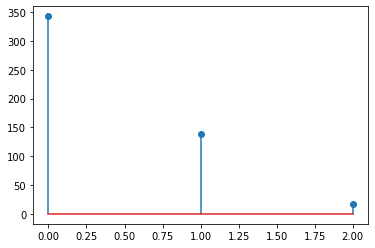

In [52]:
import matplotlib.pyplot as plt
# _ = plt.hist(error, bins=[0,1,2])
# plt.bar(unique_elements,counts_elements)
# plt.stem(counts_elements)
plt.stem(unique_elements, counts_elements, use_line_collection=True)
plt.show()